<table class="table table-bordered">
    <tr>
        <th style="text-align:center;"><h1>Data Wrangling</h1><h2>Assignment 2 </h2><h3>Diploma in Data Science</h3></th>
    </tr>
</table>

In [942]:
# import the pacakges
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
from scipy.stats import skew
from sklearn.model_selection import train_test_split
import feature_engine.imputation as mdi
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import OrdinalEncoder
from feature_engine.encoding import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import RobustScaler
from sklearn.impute import SimpleImputer 
from feature_engine.imputation import MeanMedianImputer
from imblearn.over_sampling import SMOTE
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import FunctionTransformer
from sklearn.preprocessing import PowerTransformer
from feature_engine.transformation import YeoJohnsonTransformer
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.linear_model import LinearRegression
from xgboost import XGBClassifier
from feature_engine.discretisation import EqualFrequencyDiscretiser
from feature_engine.discretisation import EqualWidthDiscretiser
from imblearn.over_sampling import SMOTENC
from imblearn.pipeline import Pipeline as ImbPipeline
from sklearn.pipeline import Pipeline as SKPipeline
from sklearn.model_selection import cross_val_score, cross_validate
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

### Step 1: Load and Explore the Data

In [943]:
data_halloffame = pd.read_csv('./Datasets/CSV/hall_of_fame.csv')
data_batting = pd.read_csv('./Datasets/CSV/batting.csv')
data_batting_postseason = pd.read_csv('./Datasets/CSV/batting_postseason.csv')
data_pitching = pd.read_csv('./Datasets/CSV/pitching.csv')
data_pitching_postseason = pd.read_csv('./Datasets/CSV/pitching_postseason.csv')
data_allstar = pd.read_csv('./Datasets/CSV/all_star.csv')
data_award = pd.read_csv('./Datasets/CSV/player_award.csv')
data_awardvote = pd.read_csv('./Datasets/CSV/player_award_vote.csv')
data_fielding = pd.read_csv('./Datasets/CSV/fielding.csv')
data_fielding_postseason = pd.read_csv('./Datasets/CSV/fielding_postseason.csv')
data_player = pd.read_csv('./Datasets/CSV/player.csv')
data_appearance = pd.read_csv('./Datasets/CSV/appearances.csv')

In [944]:
data_halloffame

,player_id,yearid,votedby,ballots,needed,votes,inducted,category,needed_note
0,cobbty01,1936,BBWAA,226.0,170.0,222.0,Y,Player,NaN
1,ruthba01,1936,BBWAA,226.0,170.0,215.0,Y,Player,NaN
2,wagneho01,1936,BBWAA,226.0,170.0,215.0,Y,Player,NaN
3,mathech01,1936,BBWAA,226.0,170.0,205.0,Y,Player,NaN
4,johnswa01,1936,BBWAA,226.0,170.0,189.0,Y,Player,NaN
...,...,...,...,...,...,...,...,...,...
4115,grudzma01,2016,BBWAA,440.0,330.0,0.0,N,Player,NaN
4116,ausmubr01,2016,BBWAA,440.0,330.0,0.0,N,Player,NaN
4117,hamptmi01,2016,BBWAA,440.0,330.0,0.0,N,Player,NaN
4118,castilu01,2016,BBWAA,440.0,330.0,0.0,N,Player,NaN


In [945]:
data_batting

,player_id,year,stint,team_id,league_id,g,ab,r,h,double,...,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
0,abercda01,1871,1,TRO,NaN,1,4.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,25,118.0,30.0,32.0,6.0,...,13.0,8.0,1.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN
2,allisar01,1871,1,CL1,NaN,29,137.0,28.0,40.0,4.0,...,19.0,3.0,1.0,2.0,5.0,NaN,NaN,NaN,NaN,NaN
3,allisdo01,1871,1,WS3,NaN,27,133.0,28.0,44.0,10.0,...,27.0,1.0,1.0,0.0,2.0,NaN,NaN,NaN,NaN,NaN
4,ansonca01,1871,1,RC1,NaN,25,120.0,29.0,39.0,11.0,...,16.0,6.0,2.0,2.0,1.0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101327,zitoba01,2015,1,OAK,AL,3,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
101328,zobribe01,2015,1,OAK,AL,67,235.0,39.0,63.0,20.0,...,33.0,1.0,1.0,33.0,26.0,2.0,0.0,0.0,3.0,5.0
101329,zobribe01,2015,2,KCA,AL,59,232.0,37.0,66.0,16.0,...,23.0,2.0,3.0,29.0,30.0,1.0,1.0,0.0,2.0,3.0
101330,zuninmi01,2015,1,SEA,AL,112,350.0,28.0,61.0,11.0,...,28.0,0.0,1.0,21.0,132.0,0.0,5.0,8.0,2.0,6.0


In [946]:
data_pitching

,player_id,year,stint,team_id,league_id,w,l,g,gs,cg,...,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
0,bechtge01,1871,1,PH1,NaN,1,2,3,3,2,...,NaN,NaN,NaN,0,NaN,NaN,42,NaN,NaN,NaN
1,brainas01,1871,1,WS3,NaN,12,15,30,30,30,...,NaN,NaN,NaN,0,NaN,NaN,292,NaN,NaN,NaN
2,fergubo01,1871,1,NY2,NaN,0,0,1,0,0,...,NaN,NaN,NaN,0,NaN,NaN,9,NaN,NaN,NaN
3,fishech01,1871,1,RC1,NaN,4,16,24,24,22,...,NaN,NaN,NaN,0,NaN,NaN,257,NaN,NaN,NaN
4,fleetfr01,1871,1,NY2,NaN,0,1,1,1,1,...,NaN,NaN,NaN,0,NaN,NaN,21,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44134,youngch03,2015,1,KCA,AL,11,6,34,18,0,...,0.0,5.0,0.0,0,500.0,3.0,44,4.0,2.0,NaN
44135,zieglbr01,2015,1,ARI,NL,0,3,66,0,0,...,3.0,2.0,1.0,0,263.0,46.0,17,1.0,0.0,NaN
44136,zimmejo02,2015,1,WAS,NL,13,10,33,33,0,...,3.0,2.0,8.0,1,831.0,0.0,89,8.0,2.0,NaN
44137,zitoba01,2015,1,OAK,AL,0,0,3,2,0,...,0.0,0.0,0.0,0,37.0,1.0,8,0.0,0.0,NaN


In [947]:
data_fielding

,player_id,year,stint,team_id,league_id,pos,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr
0,abercda01,1871,1,TRO,NaN,SS,1,NaN,NaN,1.0,3.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,2B,22,NaN,NaN,67.0,72.0,42.0,5.0,NaN,NaN,NaN,NaN,NaN
2,addybo01,1871,1,RC1,NaN,SS,3,NaN,NaN,8.0,14.0,7.0,0.0,NaN,NaN,NaN,NaN,NaN
3,allisar01,1871,1,CL1,NaN,2B,2,NaN,NaN,1.0,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
4,allisar01,1871,1,CL1,NaN,OF,29,NaN,NaN,51.0,3.0,7.0,1.0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170521,younger03,2015,1,ATL,NL,OF,22,NaN,NaN,45.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
170522,younger03,2015,2,NYN,NL,OF,7,NaN,NaN,5.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
170523,zimmery01,2015,1,WAS,NL,OF,1,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
170524,zobribe01,2015,1,OAK,AL,OF,29,NaN,NaN,39.0,0.0,3.0,0.0,NaN,NaN,NaN,NaN,NaN


In [948]:
data_fielding_postseason

,player_id,year,team_id,league_id,round,pos,g,gs,inn_outs,po,a,e,dp,tp,pb,sb,cs
0,colliji01,1903,BOS,AL,WS,3B,8,8.0,213.0,9,18,1,1,0,NaN,NaN,NaN
1,crigelo01,1903,BOS,AL,WS,C,8,8.0,213.0,54,7,3,2,0,0.0,9.0,3.0
2,dinnebi01,1903,BOS,AL,WS,P,4,4.0,105.0,2,9,0,0,0,NaN,6.0,1.0
3,doughpa01,1903,BOS,AL,WS,LF,8,8.0,213.0,13,3,1,1,0,NaN,NaN,NaN
4,ferriho01,1903,BOS,AL,WS,2B,8,8.0,213.0,18,23,2,2,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12306,schwaky01,2015,CHN,NL,NLWC,RF,1,NaN,18.0,2,0,0,0,0,NaN,NaN,NaN
12307,solerjo01,2015,CHN,NL,NLDS1,RF,3,NaN,57.0,3,1,0,0,0,NaN,NaN,NaN
12308,solerjo01,2015,CHN,NL,NLCS,RF,3,NaN,78.0,5,0,0,0,0,NaN,NaN,NaN
12309,springe01,2015,HOU,AL,ALDS1,RF,5,NaN,129.0,14,0,0,0,0,NaN,NaN,NaN


In [949]:
data_batting_postseason

,year,round,player_id,team_id,league_id,g,ab,r,h,double,...,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
0,1884,WS,becanbu01,NY4,AA,1,2,0,1,0,...,0,0,NaN,0,0,0.0,NaN,NaN,NaN,NaN
1,1884,WS,bradyst01,NY4,AA,3,10,1,0,0,...,0,0,NaN,0,1,0.0,NaN,NaN,NaN,NaN
2,1884,WS,esterdu01,NY4,AA,3,10,0,3,1,...,0,1,NaN,0,3,0.0,NaN,NaN,NaN,NaN
3,1884,WS,forstto01,NY4,AA,1,3,0,0,0,...,0,0,NaN,0,1,0.0,NaN,NaN,NaN,NaN
4,1884,WS,keefeti01,NY4,AA,2,5,0,1,0,...,0,0,NaN,0,4,0.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11685,2015,WS,youngch03,KCA,AL,2,1,0,0,0,...,0,0,0.0,0,1,0.0,0.0,0.0,0.0,0.0
11686,2015,ALWC,youngch04,NYA,AL,1,2,0,0,0,...,0,0,0.0,1,1,0.0,0.0,0.0,0.0,0.0
11687,2015,ALDS1,zobribe01,KCA,AL,5,18,2,6,1,...,2,1,0.0,2,2,0.0,0.0,1.0,1.0,1.0
11688,2015,ALCS,zobribe01,KCA,AL,6,25,8,8,3,...,4,0,0.0,2,2,0.0,0.0,0.0,0.0,1.0


In [950]:
data_pitching_postseason

,player_id,year,round,team_id,league_id,w,l,g,gs,cg,...,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
0,becanbu01,1884,WS,NY4,AA,0,1,1,1,1,...,NaN,NaN,NaN,NaN,NaN,0,12,NaN,NaN,NaN
1,keefeti01,1884,WS,NY4,AA,0,2,2,2,2,...,NaN,NaN,NaN,NaN,NaN,0,9,NaN,NaN,NaN
2,radboch01,1884,WS,PRO,NL,3,0,3,3,3,...,NaN,NaN,NaN,NaN,NaN,0,3,NaN,NaN,NaN
3,clarkjo01,1885,WS,CHN,NL,0,1,2,2,2,...,NaN,NaN,NaN,NaN,NaN,0,14,NaN,NaN,NaN
4,mccorji01,1885,WS,CHN,NL,3,2,5,5,5,...,NaN,NaN,NaN,NaN,NaN,0,22,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5104,woodtr01,2015,NLDS1,CHN,NL,1,0,3,0,0,...,0.0,0.0,0.0,0.0,13.0,0,1,0.0,0.0,0.0
5105,woodtr01,2015,NLCS,CHN,NL,0,0,3,0,0,...,0.0,0.0,0.0,0.0,16.0,0,3,0.0,0.0,0.0
5106,youngch03,2015,ALDS1,KCA,AL,0,0,1,0,0,...,0.0,0.0,0.0,0.0,15.0,0,1,0.0,0.0,1.0
5107,youngch03,2015,ALCS,KCA,AL,0,0,1,1,0,...,0.0,0.0,0.0,0.0,19.0,0,2,0.0,0.0,0.0


In [951]:
data_allstar

,player_id,year,game_num,game_id,team_id,league_id,gp,starting_pos
0,gomezle01,1933,0,ALS193307060,NYA,AL,1.0,1.0
1,ferreri01,1933,0,ALS193307060,BOS,AL,1.0,2.0
2,gehrilo01,1933,0,ALS193307060,NYA,AL,1.0,3.0
3,gehrich01,1933,0,ALS193307060,DET,AL,1.0,4.0
4,dykesji01,1933,0,ALS193307060,CHA,AL,1.0,5.0
...,...,...,...,...,...,...,...,...
5064,boxbebr01,2015,0,NLS201507155,TBA,AL,NaN,NaN
5065,gordoal01,2015,0,NLS201507156,KCA,AL,NaN,NaN
5066,herreke01,2015,0,NLS201507157,KCA,AL,NaN,NaN
5067,cabremi01,2015,0,NLS201507158,DET,AL,NaN,NaN


In [952]:
data_award

,player_id,award_id,year,league_id,tie,notes
0,bondto01,Pitching Triple Crown,1877,NL,NaN,NaN
1,hinespa01,Triple Crown,1878,NL,NaN,NaN
2,heckegu01,Pitching Triple Crown,1884,AA,NaN,NaN
3,radboch01,Pitching Triple Crown,1884,NL,NaN,NaN
4,oneilti01,Triple Crown,1887,AA,NaN,NaN
...,...,...,...,...,...,...
6073,mccutan01,Silver Slugger,2015,NL,NaN,OF
6074,bumgama01,Silver Slugger,2015,NL,NaN,P
6075,crawfbr01,Silver Slugger,2015,NL,NaN,SS
6076,donaljo02,TSN Major League Player of the Year,2015,ML,NaN,NaN


In [953]:
data_awardvote

,award_id,year,league_id,player_id,points_won,points_max,votes_first
0,Cy Young,1956,ML,fordwh01,1.0,16,1.0
1,Cy Young,1956,ML,maglisa01,4.0,16,4.0
2,Cy Young,1956,ML,newcodo01,10.0,16,10.0
3,Cy Young,1956,ML,spahnwa01,1.0,16,1.0
4,Cy Young,1957,ML,donovdi01,1.0,16,1.0
...,...,...,...,...,...,...,...
6790,Rookie of the Year,2015,NL,kangju01,28.0,150,0.0
6791,Rookie of the Year,2015,NL,syndeno01,16.0,150,0.0
6792,Rookie of the Year,2015,NL,bourju01,4.0,150,0.0
6793,Rookie of the Year,2015,NL,pederjo01,1.0,150,0.0


In [954]:
data_halloffame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4120 entries, 0 to 4119
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   player_id    4120 non-null   object 
 1   yearid       4120 non-null   int64  
 2   votedby      4120 non-null   object 
 3   ballots      3927 non-null   float64
 4   needed       3770 non-null   float64
 5   votes        3927 non-null   float64
 6   inducted     4120 non-null   object 
 7   category     4120 non-null   object 
 8   needed_note  157 non-null    object 
dtypes: float64(3), int64(1), object(5)
memory usage: 289.8+ KB


In [955]:
data_batting.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101332 entries, 0 to 101331
Data columns (total 22 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   player_id  101332 non-null  object 
 1   year       101332 non-null  int64  
 2   stint      101332 non-null  int64  
 3   team_id    101332 non-null  object 
 4   league_id  100595 non-null  object 
 5   g          101332 non-null  int64  
 6   ab         96183 non-null   float64
 7   r          96183 non-null   float64
 8   h          96183 non-null   float64
 9   double     96183 non-null   float64
 10  triple     96183 non-null   float64
 11  hr         96183 non-null   float64
 12  rbi        95759 non-null   float64
 13  sb         94883 non-null   float64
 14  cs         72729 non-null   float64
 15  bb         96183 non-null   float64
 16  so         88345 non-null   float64
 17  ibb        59620 non-null   float64
 18  hbp        93373 non-null   float64
 19  sh         89845 non-nu

In [956]:
data_pitching.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44139 entries, 0 to 44138
Data columns (total 30 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  44139 non-null  object 
 1   year       44139 non-null  int64  
 2   stint      44139 non-null  int64  
 3   team_id    44139 non-null  object 
 4   league_id  44008 non-null  object 
 5   w          44139 non-null  int64  
 6   l          44139 non-null  int64  
 7   g          44139 non-null  int64  
 8   gs         44139 non-null  int64  
 9   cg         44139 non-null  int64  
 10  sho        44139 non-null  int64  
 11  sv         44139 non-null  int64  
 12  ipouts     44138 non-null  float64
 13  h          44139 non-null  int64  
 14  er         44139 non-null  int64  
 15  hr         44139 non-null  int64  
 16  bb         44139 non-null  int64  
 17  so         44139 non-null  int64  
 18  baopp      42614 non-null  float64
 19  era        44049 non-null  float64
 20  ibb   

In [957]:
data_allstar.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5069 entries, 0 to 5068
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   player_id     5069 non-null   object 
 1   year          5069 non-null   int64  
 2   game_num      5069 non-null   int64  
 3   game_id       5020 non-null   object 
 4   team_id       5069 non-null   object 
 5   league_id     5069 non-null   object 
 6   gp            5050 non-null   float64
 7   starting_pos  1580 non-null   float64
dtypes: float64(2), int64(2), object(4)
memory usage: 316.9+ KB


In [958]:
data_award.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6078 entries, 0 to 6077
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   player_id  6078 non-null   object
 1   award_id   6078 non-null   object
 2   year       6078 non-null   int64 
 3   league_id  6078 non-null   object
 4   tie        45 non-null     object
 5   notes      4648 non-null   object
dtypes: int64(1), object(5)
memory usage: 285.0+ KB


In [959]:
data_fielding_postseason.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12311 entries, 0 to 12310
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  12311 non-null  object 
 1   year       12311 non-null  int64  
 2   team_id    12311 non-null  object 
 3   league_id  12311 non-null  object 
 4   round      12311 non-null  object 
 5   pos        12311 non-null  object 
 6   g          12311 non-null  int64  
 7   gs         11924 non-null  float64
 8   inn_outs   11990 non-null  float64
 9   po         12311 non-null  int64  
 10  a          12311 non-null  int64  
 11  e          12311 non-null  int64  
 12  dp         12311 non-null  int64  
 13  tp         12311 non-null  int64  
 14  pb         1351 non-null   float64
 15  sb         5555 non-null   float64
 16  cs         5555 non-null   float64
dtypes: float64(5), int64(7), object(5)
memory usage: 1.6+ MB


In [960]:
data_fielding.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170526 entries, 0 to 170525
Data columns (total 18 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   player_id  170526 non-null  object 
 1   year       170526 non-null  int64  
 2   stint      170526 non-null  int64  
 3   team_id    170526 non-null  object 
 4   league_id  169023 non-null  object 
 5   pos        170526 non-null  object 
 6   g          170526 non-null  int64  
 7   gs         75849 non-null   float64
 8   inn_outs   102313 non-null  float64
 9   po         156409 non-null  float64
 10  a          156408 non-null  float64
 11  e          156407 non-null  float64
 12  dp         156408 non-null  float64
 13  pb         11116 non-null   float64
 14  wp         4189 non-null    float64
 15  sb         6024 non-null    float64
 16  cs         6024 non-null    float64
 17  zr         4189 non-null    float64
dtypes: float64(11), int64(3), object(4)
memory usage: 23.4+ MB


In [961]:
data_batting_postseason.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11690 entries, 0 to 11689
Data columns (total 22 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   year       11690 non-null  int64  
 1   round      11690 non-null  object 
 2   player_id  11690 non-null  object 
 3   team_id    11690 non-null  object 
 4   league_id  11690 non-null  object 
 5   g          11690 non-null  int64  
 6   ab         11690 non-null  int64  
 7   r          11690 non-null  int64  
 8   h          11690 non-null  int64  
 9   double     11690 non-null  int64  
 10  triple     11690 non-null  int64  
 11  hr         11690 non-null  int64  
 12  rbi        11690 non-null  int64  
 13  sb         11690 non-null  int64  
 14  cs         11489 non-null  float64
 15  bb         11690 non-null  int64  
 16  so         11690 non-null  int64  
 17  ibb        10651 non-null  float64
 18  hbp        10453 non-null  float64
 19  sh         10446 non-null  float64
 20  sf    

In [962]:
data_pitching_postseason.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5109 entries, 0 to 5108
Data columns (total 30 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  5109 non-null   object 
 1   year       5109 non-null   int64  
 2   round      5109 non-null   object 
 3   team_id    5109 non-null   object 
 4   league_id  5109 non-null   object 
 5   w          5109 non-null   int64  
 6   l          5109 non-null   int64  
 7   g          5109 non-null   int64  
 8   gs         5109 non-null   int64  
 9   cg         5109 non-null   int64  
 10  sho        5109 non-null   int64  
 11  sv         5109 non-null   int64  
 12  ipouts     5109 non-null   int64  
 13  h          5109 non-null   int64  
 14  er         5109 non-null   int64  
 15  hr         5109 non-null   int64  
 16  bb         5109 non-null   int64  
 17  so         5109 non-null   int64  
 18  baopp      5041 non-null   object 
 19  era        4841 non-null   float64
 20  ibb     

In [963]:
data_awardvote.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6795 entries, 0 to 6794
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   award_id     6795 non-null   object 
 1   year         6795 non-null   int64  
 2   league_id    6795 non-null   object 
 3   player_id    6795 non-null   object 
 4   points_won   6795 non-null   float64
 5   points_max   6795 non-null   int64  
 6   votes_first  6437 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 371.7+ KB


In [964]:
data_batting.isnull().sum()

player_id        0
year             0
stint            0
team_id          0
league_id      737
g                0
ab            5149
r             5149
h             5149
double        5149
triple        5149
hr            5149
rbi           5573
sb            6449
cs           28603
bb            5149
so           12987
ibb          41712
hbp           7959
sh           11487
sf           41181
g_idp        31257
dtype: int64

In [965]:
data_pitching.isnull().sum()

player_id        0
year             0
stint            0
team_id          0
league_id      131
w                0
l                0
g                0
gs               0
cg               0
sho              0
sv               0
ipouts           1
h                0
er               0
hr               0
bb               0
so               0
baopp         1525
era             90
ibb          14575
wp             133
hbp            559
bk               0
bfp            239
gf             133
r                0
sh           32900
sf           32900
g_idp        43394
dtype: int64

In [966]:
data_allstar.isnull().sum()

player_id          0
year               0
game_num           0
game_id           49
team_id            0
league_id          0
gp                19
starting_pos    3489
dtype: int64

In [967]:
data_award.isnull().sum()

player_id       0
award_id        0
year            0
league_id       0
tie          6033
notes        1430
dtype: int64

In [968]:
data_awardvote.isnull().sum()

award_id         0
year             0
league_id        0
player_id        0
points_won       0
points_max       0
votes_first    358
dtype: int64

In [969]:
data_fielding.isnull().sum()

player_id         0
year              0
stint             0
team_id           0
league_id      1503
pos               0
g                 0
gs            94677
inn_outs      68213
po            14117
a             14118
e             14119
dp            14118
pb           159410
wp           166337
sb           164502
cs           164502
zr           166337
dtype: int64

In [970]:
data_fielding_postseason.isnull().sum()

player_id        0
year             0
team_id          0
league_id        0
round            0
pos              0
g                0
gs             387
inn_outs       321
po               0
a                0
e                0
dp               0
tp               0
pb           10960
sb            6756
cs            6756
dtype: int64

In [971]:
data_pitching.drop_duplicates()
data_batting.drop_duplicates()
data_allstar.drop_duplicates()
data_award.drop_duplicates()
data_awardvote.drop_duplicates()
data_halloffame.drop_duplicates()
data_batting_postseason.drop_duplicates()
data_pitching_postseason.drop_duplicates()
data_fielding.drop_duplicates()
data_fielding_postseason.drop_duplicates()

,player_id,year,team_id,league_id,round,pos,g,gs,inn_outs,po,a,e,dp,tp,pb,sb,cs
0,colliji01,1903,BOS,AL,WS,3B,8,8.0,213.0,9,18,1,1,0,NaN,NaN,NaN
1,crigelo01,1903,BOS,AL,WS,C,8,8.0,213.0,54,7,3,2,0,0.0,9.0,3.0
2,dinnebi01,1903,BOS,AL,WS,P,4,4.0,105.0,2,9,0,0,0,NaN,6.0,1.0
3,doughpa01,1903,BOS,AL,WS,LF,8,8.0,213.0,13,3,1,1,0,NaN,NaN,NaN
4,ferriho01,1903,BOS,AL,WS,2B,8,8.0,213.0,18,23,2,2,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12306,schwaky01,2015,CHN,NL,NLWC,RF,1,NaN,18.0,2,0,0,0,0,NaN,NaN,NaN
12307,solerjo01,2015,CHN,NL,NLDS1,RF,3,NaN,57.0,3,1,0,0,0,NaN,NaN,NaN
12308,solerjo01,2015,CHN,NL,NLCS,RF,3,NaN,78.0,5,0,0,0,0,NaN,NaN,NaN
12309,springe01,2015,HOU,AL,ALDS1,RF,5,NaN,129.0,14,0,0,0,0,NaN,NaN,NaN


In [972]:
data_halloffame['induction_chances'] = data_halloffame['votes']/data_halloffame['ballots']

In [973]:
data_appearance.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100951 entries, 0 to 100950
Data columns (total 21 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   year       100951 non-null  int64  
 1   team_id    100951 non-null  object 
 2   league_id  100214 non-null  object 
 3   player_id  100951 non-null  object 
 4   g_all      100748 non-null  float64
 5   gs         49030 non-null   float64
 6   g_batting  100951 non-null  int64  
 7   g_defense  100748 non-null  float64
 8   g_p        100951 non-null  int64  
 9   g_c        100951 non-null  int64  
 10  g_1b       100951 non-null  int64  
 11  g_2b       100951 non-null  int64  
 12  g_3b       100951 non-null  int64  
 13  g_ss       100951 non-null  int64  
 14  g_lf       100951 non-null  int64  
 15  g_cf       100951 non-null  int64  
 16  g_rf       100951 non-null  int64  
 17  g_of       100951 non-null  int64  
 18  g_dh       49233 non-null   float64
 19  g_ph       49233 non-nu

### Step 2: Data Wrangling on multiple tables 

In [974]:
data_appearance = data_appearance.drop(['team_id','league_id','g_p','g_c','g_1b','g_2b','g_3b','g_ss','g_lf','g_cf','g_rf','g_of','g_dh','g_ph','g_pr'],axis=1)

In [975]:
data_batting['batting_average'] = data_batting['h'] / data_batting['ab']
data_batting['on_base_percentage'] = (data_batting['h'] + data_batting['bb'] + data_batting['hbp']) / (data_batting['ab'] + data_batting['bb'] + data_batting['hbp'] + data_batting['sf'])
data_batting['slugging_percentage'] = (data_batting['h'] + data_batting['double']*2 + data_batting['triple']*3 + data_batting['hr']*4)/data_batting['ab']

In [976]:
data_batting_postseason['batting_average'] = data_batting_postseason['h'] / data_batting_postseason['ab']
data_batting_postseason['on_base_percentage'] = (data_batting_postseason['h'] + data_batting_postseason['bb'] + data_batting_postseason['hbp']) / (data_batting_postseason['ab'] + data_batting_postseason['bb'] + data_batting_postseason['hbp'] + data_batting_postseason['sf'])
data_batting_postseason['slugging_percentage'] = (data_batting_postseason['h'] + data_batting_postseason['double']*2 + data_batting_postseason['triple']*3 + data_batting_postseason['hr']*4)/data_batting_postseason['ab']

In [977]:
data_batting = data_batting.drop(['league_id', 'team_id','stint','sh','sf'], axis=1)

In [978]:
data_batting_postseason = data_batting_postseason.drop(['league_id', 'team_id','sh','sf'], axis=1)

In [979]:
player_debut = data_batting.groupby('player_id')['year'].min()
data_batting['years_since_debut'] = data_batting['year'] - data_batting['player_id'].map(player_debut)

In [980]:
data_pitching = data_pitching.drop(['league_id', 'team_id','stint'], axis=1)

In [981]:
data_pitching_postseason = data_pitching_postseason.drop(['league_id', 'team_id'], axis=1)

In [982]:
data_pitching['era'] =  pd.to_numeric(data_pitching['era'], errors='coerce')
data_pitching['era'] = data_pitching['era'].replace([np.inf, -np.inf], np.nan)  # Ensure NaN replacement
data_pitching['era'] = data_pitching['era'].fillna(0)

In [983]:
data_pitching_postseason['era'] =  pd.to_numeric(data_pitching_postseason['era'], errors='coerce')
data_pitching_postseason['era'] = data_pitching_postseason['era'].replace([np.inf, -np.inf], np.nan)  # Ensure NaN replacement
data_pitching_postseason['era'] = data_pitching_postseason['era'].fillna(0)

In [984]:
data_pitching['baopp'] = pd.to_numeric(data_pitching['baopp'], errors='coerce')
data_pitching_postseason['baopp'] = pd.to_numeric(data_pitching_postseason['baopp'], errors='coerce')

In [985]:
data_allstar['gp'].fillna(0, inplace=True)
data_allstar['starting_pos'].fillna(0, inplace=True)

C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\4197148284.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_allstar['gp'].fillna(0, inplace=True)
C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\4197148284.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, 

In [986]:
data_allstar = data_allstar.drop(['league_id', 'team_id','game_id'], axis=1)

In [987]:
data_award = data_award.drop(['league_id','tie','notes'], axis=1)

In [988]:
data_awardvote = data_awardvote.drop(['league_id'], axis=1)

In [989]:
data_awardvote['votes_first'] = data_awardvote['votes_first'].fillna(0)

In [990]:
data_halloffame = data_halloffame.rename(columns={'yearid' : 'year'})
hof_data = data_halloffame[['player_id', 'year', 'inducted','votes','induction_chances']].copy()
hof_data['inducted'] = hof_data['inducted'].map({'Y': 1, 'N': 0})
hof_data['inducted'] = hof_data['inducted'].fillna(0).astype(int)
hof_data['inducted'] = hof_data.apply(lambda row: 1 if row['induction_chances'] > 0.5 else row['inducted'], axis=1)
mask = hof_data['votes'] == 0
hof_data = hof_data[~mask]

In [991]:
hof_data

,player_id,year,inducted,votes,induction_chances
0,cobbty01,1936,1,222.0,0.982301
1,ruthba01,1936,1,215.0,0.951327
2,wagneho01,1936,1,215.0,0.951327
3,mathech01,1936,1,205.0,0.907080
4,johnswa01,1936,1,189.0,0.836283
...,...,...,...,...,...
4108,garcino01,2016,0,8.0,0.018182
4109,sweenmi01,2016,0,3.0,0.006818
4110,kendaja01,2016,0,2.0,0.004545
4111,eckstda01,2016,0,2.0,0.004545


In [992]:
hof_data.shape

(3878, 5)

In [993]:
data_fielding = data_fielding.rename(columns={'yearid' : 'year'})
data_fielding_postseason = data_fielding_postseason.rename(columns={'yearid' : 'year'})
data_fielding = data_fielding.drop(['league_id','team_id','stint','pos'], axis=1)
data_fielding_postseason = data_fielding_postseason.drop(['league_id','team_id','pos'], axis=1)

In [994]:
hof_data['year'] = hof_data['year'].astype(int)
data_batting['year'] = data_batting['year'].astype(int)
data_pitching['year'] = data_pitching['year'].astype(int)
data_allstar['year'] = data_allstar['year'].astype(int)
data_award['year'] = data_award['year'].astype(int)
data_awardvote['year'] = data_awardvote['year'].astype(int)

In [995]:
# Remove leading/trailing whitespace from string columns in all tables
for table in [hof_data, data_batting, data_pitching, data_allstar, data_award, data_awardvote]:
    string_columns = table.select_dtypes(include=['object']).columns
    table[string_columns] = table[string_columns].apply(lambda x: x.str.strip())

In [996]:
for table in [hof_data, data_batting, data_pitching, data_allstar, data_award, data_awardvote]:
    table['player_id'] = table['player_id'].astype(str)

In [997]:
for table in [hof_data, data_awardvote, data_award, data_allstar, data_batting, data_pitching]:
    print(table.info())
    print(table.describe())

<class 'pandas.core.frame.DataFrame'>
Index: 3878 entries, 0 to 4112
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   player_id          3878 non-null   object 
 1   year               3878 non-null   int32  
 2   inducted           3878 non-null   int64  
 3   votes              3685 non-null   float64
 4   induction_chances  3685 non-null   float64
dtypes: float64(2), int32(1), int64(1), object(1)
memory usage: 166.6+ KB
None
              year     inducted        votes  induction_chances
count  3878.000000  3878.000000  3685.000000        3685.000000
mean   1967.451264     0.141310    54.344912           0.153778
std      22.526219     0.348386    86.542108           0.215195
min    1936.000000     0.000000     1.000000           0.001721
25%    1949.000000     0.000000     2.000000           0.008757
50%    1962.000000     0.000000    13.000000           0.048583
75%    1985.000000     0.000000    7

In [998]:
groupby_columns = ['player_id', 'year']
agg_dict = {col: 'first' if hof_data[col].dtype == 'object' else 'mean' for col in hof_data.columns if col not in groupby_columns + ['inducted']}
agg_dict['inducted'] = 'max'  # A player is inducted if they're inducted in any year
hof_data = hof_data.groupby(groupby_columns).agg(agg_dict).reset_index()

In [999]:
round_order = ['AEDIV', 'AWDIV', 'NEDIV', 'NWDIV', 'ALWC', 'NLWC', 
               'ALDS1', 'ALDS2', 'NLDS1', 'NLDS2', 'ALCS', 'NLCS', 'WS']

In [1000]:
round_order_dict = {round_: i for i, round_ in enumerate(round_order)}

In [1001]:
def get_most_important_round(rounds):
    # Sort the rounds based on their order of importance
    sorted_rounds = sorted(rounds, key=lambda x: round_order_dict.get(x, float('inf')))
    # Return the most important round (first in the sorted list)
    return sorted_rounds[0]

In [1002]:
data_batting = data_batting.groupby(['player_id','year'],as_index=False).sum()
data_pitching = data_pitching.groupby(['player_id','year'],as_index=False).sum()
data_fielding = data_fielding.groupby(['player_id','year'],as_index=False).sum()
data_appearance = data_appearance.groupby(['player_id','year'],as_index=False).sum()
data_player = data_player.groupby(['player_id'],as_index=False).sum()
data_fielding_postseason = data_fielding_postseason.groupby(['player_id', 'year'], as_index=False).apply(
    lambda group: group[group['round'] == get_most_important_round(group['round'])].sum()
).reset_index(drop=True)
# Apply to data_pitching_postseason
data_pitching_postseason = data_pitching_postseason.groupby(['player_id', 'year'], as_index=False).apply(
    lambda group: group[group['round'] == get_most_important_round(group['round'])].sum()
).reset_index(drop=True)
# Apply to data_batting_postseason
data_batting_postseason = data_batting_postseason.groupby(['player_id', 'year'], as_index=False).apply(
    lambda group: group[group['round'] == get_most_important_round(group['round'])].sum()
).reset_index(drop=True)

C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\3750244132.py:6: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  data_fielding_postseason = data_fielding_postseason.groupby(['player_id', 'year'], as_index=False).apply(
C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\3750244132.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  data_pitching_postseason = data_pitching_postseason.groupby(['player_id', 'ye

In [1003]:
data_batting_postseason

,year,round,player_id,g,ab,r,h,double,triple,hr,...,sb,cs,bb,so,ibb,hbp,g_idp,batting_average,on_base_percentage,slugging_percentage
0,1957,WS,aaronha01,7,28,5,11,0,1,3,...,0,0.0,1,6,0.0,0.0,0.0,0.392857,0.413793,0.928571
1,1958,WS,aaronha01,7,27,3,9,2,0,0,...,0,0.0,4,6,0.0,0.0,1.0,0.333333,0.419355,0.481481
2,1969,NLCS,aaronha01,3,14,3,5,2,0,3,...,0,0.0,0,1,0.0,0.0,1.0,0.357143,0.357143,1.500000
3,1969,NLCS,aaronto01,1,1,0,0,0,0,0,...,0,0.0,0,0,0.0,0.0,0.0,0.000000,0.000000,0.000000
4,2014,ALWC,abadfe01,1,0,0,0,0,0,0,...,0,0.0,0,0,0.0,0.0,0.0,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8437,2011,ALDS2,zobribe01,4,17,2,4,0,0,0,...,0,0.0,0,4,0.0,0.0,0.0,0.235294,0.000000,0.235294
8438,2013,ALWC,zobribe01,1,4,1,1,0,0,0,...,0,0.0,0,0,0.0,0.0,0.0,0.250000,0.000000,0.250000
8439,2015,ALDS1,zobribe01,5,18,2,6,1,0,0,...,1,0.0,2,2,0.0,0.0,1.0,0.333333,0.380952,0.444444
8440,1946,WS,zuberbi01,1,0,0,0,0,0,0,...,0,0.0,0,0,0.0,0.0,0.0,0.000000,0.000000,0.000000


In [1004]:
data_pitching_postseason

,player_id,year,round,w,l,g,gs,cg,sho,sv,...,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
0,aasedo01,1979,ALCS,1,0,2,0,0,0,0,...,1.0,0.0,0.0,0.0,20.0,2,1,0.0,1.0,0.0
1,abadfe01,2014,ALWC,0,0,1,0,0,0,0,...,0.0,0.0,0.0,0.0,1.0,0,0,0.0,0.0,0.0
2,abbotgl01,1975,ALCS,0,0,1,0,0,0,0,...,0.0,0.0,0.0,0.0,3.0,1,0,0.0,0.0,0.0
3,abbotpa01,2000,ALDS2,1,0,1,1,0,0,0,...,0.0,0.0,1.0,0.0,25.0,0,2,0.0,1.0,1.0
4,abbotpa01,2001,ALDS1,0,0,1,0,0,0,0,...,0.0,0.0,0.0,0.0,22.0,0,8,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3577,zitoba01,2003,ALDS2,1,1,2,2,0,0,0,...,0.0,0.0,1.0,0.0,52.0,0,5,0.0,0.0,0.0
3578,zitoba01,2006,ALDS2,1,0,1,1,0,0,0,...,0.0,0.0,0.0,0.0,30.0,0,1,1.0,0.0,0.0
3579,zitoba01,2012,NLDS2,0,0,1,1,0,0,0,...,0.0,0.0,0.0,0.0,16.0,0,2,0.0,0.0,0.0
3580,zuberbi01,1946,WS,0,0,1,0,0,0,0,...,1.0,0.0,0.0,0.0,9.0,0,1,0.0,0.0,1.0


In [1005]:
data_fielding_postseason

,player_id,year,round,g,gs,inn_outs,po,a,e,dp,tp,pb,sb,cs
0,aaronha01,1957,WS,7,7.0,186.0,11,0,0,0,0,0.0,0.0,0.0
1,aaronha01aaronha01,3916,WSWS,8,7.0,189.0,15,0,0,0,0,0.0,0.0,0.0
2,aaronha01,1969,NLCS,3,3.0,78.0,5,1,0,0,0,0.0,0.0,0.0
3,aasedo01,1979,ALCS,2,0.0,15.0,0,1,0,0,0,0.0,0.0,0.0
4,abadfe01,2014,ALWC,1,0.0,1.0,0,0,0,0,0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8241,zobribe01,2011,ALDS2,4,4.0,0.0,9,6,0,2,0,0.0,0.0,0.0
8242,zobribe01,2013,ALWC,1,1.0,27.0,0,2,0,0,0,0.0,0.0,0.0
8243,zobribe01,2015,ALDS1,5,0.0,132.0,12,8,0,3,0,0.0,0.0,0.0
8244,zuberbi01,1946,WS,1,0.0,6.0,0,0,0,0,0,0.0,0.0,0.0


In [1006]:
data_player

,player_id,birth_year,birth_month,birth_day,birth_country,birth_state,birth_city,death_year,death_month,death_day,...,name_last,name_given,weight,height,bats,throws,debut,final_game,retro_id,bbref_id
0,aardsda01,1981.0,12.0,27.0,USA,CO,Denver,0.0,0.0,0.0,...,Aardsma,David Allan,220.0,75.0,R,R,2004-04-06,2015-08-23,aardd001,aardsda01
1,aaronha01,1934.0,2.0,5.0,USA,AL,Mobile,0.0,0.0,0.0,...,Aaron,Henry Louis,180.0,72.0,R,R,1954-04-13,1976-10-03,aaroh101,aaronha01
2,aaronto01,1939.0,8.0,5.0,USA,AL,Mobile,1984.0,8.0,16.0,...,Aaron,Tommie Lee,190.0,75.0,R,R,1962-04-10,1971-09-26,aarot101,aaronto01
3,aasedo01,1954.0,9.0,8.0,USA,CA,Orange,0.0,0.0,0.0,...,Aase,Donald William,190.0,75.0,R,R,1977-07-26,1990-10-03,aased001,aasedo01
4,abadan01,1972.0,8.0,25.0,USA,FL,Palm Beach,0.0,0.0,0.0,...,Abad,Fausto Andres,184.0,73.0,L,L,2001-09-10,2006-04-13,abada001,abadan01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18841,zupofr01,1939.0,8.0,29.0,USA,CA,San Francisco,2005.0,3.0,25.0,...,Zupo,Frank Joseph,182.0,71.0,L,R,1957-07-01,1961-05-09,zupof101,zupofr01
18842,zuvelpa01,1958.0,10.0,31.0,USA,CA,San Mateo,0.0,0.0,0.0,...,Zuvella,Paul,173.0,72.0,R,R,1982-09-04,1991-05-02,zuvep001,zuvelpa01
18843,zuverge01,1924.0,8.0,20.0,USA,MI,Holland,2014.0,9.0,8.0,...,Zuverink,George,195.0,76.0,R,R,1951-04-21,1959-06-15,zuveg101,zuverge01
18844,zwilldu01,1888.0,11.0,2.0,USA,MO,St. Louis,1978.0,3.0,27.0,...,Zwilling,Edward Harrison,160.0,66.0,L,L,1910-08-14,1916-07-12,zwild101,zwilldu01


In [1007]:
data_appearance

,player_id,year,g_all,gs,g_batting,g_defense
0,aardsda01,2004,11.0,0.0,11,11.0
1,aardsda01,2006,45.0,0.0,43,45.0
2,aardsda01,2007,25.0,0.0,2,25.0
3,aardsda01,2008,47.0,0.0,5,47.0
4,aardsda01,2009,73.0,0.0,3,73.0
...,...,...,...,...,...,...
93897,zwilldu01,1910,27.0,0.0,27,27.0
93898,zwilldu01,1914,154.0,0.0,154,154.0
93899,zwilldu01,1915,150.0,0.0,150,150.0
93900,zwilldu01,1916,35.0,0.0,35,35.0


In [1008]:
data_fielding

,player_id,year,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr
0,aardsda01,2004,11,0.0,33.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,aardsda01,2006,45,0.0,159.0,1.0,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,aardsda01,2007,25,0.0,96.0,2.0,4.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,aardsda01,2008,47,0.0,147.0,3.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,aardsda01,2009,73,0.0,213.0,2.0,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92911,zwilldu01,1910,27,0.0,0.0,45.0,2.0,3.0,1.0,0.0,0.0,0.0,0.0,0.0
92912,zwilldu01,1914,154,0.0,0.0,340.0,15.0,14.0,3.0,0.0,0.0,0.0,0.0,0.0
92913,zwilldu01,1915,151,0.0,0.0,359.0,20.0,8.0,6.0,0.0,0.0,0.0,0.0,0.0
92914,zwilldu01,1916,10,0.0,0.0,11.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [1009]:
data_pitching

,player_id,year,w,l,g,gs,cg,sho,sv,ipouts,...,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
0,aardsda01,2004,1,0,11,0,0,0,0,32.0,...,0.0,0.0,2.0,0,61.0,5.0,8,0.0,1.0,0.0
1,aardsda01,2006,3,0,45,0,0,0,0,159.0,...,0.0,1.0,1.0,0,225.0,9.0,25,1.0,3.0,0.0
2,aardsda01,2007,2,1,25,0,0,0,0,97.0,...,3.0,2.0,1.0,0,151.0,7.0,24,2.0,1.0,0.0
3,aardsda01,2008,4,2,47,0,0,0,0,146.0,...,2.0,3.0,5.0,0,228.0,7.0,32,3.0,2.0,0.0
4,aardsda01,2009,3,6,73,0,0,0,38,214.0,...,3.0,2.0,0.0,0,296.0,53.0,23,2.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40854,zuverge01,1956,7,6,62,0,0,0,16,292.0,...,9.0,1.0,3.0,1,432.0,40.0,52,0.0,0.0,0.0
40855,zuverge01,1957,10,6,56,0,0,0,9,338.0,...,13.0,1.0,4.0,0,475.0,37.0,37,0.0,0.0,0.0
40856,zuverge01,1958,2,2,45,0,0,0,7,207.0,...,3.0,2.0,6.0,0,294.0,23.0,29,0.0,0.0,0.0
40857,zuverge01,1959,0,1,6,0,0,0,0,39.0,...,0.0,1.0,0.0,0,55.0,1.0,7,0.0,0.0,0.0


In [1010]:
data_batting

,player_id,year,g,ab,r,h,double,triple,hr,rbi,...,cs,bb,so,ibb,hbp,g_idp,batting_average,on_base_percentage,slugging_percentage,years_since_debut
0,aardsda01,2004,11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0
1,aardsda01,2006,45,2.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,2
2,aardsda01,2007,25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,3
3,aardsda01,2008,47,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.000000,0.0,0.000000,4
4,aardsda01,2009,73,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93893,zwilldu01,1910,27,87.0,7.0,16.0,5.0,0.0,0.0,5.0,...,0.0,11.0,0.0,0.0,1.0,0.0,0.183908,0.0,0.298851,0
93894,zwilldu01,1914,154,592.0,91.0,185.0,38.0,8.0,16.0,95.0,...,0.0,46.0,68.0,0.0,1.0,0.0,0.312500,0.0,0.589527,4
93895,zwilldu01,1915,150,548.0,65.0,157.0,32.0,7.0,13.0,94.0,...,0.0,67.0,65.0,0.0,2.0,0.0,0.286496,0.0,0.536496,5
93896,zwilldu01,1916,35,53.0,4.0,6.0,1.0,0.0,1.0,8.0,...,0.0,4.0,6.0,0.0,0.0,0.0,0.113208,0.0,0.226415,6


In [1011]:
player_stats_batting = data_batting

In [1012]:
player_stats_pitching = data_pitching

In [1013]:
player_stats_batting = pd.merge(player_stats_batting, data_fielding, on=['player_id', 'year','g'], suffixes=[None,'_fielding'],how='left')

In [1014]:
player_stats_batting = pd.merge(player_stats_batting, data_fielding_postseason, on=['player_id', 'year','g'], suffixes=[None,'_fielding_postseason'],how='left')

In [1015]:
player_stats_batting = pd.merge(player_stats_batting, data_batting_postseason, on=['player_id', 'year','round'],suffixes=[None,'_postseason'],how='left')

In [1016]:
player_stats_batting = pd.merge(player_stats_batting, hof_data, on=['player_id', 'year'], how='left')

In [1017]:
player_stats_batting = pd.merge(player_stats_batting, data_allstar, on=['player_id', 'year'], how='left')

In [1018]:
player_stats_batting = pd.merge(player_stats_batting, data_award, on=['player_id', 'year'], how='left')

In [1019]:
player_stats_batting = pd.merge(player_stats_batting, data_awardvote, on=['player_id', 'year', 'award_id'], how='left')

In [1020]:
player_stats_pitching = pd.merge(player_stats_pitching, data_fielding, on=['player_id', 'year','g'], suffixes=[None,'_fielding'], how='left')

In [1021]:
player_stats_pitching = pd.merge(player_stats_pitching, data_fielding_postseason, on=['player_id', 'year','g'], suffixes=[None,'_fielding_postseason'], how='left')

In [1022]:
player_stats_pitching = pd.merge(player_stats_pitching, data_pitching_postseason, on=['player_id', 'year','round'],suffixes=[None,'_postseason'],how='left')

In [1023]:
player_stats_pitching = pd.merge(player_stats_pitching, hof_data, on=['player_id', 'year'], how='left')

In [1024]:
player_stats_pitching = pd.merge(player_stats_pitching, data_allstar, on=['player_id', 'year'], how='left')

In [1025]:
player_stats_pitching = pd.merge(player_stats_pitching, data_award, on=['player_id', 'year'], how='left')

In [1026]:
player_stats_pitching = pd.merge(player_stats_pitching, data_awardvote, on=['player_id', 'year', 'award_id'], how='left')

In [1027]:
player_stats_batting['inducted'].value_counts()

inducted
0.0    27
1.0     2
Name: count, dtype: int64

In [1028]:
player_stats_pitching['inducted'].value_counts()

inducted
0.0    8
1.0    1
Name: count, dtype: int64

In [1029]:
player_stats_batting.shape

(96620, 71)

In [1030]:
player_stats_pitching.shape

(41629, 84)

In [1031]:
player_stats_pitching = player_stats_pitching.drop_duplicates()

In [1032]:
player_stats_pitching

,player_id,year,w,l,g,gs,cg,sho,sv,ipouts,...,votes,induction_chances,inducted,game_num,gp,starting_pos,award_id,points_won,points_max,votes_first
0,aardsda01,2004,1,0,11,0,0,0,0,32.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,aardsda01,2006,3,0,45,0,0,0,0,159.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,aardsda01,2007,2,1,25,0,0,0,0,97.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,aardsda01,2008,4,2,47,0,0,0,0,146.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,aardsda01,2009,3,6,73,0,0,0,38,214.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41624,zuverge01,1956,7,6,62,0,0,0,16,292.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41625,zuverge01,1957,10,6,56,0,0,0,9,338.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41626,zuverge01,1958,2,2,45,0,0,0,7,207.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41627,zuverge01,1959,0,1,6,0,0,0,0,39.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1033]:
player_stats_batting = player_stats_batting.drop_duplicates()

In [1034]:
player_stats_batting

,player_id,year,g,ab,r,h,double,triple,hr,rbi,...,votes,induction_chances,inducted,game_num,gp,starting_pos,award_id,points_won,points_max,votes_first
0,aardsda01,2004,11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,aardsda01,2006,45,2.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,aardsda01,2007,25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,aardsda01,2008,47,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,aardsda01,2009,73,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96615,zwilldu01,1910,27,87.0,7.0,16.0,5.0,0.0,0.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
96616,zwilldu01,1914,154,592.0,91.0,185.0,38.0,8.0,16.0,95.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
96617,zwilldu01,1915,150,548.0,65.0,157.0,32.0,7.0,13.0,94.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
96618,zwilldu01,1916,35,53.0,4.0,6.0,1.0,0.0,1.0,8.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1035]:
player_stats_batting = player_stats_batting.drop(columns=['starting_pos'])

In [1036]:
player_stats_pitching = player_stats_pitching.drop(columns=['starting_pos'])

In [1037]:
player_stats_pitching.isnull().sum()

player_id          0
year               0
w                  0
l                  0
g                  0
               ...  
gp             39390
award_id       39983
points_won     41425
points_max     41425
votes_first    41425
Length: 83, dtype: int64

In [1038]:
player_stats_pitching.info()

<class 'pandas.core.frame.DataFrame'>
Index: 41462 entries, 0 to 41628
Data columns (total 83 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   player_id                     41462 non-null  object 
 1   year                          41462 non-null  int32  
 2   w                             41462 non-null  int64  
 3   l                             41462 non-null  int64  
 4   g                             41462 non-null  int64  
 5   gs                            41462 non-null  int64  
 6   cg                            41462 non-null  int64  
 7   sho                           41462 non-null  int64  
 8   sv                            41462 non-null  int64  
 9   ipouts                        41462 non-null  float64
 10  h                             41462 non-null  int64  
 11  er                            41462 non-null  int64  
 12  hr                            41462 non-null  int64  
 13  bb    

In [1039]:
player_stats_batting.isnull().sum()

player_id          0
year               0
g                  0
ab                 0
r                  0
               ...  
gp             89379
award_id       90412
points_won     95970
points_max     95970
votes_first    95970
Length: 70, dtype: int64

In [1040]:
player_stats_batting.info()

<class 'pandas.core.frame.DataFrame'>
Index: 96110 entries, 0 to 96619
Data columns (total 70 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   player_id                       96110 non-null  object 
 1   year                            96110 non-null  int32  
 2   g                               96110 non-null  int64  
 3   ab                              96110 non-null  float64
 4   r                               96110 non-null  float64
 5   h                               96110 non-null  float64
 6   double                          96110 non-null  float64
 7   triple                          96110 non-null  float64
 8   hr                              96110 non-null  float64
 9   rbi                             96110 non-null  float64
 10  sb                              96110 non-null  float64
 11  cs                              96110 non-null  float64
 12  bb                              96110

In [1041]:
num_cols_pitching = [c for c in player_stats_pitching.columns if player_stats_pitching[c].dtypes !='O']
player_stats_pitching[num_cols_pitching].isnull().mean().sort_values()

year                0.000000
g_idp               0.000000
sf                  0.000000
sh                  0.000000
r                   0.000000
                      ...   
gs_postseason       0.999976
g_postseason        0.999976
l_postseason        0.999976
ibb_postseason      0.999976
baopp_postseason    0.999976
Length: 80, dtype: float64

In [1042]:
num_cols_batting = [c for c in player_stats_batting.columns if player_stats_batting[c].dtypes !='O']
player_stats_batting[num_cols_batting].isnull().mean().sort_values()

year                      0.000000
years_since_debut         0.000000
slugging_percentage       0.000000
on_base_percentage        0.000000
g_idp                     0.000000
                            ...   
pb_fielding_postseason    0.999969
tp                        0.999969
dp_fielding_postseason    0.999969
a_fielding_postseason     0.999969
po_fielding_postseason    0.999969
Length: 67, dtype: float64

In [1043]:
cat_cols_pitching = [c for c in player_stats_pitching.columns if player_stats_pitching[c].dtypes =='O']
player_stats_pitching[cat_cols_pitching].isnull().mean().sort_values()

player_id    0.000000
award_id     0.964329
round        0.999686
dtype: float64

In [1044]:
cat_cols_batting = [c for c in player_stats_batting.columns if player_stats_batting[c].dtypes =='O']
player_stats_batting[cat_cols_batting].isnull().mean().sort_values()

player_id    0.000000
award_id     0.940714
round        0.999969
dtype: float64

In [1045]:
numeric_columns = player_stats_pitching.select_dtypes(include=[np.number]).columns
print("Numeric columns:", numeric_columns.tolist())

Numeric columns: ['year', 'w', 'l', 'g', 'gs', 'cg', 'sho', 'sv', 'ipouts', 'h', 'er', 'hr', 'bb', 'so', 'baopp', 'era', 'ibb', 'wp', 'hbp', 'bk', 'bfp', 'gf', 'r', 'sh', 'sf', 'g_idp', 'gs_fielding', 'inn_outs', 'po', 'a', 'e', 'dp', 'pb', 'wp_fielding', 'sb', 'cs', 'zr', 'gs_fielding_postseason', 'inn_outs_fielding_postseason', 'po_fielding_postseason', 'a_fielding_postseason', 'e_fielding_postseason', 'dp_fielding_postseason', 'tp', 'pb_fielding_postseason', 'sb_fielding_postseason', 'cs_fielding_postseason', 'w_postseason', 'l_postseason', 'g_postseason', 'gs_postseason', 'cg_postseason', 'sho_postseason', 'sv_postseason', 'ipouts_postseason', 'h_postseason', 'er_postseason', 'hr_postseason', 'bb_postseason', 'so_postseason', 'baopp_postseason', 'era_postseason', 'ibb_postseason', 'wp_postseason', 'hbp_postseason', 'bk_postseason', 'bfp_postseason', 'gf_postseason', 'r_postseason', 'sh_postseason', 'sf_postseason', 'g_idp_postseason', 'votes', 'induction_chances', 'inducted', 'game

In [1046]:
infinite_columns = []
for col in numeric_columns:
    if np.isinf(player_stats_pitching[col]).any():
        infinite_columns.append(col)

print("Columns with infinite values:", infinite_columns)

Columns with infinite values: []


array([[<Axes: title={'center': 'year'}>, <Axes: title={'center': 'g'}>,
        <Axes: title={'center': 'ab'}>, <Axes: title={'center': 'r'}>,
        <Axes: title={'center': 'h'}>,
        <Axes: title={'center': 'double'}>,
        <Axes: title={'center': 'triple'}>,
        <Axes: title={'center': 'hr'}>],
       [<Axes: title={'center': 'rbi'}>, <Axes: title={'center': 'sb'}>,
        <Axes: title={'center': 'cs'}>, <Axes: title={'center': 'bb'}>,
        <Axes: title={'center': 'so'}>, <Axes: title={'center': 'ibb'}>,
        <Axes: title={'center': 'hbp'}>,
        <Axes: title={'center': 'g_idp'}>],
       [<Axes: title={'center': 'batting_average'}>,
        <Axes: title={'center': 'on_base_percentage'}>,
        <Axes: title={'center': 'slugging_percentage'}>,
        <Axes: title={'center': 'years_since_debut'}>,
        <Axes: title={'center': 'gs'}>,
        <Axes: title={'center': 'inn_outs'}>,
        <Axes: title={'center': 'po'}>, <Axes: title={'center': 'a'}>],
      

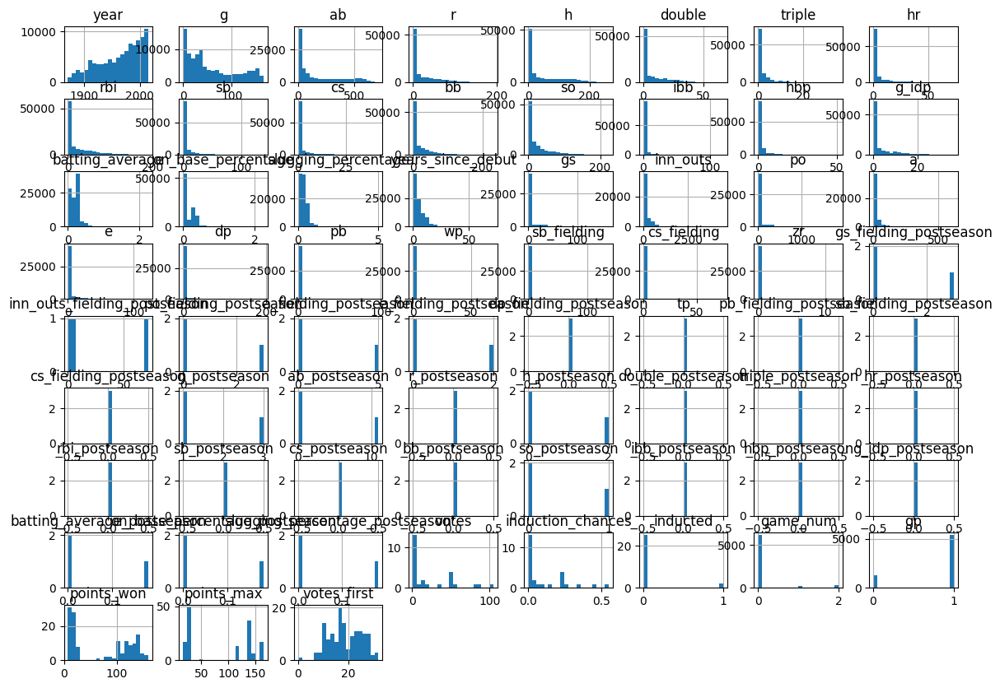

In [1047]:
player_stats_batting.hist(bins=20, figsize=(14, 10))

array([[<Axes: title={'center': 'year'}>, <Axes: title={'center': 'w'}>,
        <Axes: title={'center': 'l'}>, <Axes: title={'center': 'g'}>,
        <Axes: title={'center': 'gs'}>, <Axes: title={'center': 'cg'}>,
        <Axes: title={'center': 'sho'}>, <Axes: title={'center': 'sv'}>,
        <Axes: title={'center': 'ipouts'}>],
       [<Axes: title={'center': 'h'}>, <Axes: title={'center': 'er'}>,
        <Axes: title={'center': 'hr'}>, <Axes: title={'center': 'bb'}>,
        <Axes: title={'center': 'so'}>,
        <Axes: title={'center': 'baopp'}>,
        <Axes: title={'center': 'era'}>, <Axes: title={'center': 'ibb'}>,
        <Axes: title={'center': 'wp'}>],
       [<Axes: title={'center': 'hbp'}>, <Axes: title={'center': 'bk'}>,
        <Axes: title={'center': 'bfp'}>, <Axes: title={'center': 'gf'}>,
        <Axes: title={'center': 'r'}>, <Axes: title={'center': 'sh'}>,
        <Axes: title={'center': 'sf'}>,
        <Axes: title={'center': 'g_idp'}>,
        <Axes: title={'cen

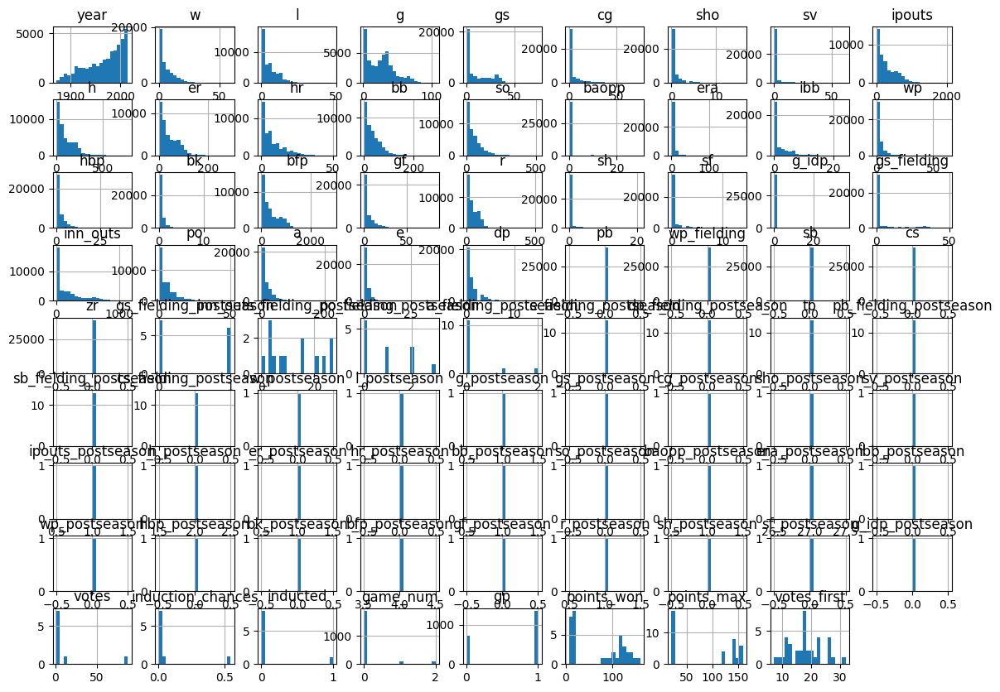

In [1048]:
player_stats_pitching.hist(bins=20, figsize=(14, 10))

In [1049]:
def diagnostic_plots(df, variable):
    if pd.api.types.is_numeric_dtype(df[variable]):
        plt.figure(figsize=(15,6))
        
        plt.subplot(1, 1, 1)
        df[variable].plot(kind='box')
        plt.title(f'Box Plot of {variable}')
        plt.xlabel('')
        plt.ylabel(variable)
        
        plt.tight_layout()
        plt.show()

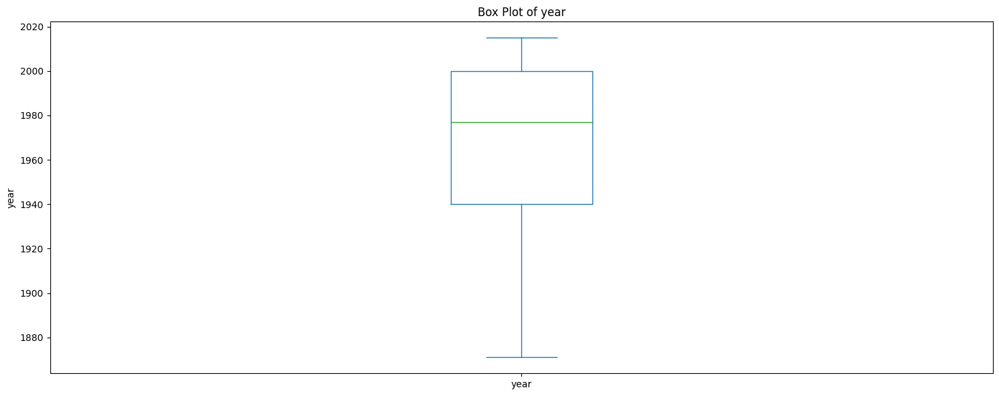

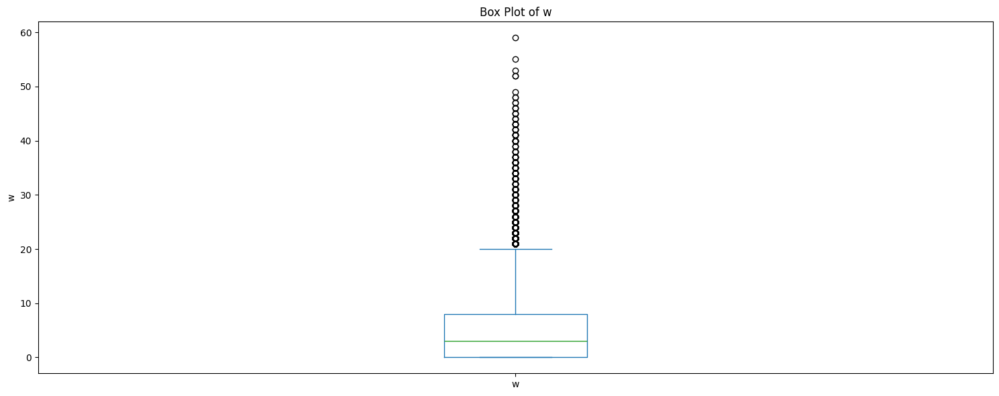

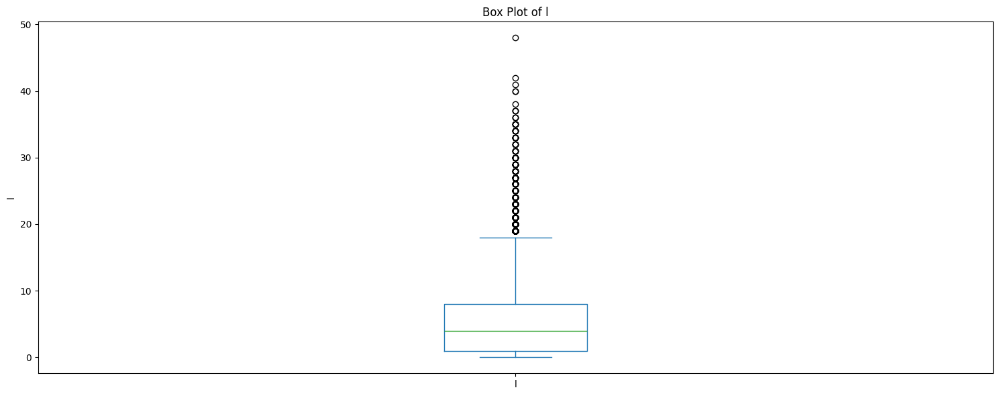

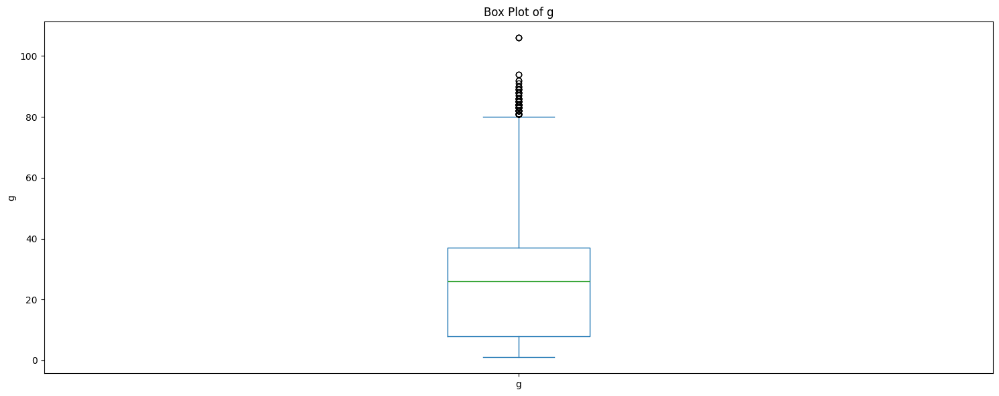

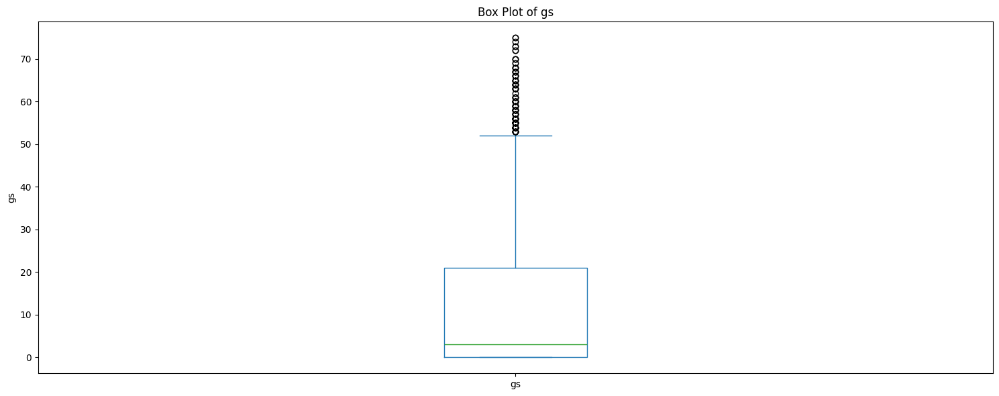

...

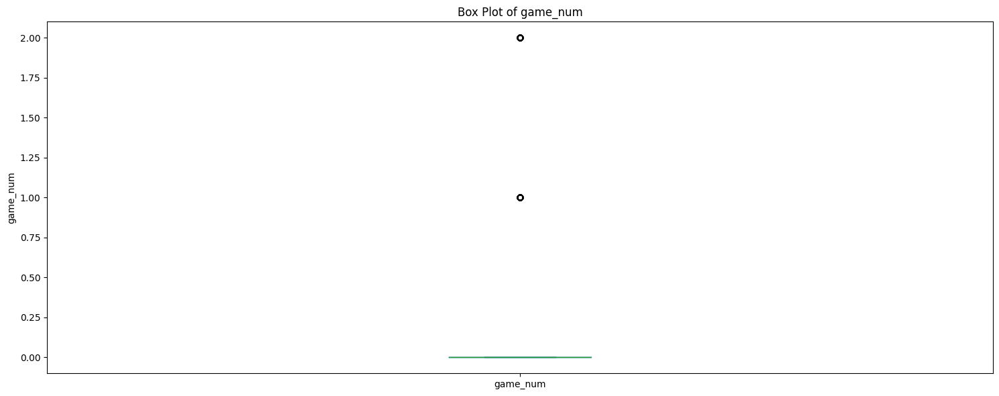

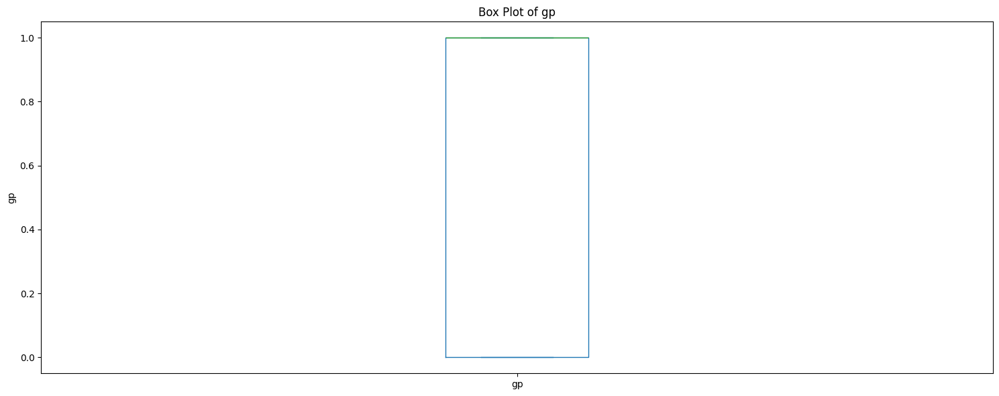

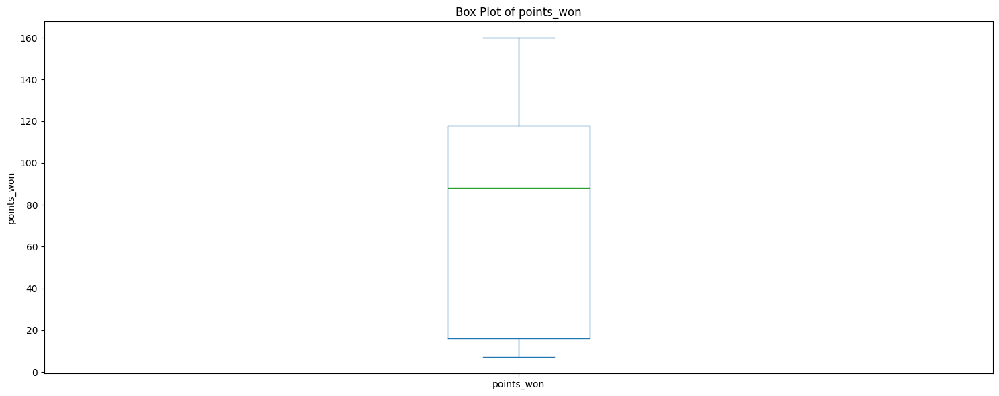

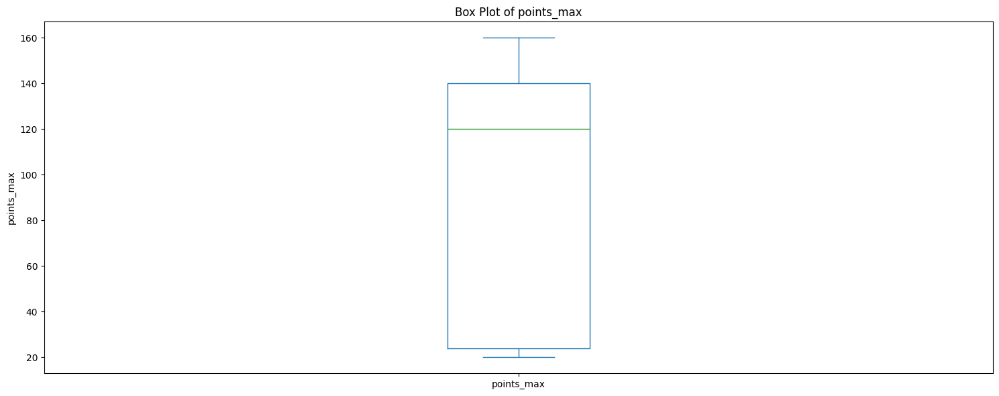

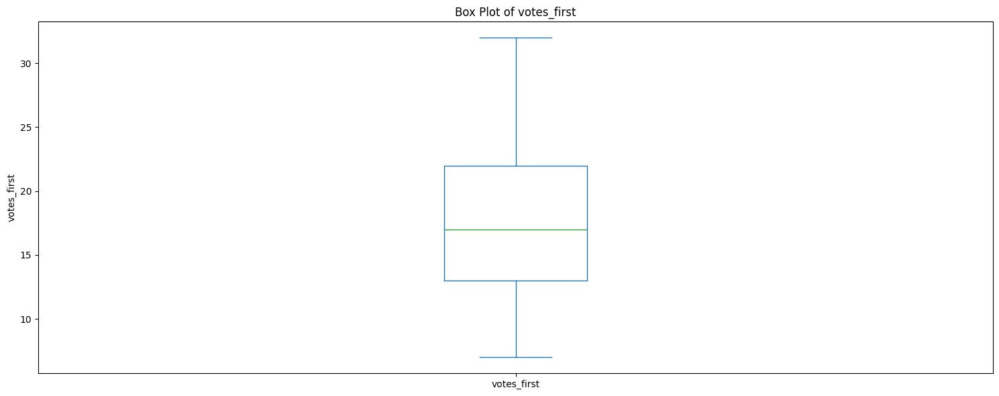

In [1050]:
for variable in player_stats_pitching.columns:
    diagnostic_plots(player_stats_pitching, variable)

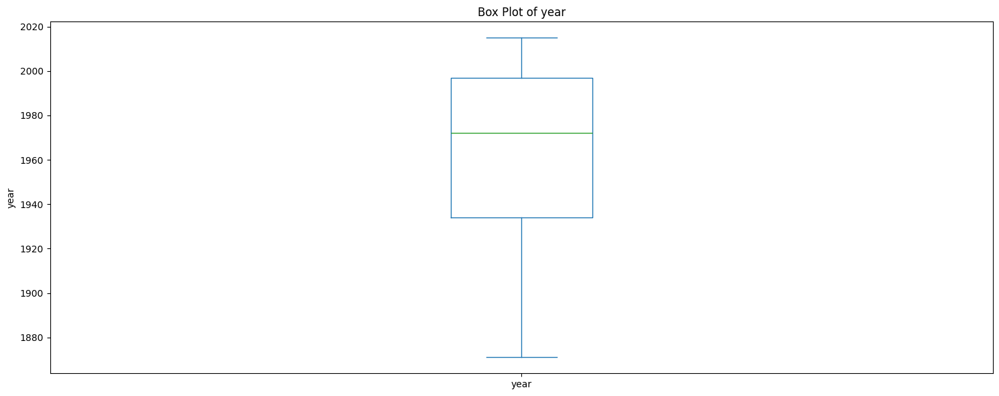

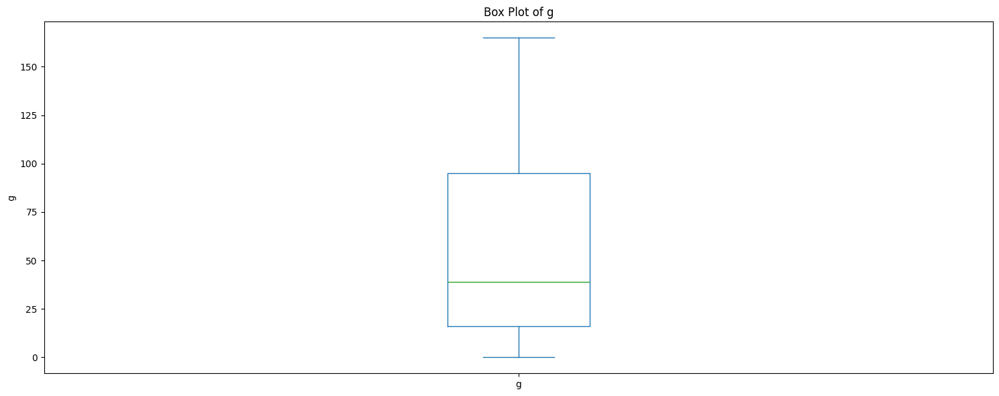

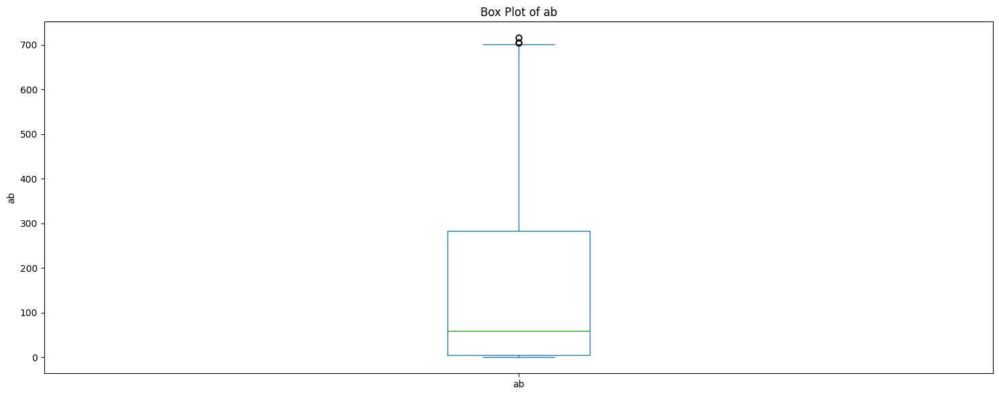

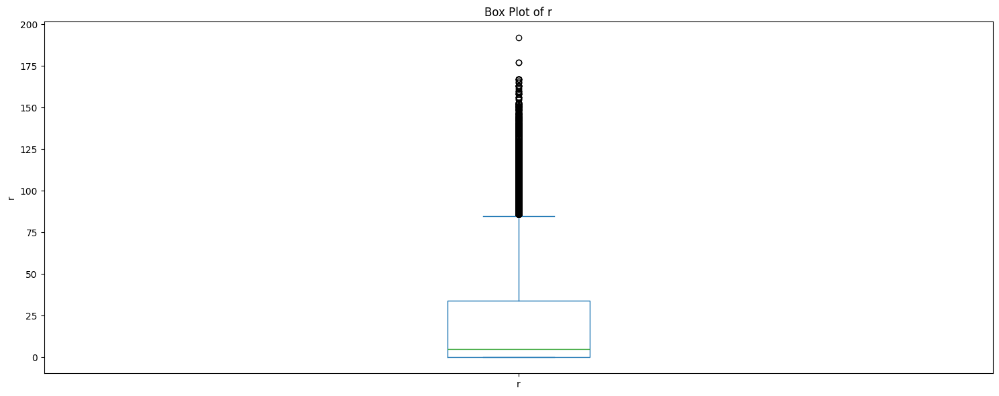

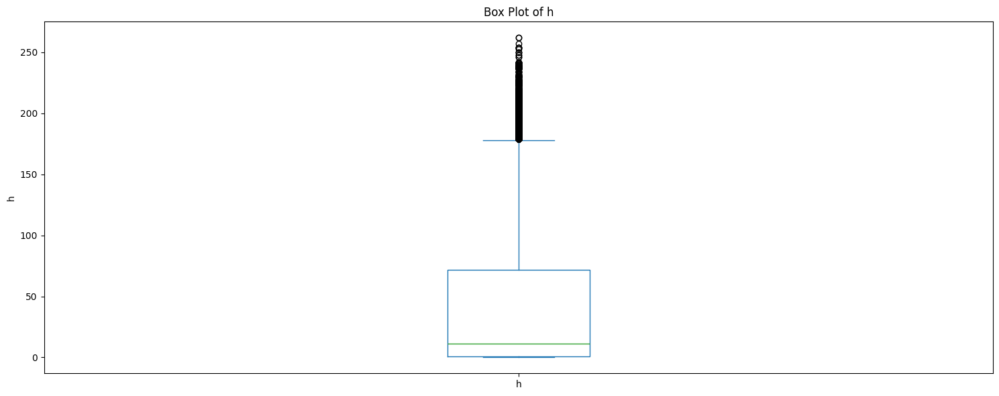

...

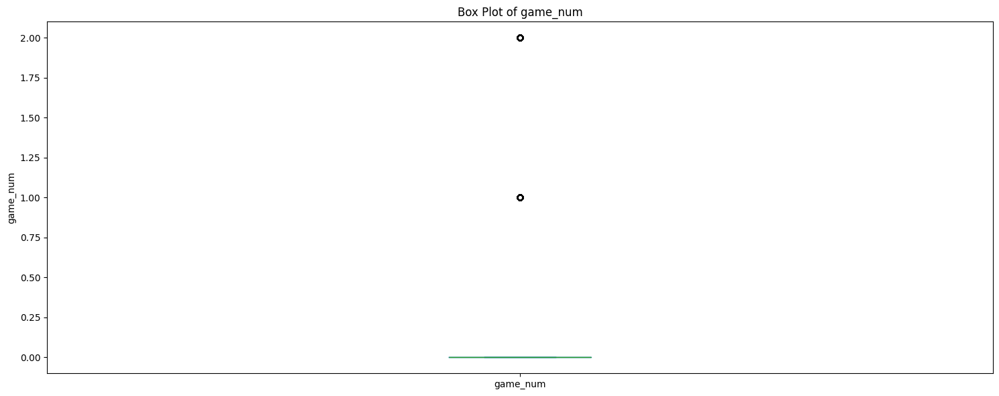

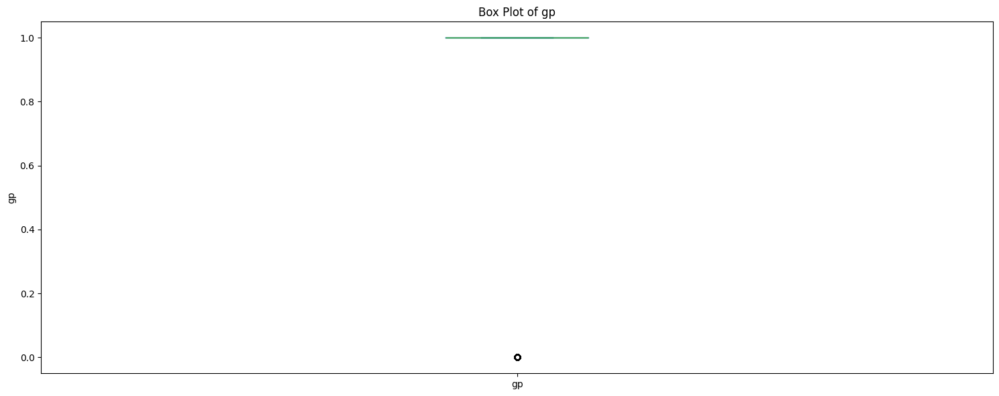

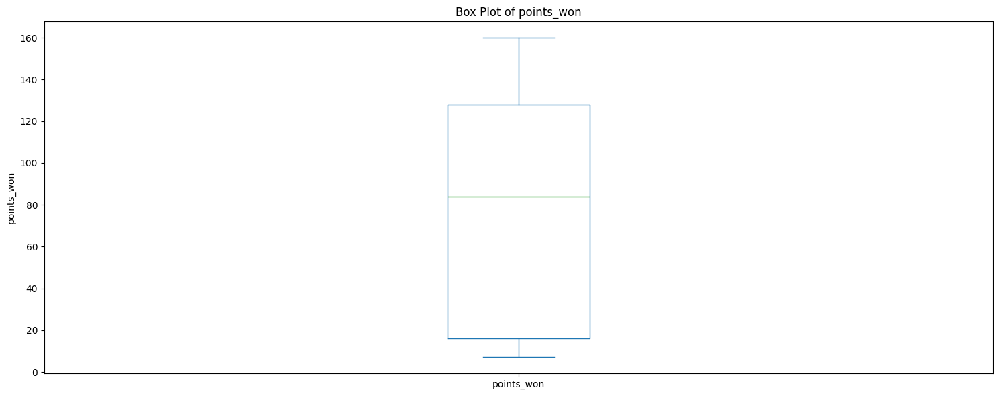

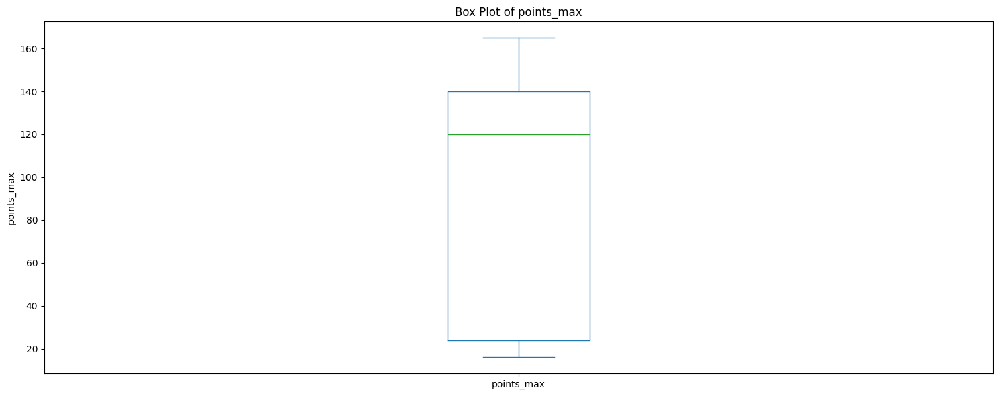

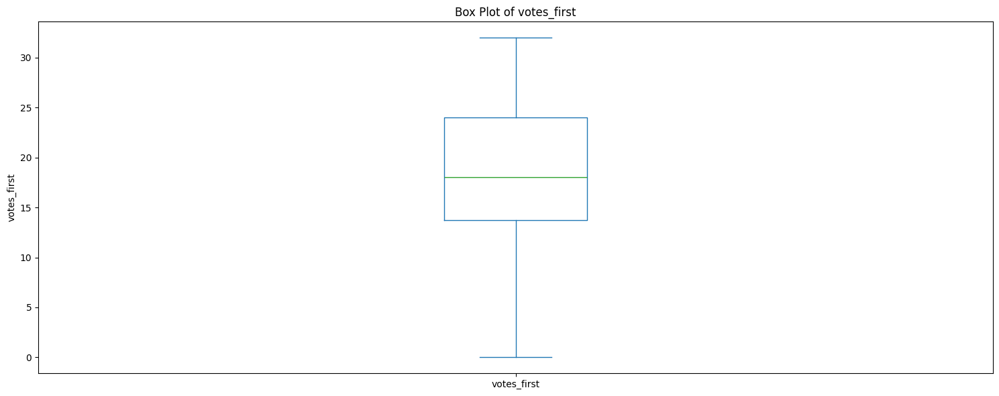

In [1051]:
for variable in player_stats_batting.columns:
    diagnostic_plots(player_stats_batting, variable)

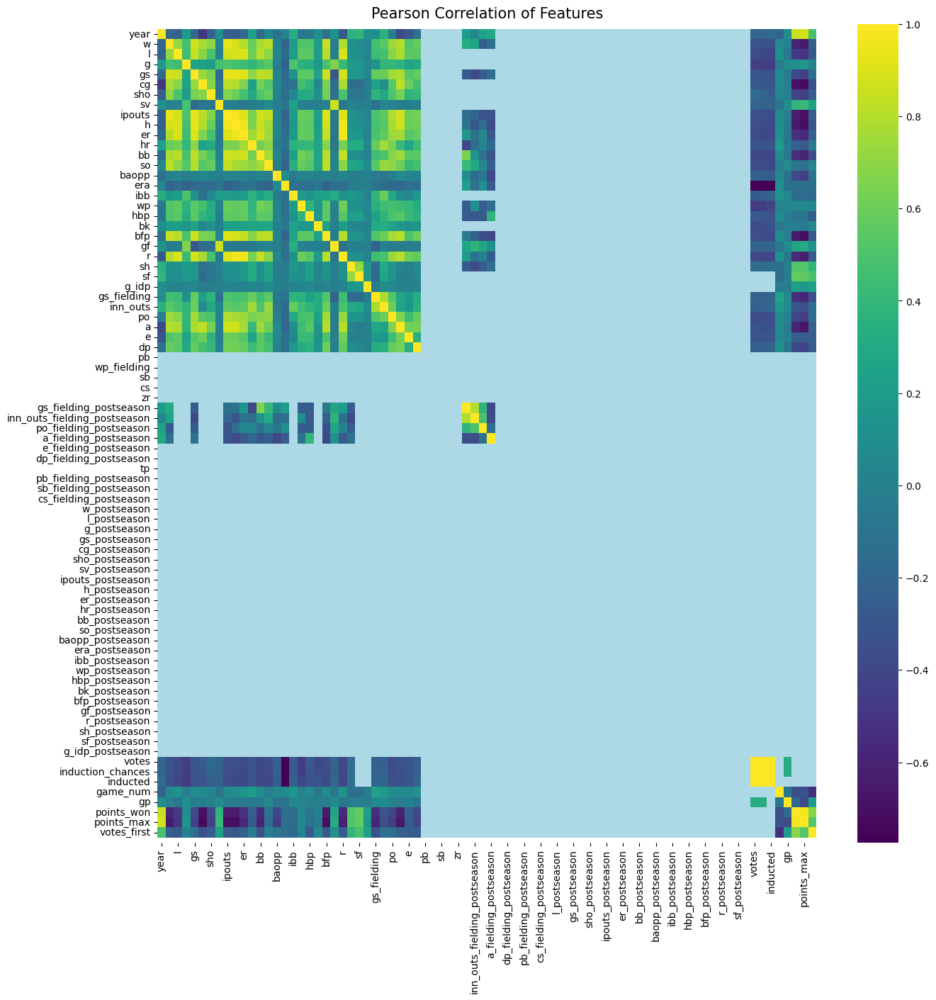

In [1052]:
colormap = plt.cm.viridis
plt.figure(figsize=(15,15))
plt.title('Pearson Correlation of Features', size=15)
colormap.set_bad('lightblue') 
ax = sns.heatmap(player_stats_pitching[num_cols_pitching].corr(), cmap=colormap, annot=False)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
plt.show()                                                                              

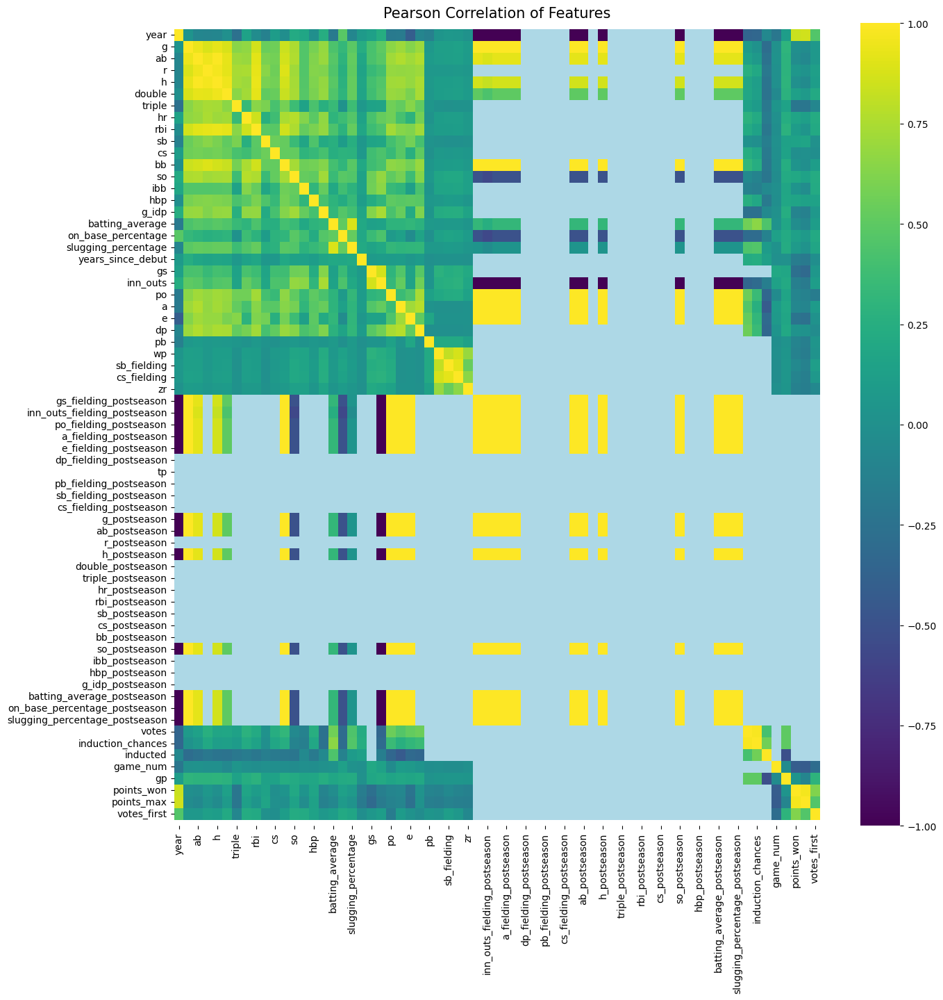

In [1053]:
colormap = plt.cm.viridis
plt.figure(figsize=(15,15))
plt.title('Pearson Correlation of Features', size=15)
colormap.set_bad('lightblue') 
ax = sns.heatmap(player_stats_batting[num_cols_batting].corr(), cmap=colormap, annot=False)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
plt.show()     

In [1054]:
player_stats_batting.dtypes

player_id       object
year             int32
g                int64
ab             float64
r              float64
                ...   
gp             float64
award_id        object
points_won     float64
points_max     float64
votes_first    float64
Length: 70, dtype: object

In [1055]:
player_stats_pitching.dtypes

player_id       object
year             int32
w                int64
l                int64
g                int64
                ...   
gp             float64
award_id        object
points_won     float64
points_max     float64
votes_first    float64
Length: 83, dtype: object

In [1056]:
player_stats_batting.info()

<class 'pandas.core.frame.DataFrame'>
Index: 96110 entries, 0 to 96619
Data columns (total 70 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   player_id                       96110 non-null  object 
 1   year                            96110 non-null  int32  
 2   g                               96110 non-null  int64  
 3   ab                              96110 non-null  float64
 4   r                               96110 non-null  float64
 5   h                               96110 non-null  float64
 6   double                          96110 non-null  float64
 7   triple                          96110 non-null  float64
 8   hr                              96110 non-null  float64
 9   rbi                             96110 non-null  float64
 10  sb                              96110 non-null  float64
 11  cs                              96110 non-null  float64
 12  bb                              96110

In [1057]:
player_stats_pitching.info()

<class 'pandas.core.frame.DataFrame'>
Index: 41462 entries, 0 to 41628
Data columns (total 83 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   player_id                     41462 non-null  object 
 1   year                          41462 non-null  int32  
 2   w                             41462 non-null  int64  
 3   l                             41462 non-null  int64  
 4   g                             41462 non-null  int64  
 5   gs                            41462 non-null  int64  
 6   cg                            41462 non-null  int64  
 7   sho                           41462 non-null  int64  
 8   sv                            41462 non-null  int64  
 9   ipouts                        41462 non-null  float64
 10  h                             41462 non-null  int64  
 11  er                            41462 non-null  int64  
 12  hr                            41462 non-null  int64  
 13  bb    

### Step 3: Data Cleansing and Transformation

In [1058]:
columns_to_drop = ['player_id', 'year', 'inducted']

In [1059]:
X_batting = player_stats_batting.drop(columns_to_drop, axis=1)
y_classification_batting = player_stats_batting['inducted']

In [1060]:
X_pitching = player_stats_pitching.drop(columns_to_drop, axis=1)
y_classification_pitching = player_stats_pitching['inducted']

In [1061]:
cat_cols_batting = [c for c in X_batting.columns if X_batting[c].dtypes == 'O']
cat_cols_pitching = [c for c in X_pitching.columns if X_pitching[c].dtypes == 'O']

X_pitching[cat_cols_pitching] = X_pitching[cat_cols_pitching].astype(str)
X_batting[cat_cols_batting] = X_batting[cat_cols_batting].astype(str)

In [1062]:
# Identifying numeric columns for pitching and batting
num_cols_pitching = [c for c in X_pitching.columns if X_pitching[c].dtypes != 'O']
num_cols_batting = [c for c in X_batting.columns if X_batting[c].dtypes != 'O']

# Get the indices of the numeric columns
num_cols_pitching_list = [X_pitching.columns.get_loc(col) for col in num_cols_pitching]
num_cols_batting_list = [X_batting.columns.get_loc(col) for col in num_cols_batting]

# Replacing NaN values with 999 in the numeric columns
X_pitching[num_cols_pitching] = X_pitching[num_cols_pitching].replace(to_replace=np.nan, value=999)
X_batting[num_cols_batting] = X_batting[num_cols_batting].replace(to_replace=np.nan, value=999)

In [1063]:
if y_classification_batting.isna().any():
    print("Warning: NaN values found in 'inducted' column. Filling with 0 (not inducted).")
    y_classification_batting = y_classification_batting.fillna(0).astype(int)

In [1064]:
if y_classification_pitching.isna().any():
    print("Warning: NaN values found in 'inducted' column. Filling with 0 (not inducted).")
    y_classification_pitching = y_classification_pitching.fillna(0).astype(int)

In [1065]:
X_batting.isnull().sum()

g              0
ab             0
r              0
h              0
double         0
              ..
gp             0
award_id       0
points_won     0
points_max     0
votes_first    0
Length: 67, dtype: int64

In [1066]:
X_pitching.isnull().sum()

w              0
l              0
g              0
gs             0
cg             0
              ..
gp             0
award_id       0
points_won     0
points_max     0
votes_first    0
Length: 80, dtype: int64

In [1067]:
smote = SMOTENC(categorical_features=cat_cols_batting,sampling_strategy=0.5,random_state=42,k_neighbors=1)
X_batting_resampled, y_batting_resampled = smote.fit_resample(X_batting, y_classification_batting)

In [1068]:
y_classification_batting.value_counts()

inducted
0    96108
1        2
Name: count, dtype: int64

In [1069]:
y_batting_resampled.value_counts()

inducted
0    96108
1    48054
Name: count, dtype: int64

In [1070]:
X_batting[num_cols_batting] = X_batting[num_cols_batting].replace(to_replace=999, value=np.nan)

In [1071]:
# smote2 = SMOTENC(categorical_features=cat_cols_pitching,sampling_strategy=0.5,random_state=42)
# X_pitching_resampled, y_pitching_resampled = smote2.fit_resample(X_pitching, y_classification_pitching)

In [1072]:
# y_classification_pitching.value_counts()

In [1073]:
# y_pitching_resampled.value_counts()

In [1074]:
y_classification_pitching

0        0
1        0
2        0
3        0
4        0
        ..
41624    0
41625    0
41626    0
41627    0
41628    0
Name: inducted, Length: 41462, dtype: int32

In [1075]:
y_classification_batting

0        0
1        0
2        0
3        0
4        0
        ..
96615    0
96616    0
96617    0
96618    0
96619    0
Name: inducted, Length: 96110, dtype: int32

In [1076]:
# X = player_stats.drop(columns_to_drop, axis=1)
# # y_classification = player_stats['inducted']

In [1077]:
# player_stats['inducted'].value_counts()

In [1078]:
# if y_classification.isna().any():
#     print("Warning: NaN values found in 'inducted' column. Filling with 0 (not inducted).")
#     y_classification = y_classification.fillna(0).astype(int)

# # Check number of classes for classification
# n_classes = len(y_classification.unique())
# print(f"Number of classes in target variable: {n_classes}")
# print(f"Class distribution: {y_classification.value_counts()}")

In [1079]:
# numeric_features = X.select_dtypes(include=['int64', 'float64']).columns
# categorical_features = X.select_dtypes(include=['object']).columns

In [1080]:
# le = LabelEncoder()
# y_classification = le.fit_transform(y_classification)

In [1081]:
# X_train, X_test, y_train, y_test= train_test_split(
#             X_batting, y_classification, test_size=0.2, random_state=69)

In [1082]:
X_train_batting, X_test_batting, y_train_batting, y_test_batting= train_test_split(
            X_batting_resampled, y_batting_resampled, test_size=0.3, random_state=69)

In [1083]:
X_train_pitching, X_test_pitching, y_train_pitching, y_test_pitching= train_test_split(
            X_pitching, y_classification_pitching, test_size=0.2, random_state=69)

In [1084]:
num_cols_batting = [c for c in X_train_batting.columns if X_train_batting[c].dtypes !='O']

In [1085]:
num_cols_batting

['g',
 'ab',
 'r',
 'h',
 'double',
 'triple',
 'hr',
 'rbi',
 'sb',
 'cs',
 'bb',
 'so',
 'ibb',
 'hbp',
 'g_idp',
 'batting_average',
 'on_base_percentage',
 'slugging_percentage',
 'years_since_debut',
 'gs',
 'inn_outs',
 'po',
 'a',
 'e',
 'dp',
 'pb',
 'wp',
 'sb_fielding',
 'cs_fielding',
 'zr',
 'gs_fielding_postseason',
 'inn_outs_fielding_postseason',
 'po_fielding_postseason',
 'a_fielding_postseason',
 'e_fielding_postseason',
 'dp_fielding_postseason',
 'tp',
 'pb_fielding_postseason',
 'sb_fielding_postseason',
 'cs_fielding_postseason',
 'g_postseason',
 'ab_postseason',
 'r_postseason',
 'h_postseason',
 'double_postseason',
 'triple_postseason',
 'hr_postseason',
 'rbi_postseason',
 'sb_postseason',
 'cs_postseason',
 'bb_postseason',
 'so_postseason',
 'ibb_postseason',
 'hbp_postseason',
 'g_idp_postseason',
 'batting_average_postseason',
 'on_base_percentage_postseason',
 'slugging_percentage_postseason',
 'votes',
 'induction_chances',
 'game_num',
 'gp',
 'points_

In [1086]:
num_cols_pitching = [c for c in X_train_pitching.columns if X_train_pitching[c].dtypes !='O']

In [1087]:
num_cols_pitching

['w',
 'l',
 'g',
 'gs',
 'cg',
 'sho',
 'sv',
 'ipouts',
 'h',
 'er',
 'hr',
 'bb',
 'so',
 'baopp',
 'era',
 'ibb',
 'wp',
 'hbp',
 'bk',
 'bfp',
 'gf',
 'r',
 'sh',
 'sf',
 'g_idp',
 'gs_fielding',
 'inn_outs',
 'po',
 'a',
 'e',
 'dp',
 'pb',
 'wp_fielding',
 'sb',
 'cs',
 'zr',
 'gs_fielding_postseason',
 'inn_outs_fielding_postseason',
 'po_fielding_postseason',
 'a_fielding_postseason',
 'e_fielding_postseason',
 'dp_fielding_postseason',
 'tp',
 'pb_fielding_postseason',
 'sb_fielding_postseason',
 'cs_fielding_postseason',
 'w_postseason',
 'l_postseason',
 'g_postseason',
 'gs_postseason',
 'cg_postseason',
 'sho_postseason',
 'sv_postseason',
 'ipouts_postseason',
 'h_postseason',
 'er_postseason',
 'hr_postseason',
 'bb_postseason',
 'so_postseason',
 'baopp_postseason',
 'era_postseason',
 'ibb_postseason',
 'wp_postseason',
 'hbp_postseason',
 'bk_postseason',
 'bfp_postseason',
 'gf_postseason',
 'r_postseason',
 'sh_postseason',
 'sf_postseason',
 'g_idp_postseason',
 '

In [1088]:
cat_cols_pitching = [c for c in X_train_pitching.columns if X_train_pitching[c].dtypes =='O']

In [1089]:
cat_cols_pitching

['round', 'award_id']

In [1090]:
cat_cols_batting = [c for c in X_train_batting.columns if X_train_batting[c].dtypes =='O']

In [1091]:
cat_cols_batting

['round', 'award_id']

In [1092]:
X_train_batting['round'].unique

<bound method Series.unique of 46112     nan
133240    nan
32755     nan
118419    nan
7488      nan
         ... 
37142     nan
142897    nan
25015     nan
140890    nan
122059    nan
Name: round, Length: 100913, dtype: object>

In [1093]:
X_train_pitching['round'].unique

<bound method Series.unique of 18364    nan
27250    nan
4080     nan
40776    nan
12482    nan
        ... 
37285    nan
11876    nan
25121    nan
9856     nan
4059     nan
Name: round, Length: 33169, dtype: object>

In [1094]:
X_train_batting['round'].astype(str)

46112     nan
133240    nan
32755     nan
118419    nan
7488      nan
         ... 
37142     nan
142897    nan
25015     nan
140890    nan
122059    nan
Name: round, Length: 100913, dtype: object

In [1095]:
X_train_pitching['round'].astype(str)

18364    nan
27250    nan
4080     nan
40776    nan
12482    nan
        ... 
37285    nan
11876    nan
25121    nan
9856     nan
4059     nan
Name: round, Length: 33169, dtype: object

In [1096]:
X_batting['award_id'].value_counts()

award_id
nan                                    90412
TSN All-Star                            1404
Gold Glove                              1098
Baseball Magazine All-Star              1008
Silver Slugger                           648
Most Valuable Player                     200
TSN Pitcher of the Year                  141
Rookie of the Year                       140
Cy Young Award                           113
TSN Player of the Year                    99
TSN Fireman of the Year                   90
TSN Major League Player of the Year       85
Rolaids Relief Man Award                  74
Babe Ruth Award                           67
World Series MVP                          65
Lou Gehrig Memorial Award                 59
All-Star Game MVP                         57
Hutch Award                               48
Roberto Clemente Award                    45
NLCS MVP                                  39
Pitching Triple Crown                     38
ALCS MVP                                  35
H

In [1097]:
X_train_pitching['award_id'].value_counts()

award_id
nan                                    32000
Baseball Magazine All-Star               249
TSN All-Star                             223
TSN Pitcher of the Year                  114
Gold Glove                                93
Cy Young Award                            86
TSN Fireman of the Year                   74
Rolaids Relief Man Award                  61
Rookie of the Year                        29
Pitching Triple Crown                     29
Silver Slugger                            28
World Series MVP                          25
Babe Ruth Award                           23
Most Valuable Player                      21
TSN Reliever of the Year                  17
TSN Major League Player of the Year       16
Hutch Award                               14
NLCS MVP                                  13
Lou Gehrig Memorial Award                 11
Comeback Player of the Year                9
ALCS MVP                                   9
Roberto Clemente Award                     8
B

In [1098]:
X_train_batting['award_id'].astype(str)

46112     nan
133240    nan
32755     nan
118419    nan
7488      nan
         ... 
37142     nan
142897    nan
25015     nan
140890    nan
122059    nan
Name: award_id, Length: 100913, dtype: object

In [1099]:
X_train_pitching['award_id'].astype(str)

18364    nan
27250    nan
4080     nan
40776    nan
12482    nan
        ... 
37285    nan
11876    nan
25121    nan
9856     nan
4059     nan
Name: award_id, Length: 33169, dtype: object

In [1100]:
def diagnostic_plots(df, variable):
    if pd.api.types.is_numeric_dtype(df[variable]):
        if df[variable].notna().sum() > 0:  # Check if the column is not all NaN
            plt.figure(figsize=(15, 6))
            
            # Histogram
            plt.subplot(1, 3, 1)
            df[variable].dropna().hist(bins=30)
            plt.title(f'Histogram of {variable}')
            
            # Q-Q Plot
            plt.subplot(1, 3, 2)
            stats.probplot(df[variable].dropna(), dist="norm", plot=plt)
            plt.title(f'Q-Q Plot of {variable}')
            
            # Boxplot
            plt.subplot(1, 3, 3)
            sns.boxplot(y=df[variable].dropna())
            plt.title(f'Boxplot of {variable}')

            plt.show()
        else:
            print(f"Column {variable} contains only NaN values.")
    else:
        print(f"Column {variable} is not numeric.")

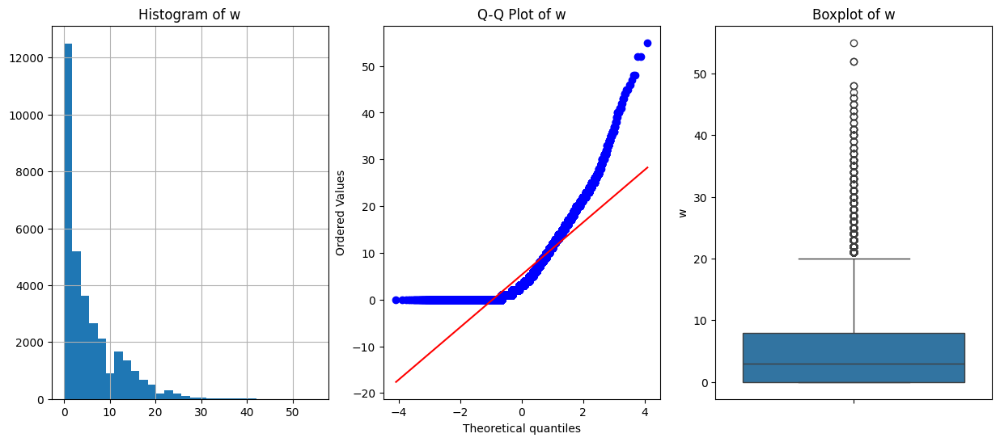

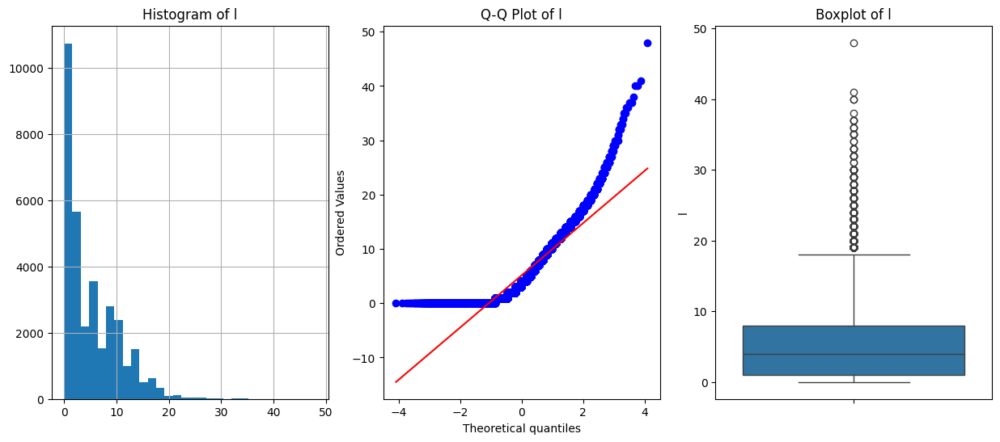

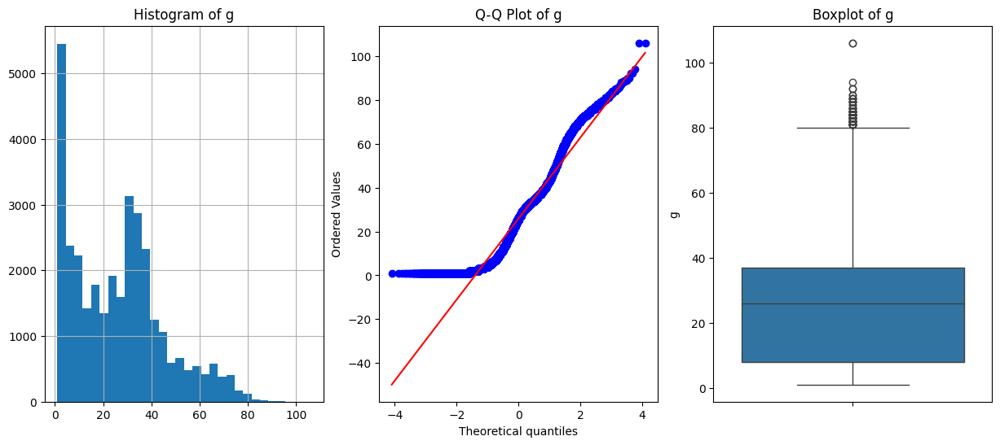

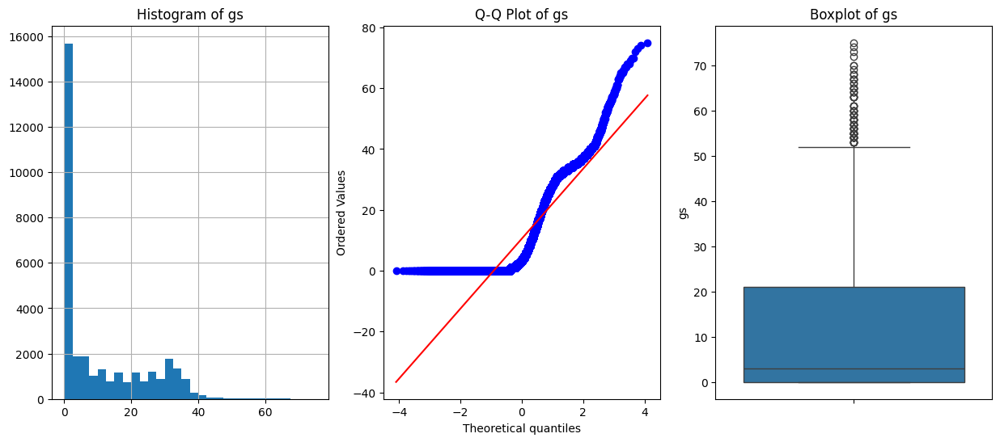

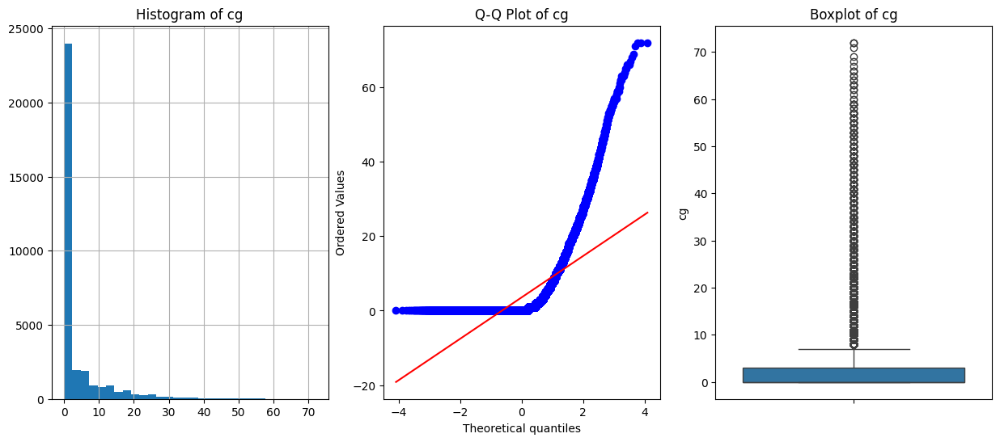

...

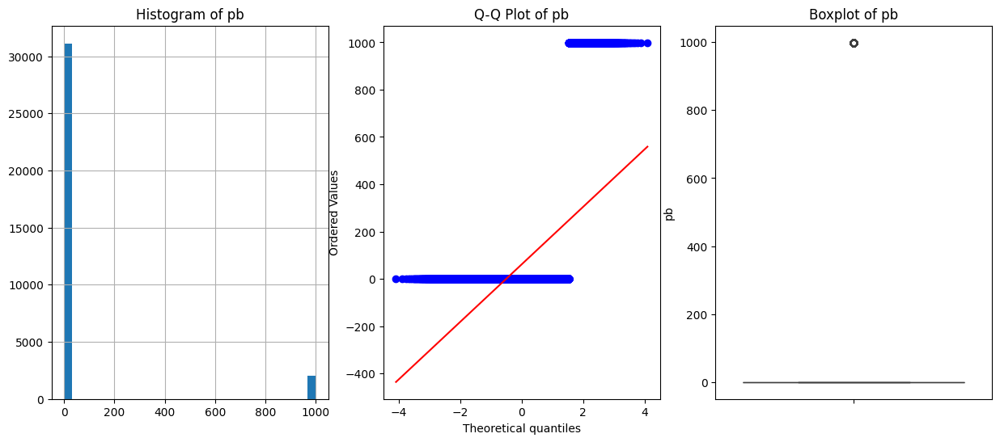

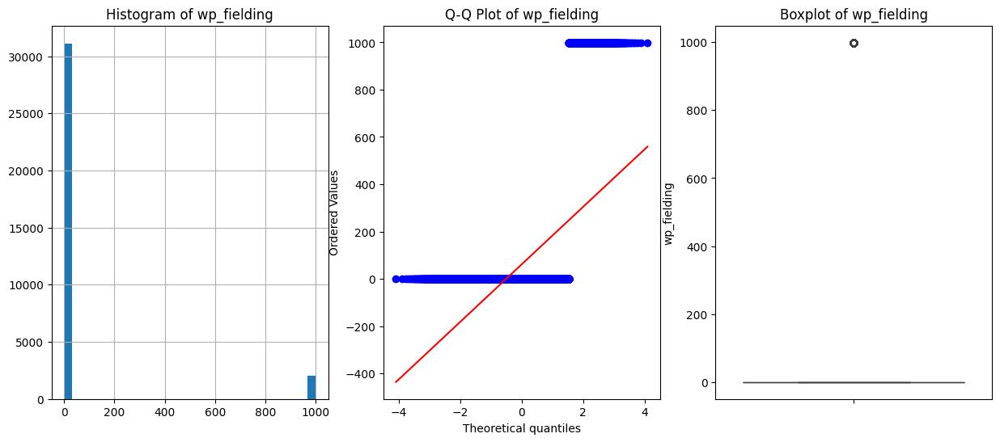

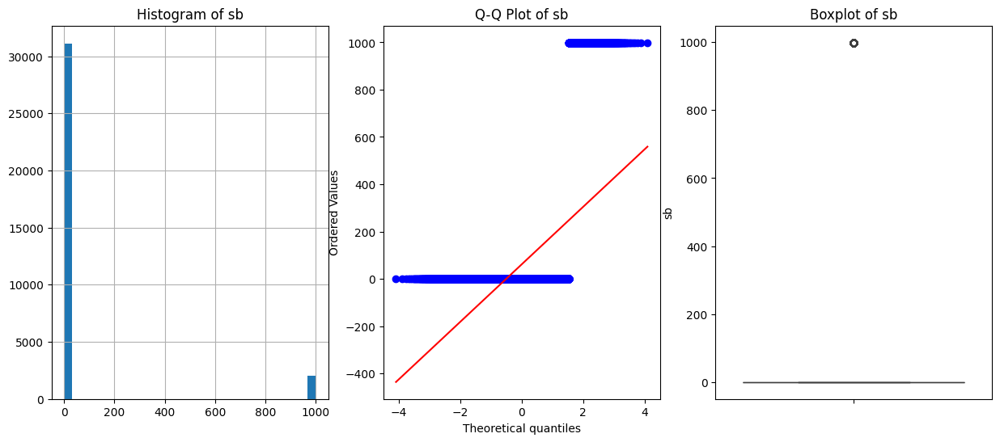

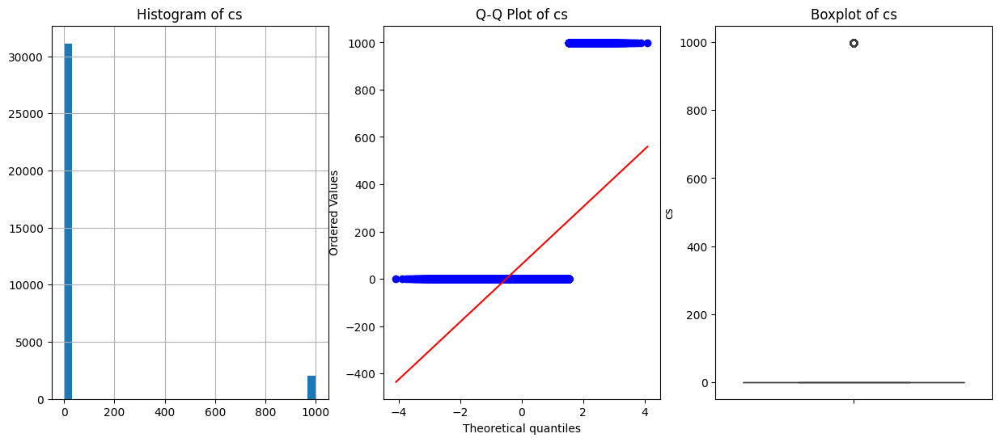

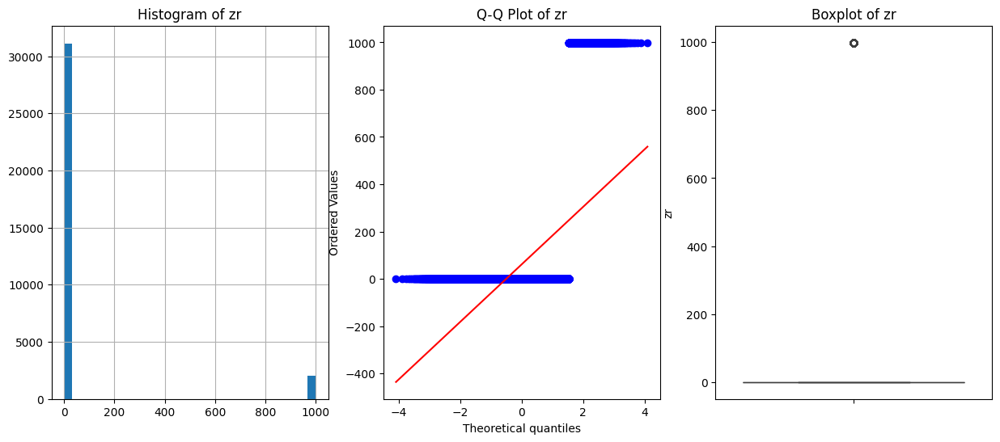

Column round is not numeric.


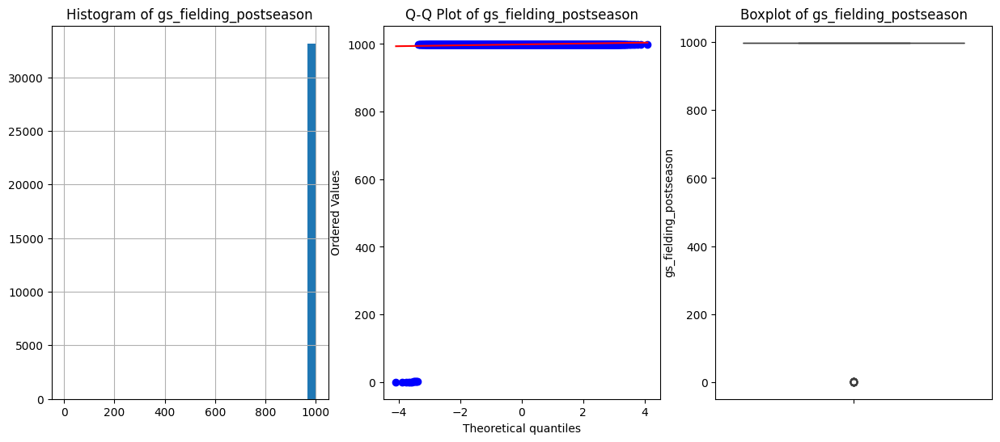

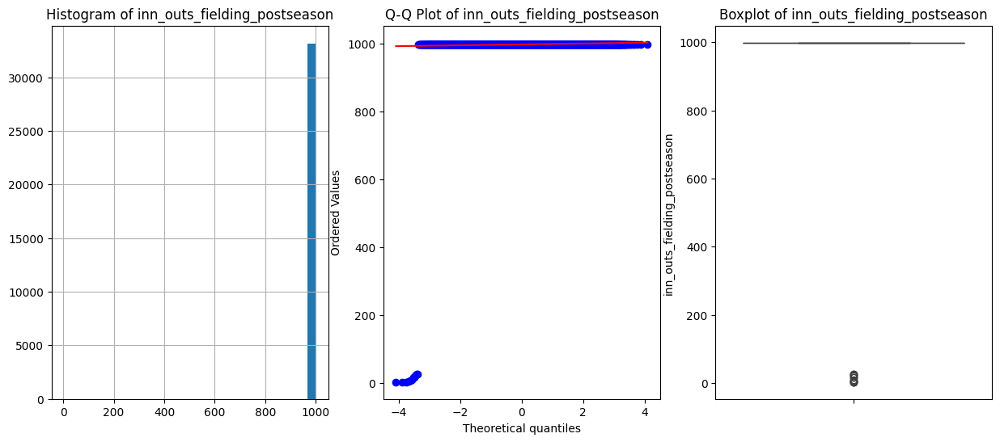

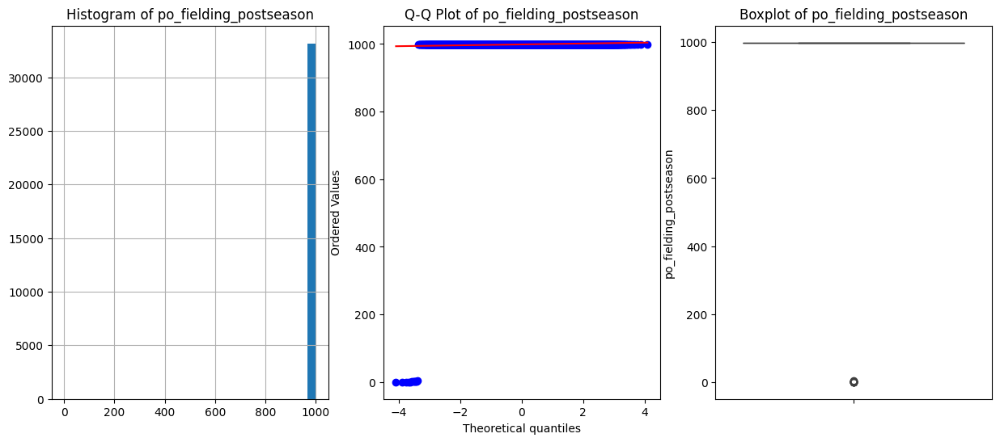

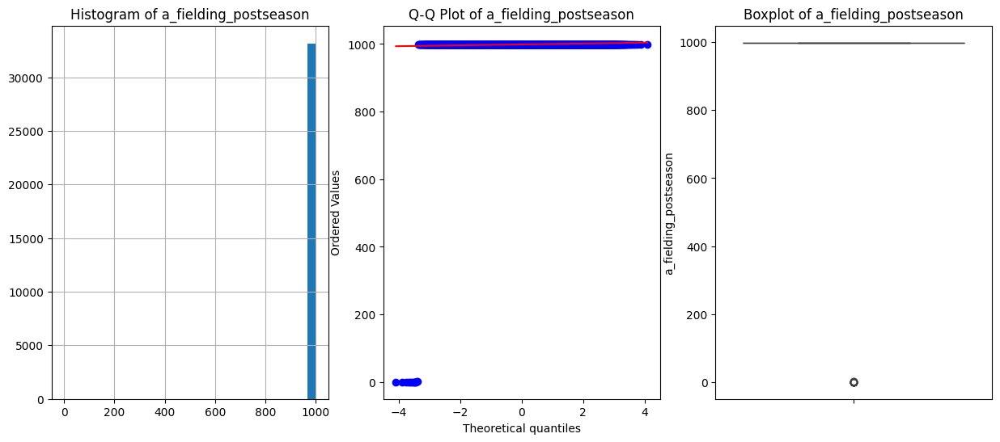

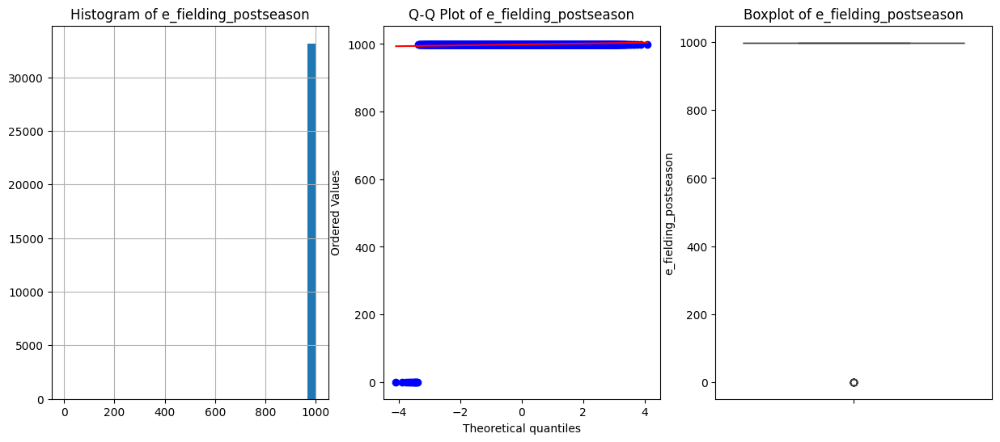

...

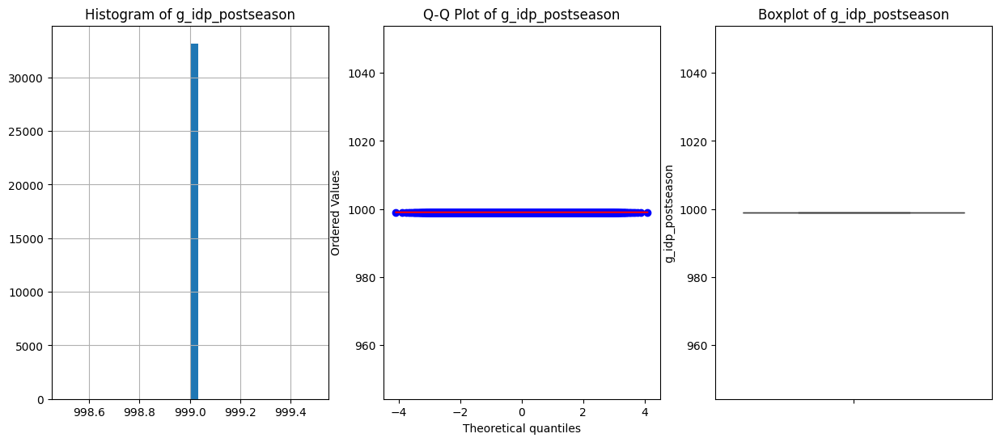

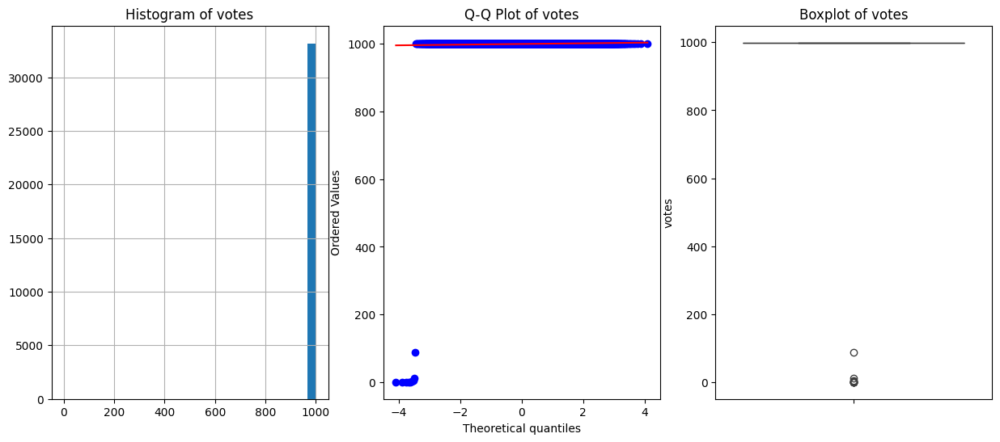

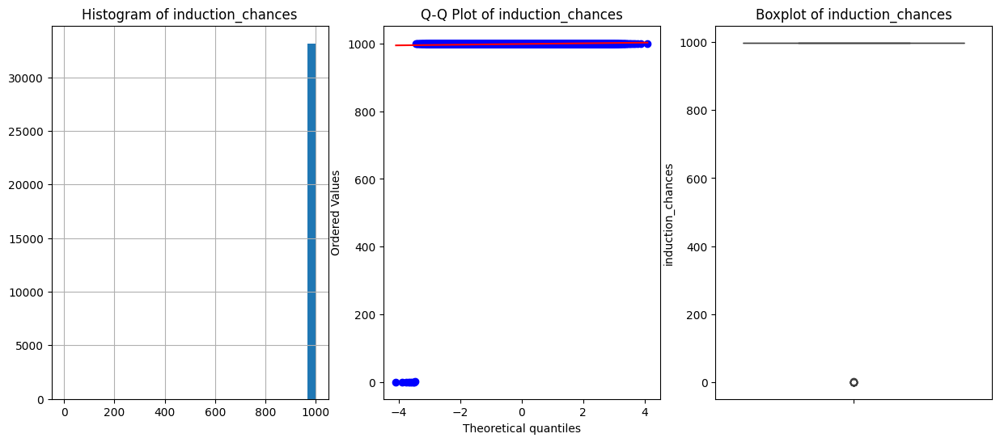

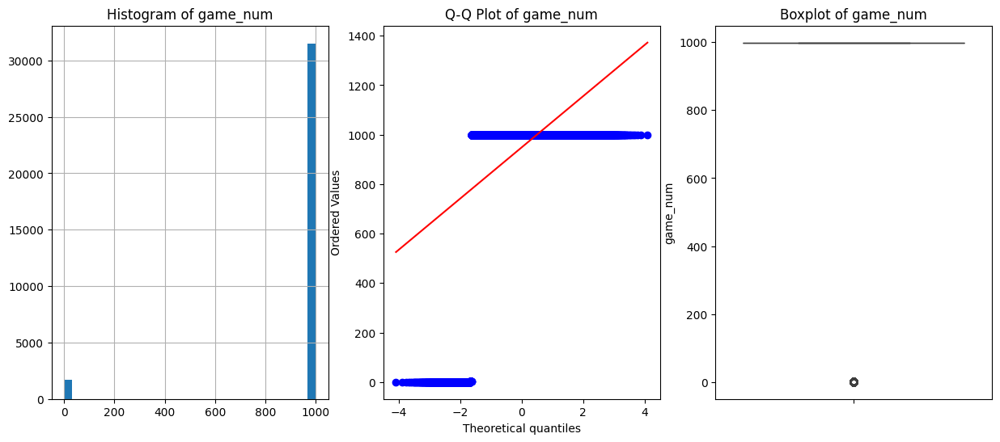

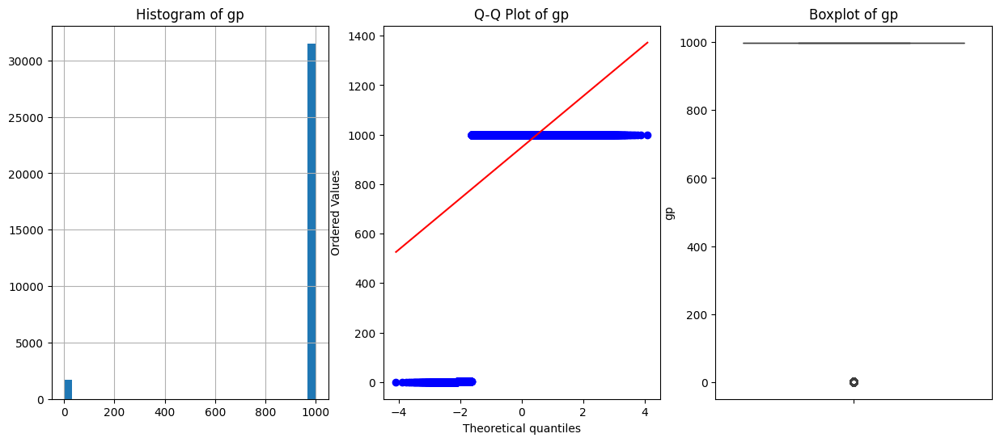

Column award_id is not numeric.


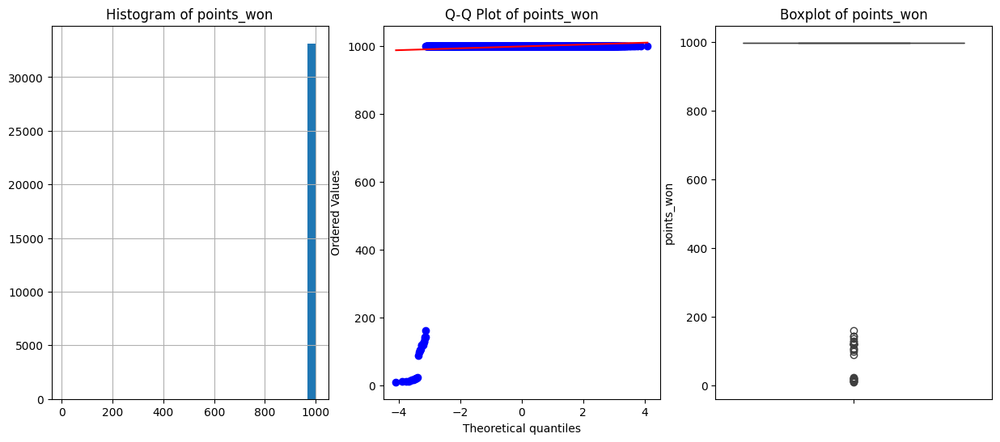

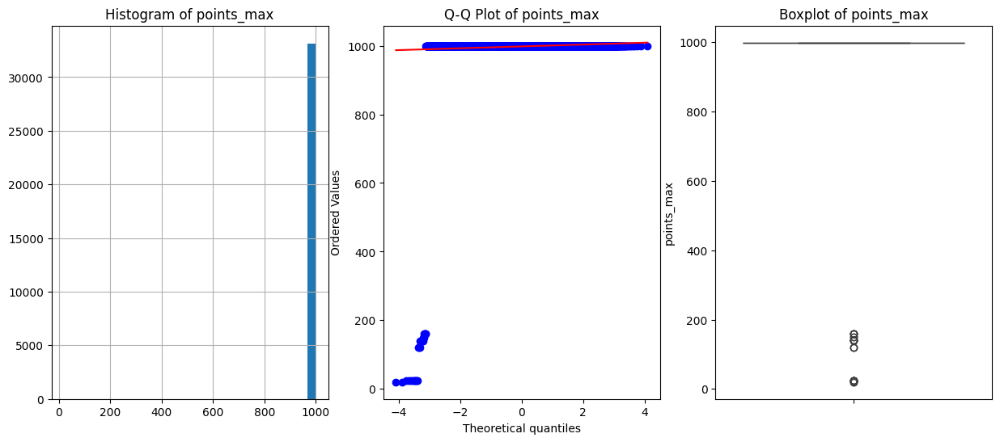

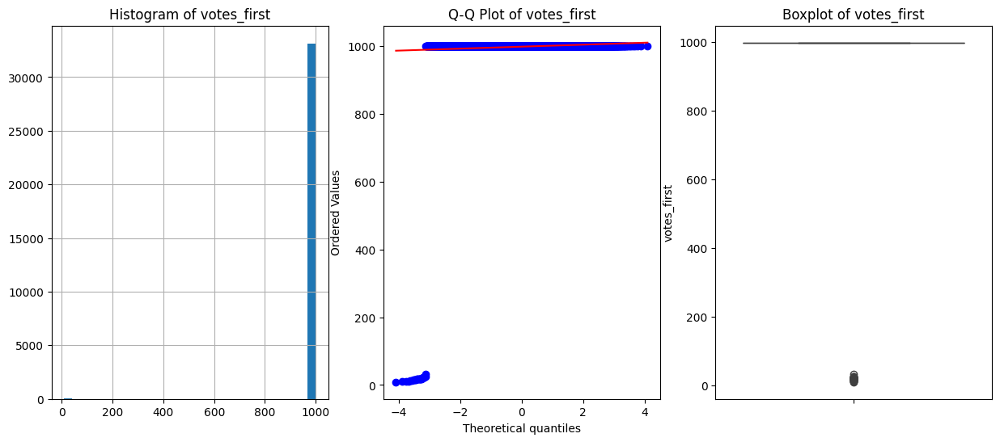

In [1101]:
for variable in X_train_pitching.columns:
    diagnostic_plots(X_train_pitching, variable)

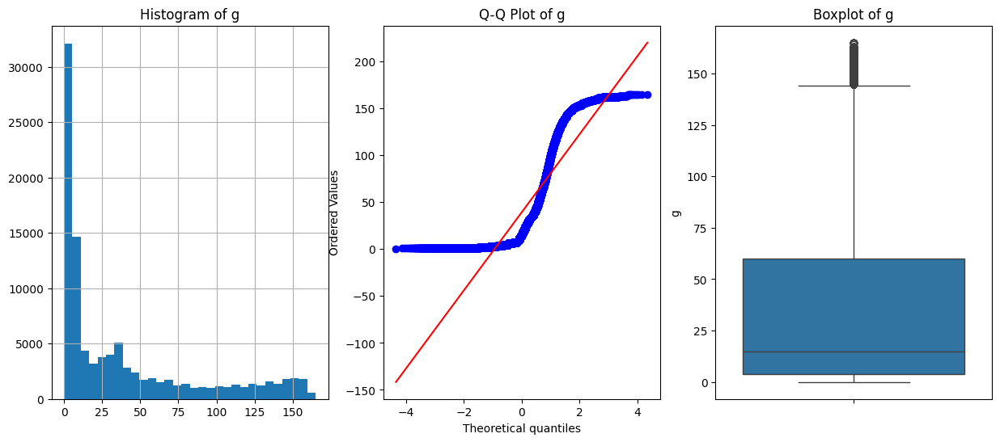

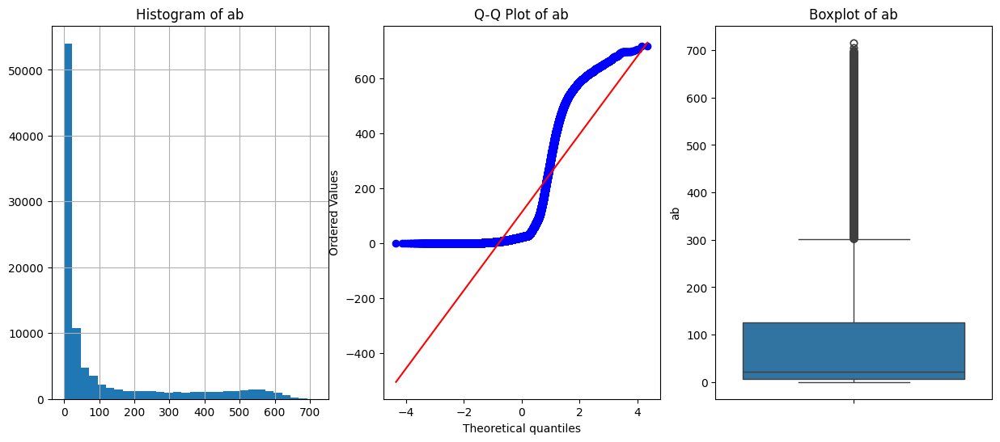

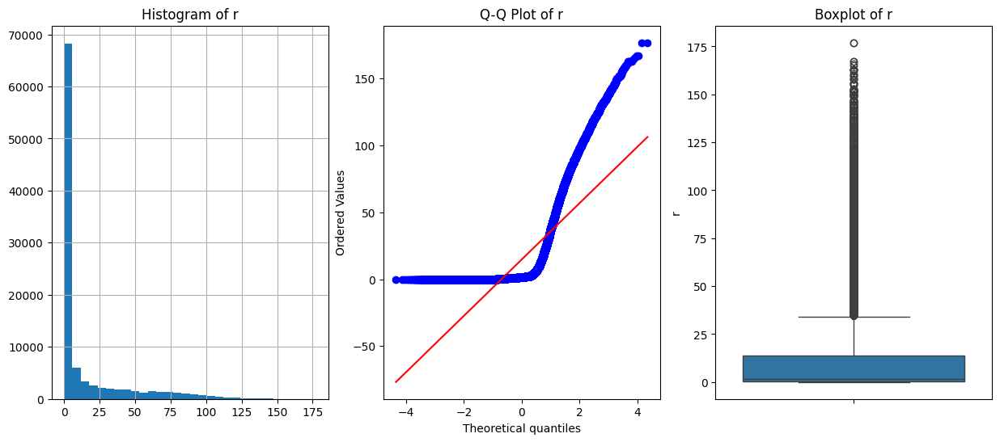

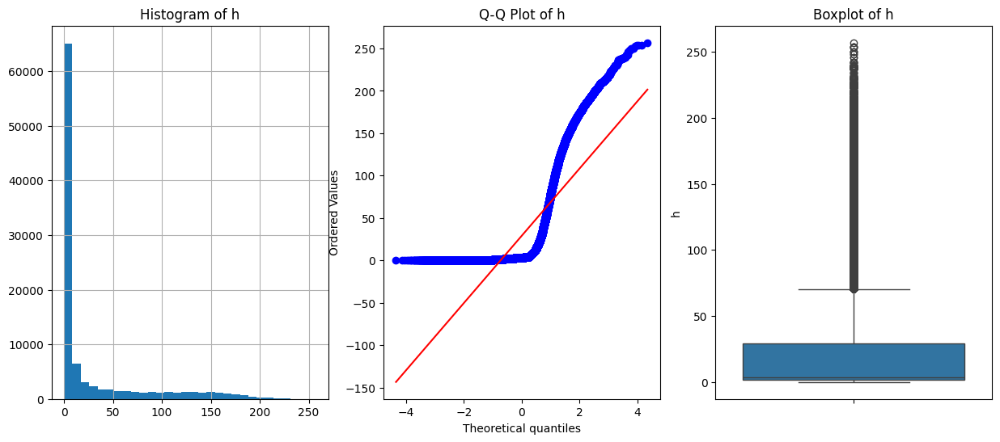

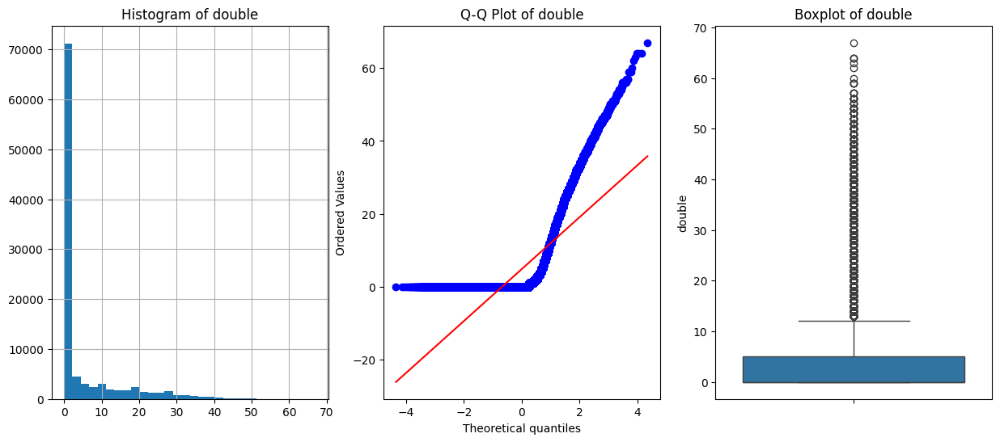

...

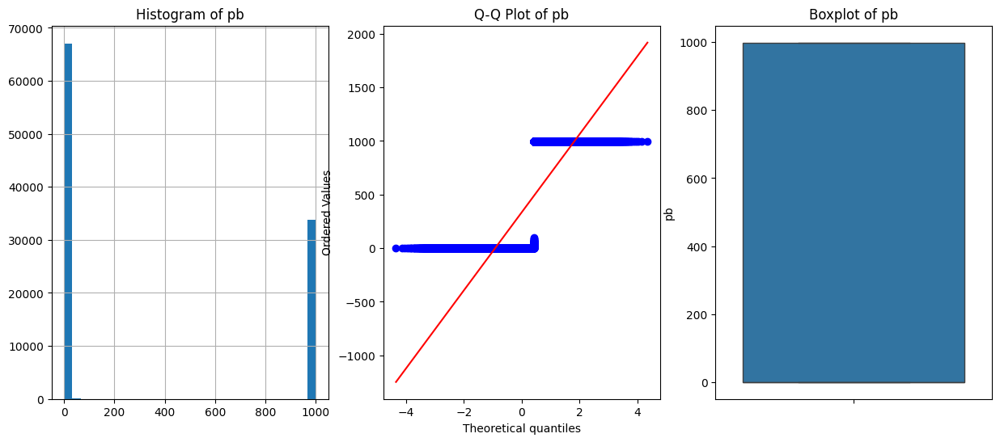

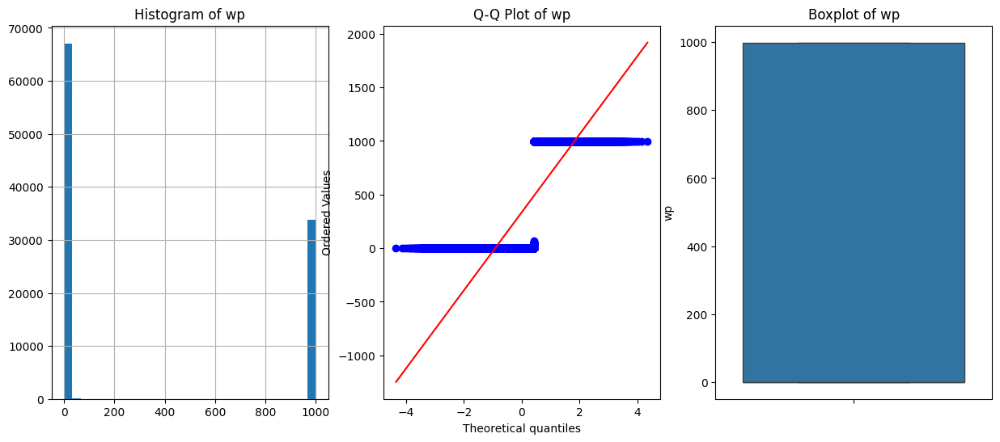

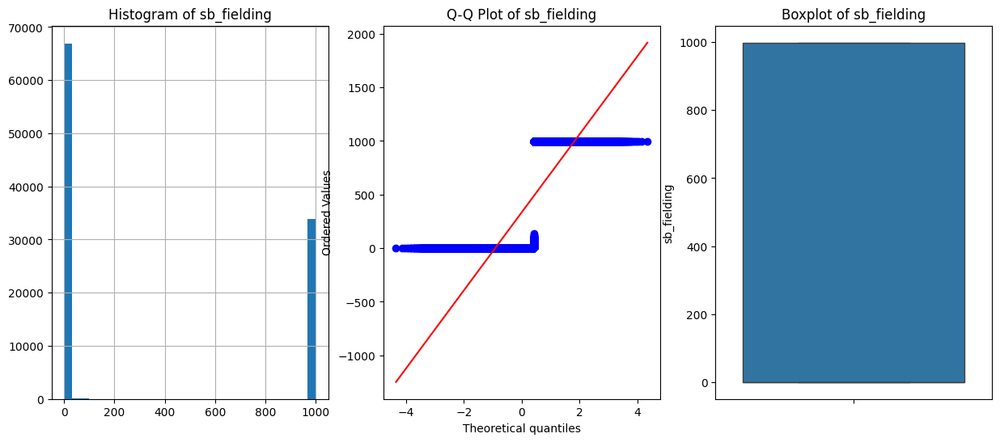

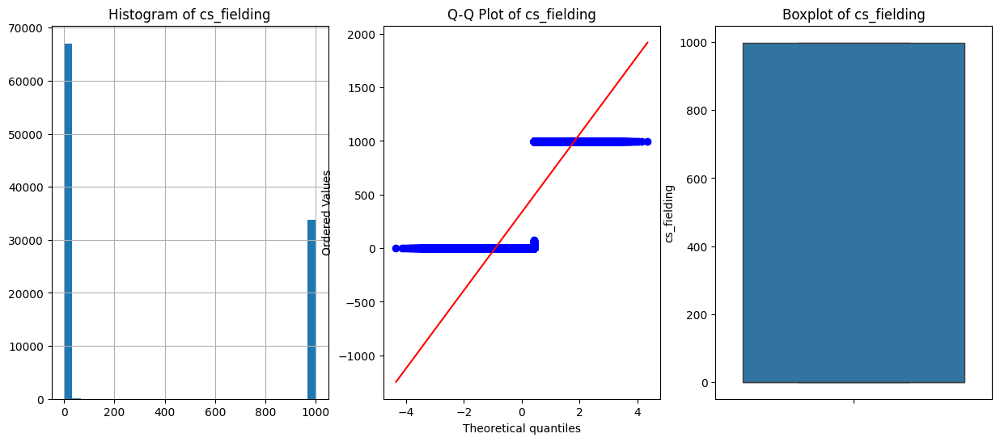

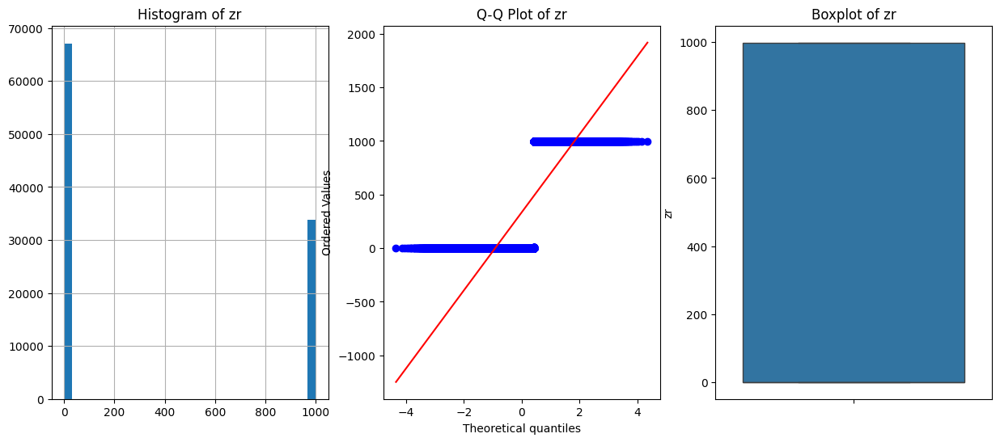

Column round is not numeric.


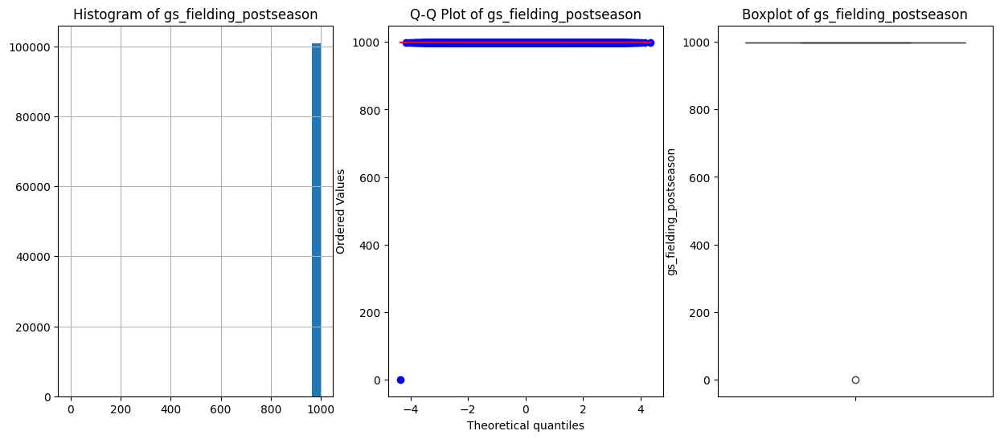

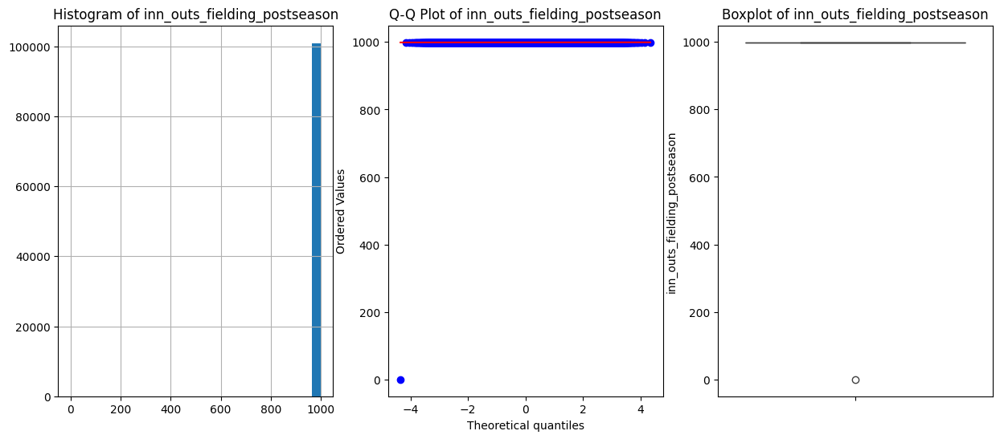

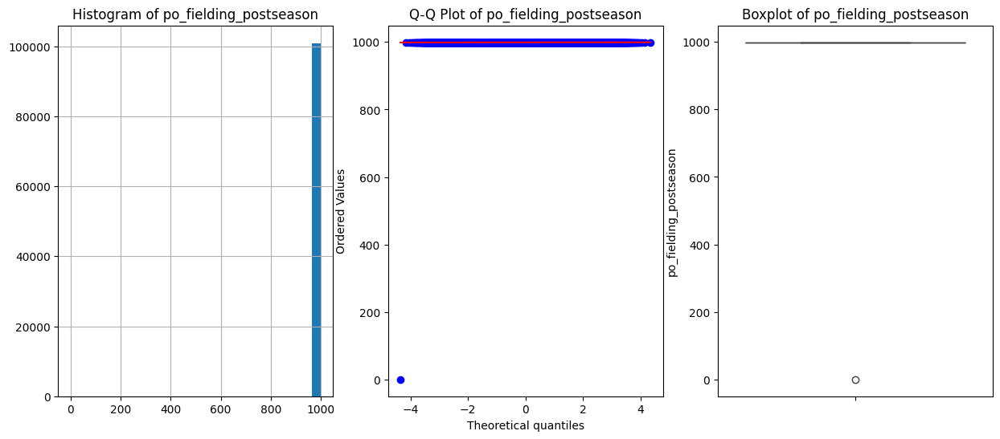

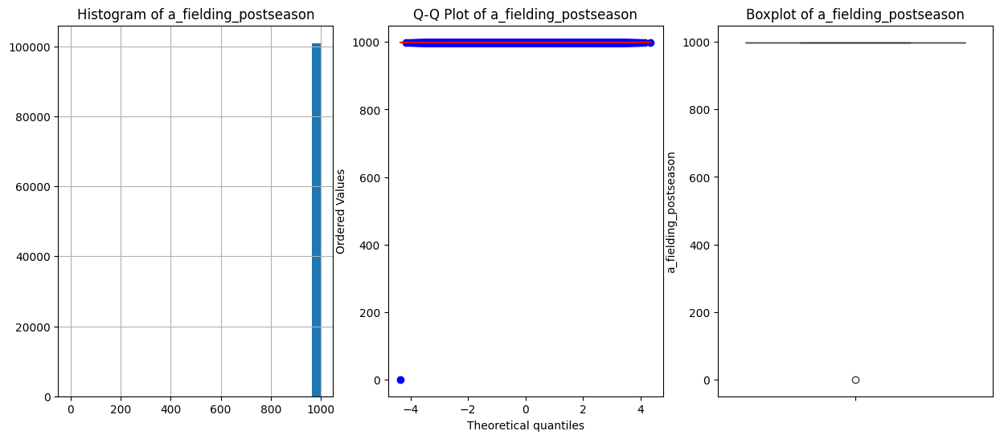

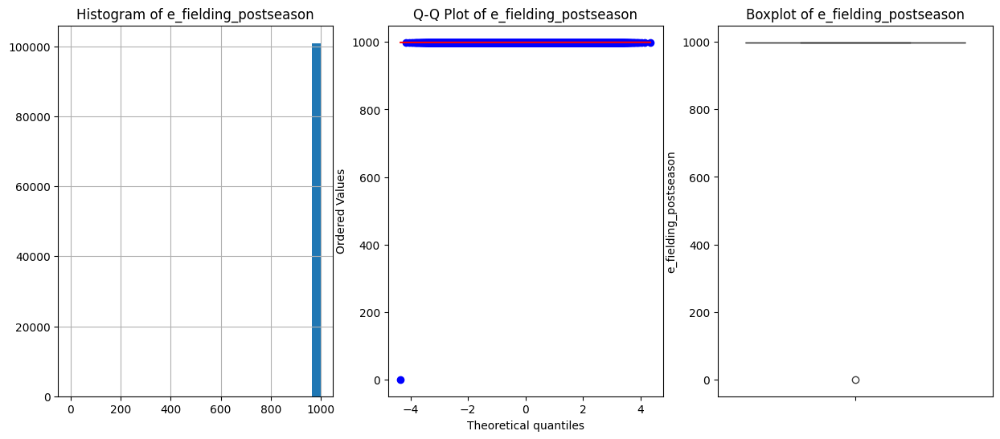

...

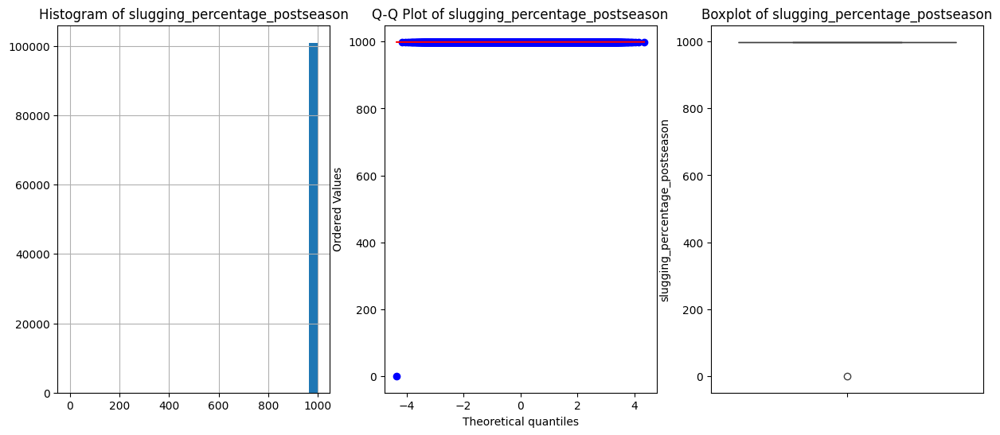

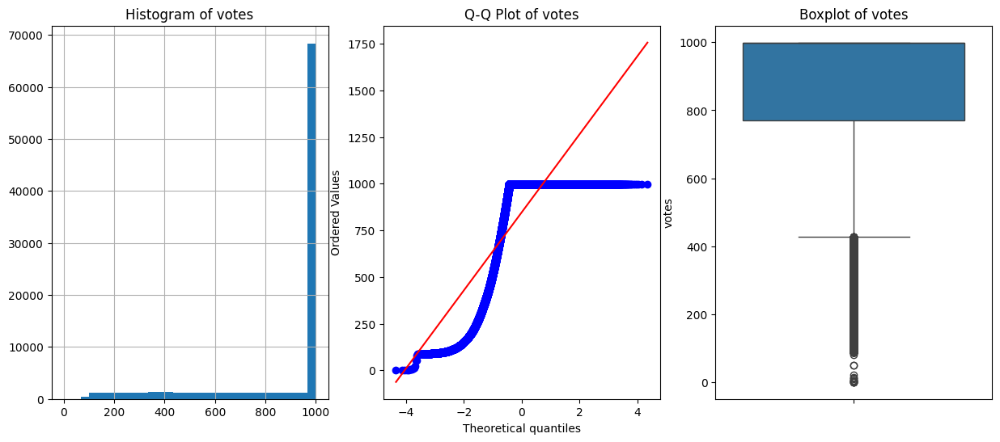

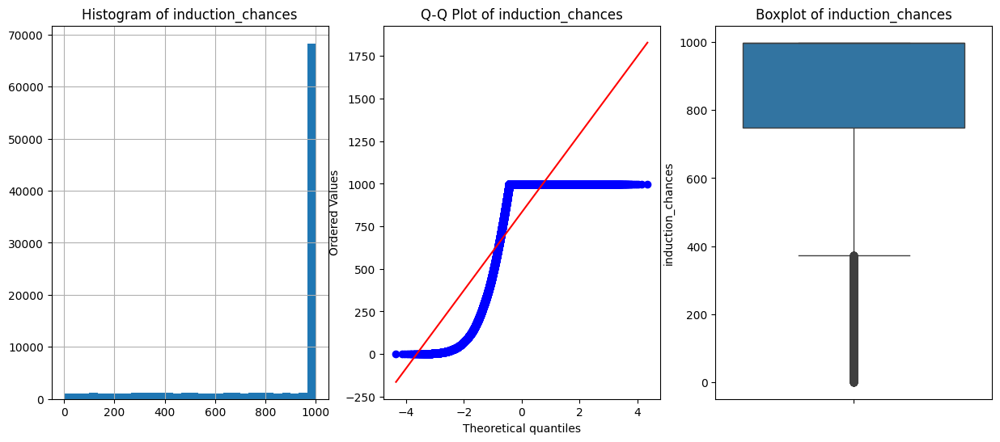

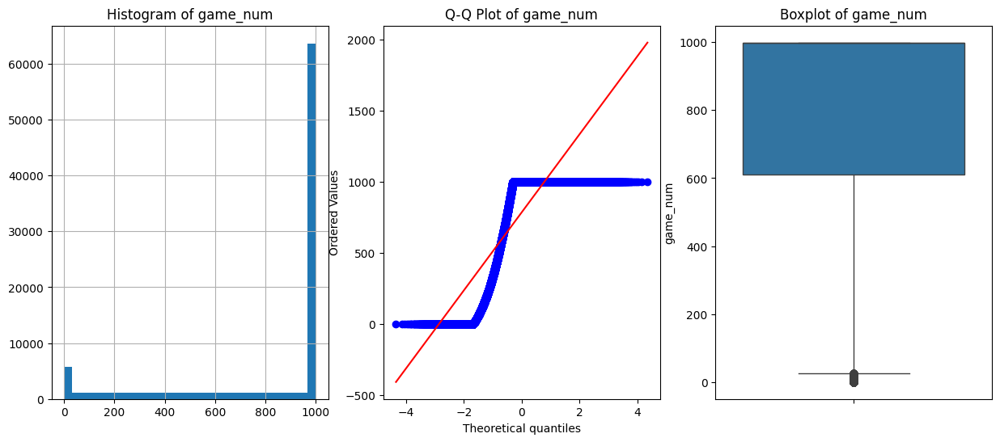

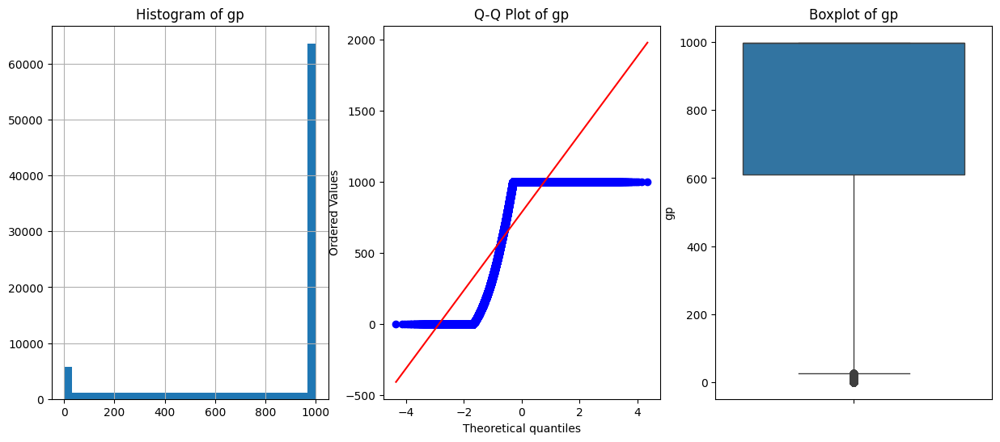

Column award_id is not numeric.


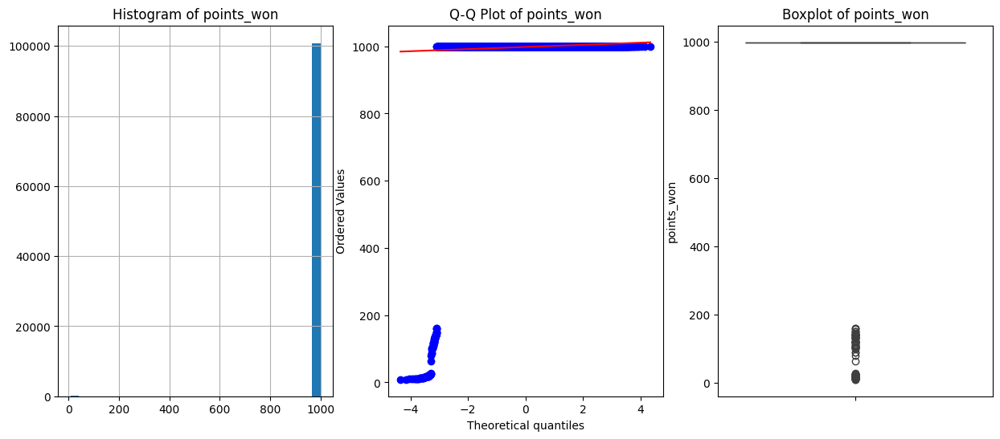

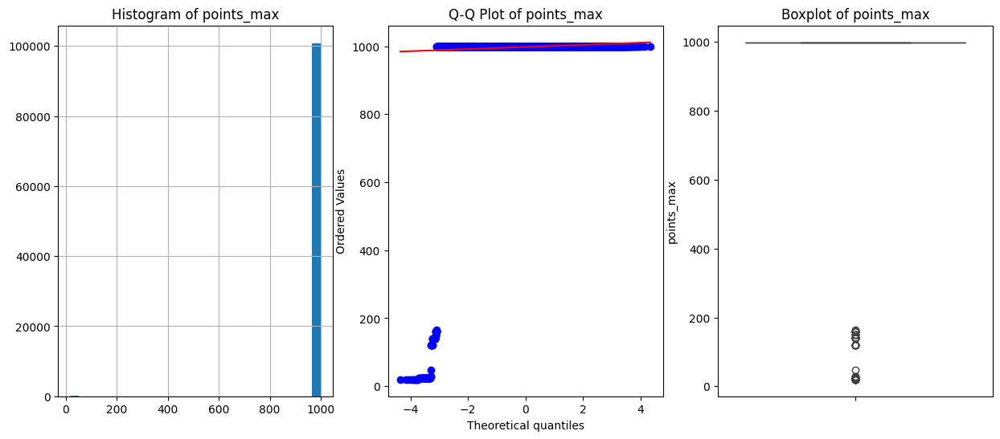

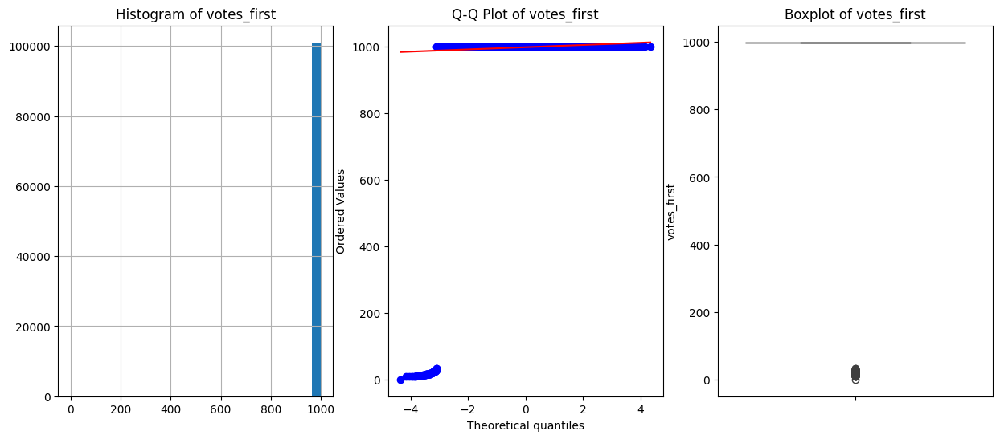

In [1102]:
for variable in X_train_batting.columns:
    diagnostic_plots(X_train_batting, variable)

In [1103]:
print(X_train_batting[num_cols_batting].dtypes)

g                int64
ab             float64
r              float64
h              float64
double         float64
                ...   
game_num       float64
gp             float64
points_won     float64
points_max     float64
votes_first    float64
Length: 65, dtype: object


In [1104]:
print(X_train_pitching[num_cols_pitching].dtypes)

w                int64
l                int64
g                int64
gs               int64
cg               int64
                ...   
game_num       float64
gp             float64
points_won     float64
points_max     float64
votes_first    float64
Length: 78, dtype: object


In [1105]:
# Identify columns with the same number of null values
null_counts = X_train_batting[num_cols_batting].isnull().sum()
common_null_columns = null_counts[null_counts == null_counts.mode()[0]].index.tolist()

# Arbitrary imputation for columns with the same number of null values
for col in common_null_columns:
    X_train_batting[col].fillna(X_train_batting[col].median(), inplace=True)
    X_test_batting[col].fillna(X_train_batting[col].median(), inplace=True)

C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\2672282226.py:7: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_train_batting[col].fillna(X_train_batting[col].median(), inplace=True)
C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\2672282226.py:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always beh

In [1106]:
# Identify columns with the same number of null values
null_counts = X_train_pitching[num_cols_pitching].isnull().sum()
common_null_columns = null_counts[null_counts == null_counts.mode()[0]].index.tolist()

# Arbitrary imputation for columns with the same number of null values
for col in common_null_columns:
    X_train_pitching[col].fillna(X_train_pitching[col].median(), inplace=True)
    X_test_pitching[col].fillna(X_test_pitching[col].median(), inplace=True)

C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\2688925690.py:7: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_train_pitching[col].fillna(X_train_pitching[col].median(), inplace=True)
C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\2688925690.py:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always b

In [1107]:
imputer = MeanMedianImputer(imputation_method='median',
                                   variables=num_cols_pitching)

imputer.fit(X_train_pitching)

MeanMedianImputer(variables=['w', 'l', 'g', 'gs', 'cg', 'sho', 'sv', 'ipouts',
                             'h', 'er', 'hr', 'bb', 'so', 'baopp', 'era', 'ibb',
                             'wp', 'hbp', 'bk', 'bfp', 'gf', 'r', 'sh', 'sf',
                             'g_idp', 'gs_fielding', 'inn_outs', 'po', 'a', 'e', ...])

In [1108]:
X_train_pitching_imputed = imputer.transform(X_train_pitching)
X_test_pitching_imputed = imputer.transform(X_test_pitching)

In [1109]:
imputer2 = MeanMedianImputer(imputation_method='median',
                                   variables=num_cols_batting)

imputer2.fit(X_train_batting)

MeanMedianImputer(variables=['g', 'ab', 'r', 'h', 'double', 'triple', 'hr',
                             'rbi', 'sb', 'cs', 'bb', 'so', 'ibb', 'hbp',
                             'g_idp', 'batting_average', 'on_base_percentage',
                             'slugging_percentage', 'years_since_debut', 'gs',
                             'inn_outs', 'po', 'a', 'e', 'dp', 'pb', 'wp',
                             'sb_fielding', 'cs_fielding', 'zr', ...])

In [1110]:
X_train_batting_imputed = imputer2.transform(X_train_batting)
X_test_batting_imputed = imputer2.transform(X_test_batting)

In [1111]:
# Assuming 'awards' and 'round' are the categorical columns mentioned
X_train_pitching_imputed['award_id'].fillna('No Award', inplace=True)
X_test_pitching_imputed['award_id'].fillna('No Award', inplace=True)
X_train_batting_imputed['award_id'].fillna('No Award', inplace=True)
X_test_batting_imputed['award_id'].fillna('No Award', inplace=True)

C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\1883636644.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_train_pitching_imputed['award_id'].fillna('No Award', inplace=True)
C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\1883636644.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behave

In [1112]:
mode_imputer = mdi.CategoricalImputer(variables=['round'], imputation_method = 'frequent')
mode_imputer.fit(X_train_pitching_imputed)

CategoricalImputer(imputation_method='frequent', variables=['round'])

In [1113]:
X_train_pitching_imputed = mode_imputer.transform(X_train_pitching_imputed)
X_test_pitching_imputed = mode_imputer.transform(X_test_pitching_imputed)

In [1114]:
mode_imputer2 = mdi.CategoricalImputer(variables=['round'], imputation_method = 'frequent')
mode_imputer2.fit(X_train_batting_imputed)

CategoricalImputer(imputation_method='frequent', variables=['round'])

In [1115]:
X_train_batting_imputed = mode_imputer2.transform(X_train_batting_imputed)
X_test_batting_imputed = mode_imputer2.transform(X_test_batting_imputed)

In [1116]:
X_train_batting_imputed.isnull().sum()

g              0
ab             0
r              0
h              0
double         0
              ..
gp             0
award_id       0
points_won     0
points_max     0
votes_first    0
Length: 67, dtype: int64

In [1117]:
X_test_batting_imputed.isnull().sum()

g              0
ab             0
r              0
h              0
double         0
              ..
gp             0
award_id       0
points_won     0
points_max     0
votes_first    0
Length: 67, dtype: int64

In [1118]:
X_train_pitching_imputed.isnull().sum()

w              0
l              0
g              0
gs             0
cg             0
              ..
gp             0
award_id       0
points_won     0
points_max     0
votes_first    0
Length: 80, dtype: int64

In [1119]:
X_test_pitching_imputed.isnull().sum()

w              0
l              0
g              0
gs             0
cg             0
              ..
gp             0
award_id       0
points_won     0
points_max     0
votes_first    0
Length: 80, dtype: int64

In [1120]:
X_train_batting_imputed[num_cols_batting].dtypes

g                int64
ab             float64
r              float64
h              float64
double         float64
                ...   
game_num       float64
gp             float64
points_won     float64
points_max     float64
votes_first    float64
Length: 65, dtype: object

In [1121]:
X_train_pitching_imputed[num_cols_pitching].dtypes

w                int64
l                int64
g                int64
gs               int64
cg               int64
                ...   
game_num       float64
gp             float64
points_won     float64
points_max     float64
votes_first    float64
Length: 78, dtype: object

In [1122]:
yjt = YeoJohnsonTransformer(variables=num_cols_pitching)

In [1123]:
yjt.fit(X_train_pitching_imputed)

YeoJohnsonTransformer(variables=['w', 'l', 'g', 'gs', 'cg', 'sho', 'sv',
                                 'ipouts', 'h', 'er', 'hr', 'bb', 'so', 'baopp',
                                 'era', 'ibb', 'wp', 'hbp', 'bk', 'bfp', 'gf',
                                 'r', 'sh', 'sf', 'g_idp', 'gs_fielding',
                                 'inn_outs', 'po', 'a', 'e', ...])

In [1124]:
X_train_pitching_transformed = yjt.transform(X_train_pitching_imputed)
X_test_pitching_transformed = yjt.transform(X_test_pitching_imputed)

In [1125]:
yjt2 = YeoJohnsonTransformer(variables=num_cols_batting)

In [1126]:
yjt2.fit(X_train_batting_imputed)

YeoJohnsonTransformer(variables=['g', 'ab', 'r', 'h', 'double', 'triple', 'hr',
                                 'rbi', 'sb', 'cs', 'bb', 'so', 'ibb', 'hbp',
                                 'g_idp', 'batting_average',
                                 'on_base_percentage', 'slugging_percentage',
                                 'years_since_debut', 'gs', 'inn_outs', 'po',
                                 'a', 'e', 'dp', 'pb', 'wp', 'sb_fielding',
                                 'cs_fielding', 'zr', ...])

In [1127]:
X_train_batting_transformed = yjt2.transform(X_train_batting_imputed)
X_test_batting_transformed = yjt2.transform(X_test_batting_imputed)

In [1128]:
# Function to plot original vs transformed data
def plot_transformation_comparison(original_data, transformed_data, variable_name):
    plt.figure(figsize=(14, 6))
    
    # Plot original data distribution
    plt.subplot(1, 2, 1)
    sns.histplot(original_data[variable_name], kde=True, color='blue')
    plt.title(f'Original {variable_name}')
    
    # Plot transformed data distribution
    plt.subplot(1, 2, 2)
    sns.histplot(transformed_data[variable_name], kde=True, color='green')
    plt.title(f'Transformed {variable_name}')
    
    plt.show()

In [1129]:
num_cols_batting

['g',
 'ab',
 'r',
 'h',
 'double',
 'triple',
 'hr',
 'rbi',
 'sb',
 'cs',
 'bb',
 'so',
 'ibb',
 'hbp',
 'g_idp',
 'batting_average',
 'on_base_percentage',
 'slugging_percentage',
 'years_since_debut',
 'gs',
 'inn_outs',
 'po',
 'a',
 'e',
 'dp',
 'pb',
 'wp',
 'sb_fielding',
 'cs_fielding',
 'zr',
 'gs_fielding_postseason',
 'inn_outs_fielding_postseason',
 'po_fielding_postseason',
 'a_fielding_postseason',
 'e_fielding_postseason',
 'dp_fielding_postseason',
 'tp',
 'pb_fielding_postseason',
 'sb_fielding_postseason',
 'cs_fielding_postseason',
 'g_postseason',
 'ab_postseason',
 'r_postseason',
 'h_postseason',
 'double_postseason',
 'triple_postseason',
 'hr_postseason',
 'rbi_postseason',
 'sb_postseason',
 'cs_postseason',
 'bb_postseason',
 'so_postseason',
 'ibb_postseason',
 'hbp_postseason',
 'g_idp_postseason',
 'batting_average_postseason',
 'on_base_percentage_postseason',
 'slugging_percentage_postseason',
 'votes',
 'induction_chances',
 'game_num',
 'gp',
 'points_

Comparing original and transformed distributions for g


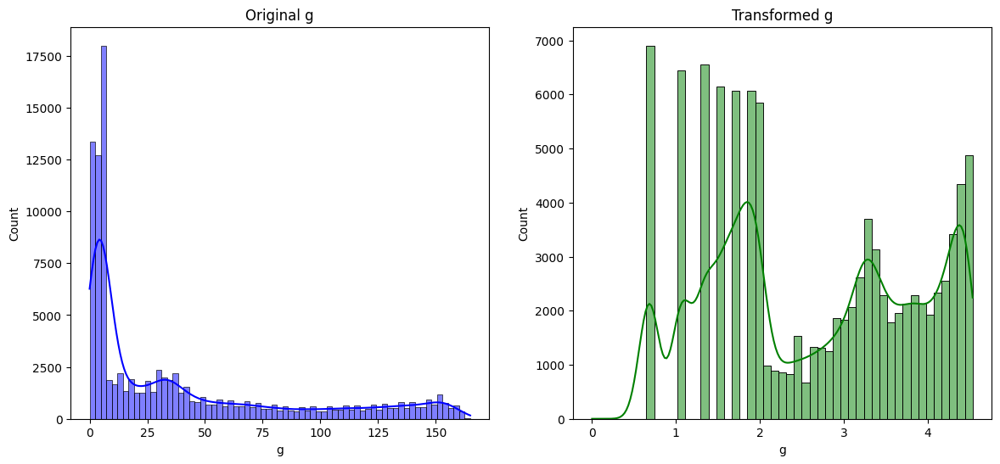

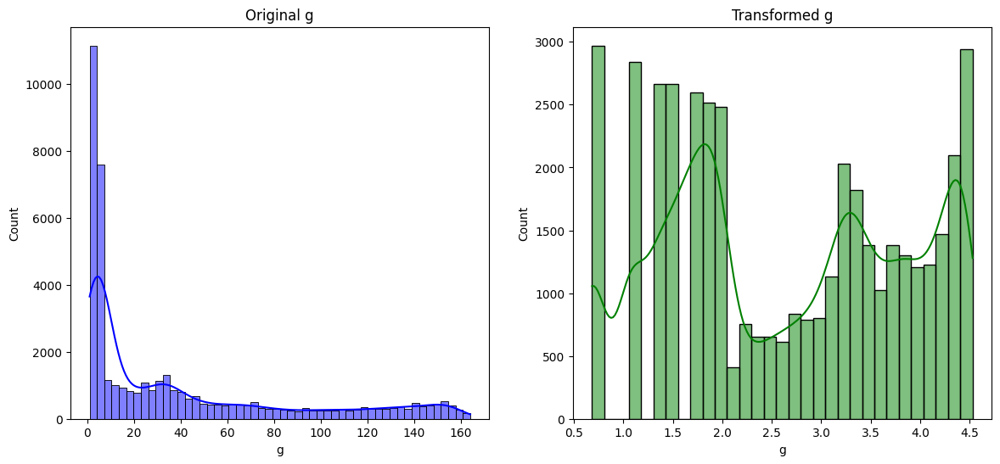

Comparing original and transformed distributions for ab


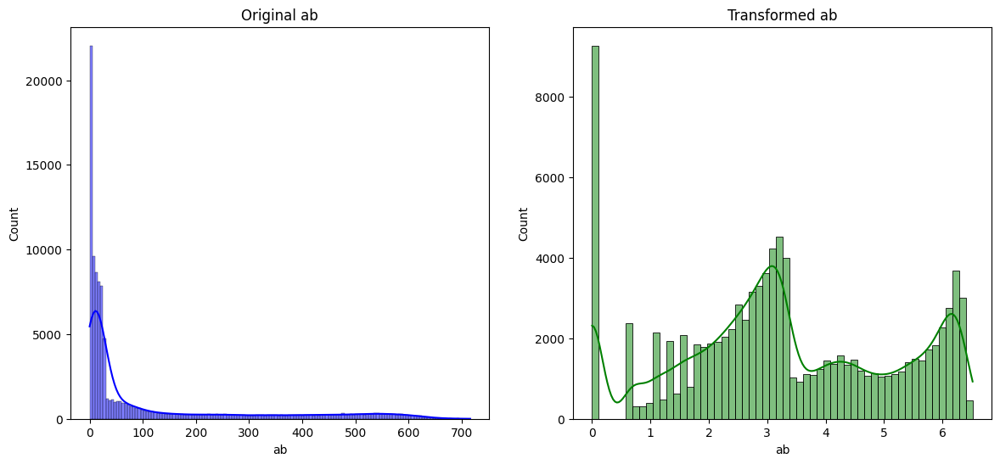

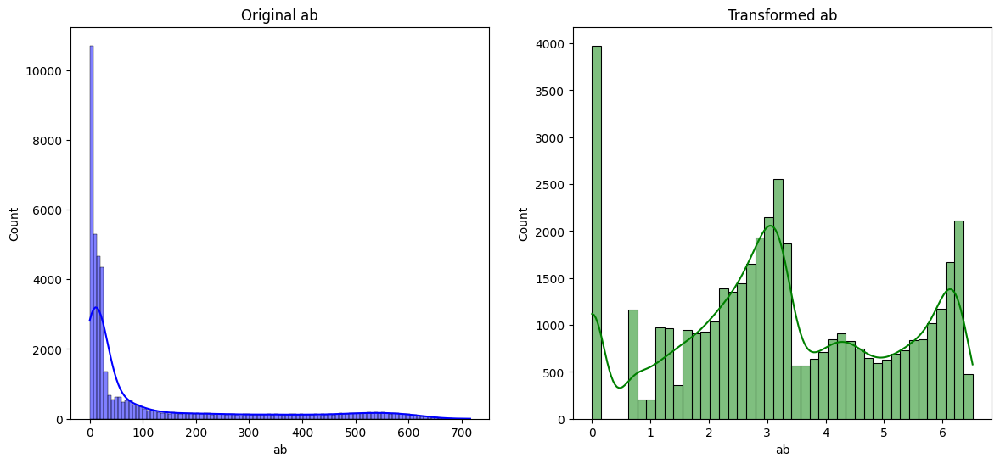

Comparing original and transformed distributions for r


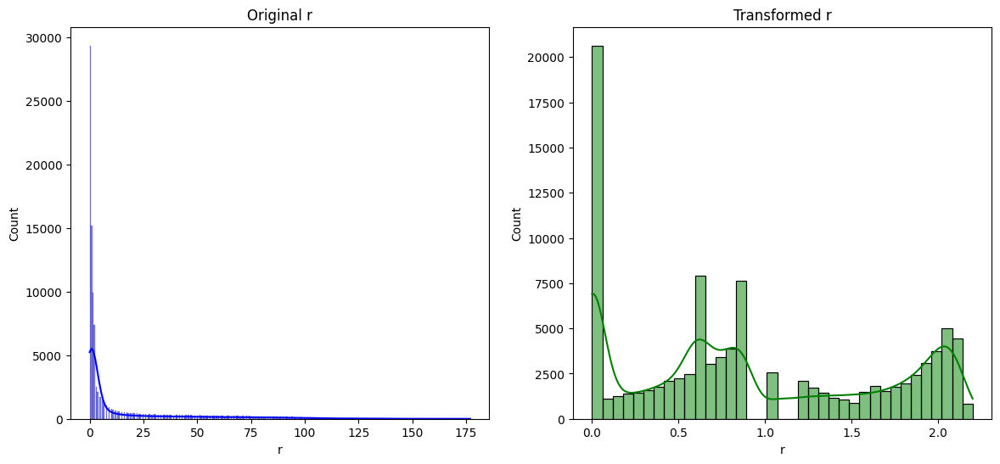

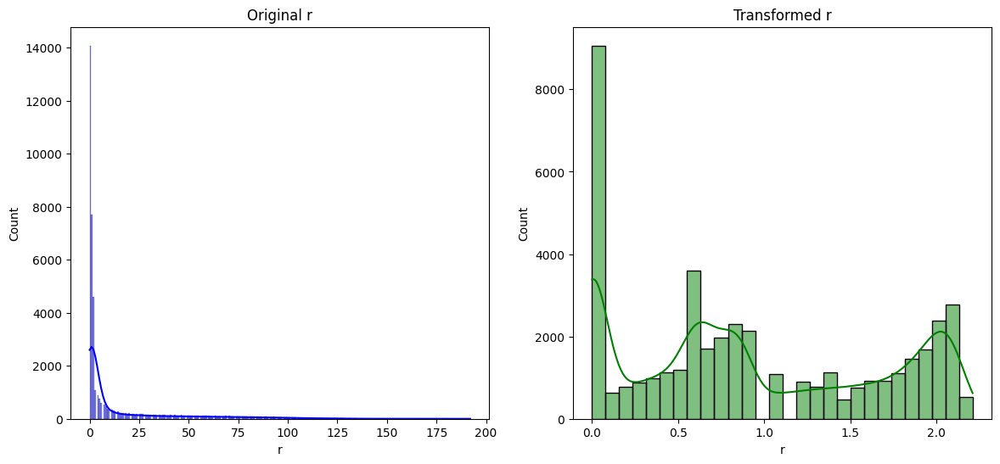

Comparing original and transformed distributions for h


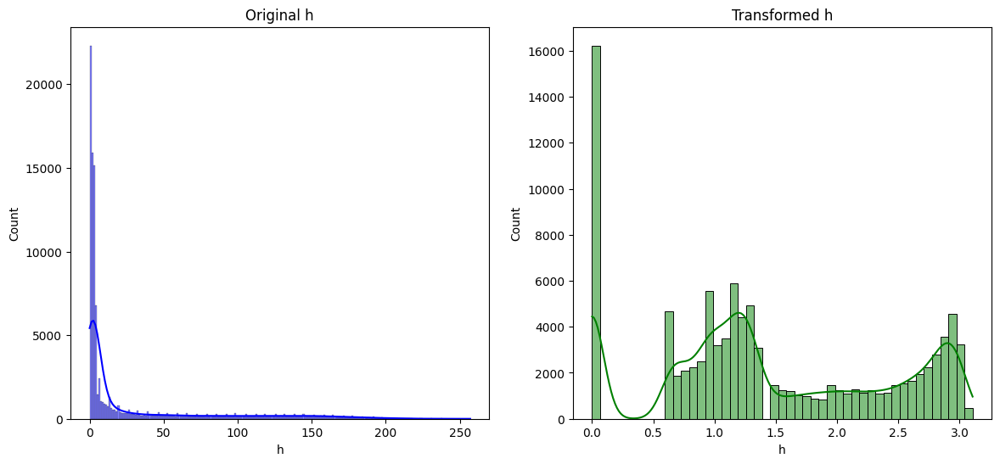

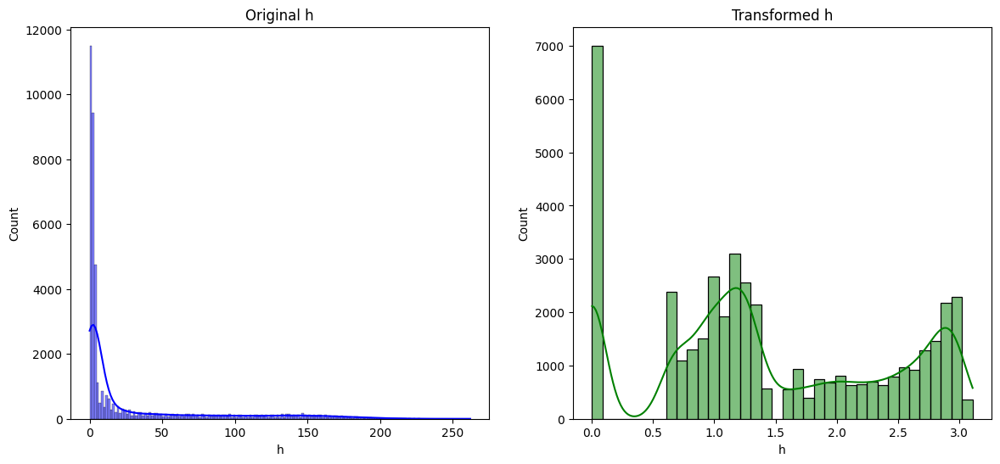

Comparing original and transformed distributions for double


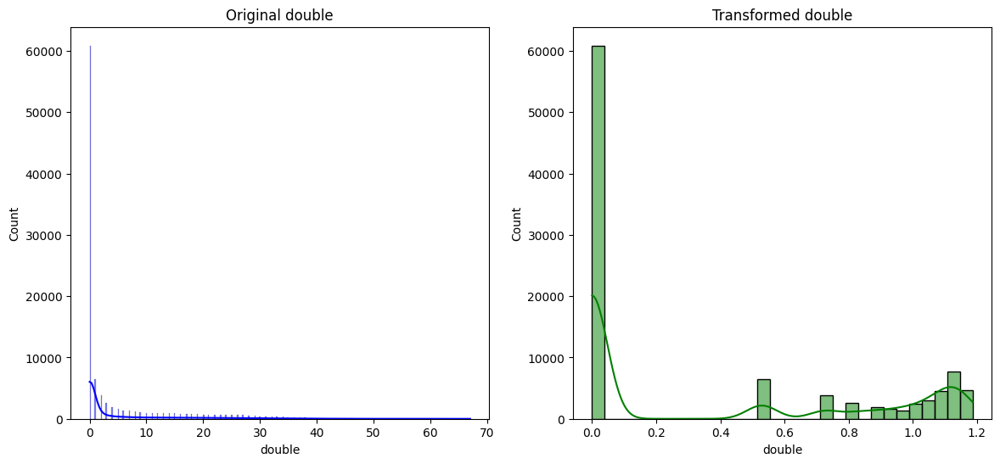

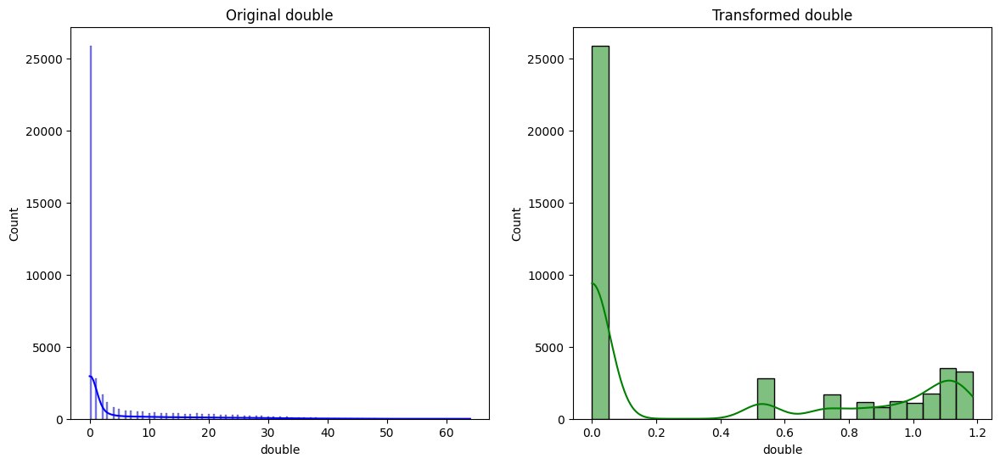

Comparing original and transformed distributions for triple


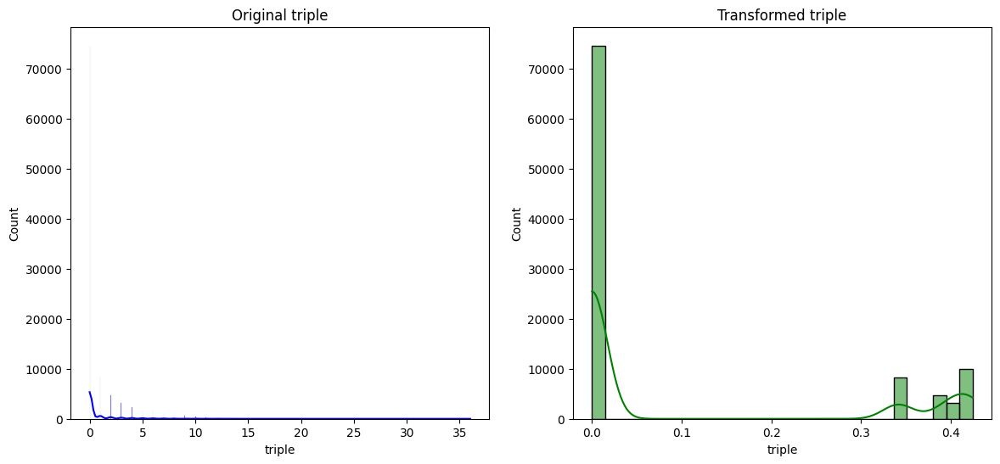

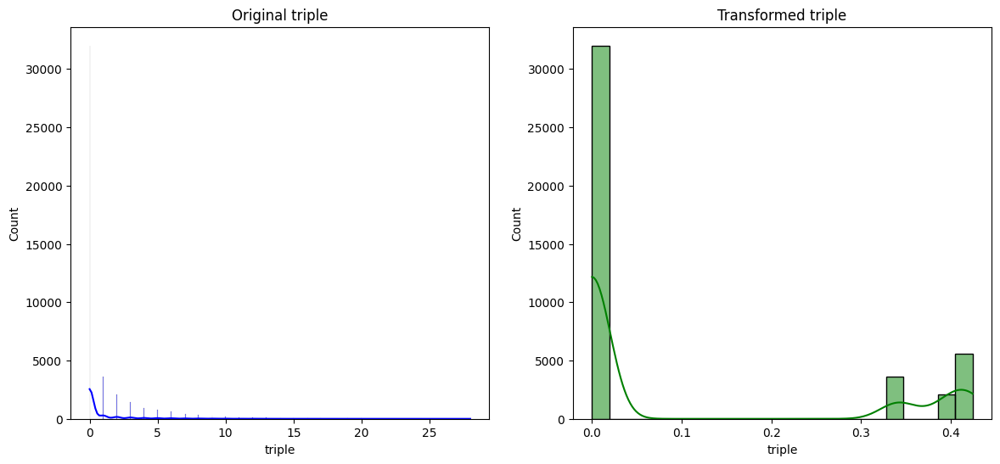

Comparing original and transformed distributions for hr


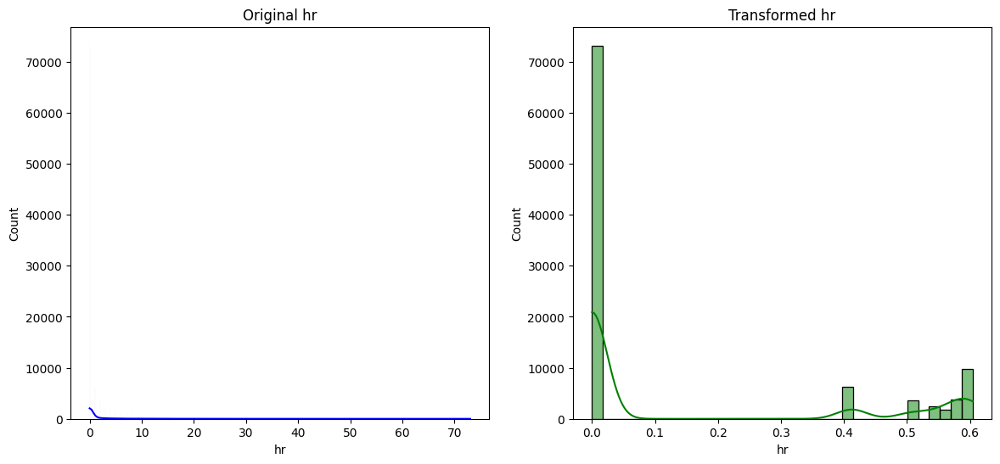

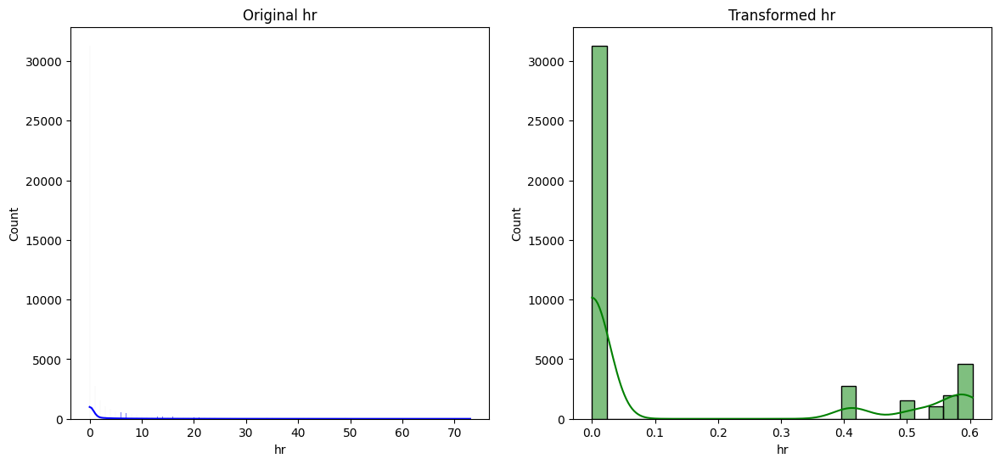

Comparing original and transformed distributions for rbi


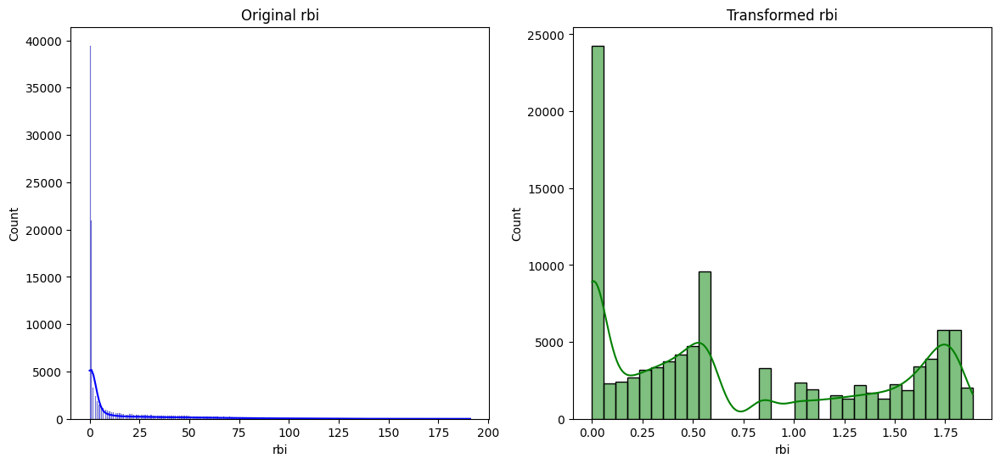

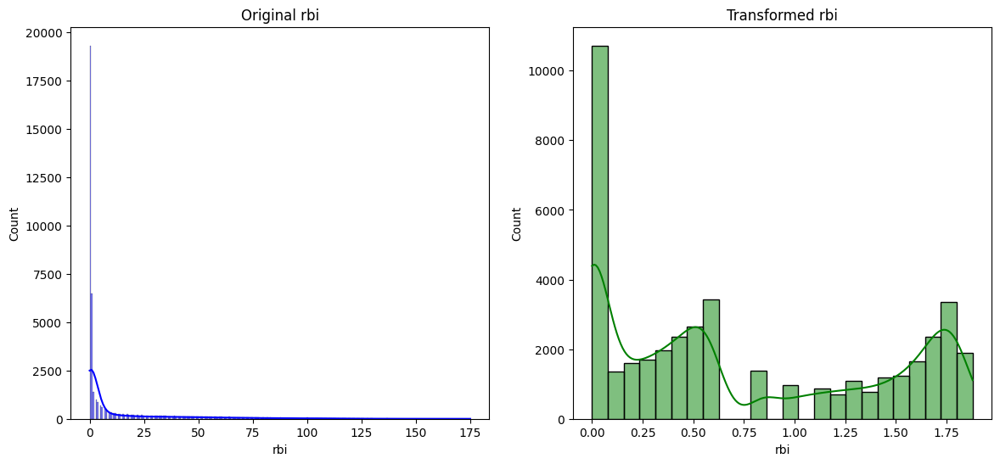

Comparing original and transformed distributions for sb


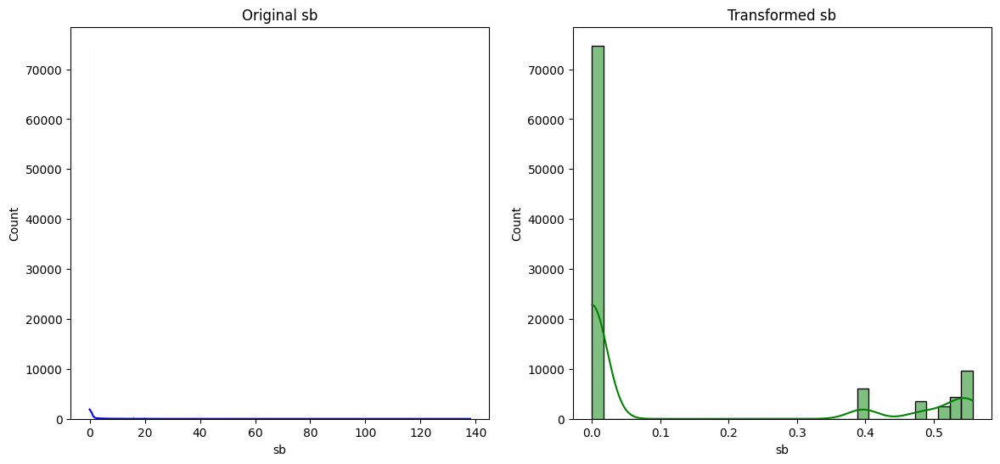

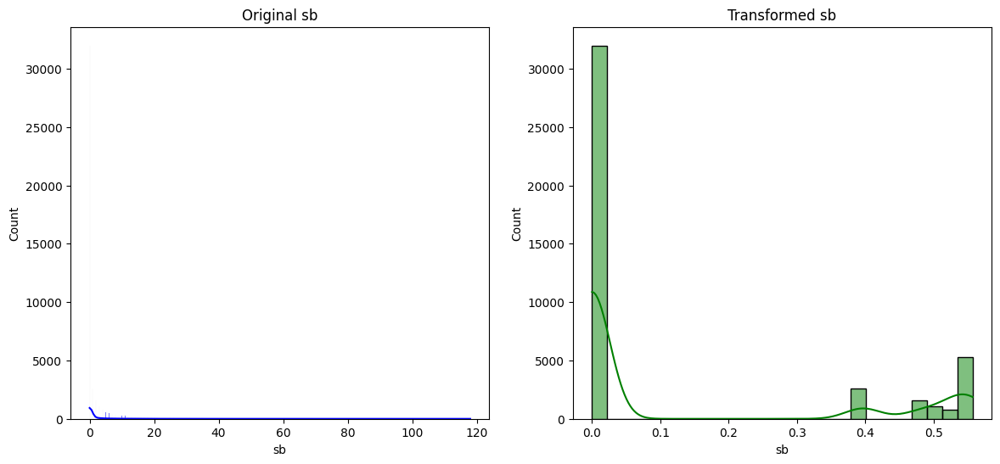

Comparing original and transformed distributions for cs


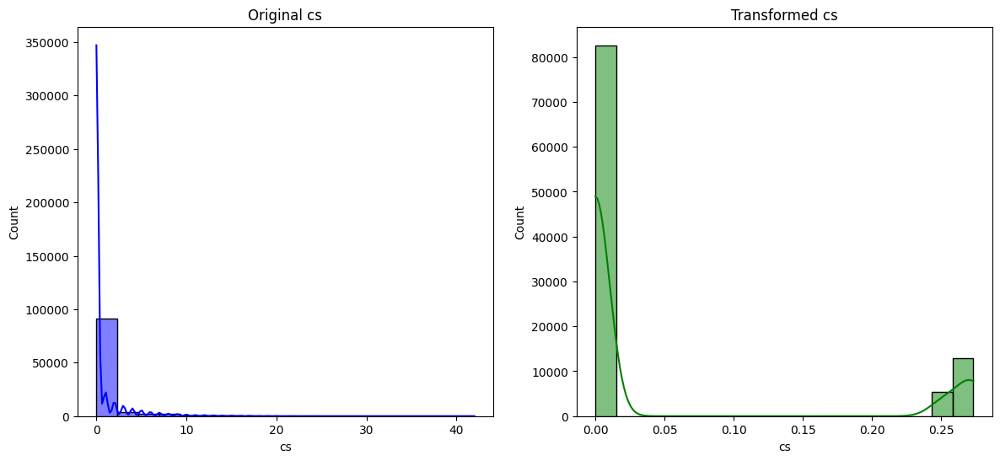

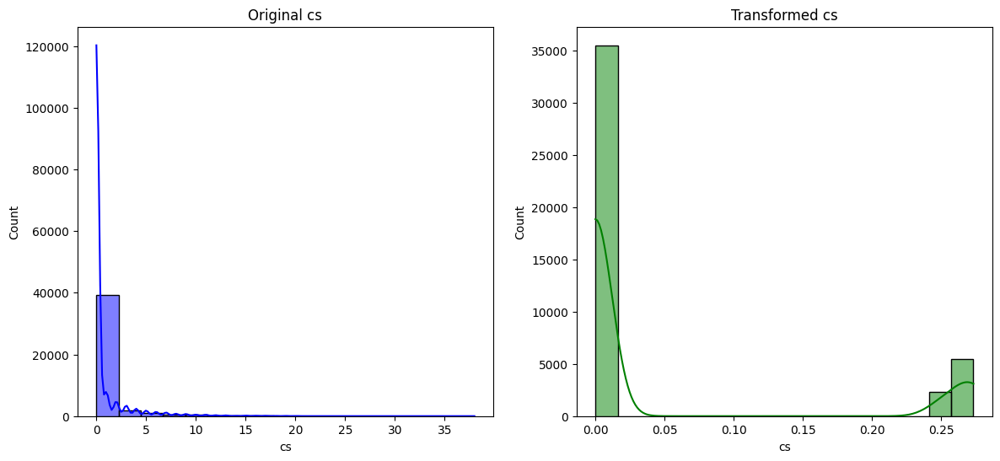

Comparing original and transformed distributions for bb


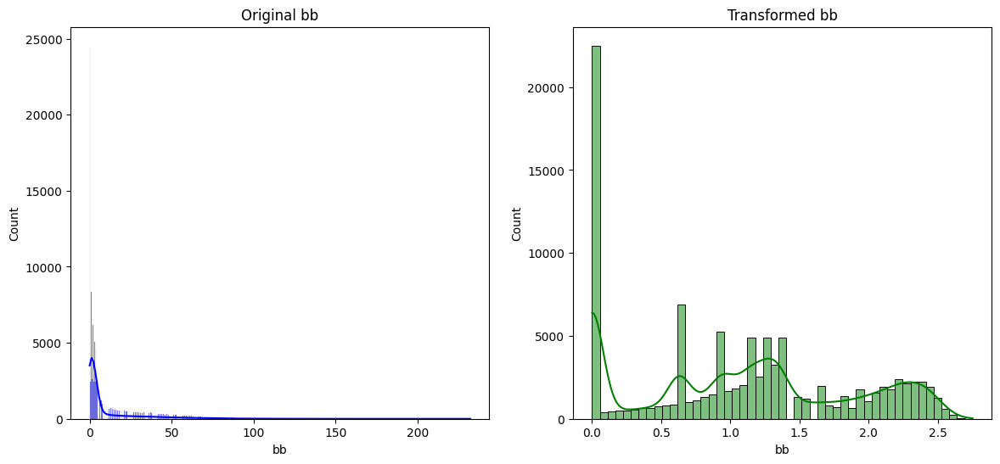

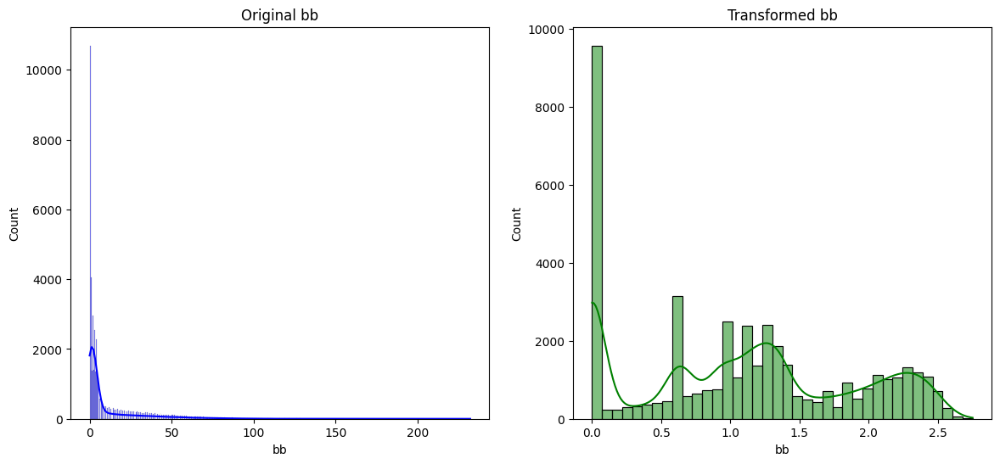

Comparing original and transformed distributions for so


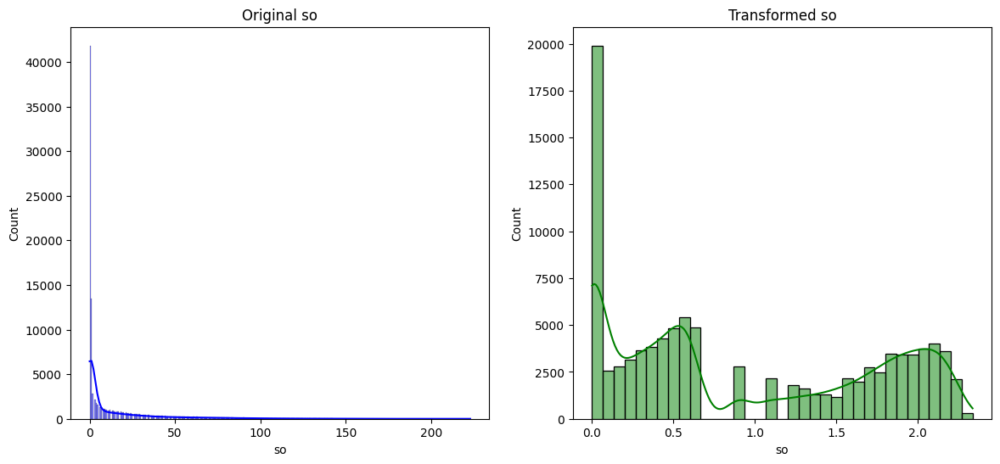

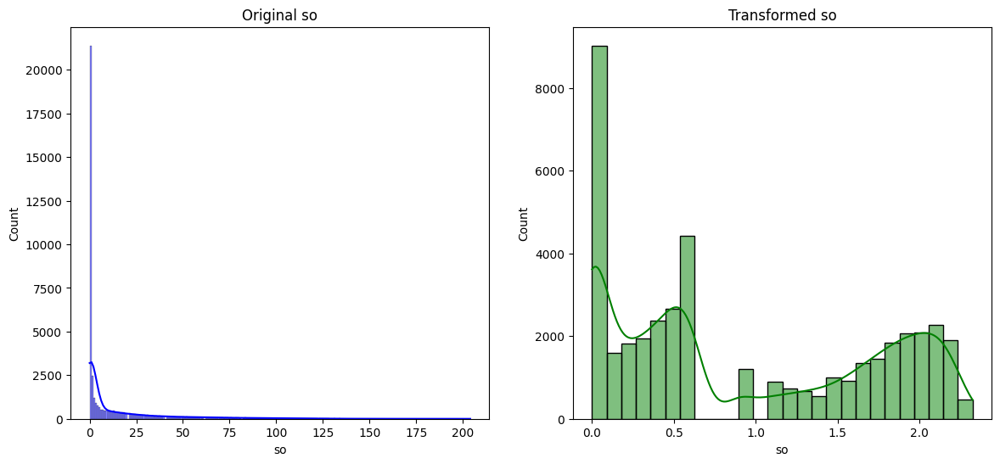

Comparing original and transformed distributions for ibb


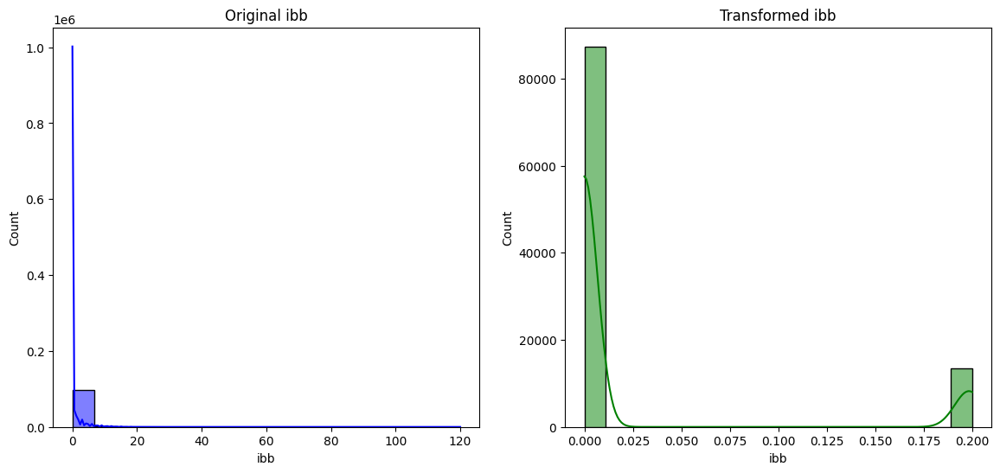

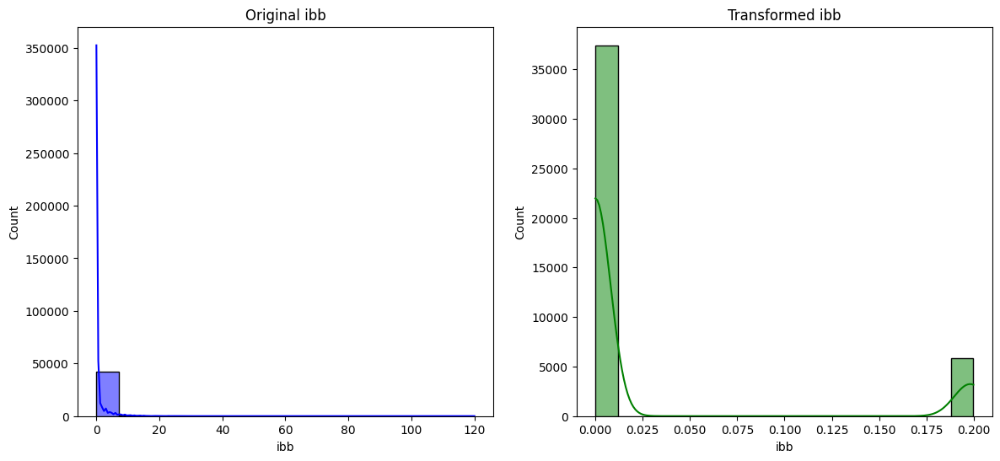

Comparing original and transformed distributions for hbp


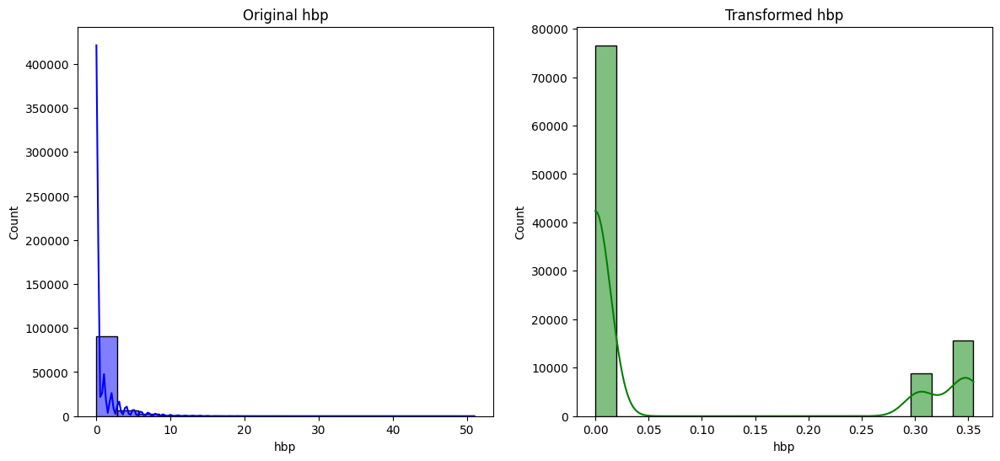

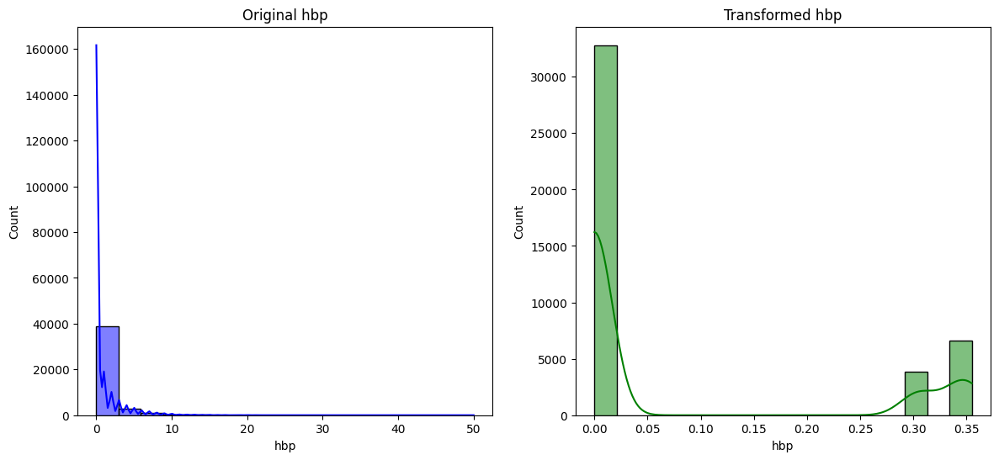

Comparing original and transformed distributions for g_idp


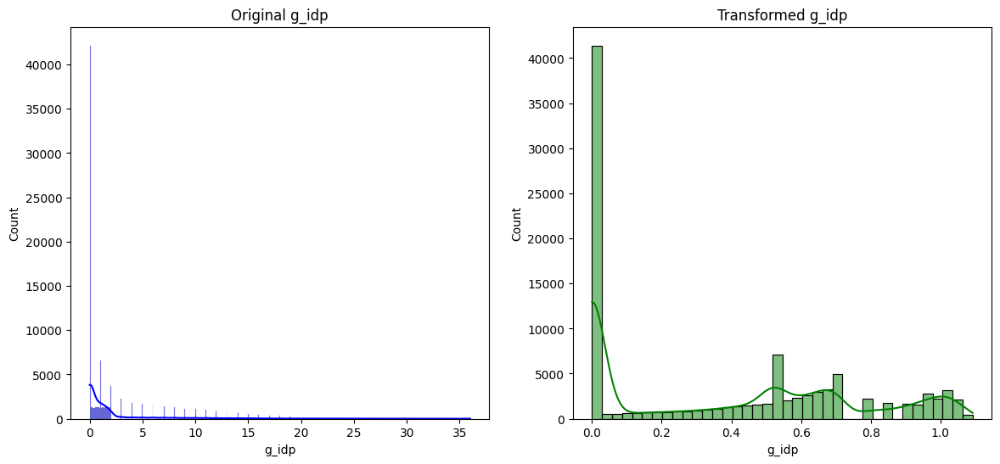

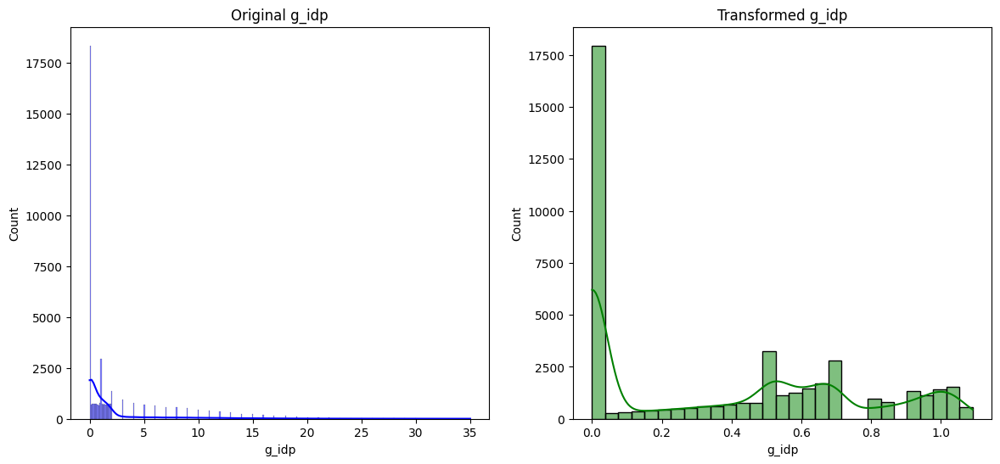

Comparing original and transformed distributions for batting_average


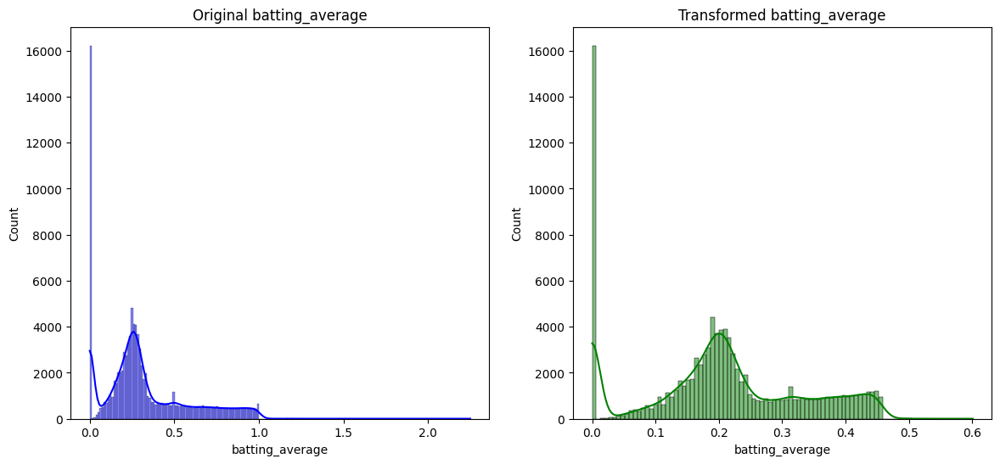

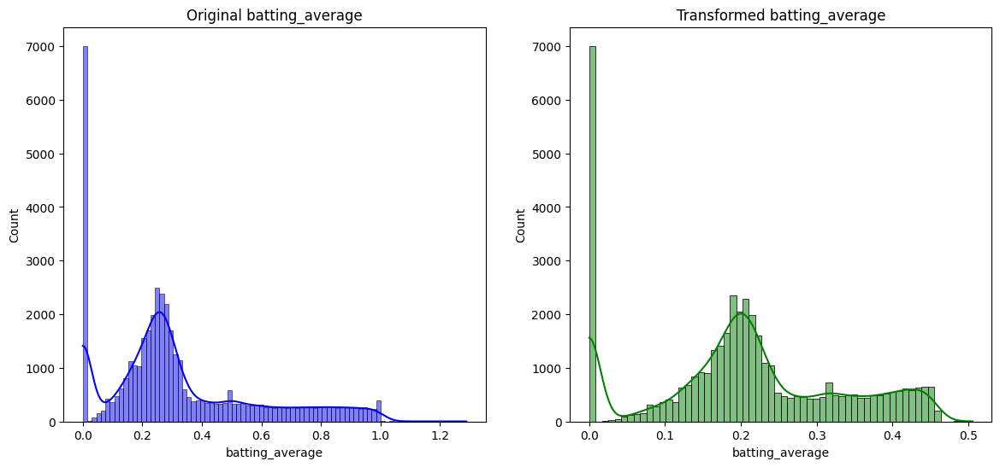

Comparing original and transformed distributions for on_base_percentage


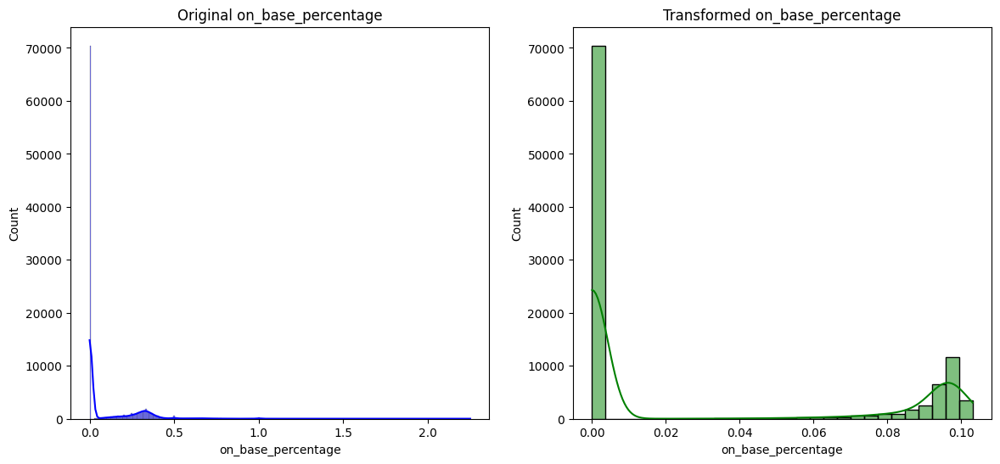

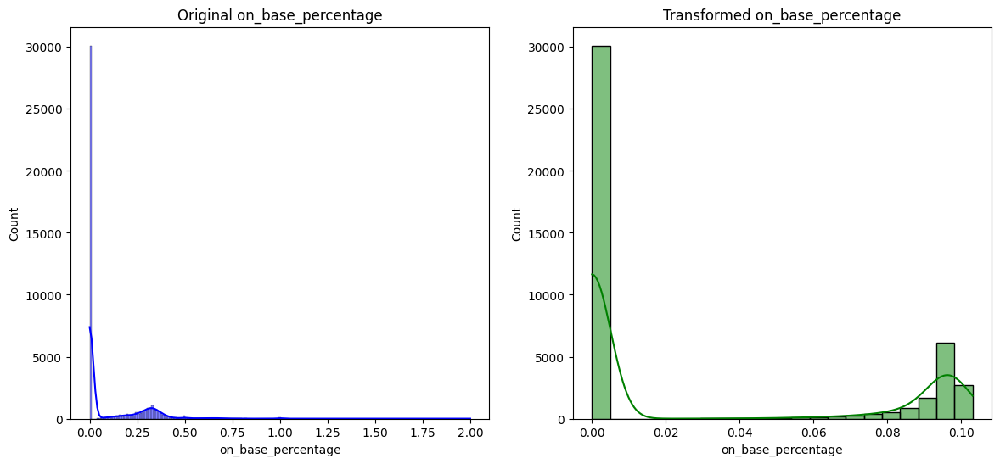

Comparing original and transformed distributions for slugging_percentage


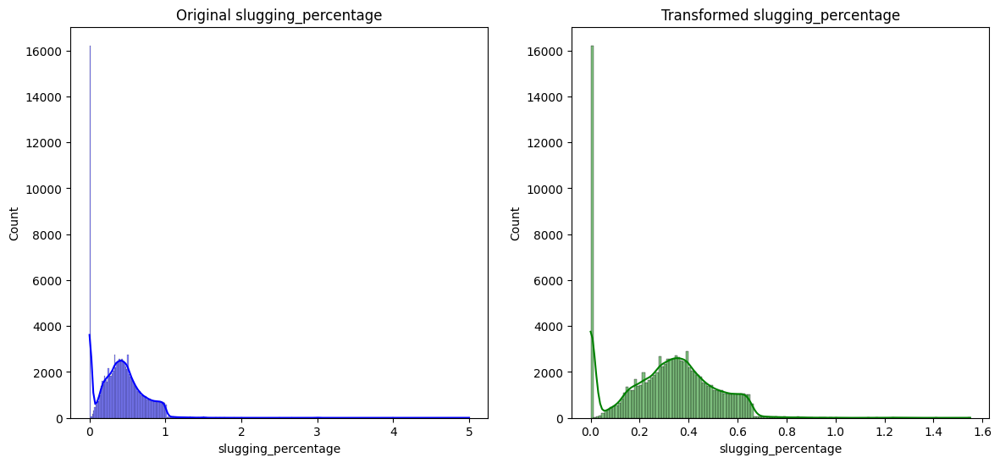

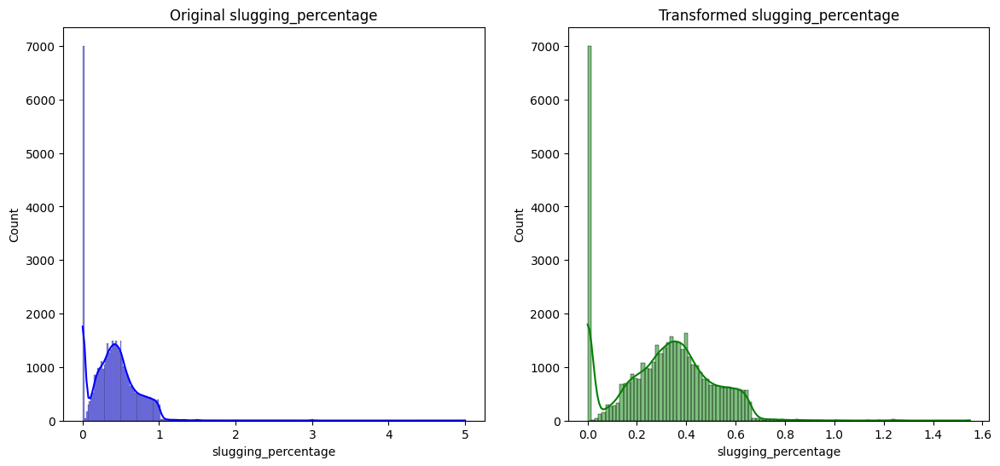

Comparing original and transformed distributions for years_since_debut


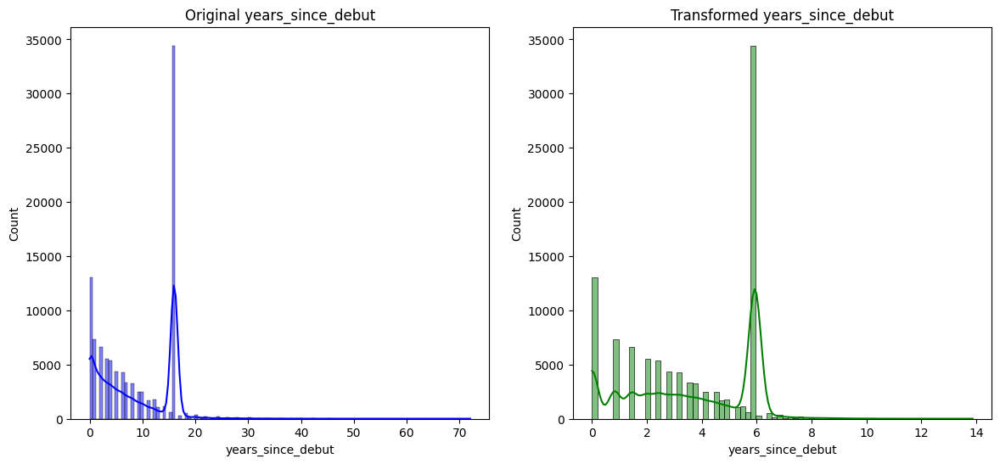

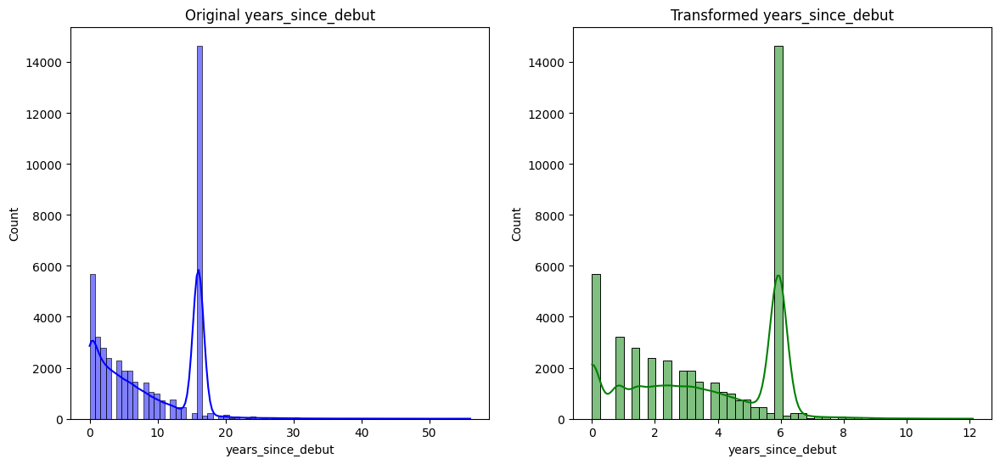

Comparing original and transformed distributions for gs


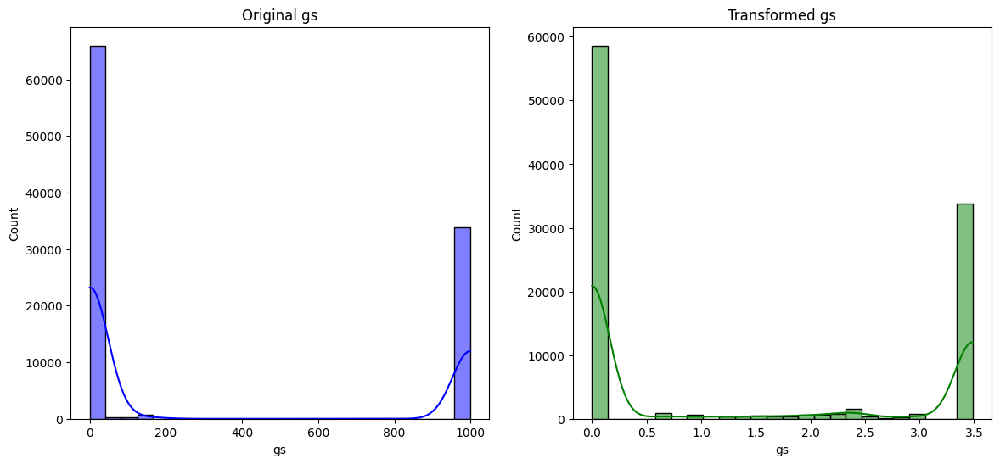

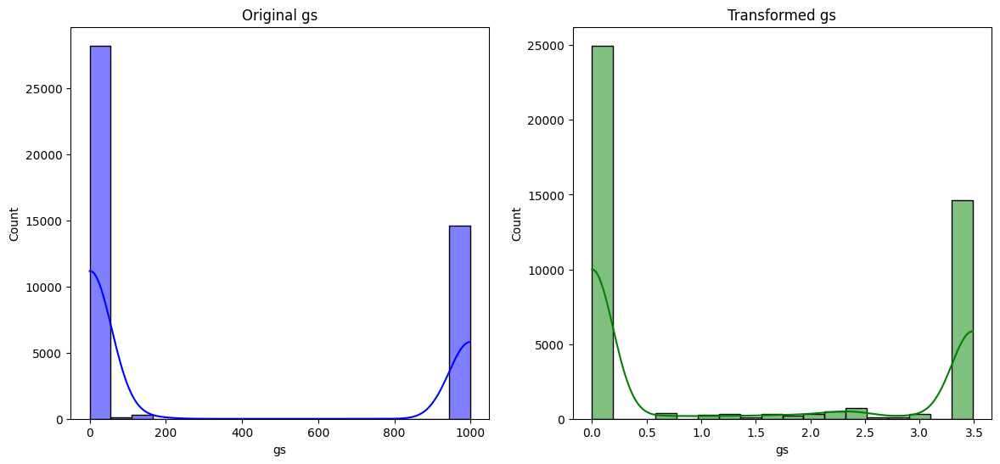

Comparing original and transformed distributions for inn_outs


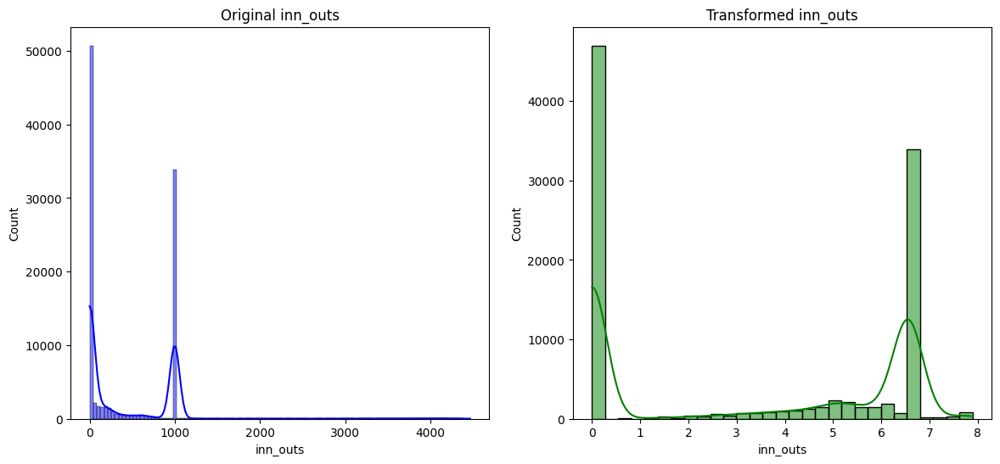

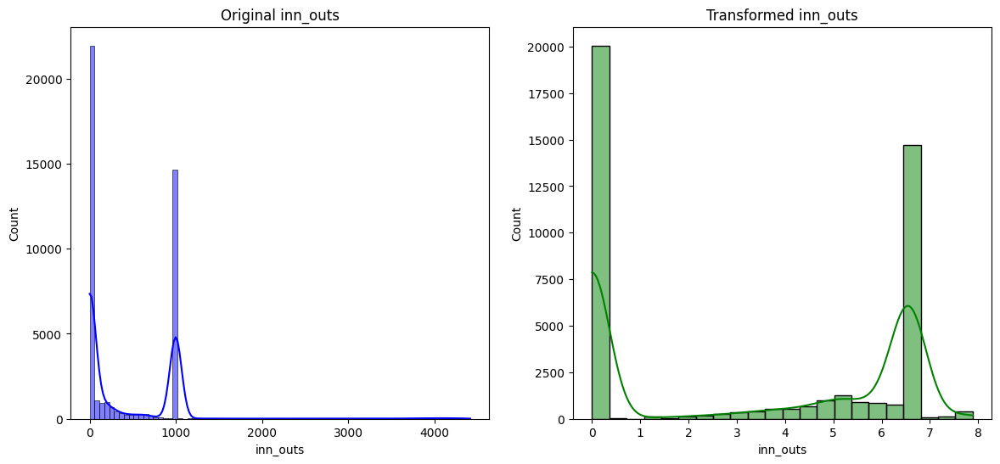

Comparing original and transformed distributions for po


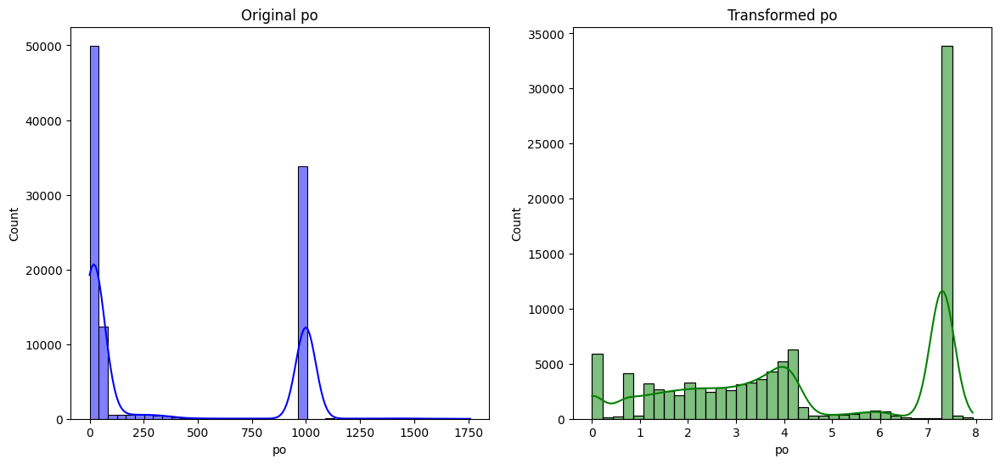

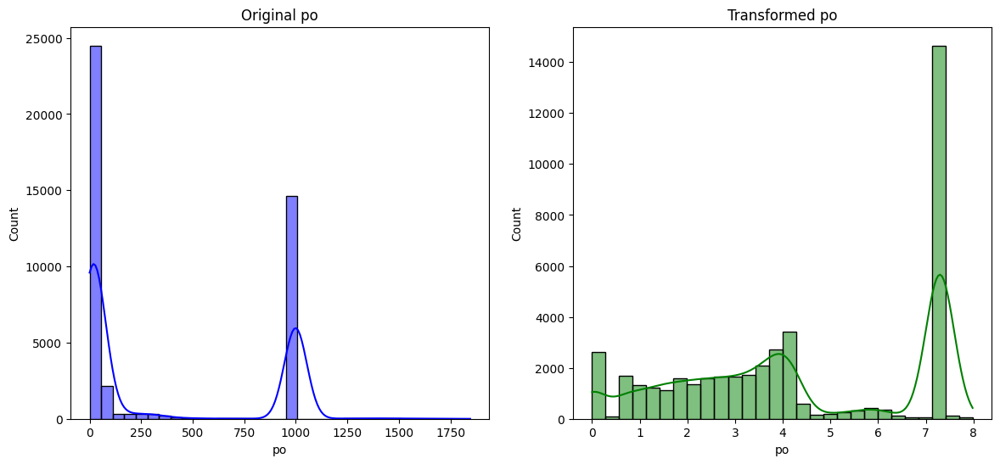

Comparing original and transformed distributions for a


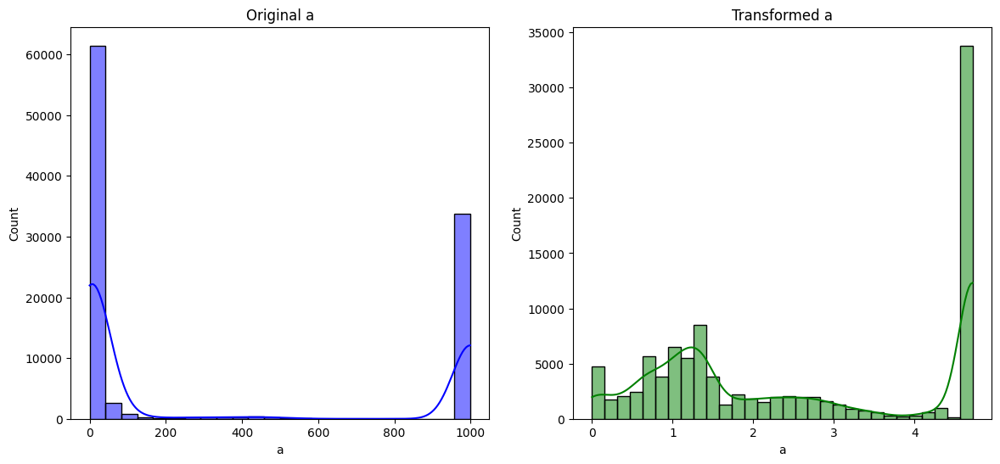

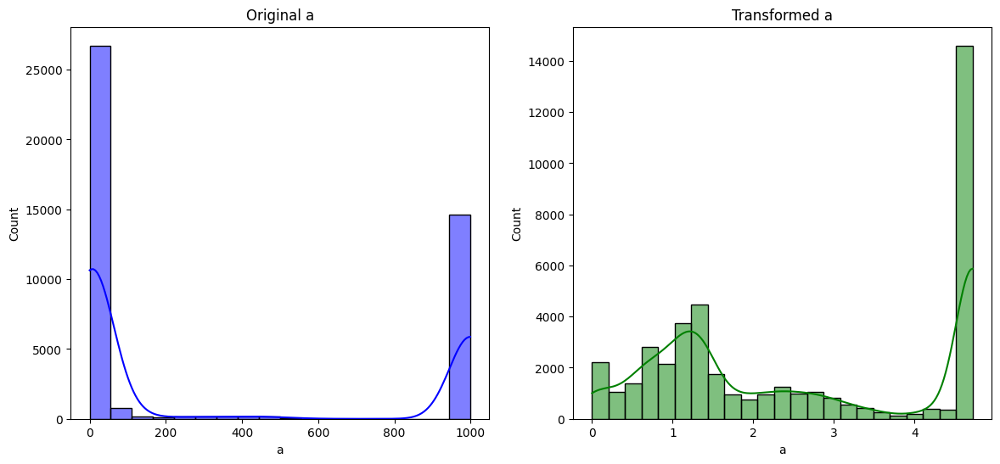

Comparing original and transformed distributions for e


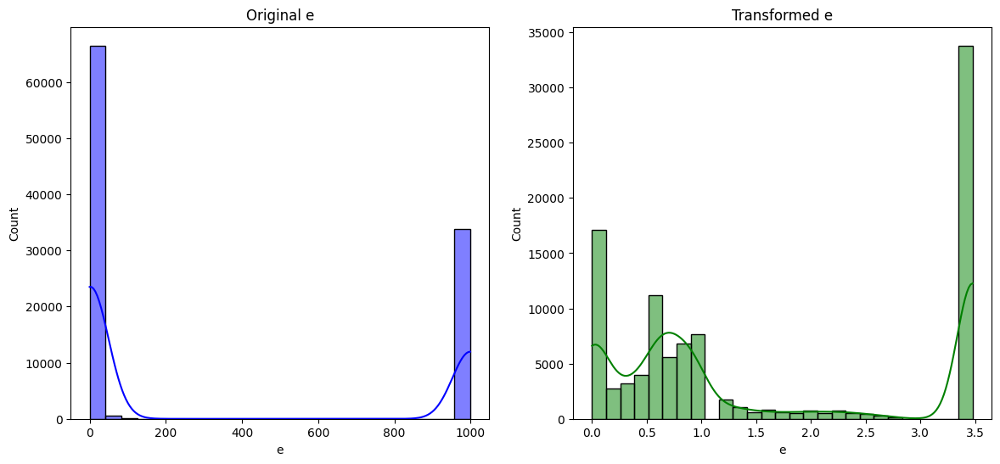

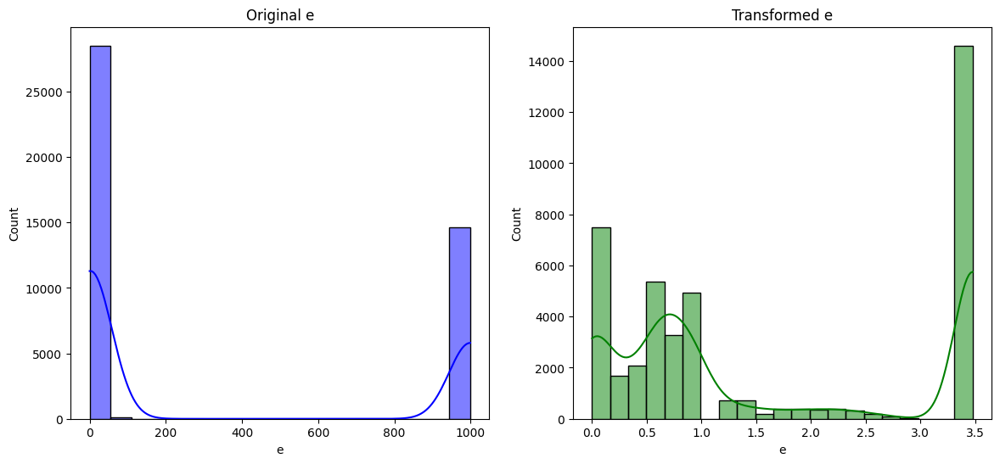

Comparing original and transformed distributions for dp


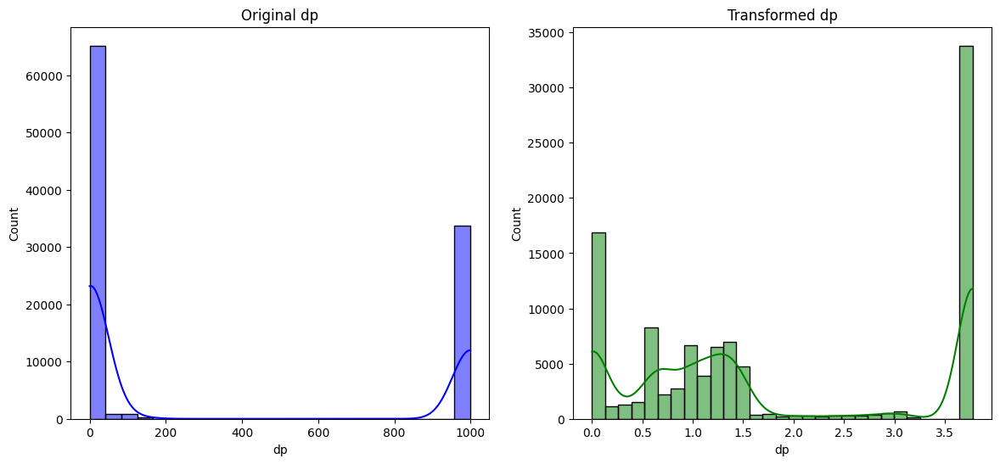

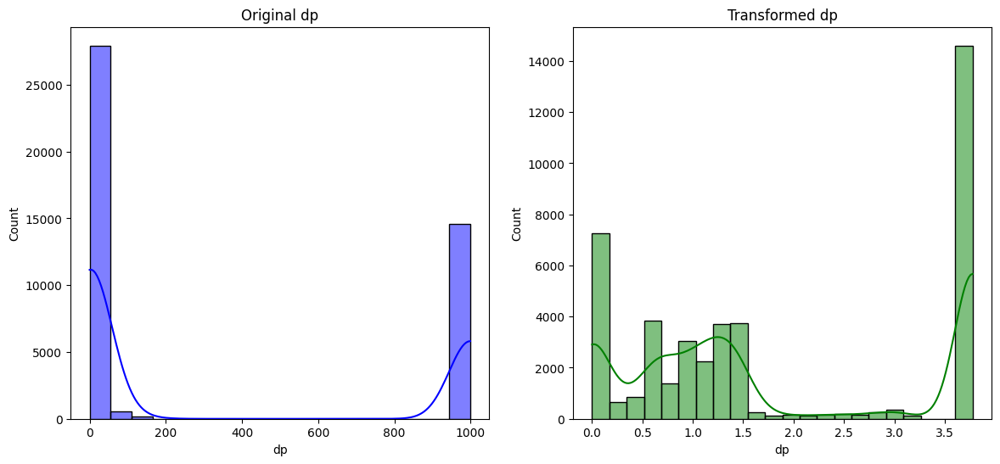

Comparing original and transformed distributions for pb


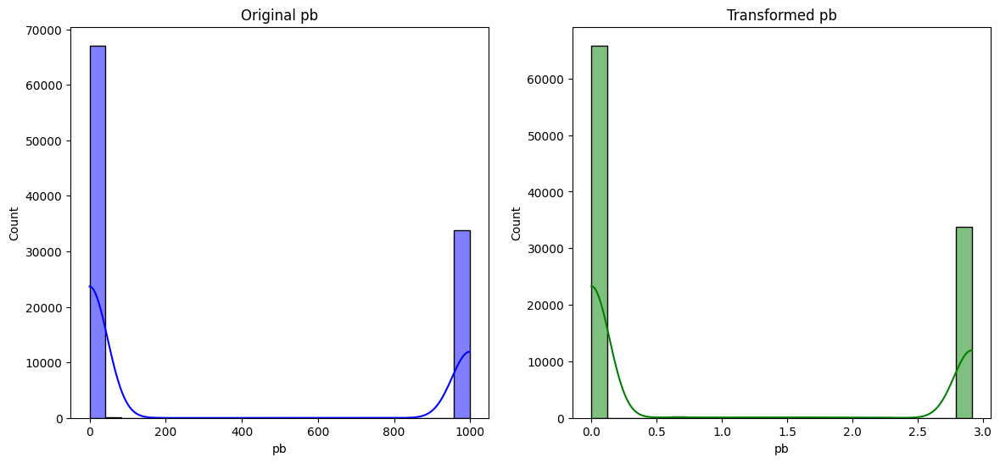

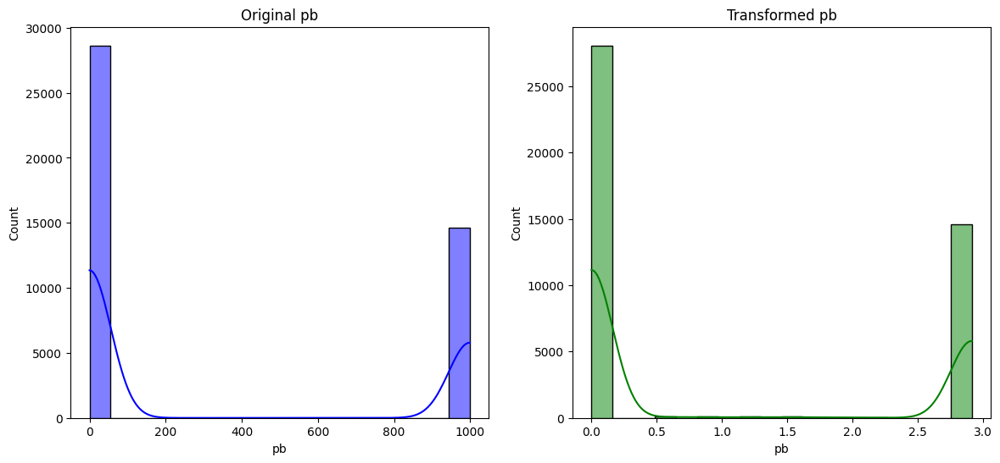

Comparing original and transformed distributions for wp


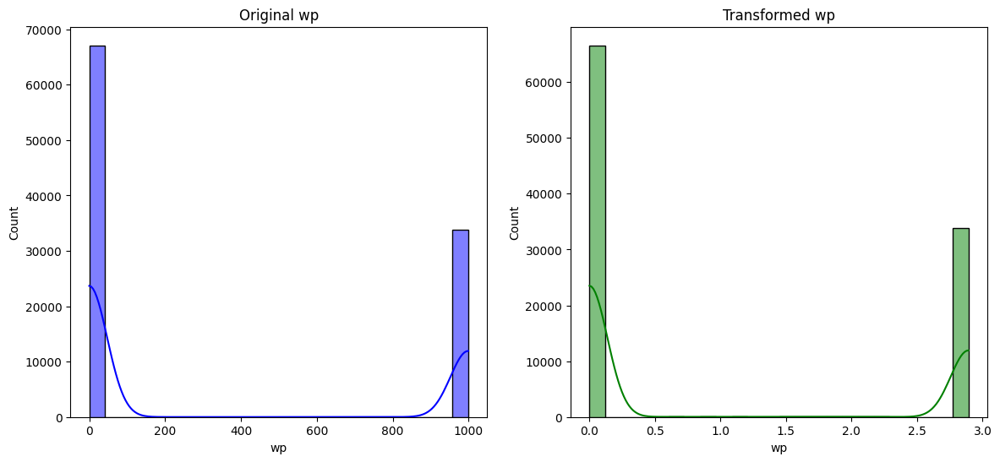

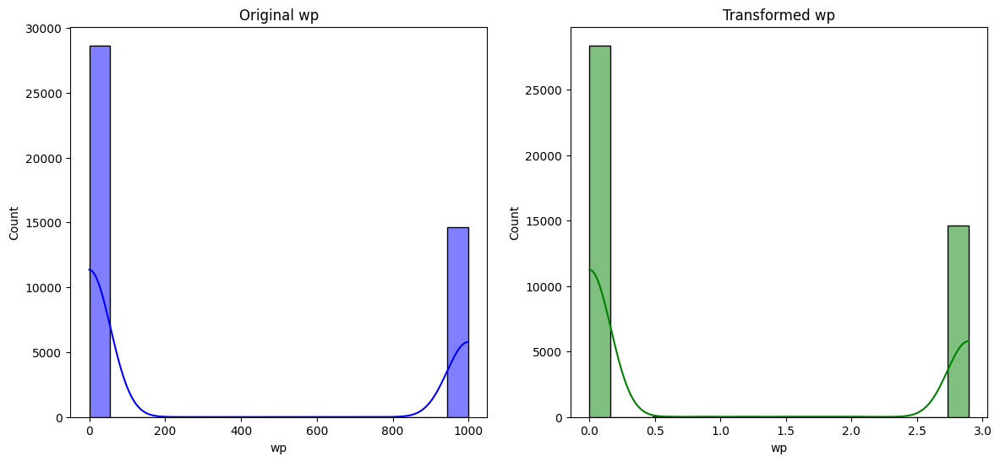

Comparing original and transformed distributions for sb_fielding


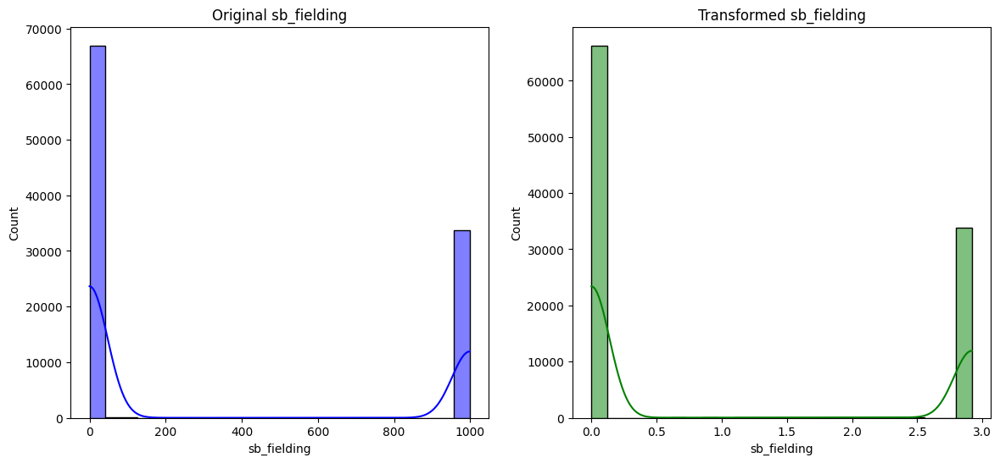

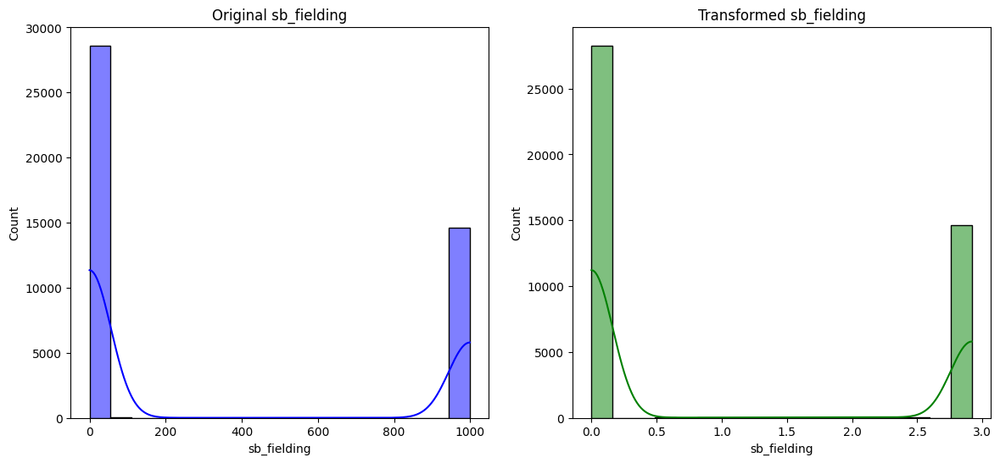

Comparing original and transformed distributions for cs_fielding


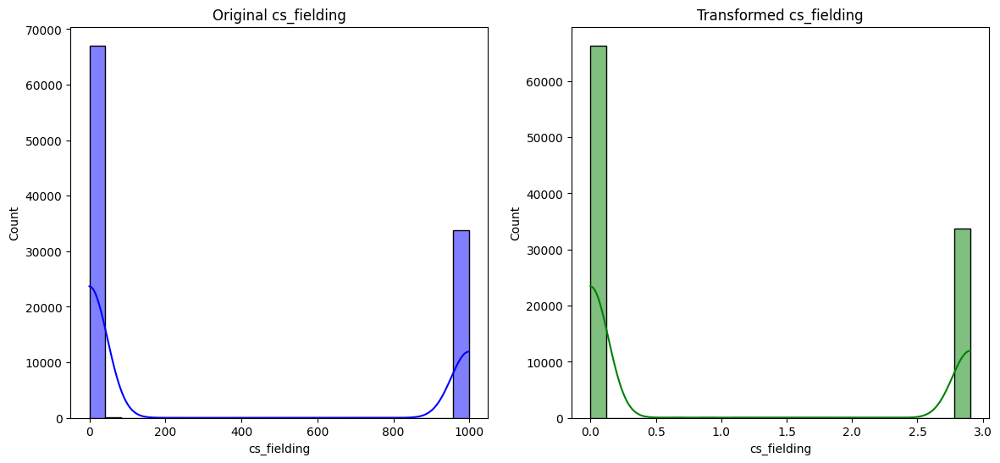

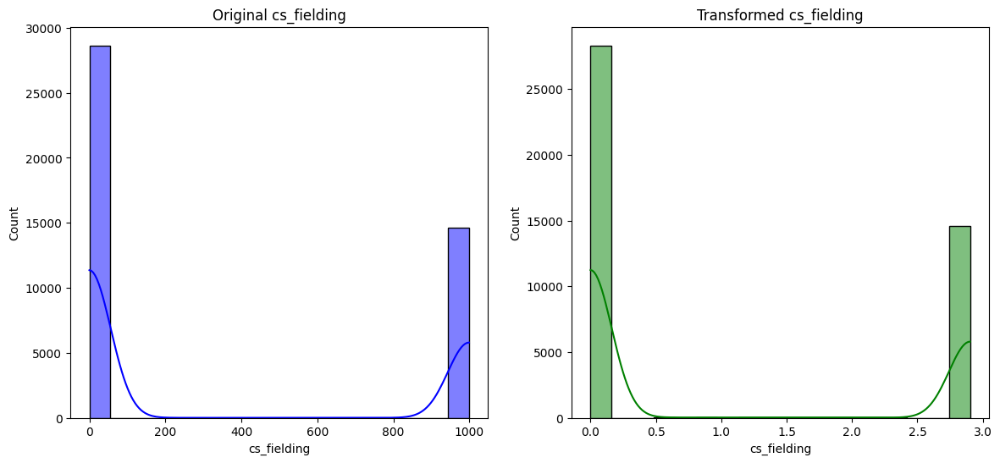

Comparing original and transformed distributions for zr


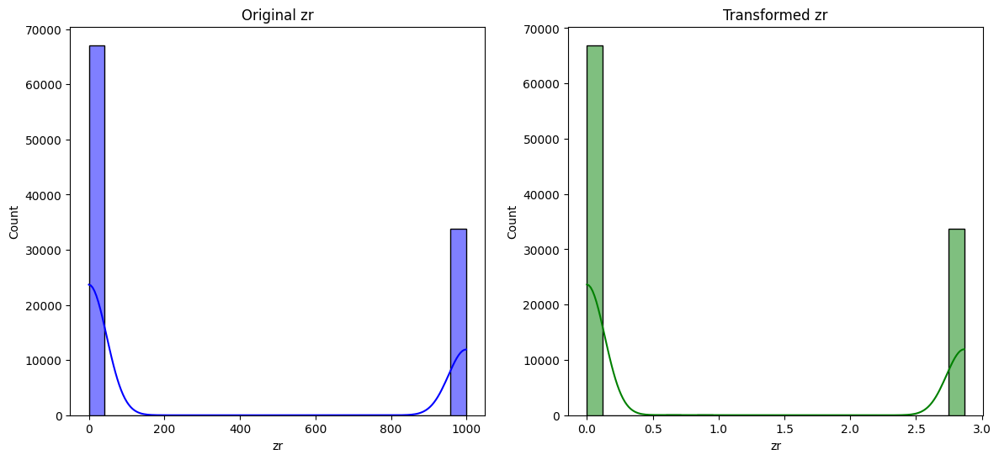

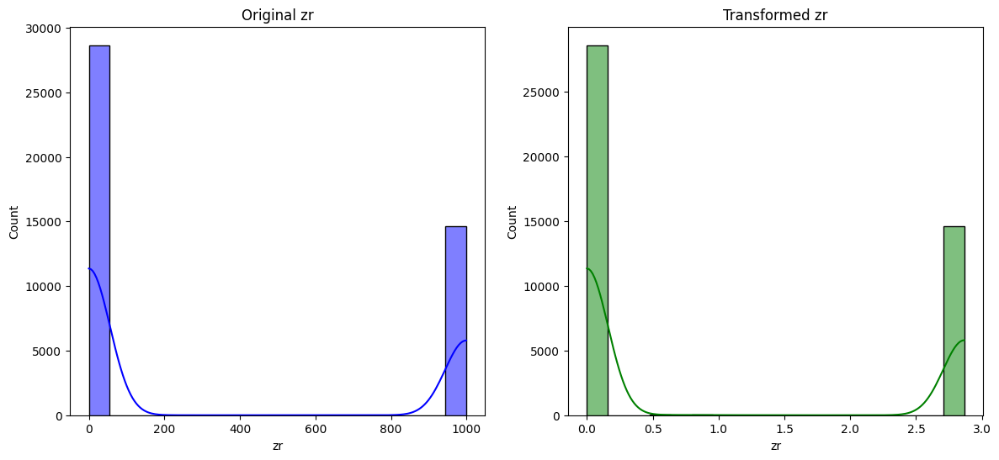

Comparing original and transformed distributions for gs_fielding_postseason


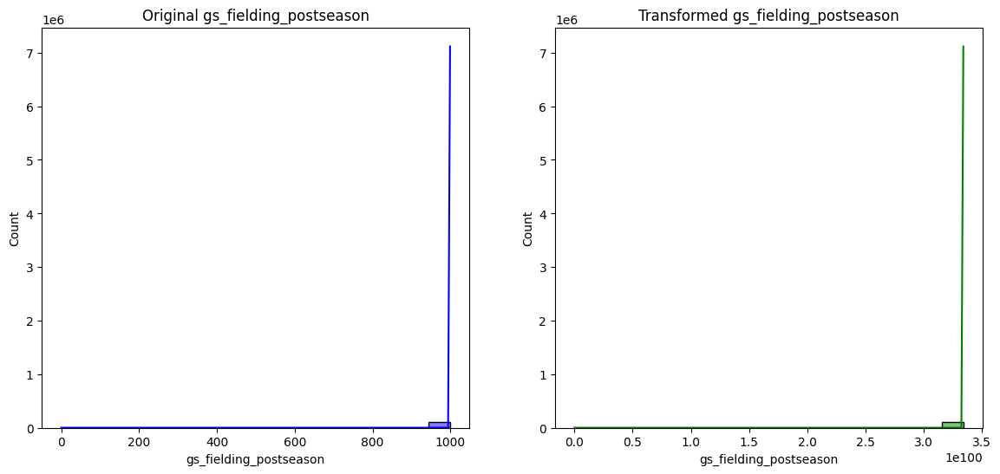

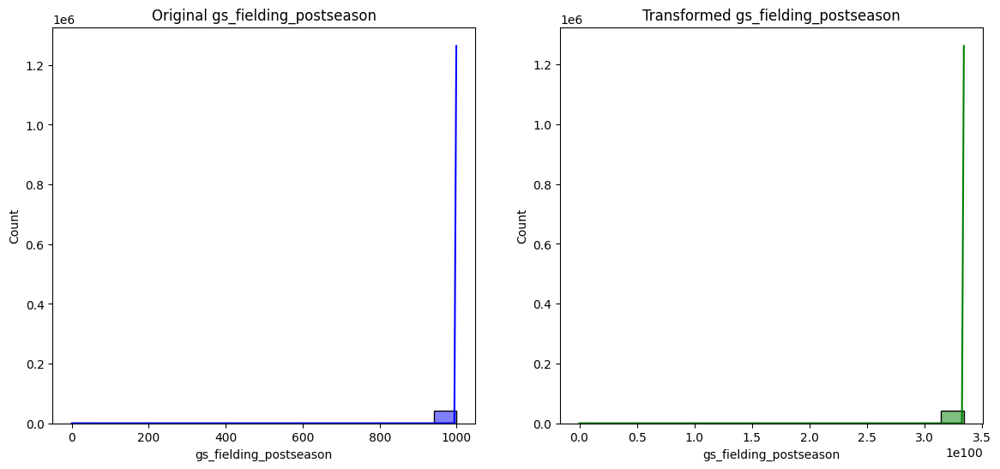

Comparing original and transformed distributions for inn_outs_fielding_postseason


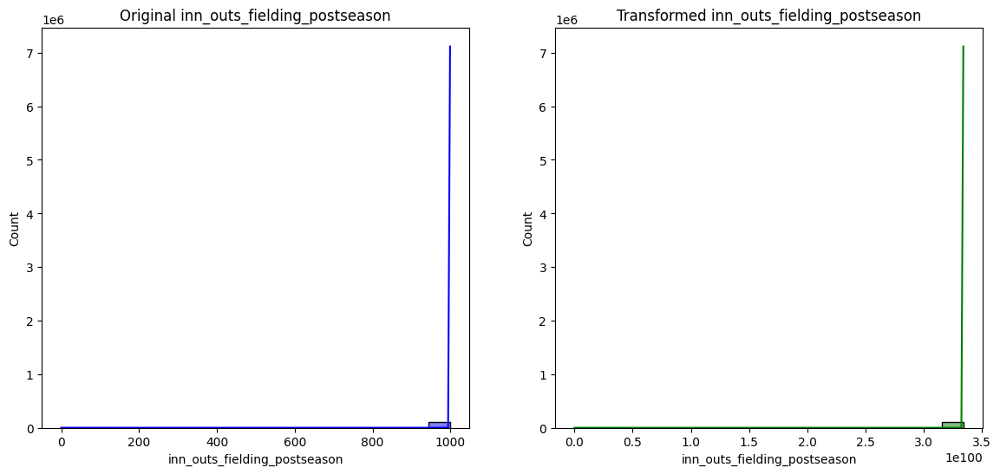

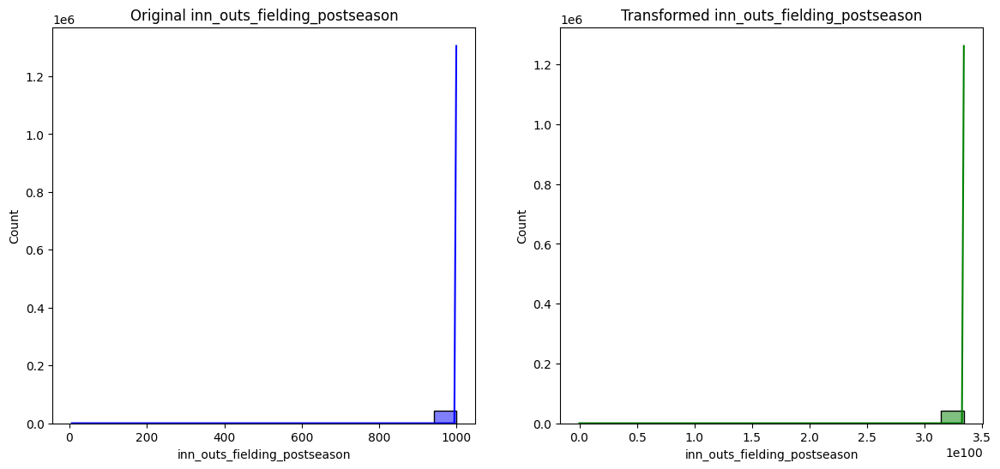

Comparing original and transformed distributions for po_fielding_postseason


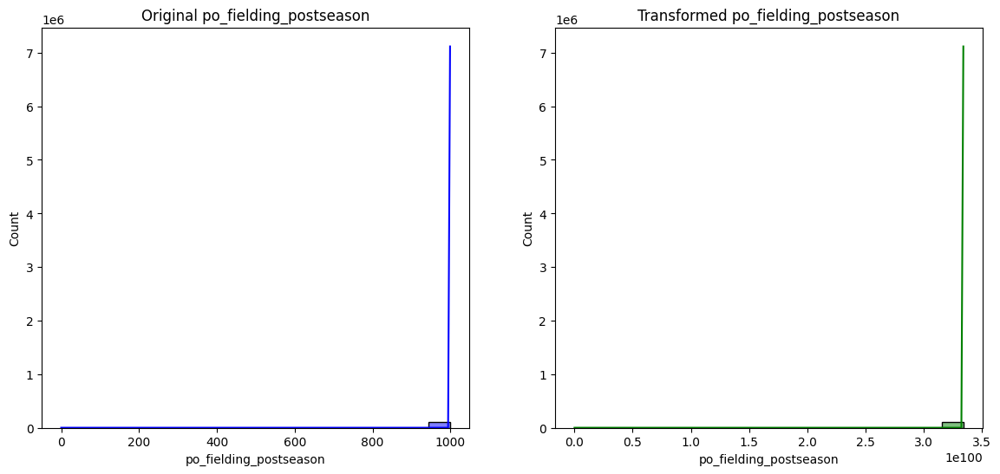

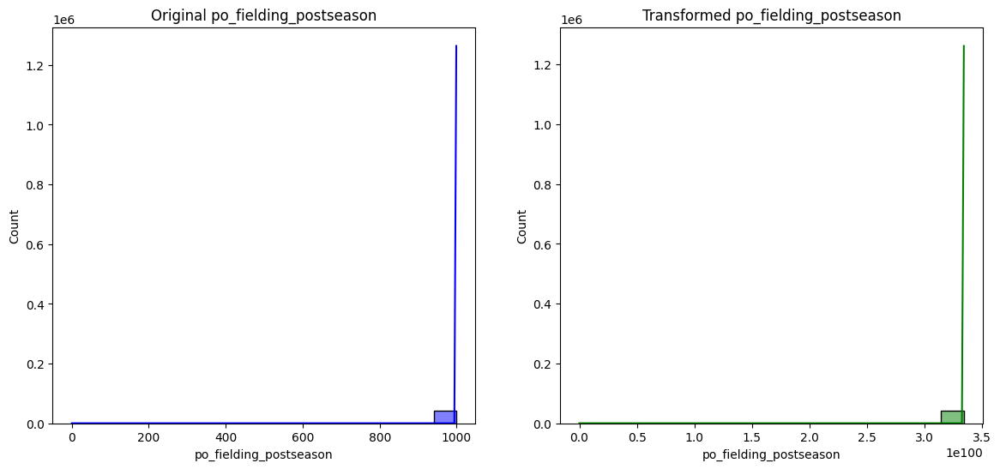

Comparing original and transformed distributions for a_fielding_postseason


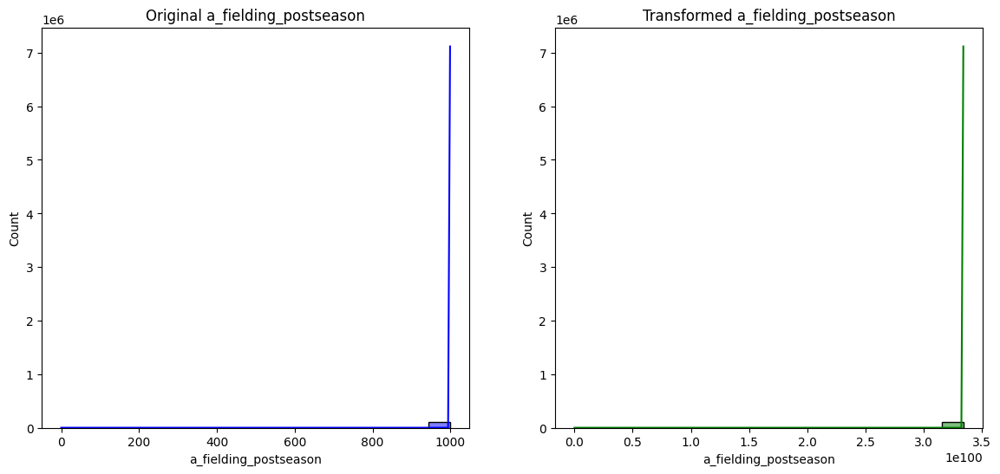

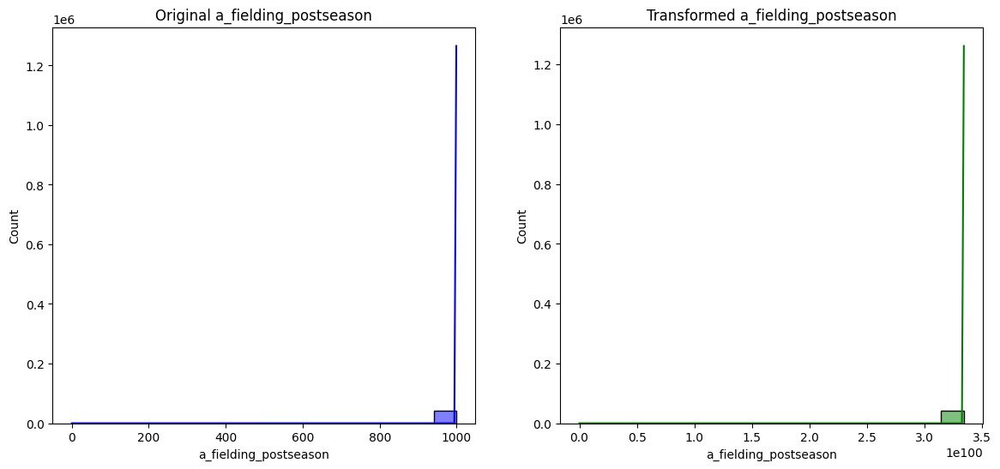

Comparing original and transformed distributions for e_fielding_postseason


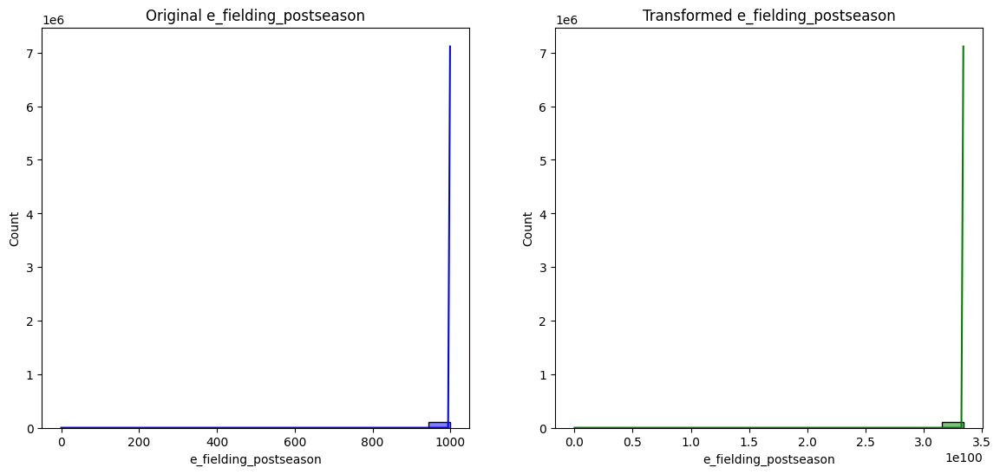

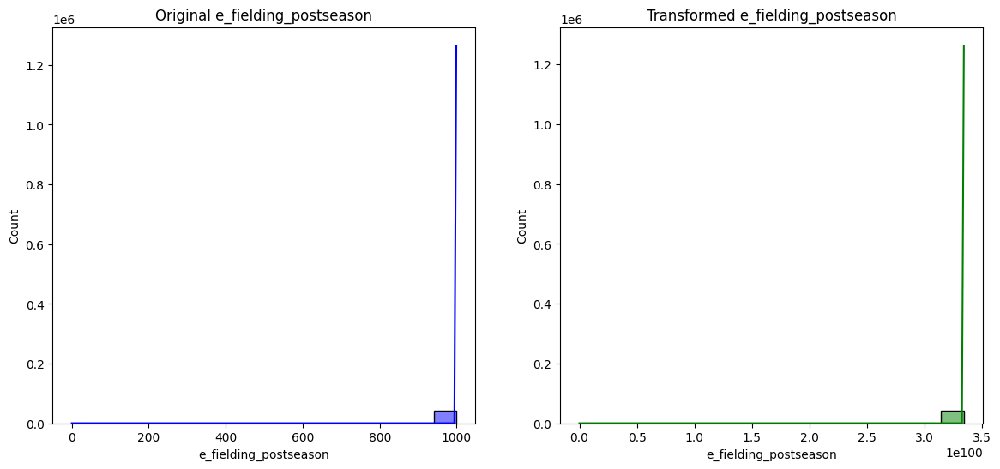

Comparing original and transformed distributions for dp_fielding_postseason


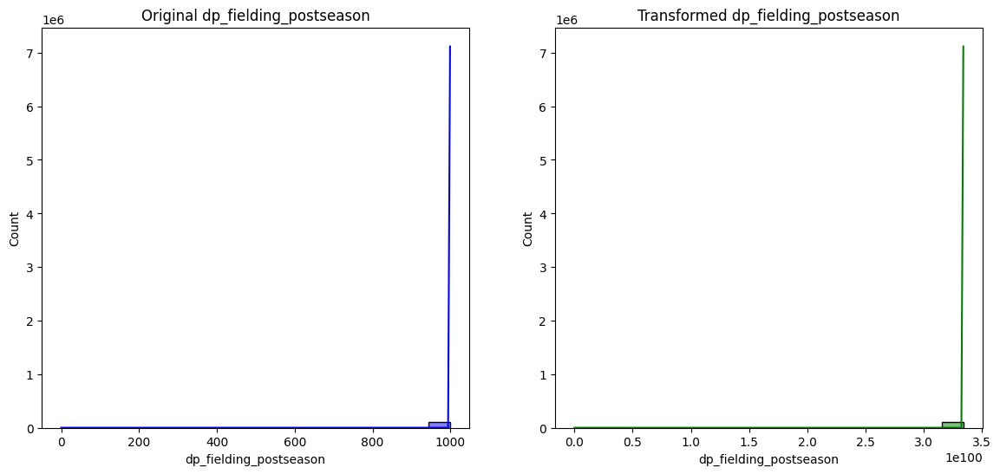

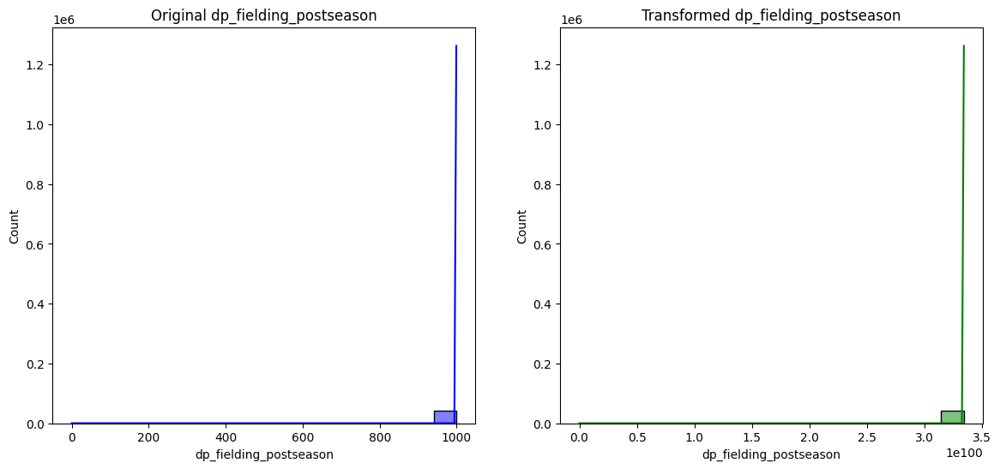

Comparing original and transformed distributions for tp


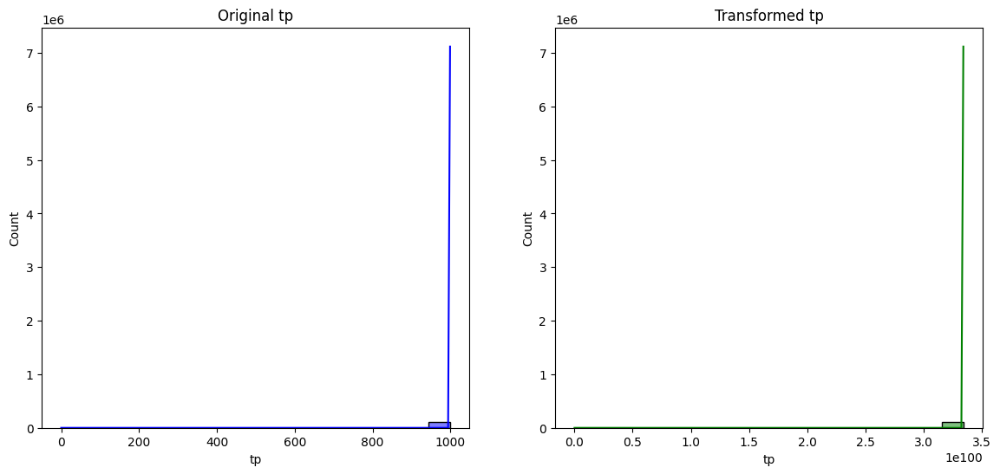

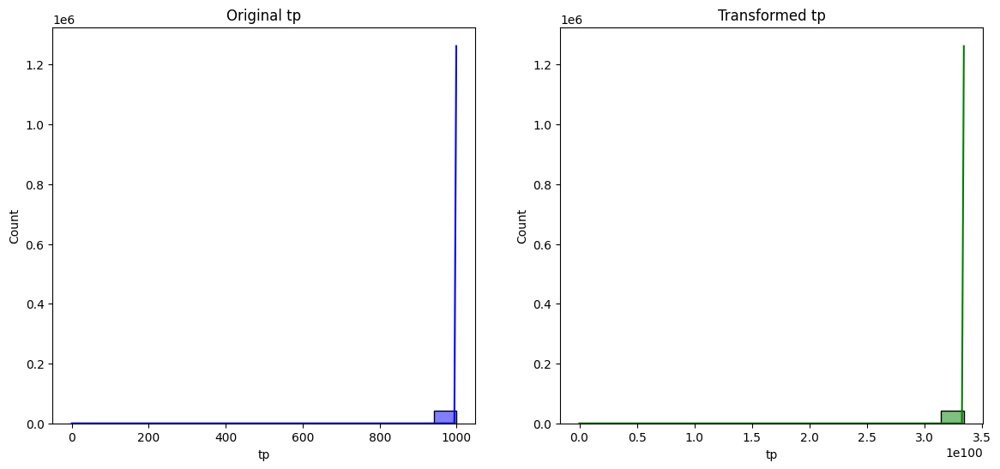

Comparing original and transformed distributions for pb_fielding_postseason


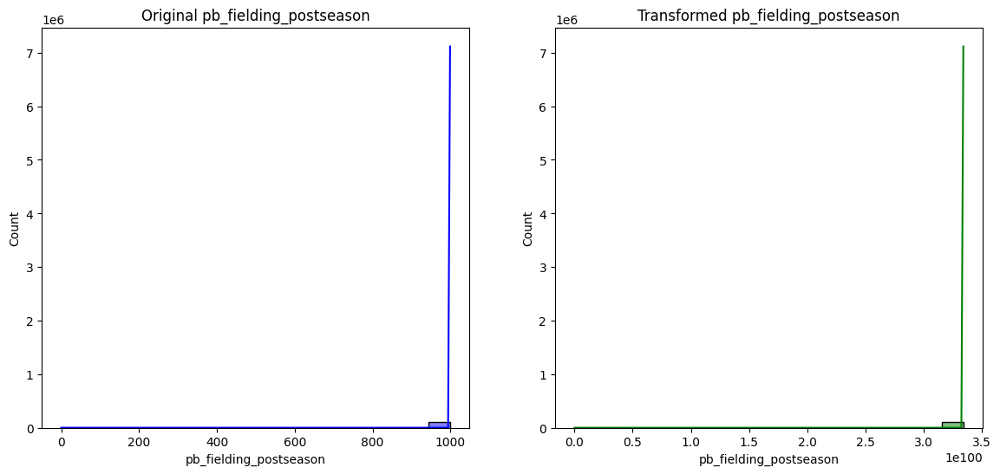

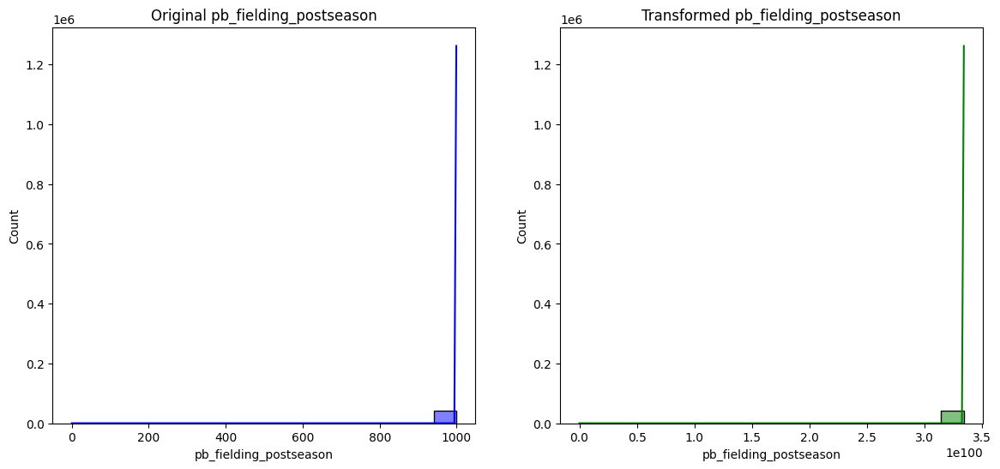

Comparing original and transformed distributions for sb_fielding_postseason


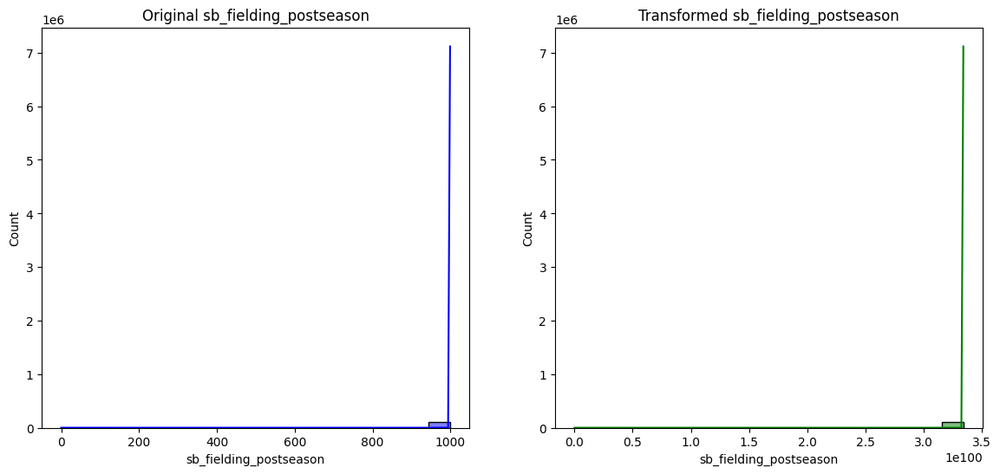

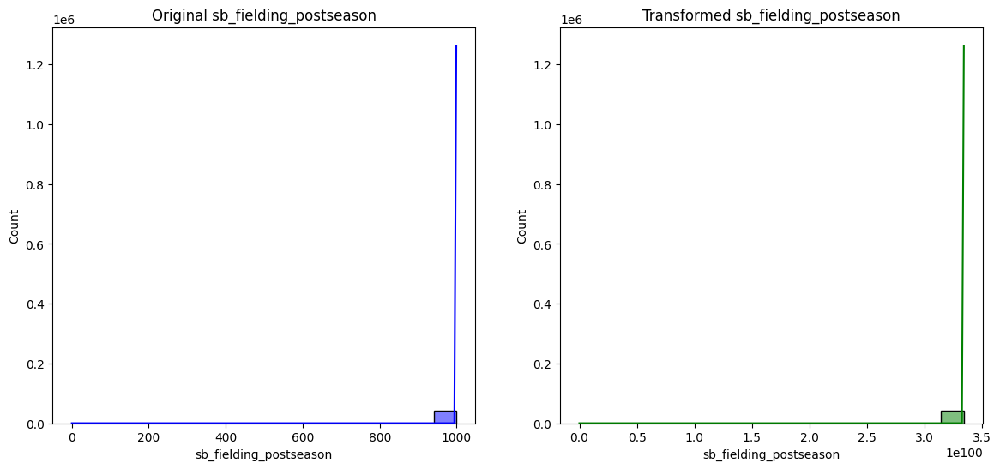

Comparing original and transformed distributions for cs_fielding_postseason


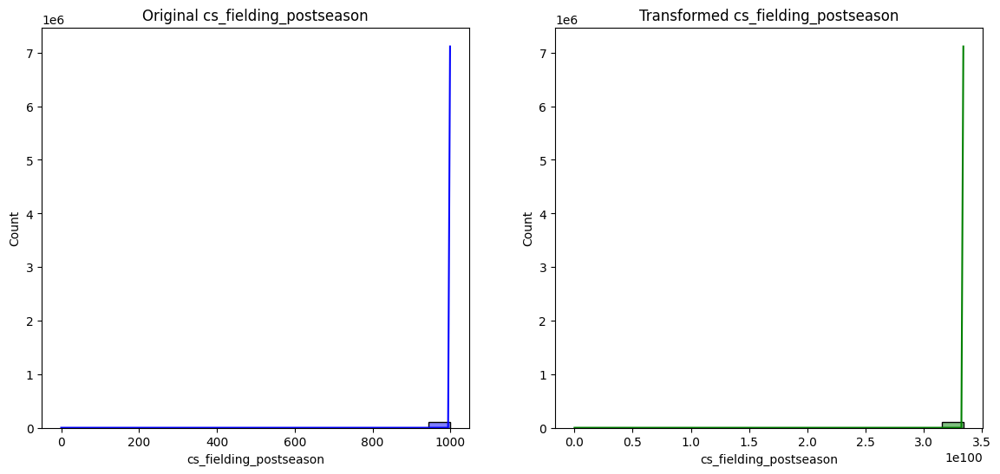

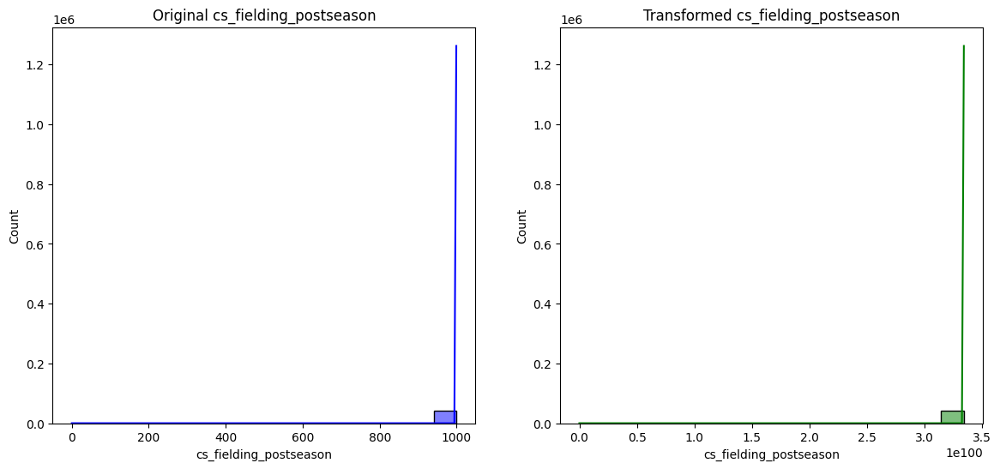

Comparing original and transformed distributions for g_postseason


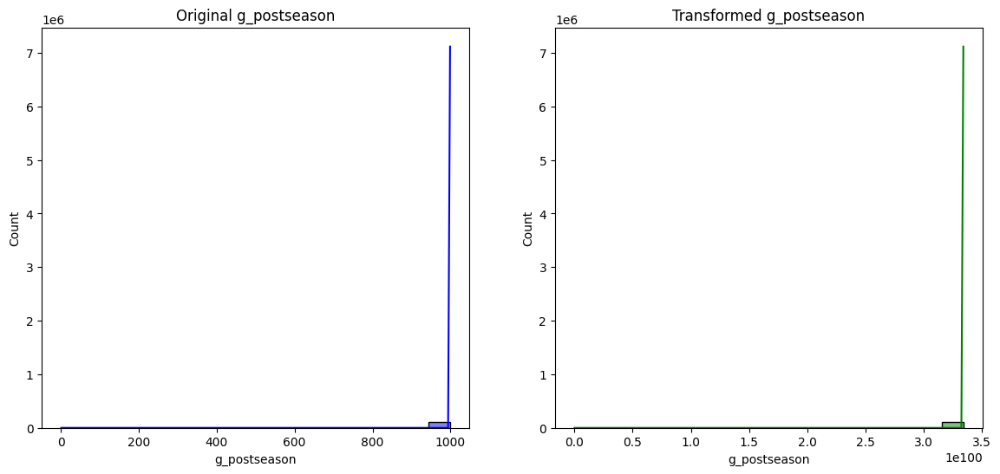

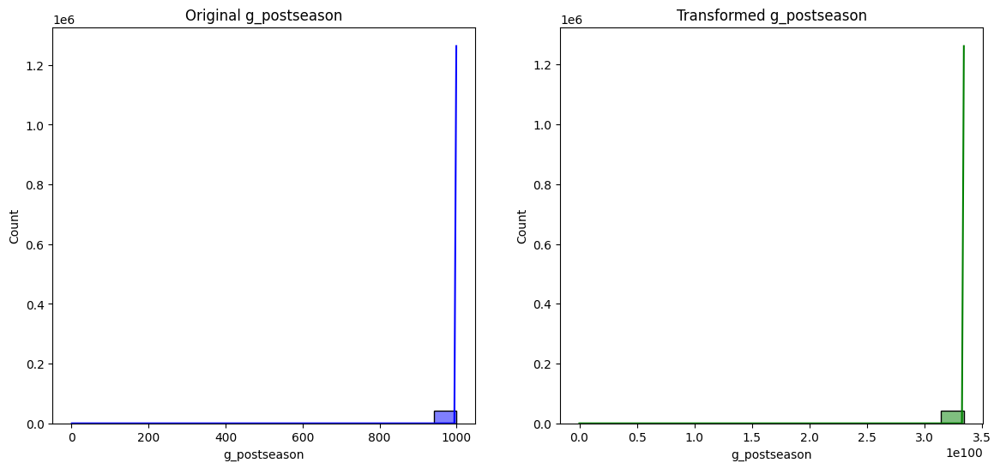

Comparing original and transformed distributions for ab_postseason


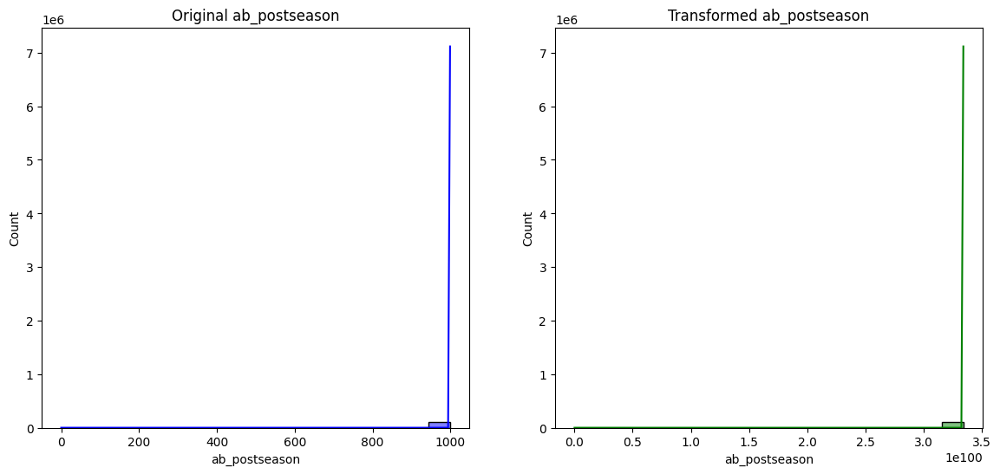

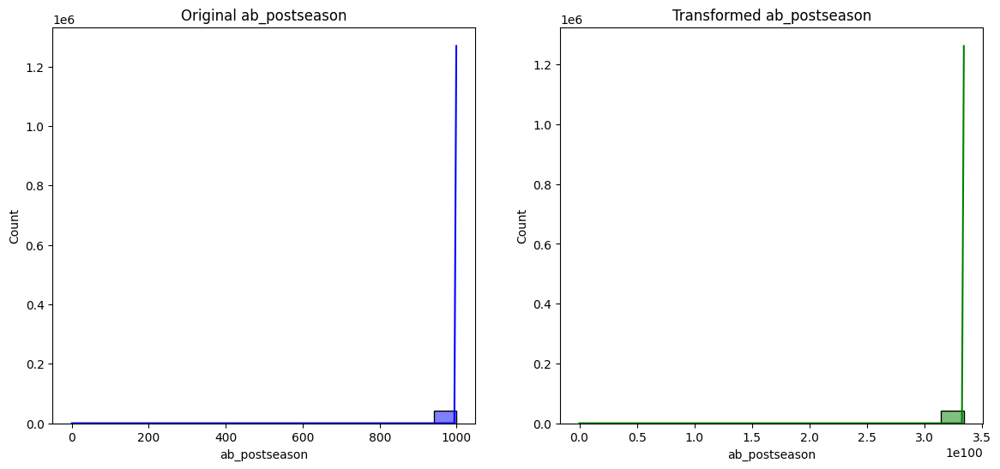

Comparing original and transformed distributions for r_postseason


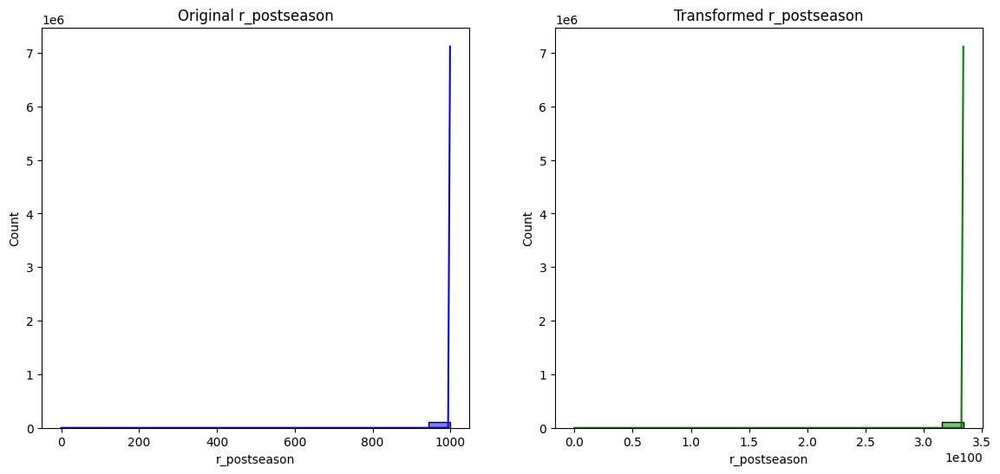

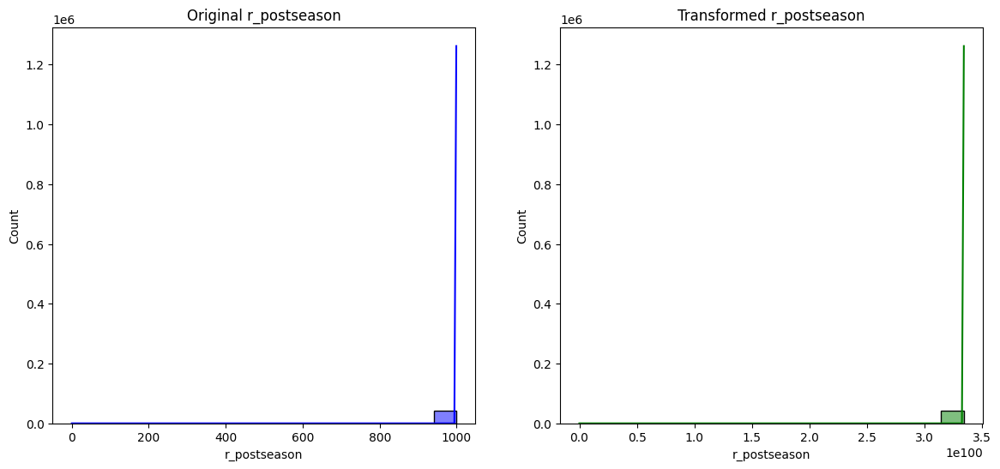

Comparing original and transformed distributions for h_postseason


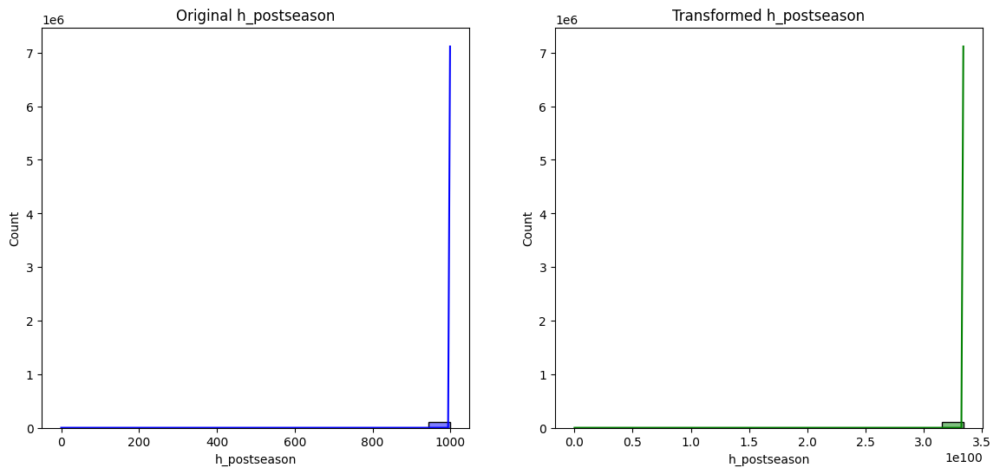

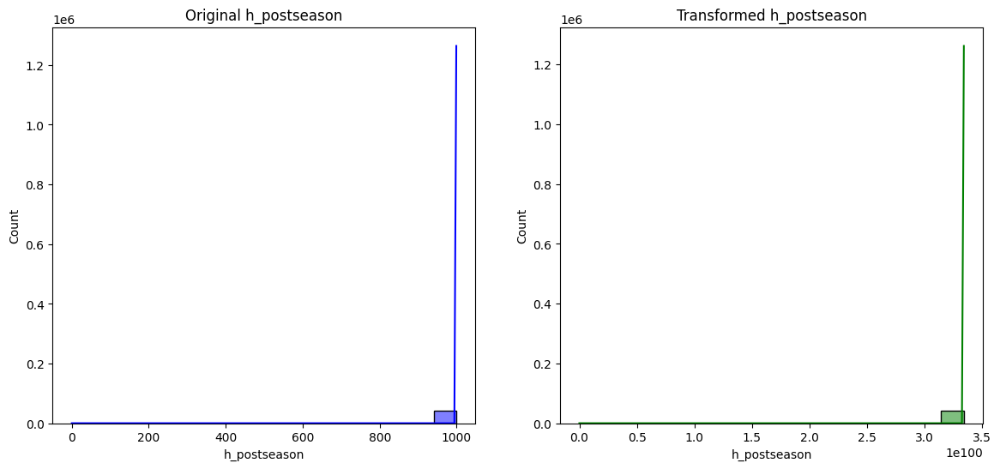

Comparing original and transformed distributions for double_postseason


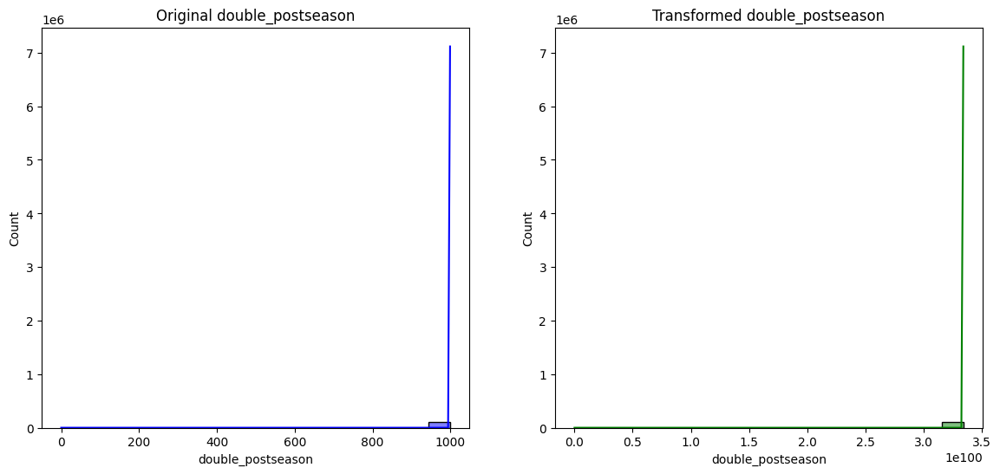

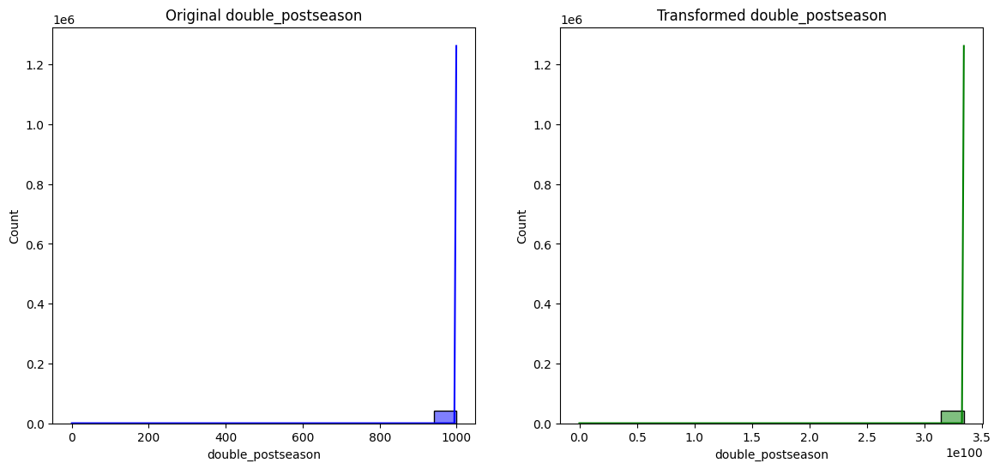

Comparing original and transformed distributions for triple_postseason


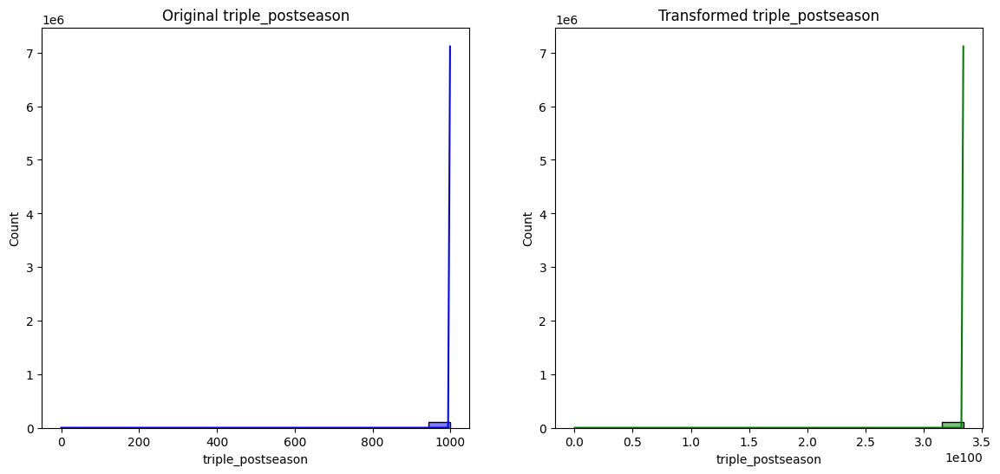

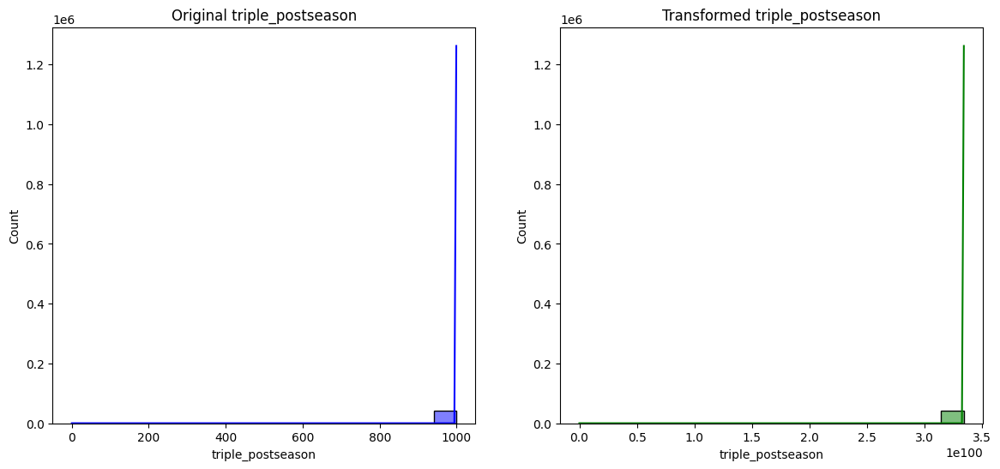

Comparing original and transformed distributions for hr_postseason


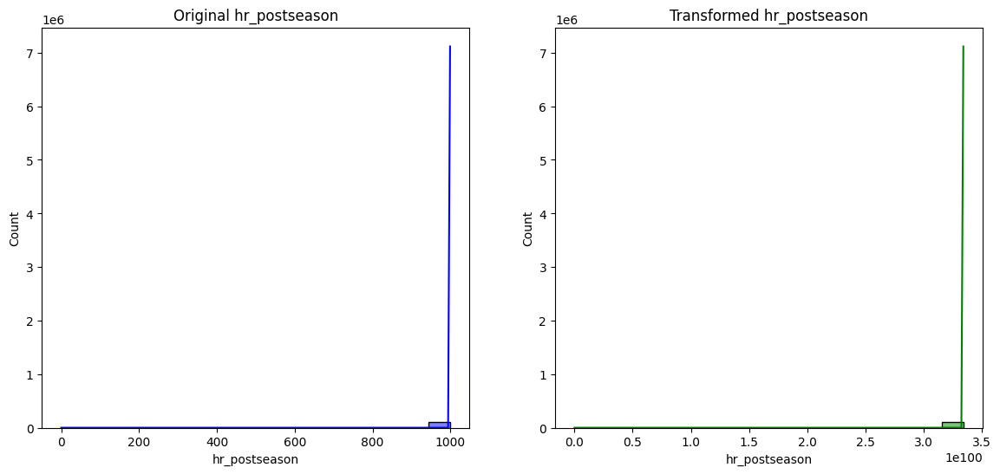

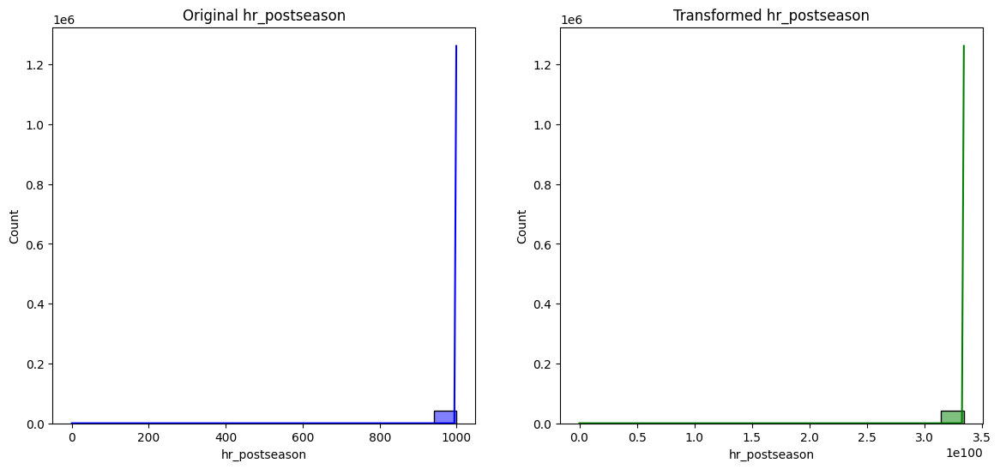

Comparing original and transformed distributions for rbi_postseason


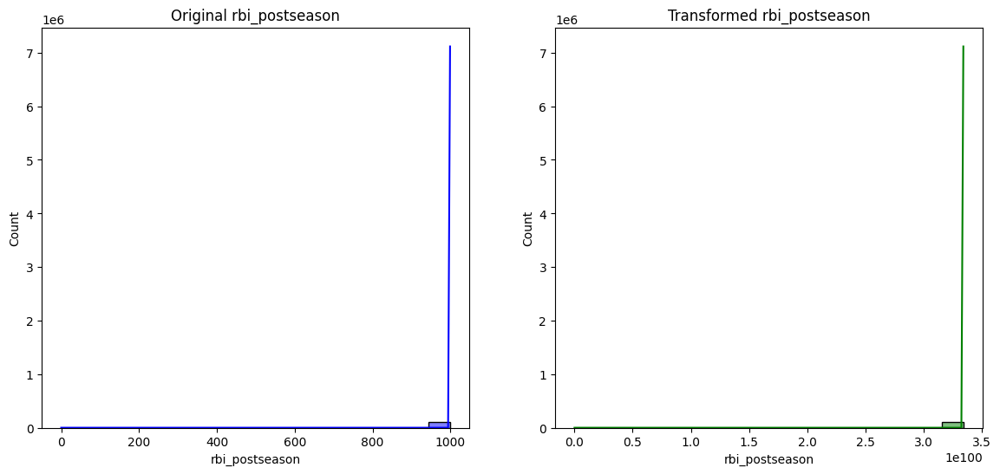

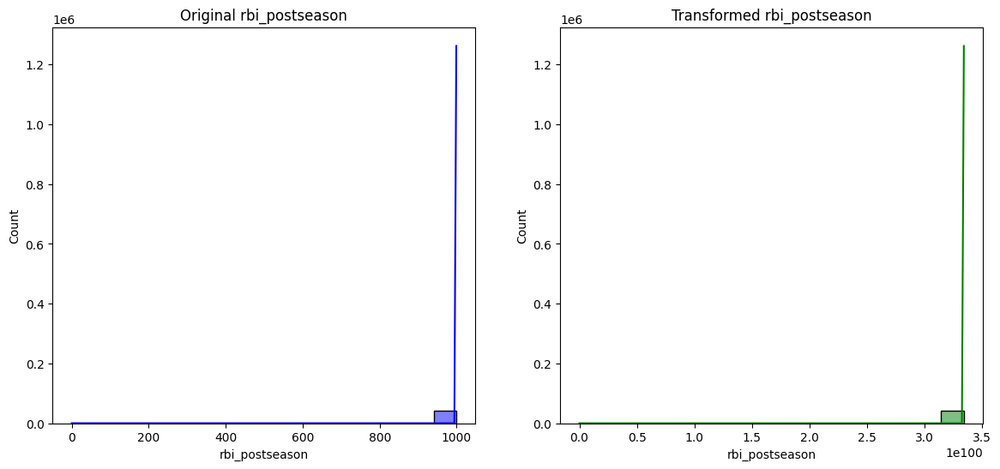

Comparing original and transformed distributions for sb_postseason


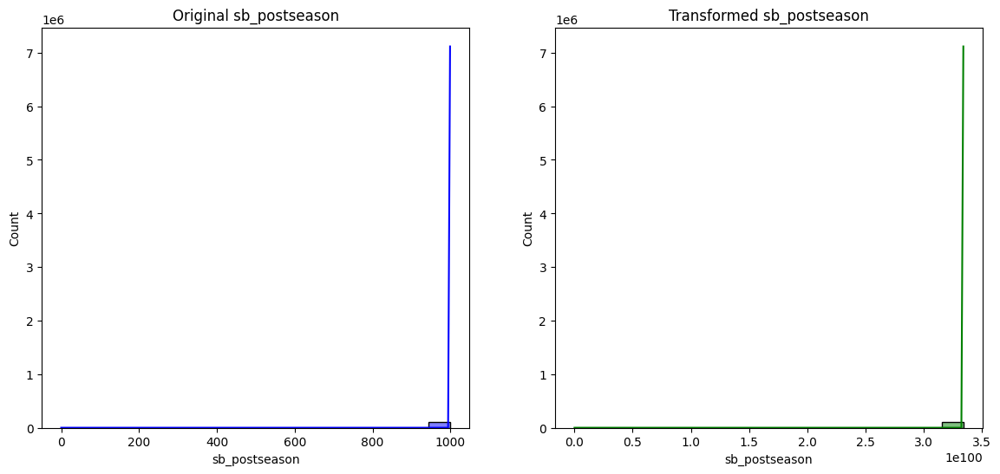

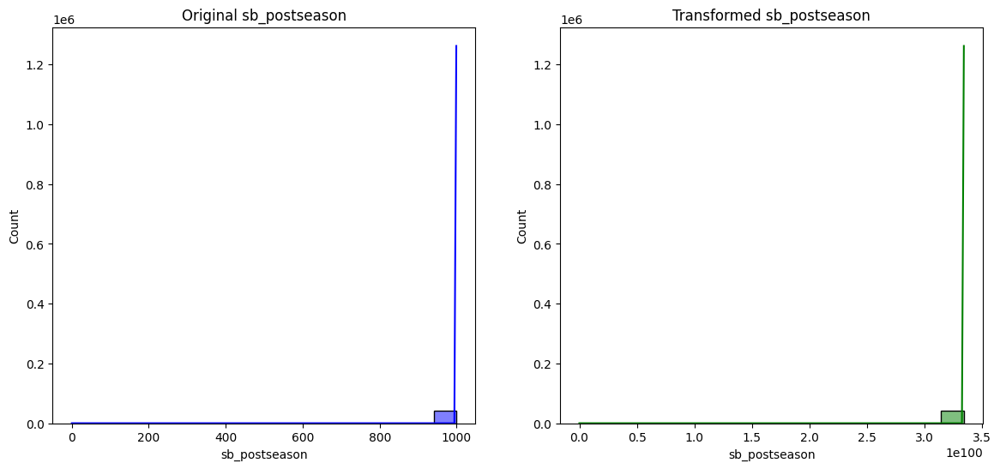

Comparing original and transformed distributions for cs_postseason


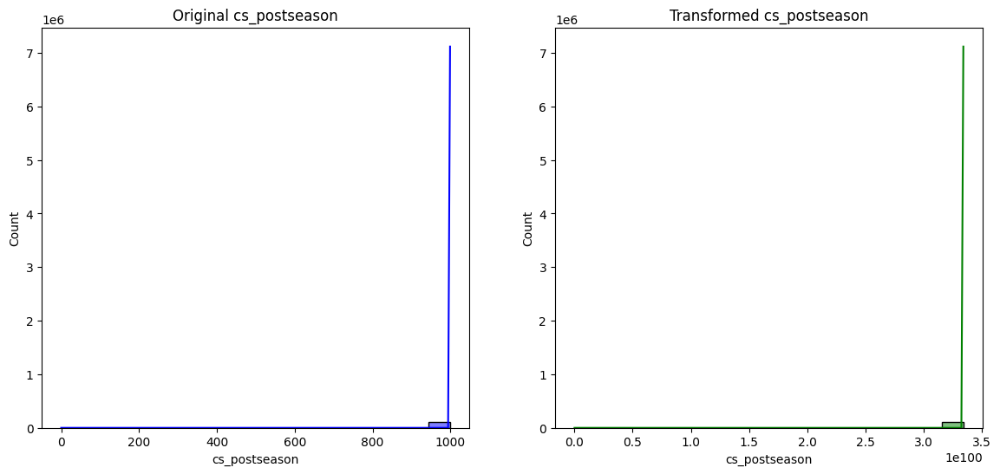

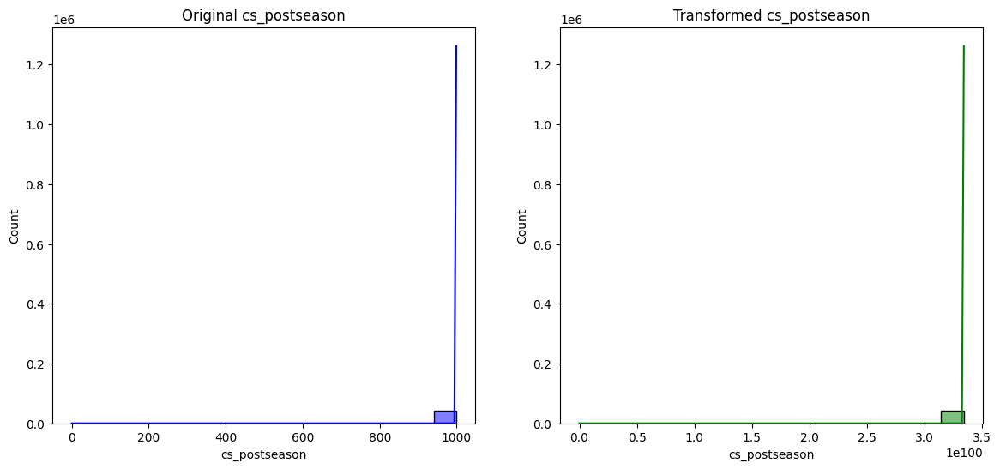

Comparing original and transformed distributions for bb_postseason


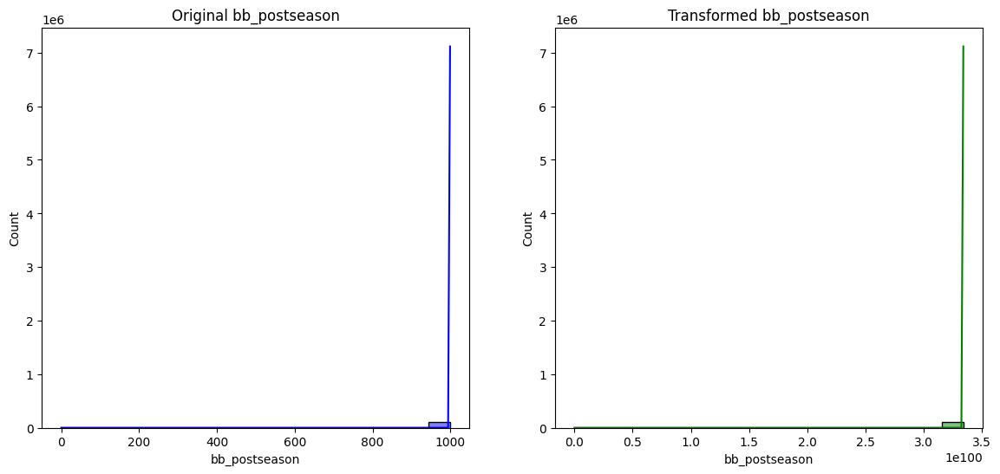

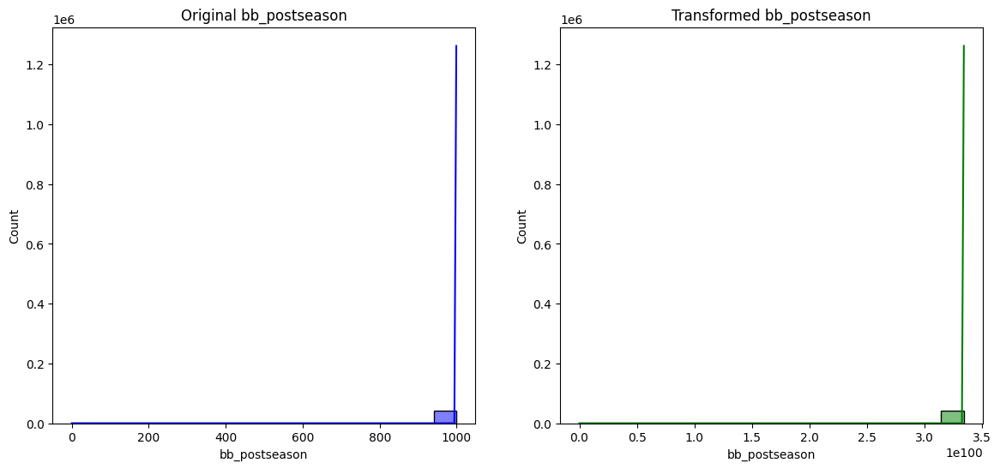

Comparing original and transformed distributions for so_postseason


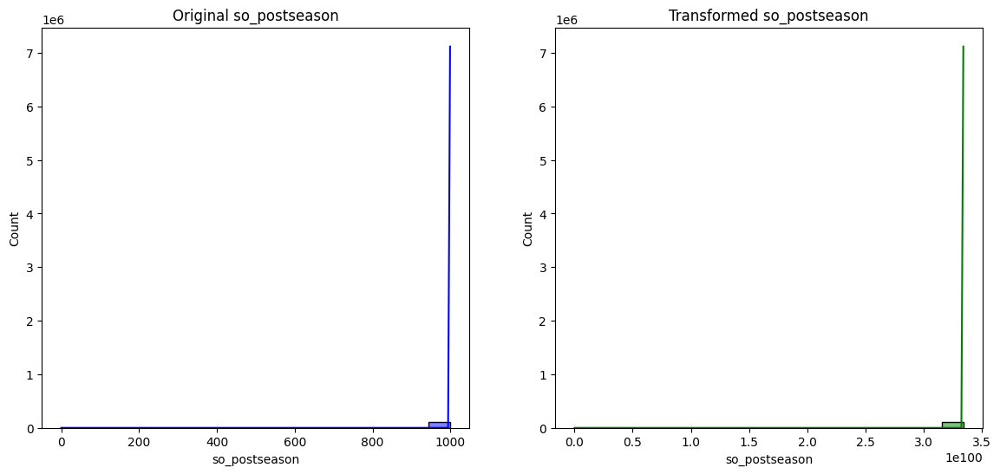

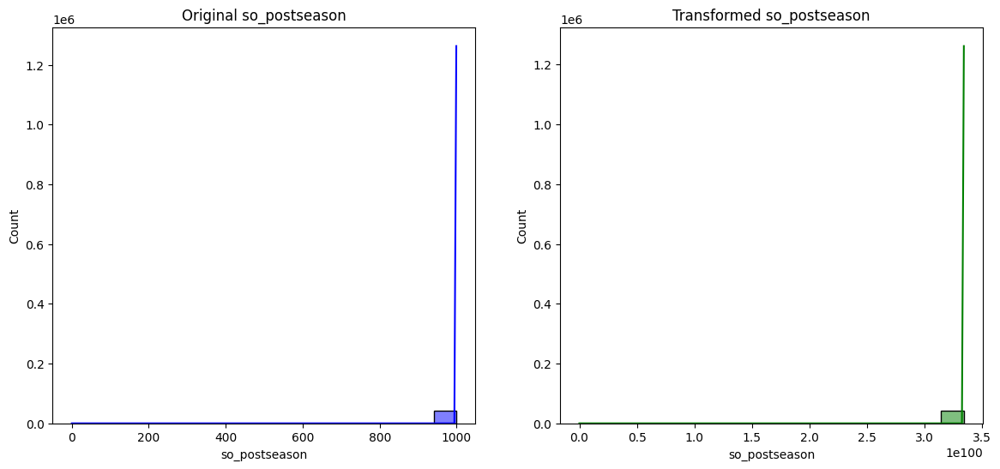

Comparing original and transformed distributions for ibb_postseason


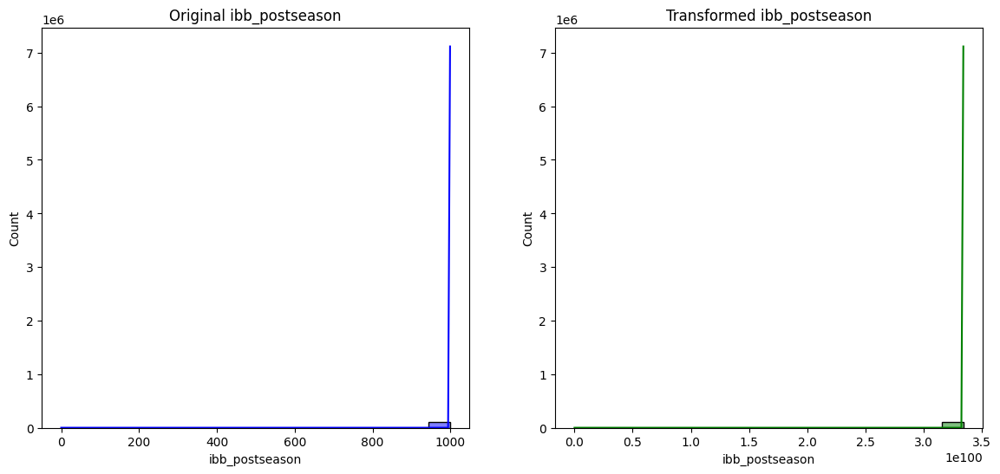

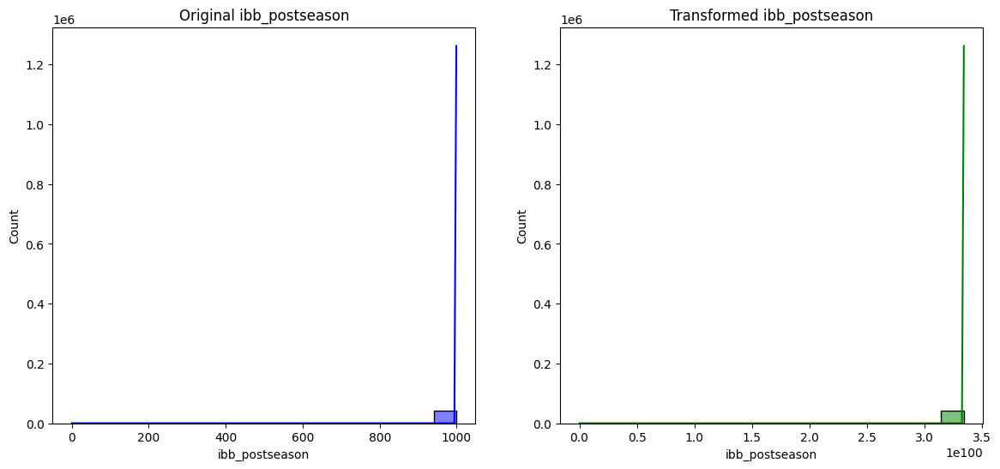

Comparing original and transformed distributions for hbp_postseason


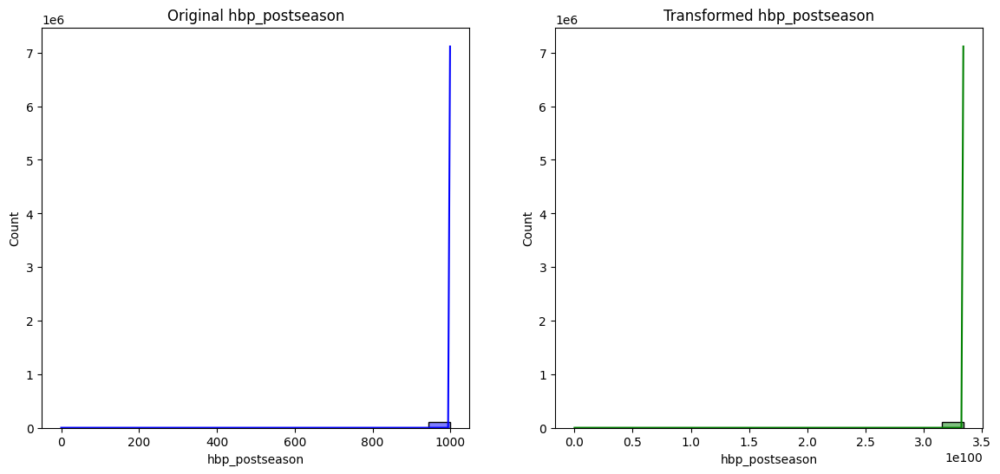

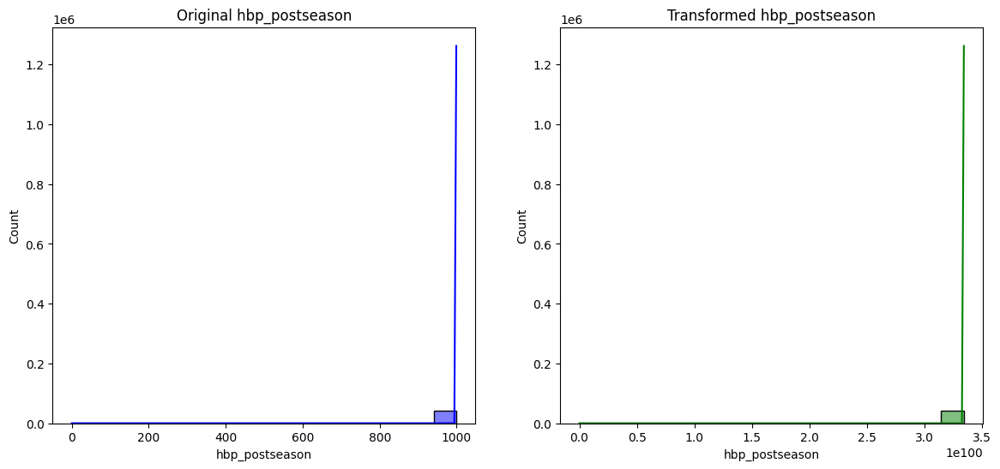

Comparing original and transformed distributions for g_idp_postseason


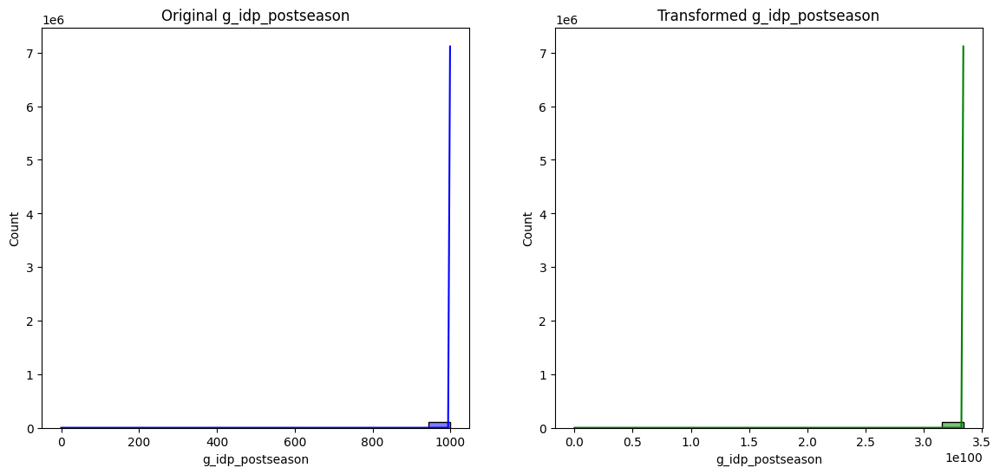

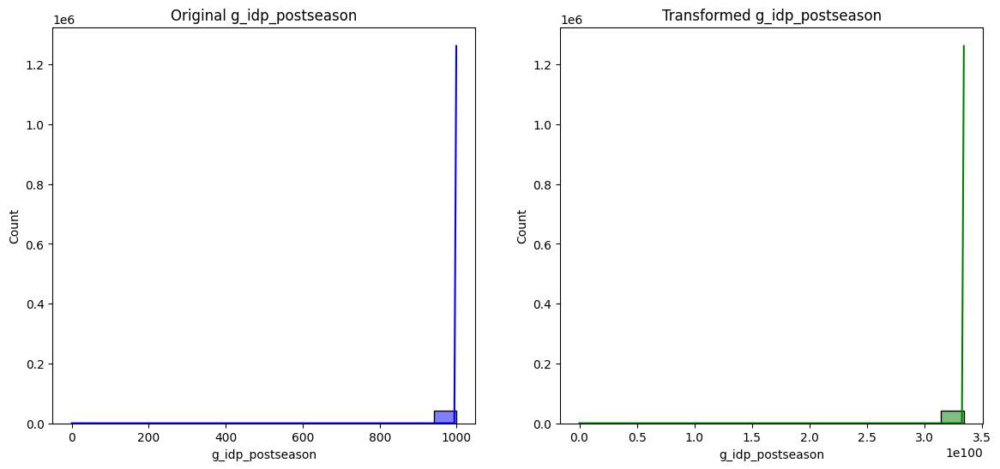

Comparing original and transformed distributions for batting_average_postseason


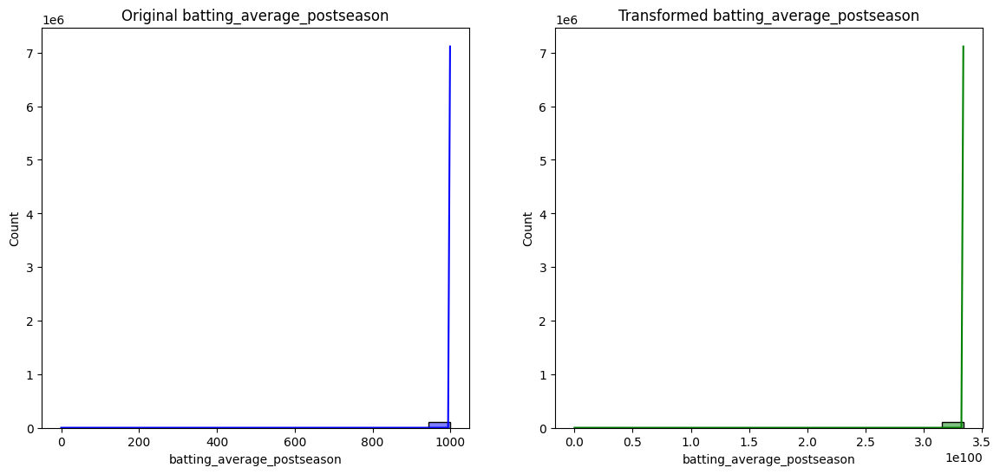

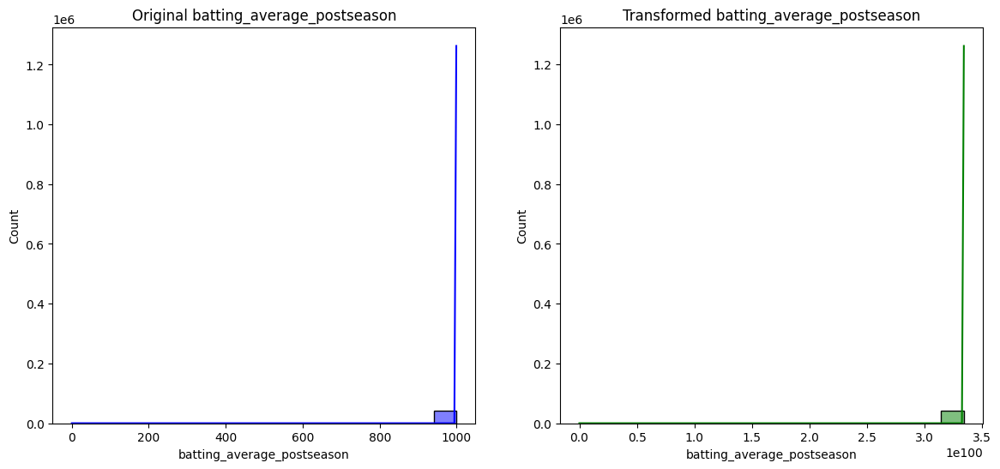

Comparing original and transformed distributions for on_base_percentage_postseason


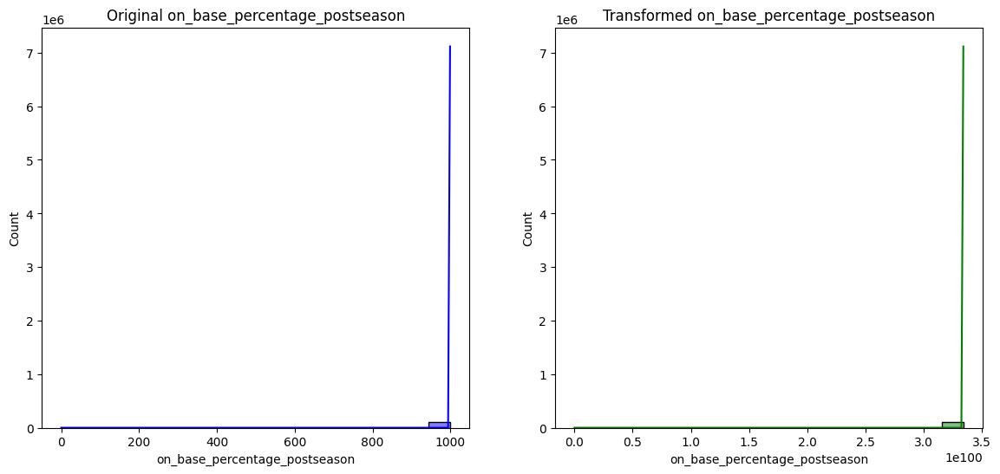

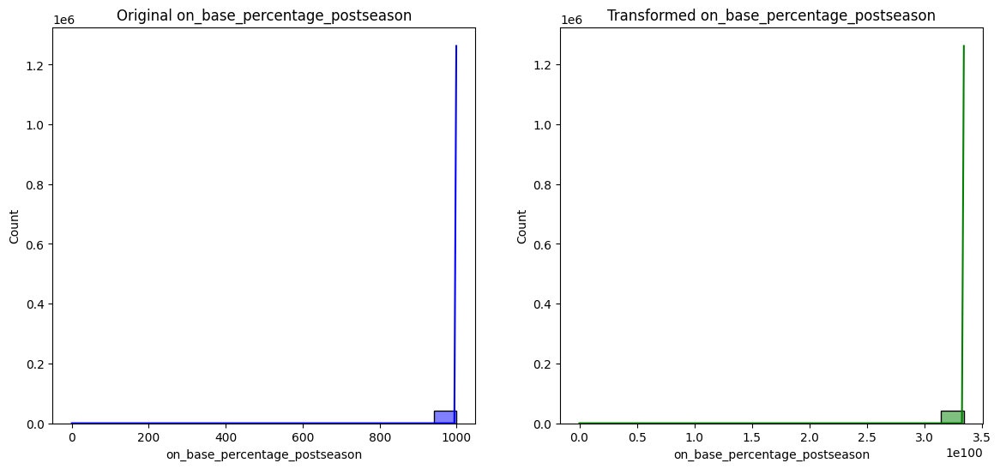

Comparing original and transformed distributions for slugging_percentage_postseason


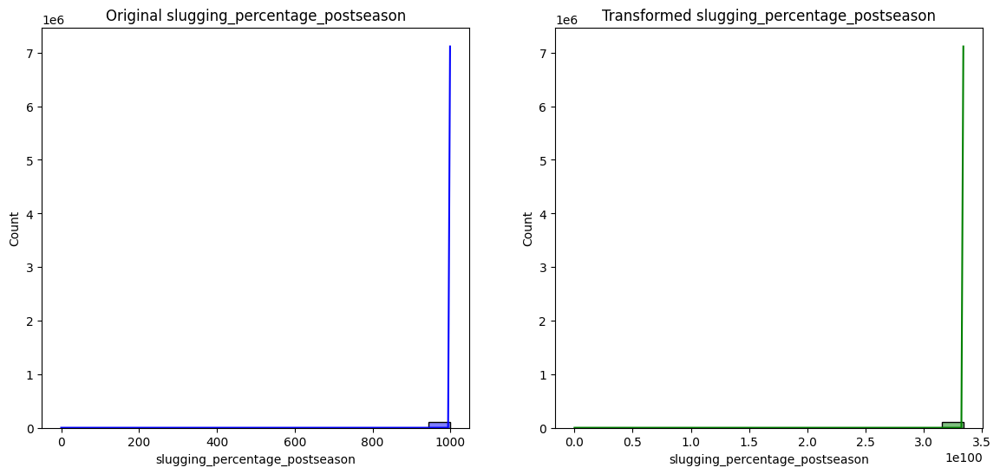

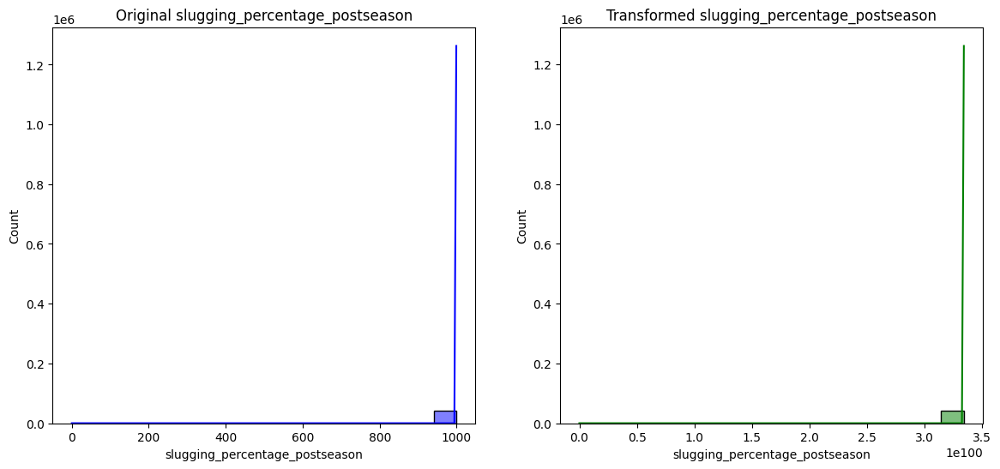

Comparing original and transformed distributions for votes


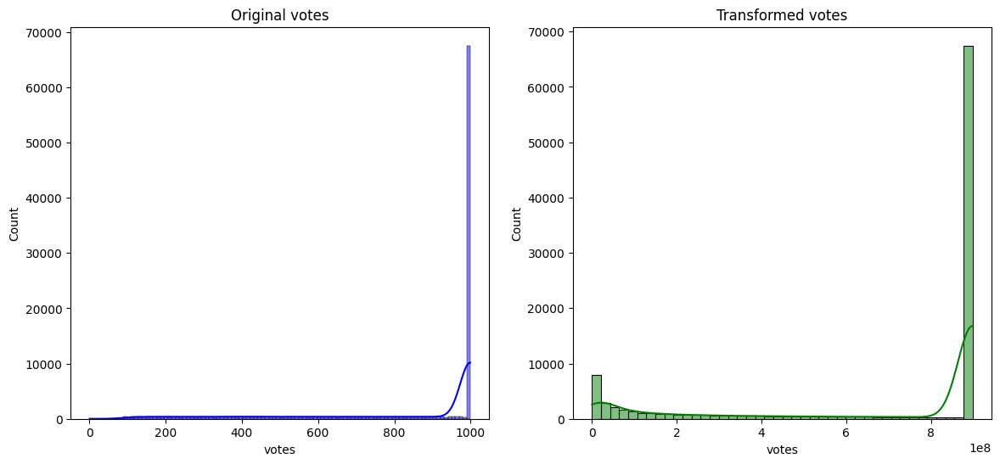

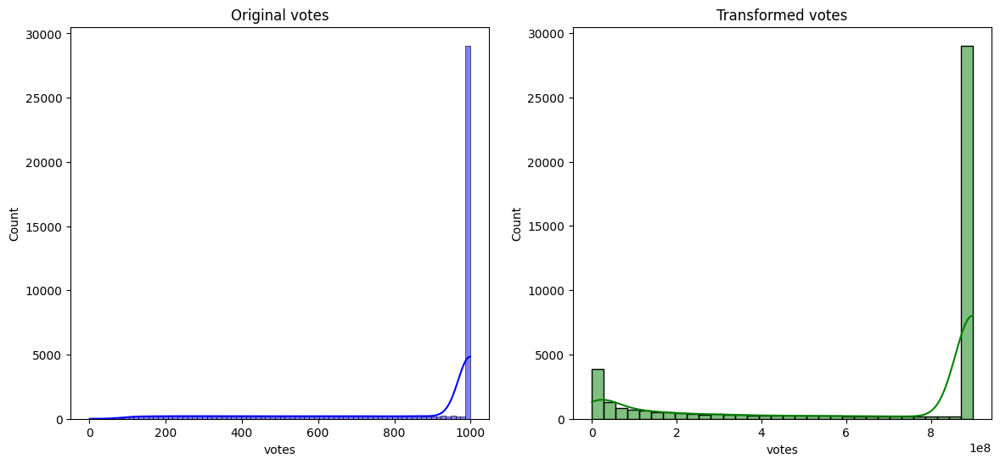

Comparing original and transformed distributions for induction_chances


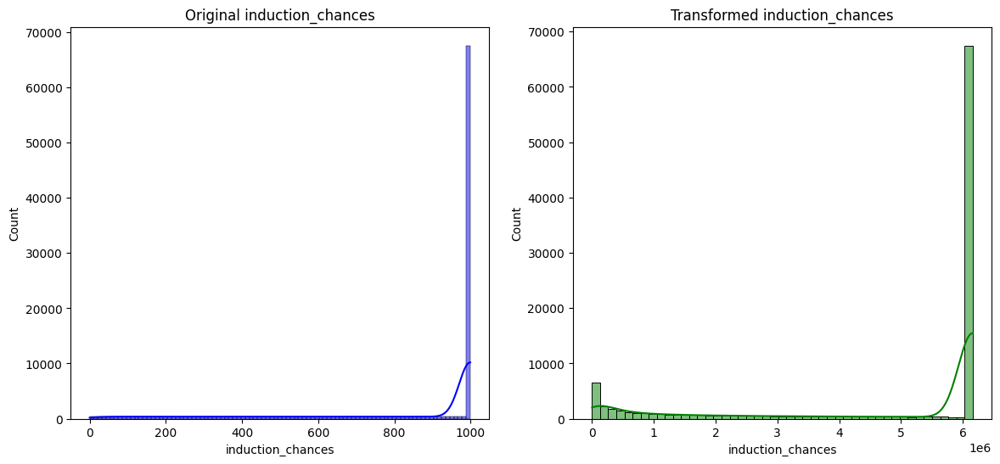

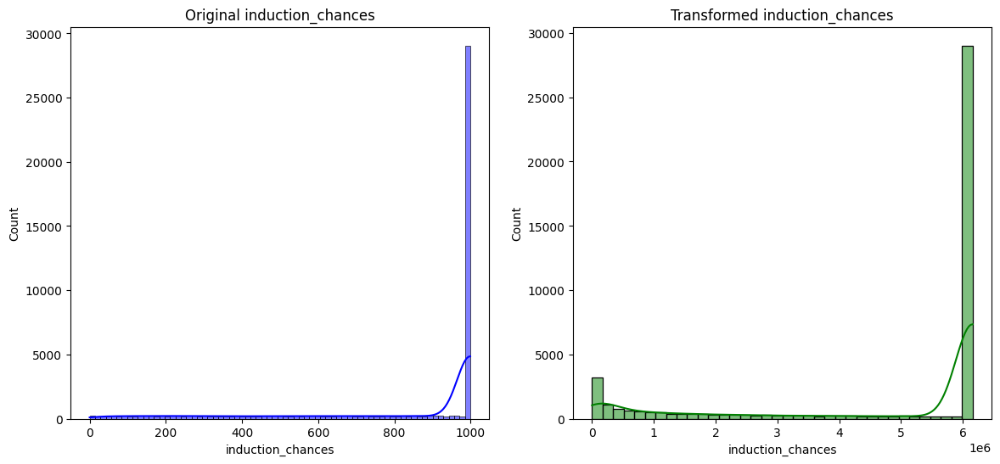

Comparing original and transformed distributions for game_num


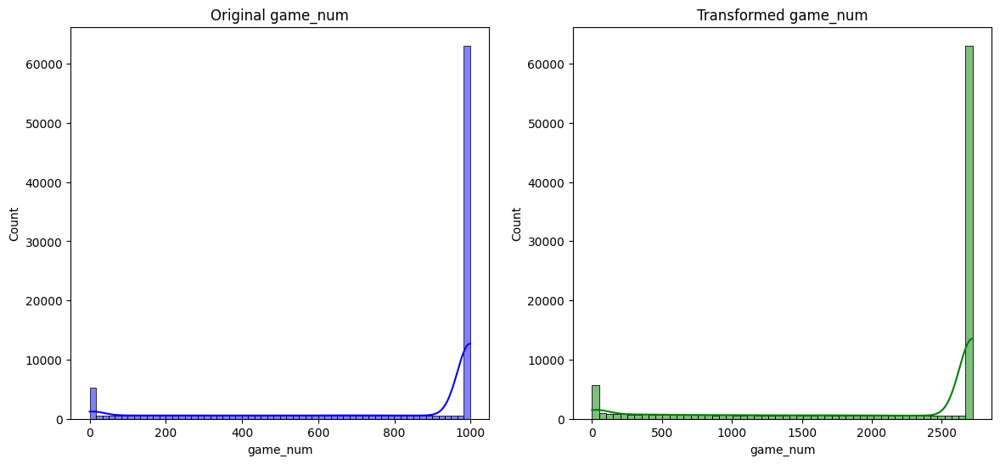

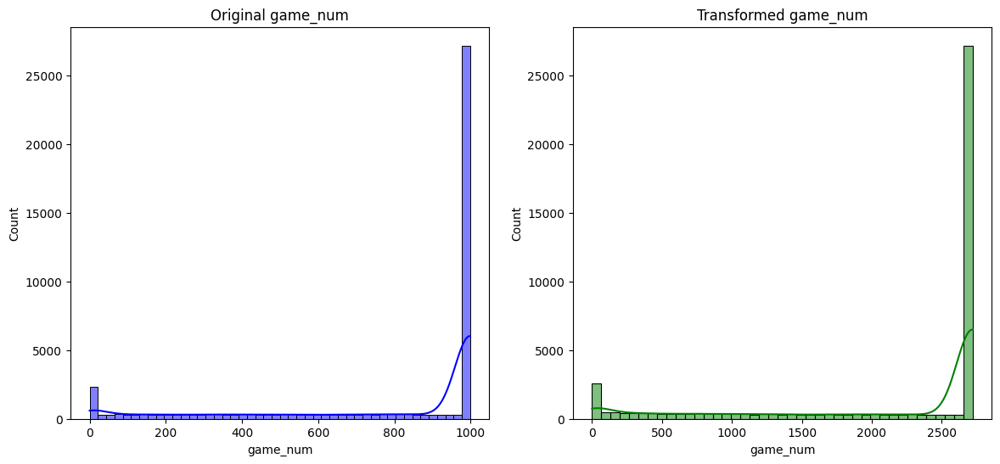

Comparing original and transformed distributions for gp


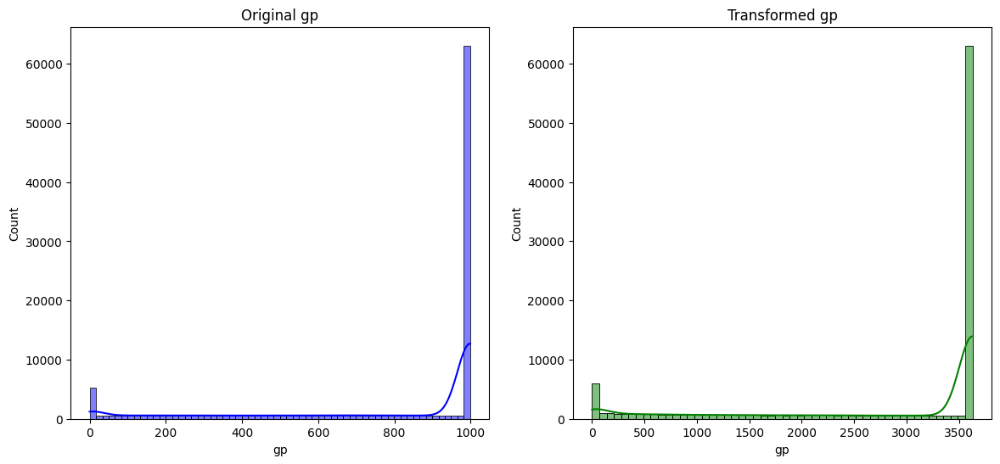

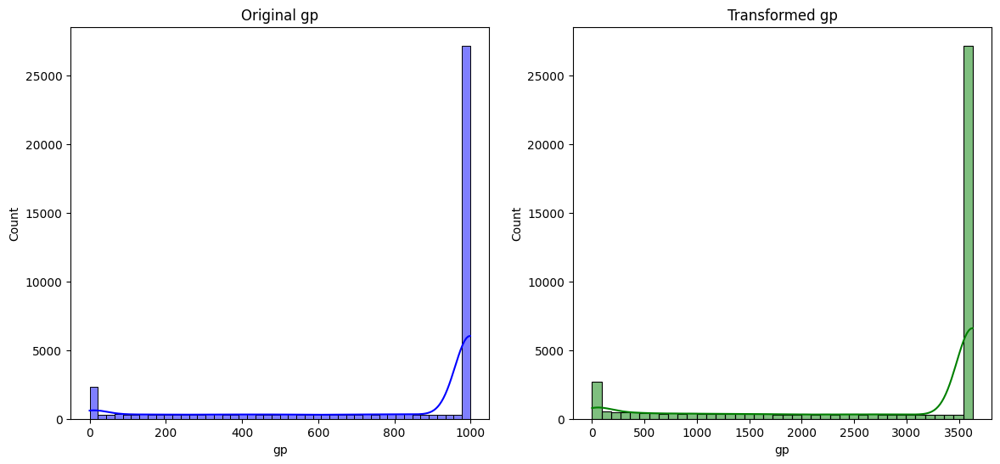

Comparing original and transformed distributions for points_won


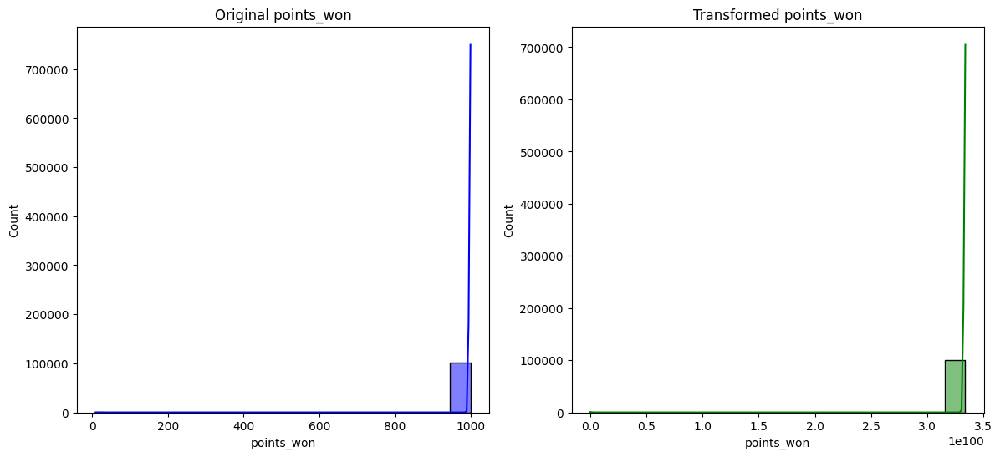

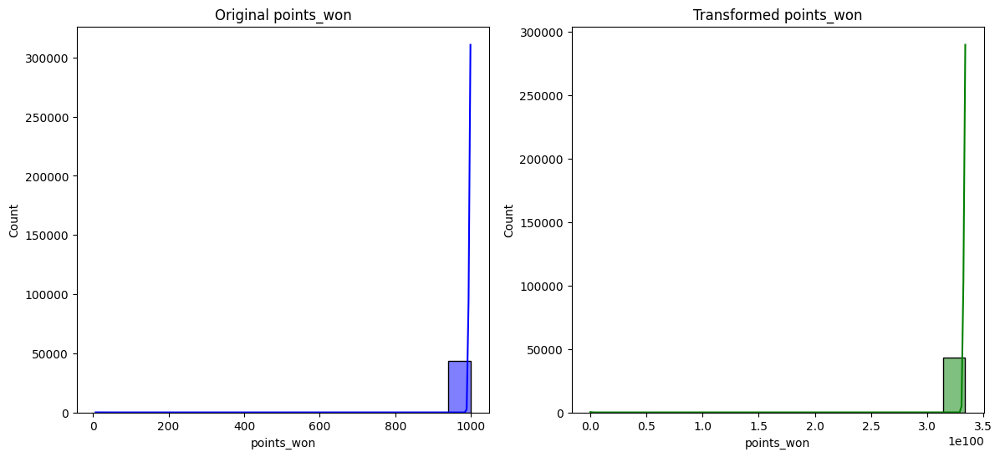

Comparing original and transformed distributions for points_max


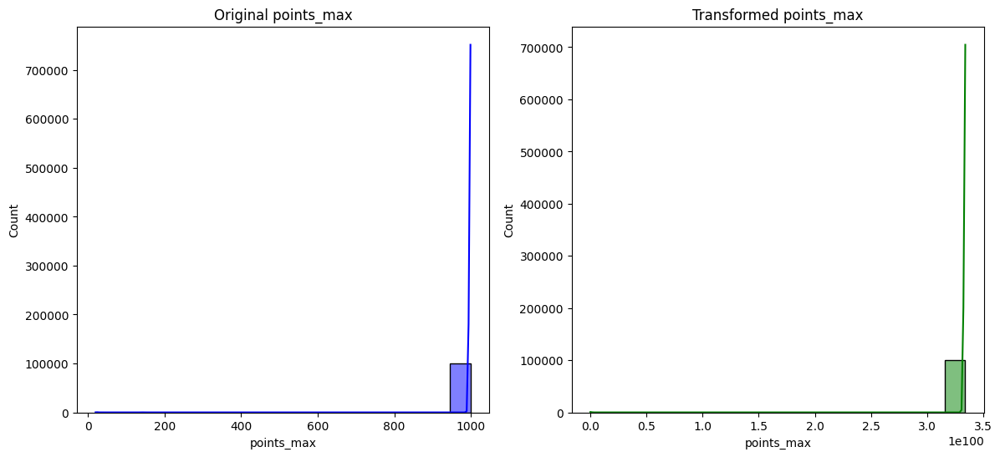

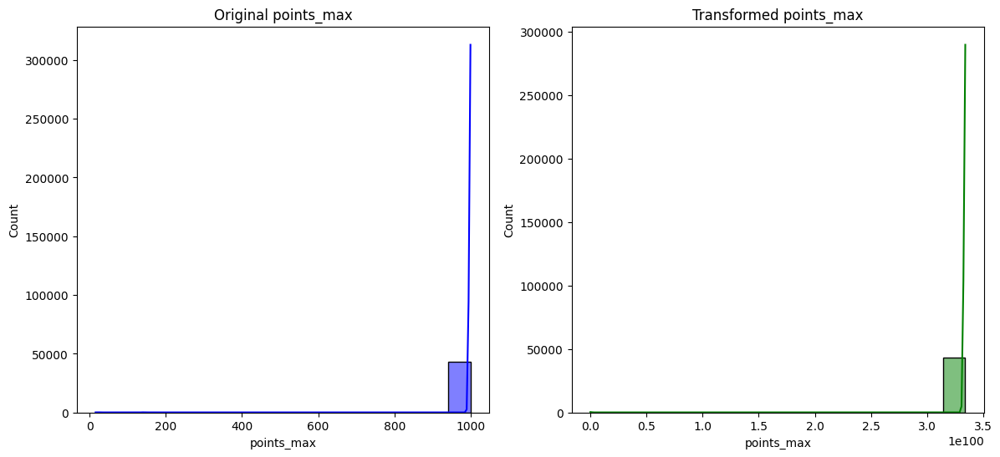

Comparing original and transformed distributions for votes_first


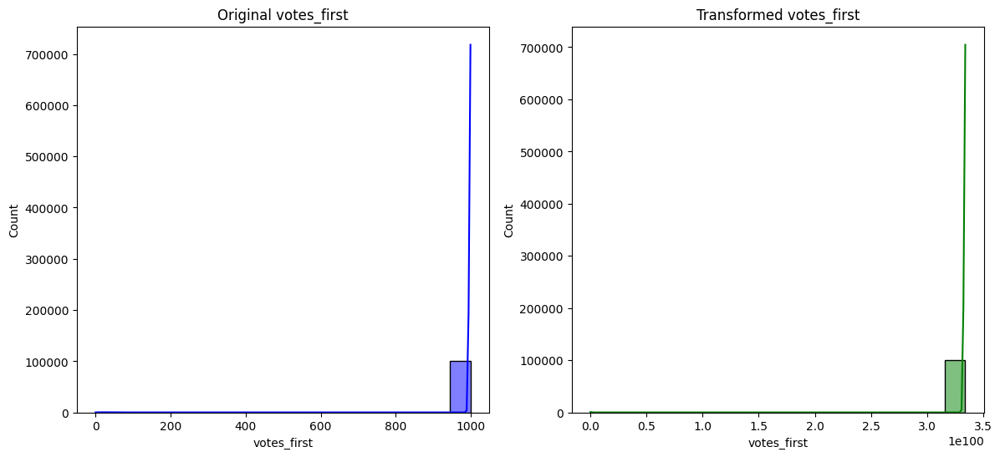

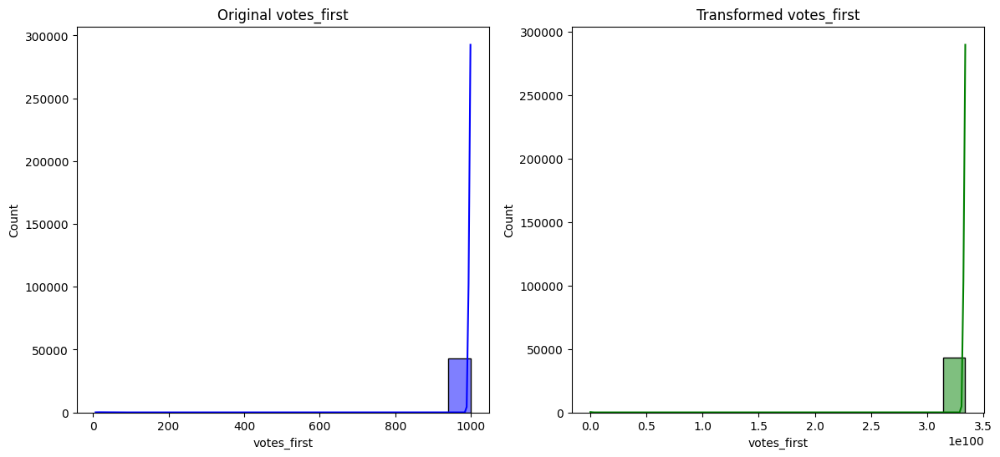

In [1130]:
for variable_name in num_cols_batting:
    print(f'Comparing original and transformed distributions for {variable_name}')
    
    # Check for training data
    plot_transformation_comparison(X_train_batting_imputed, 
                                   pd.DataFrame(X_train_batting_transformed, columns=X_train_batting_imputed.columns), 
                                   variable_name)
    
    # Check for test data
    plot_transformation_comparison(X_test_batting_imputed, 
                                   pd.DataFrame(X_test_batting_transformed, columns=X_test_batting_imputed.columns), 
                                   variable_name)

In [1131]:
round_order = ['AEDIV', 'AWDIV', 'NEDIV', 'NWDIV', 'ALWC', 'NLWC', 
               'ALDS1', 'ALDS2', 'NLDS1', 'NLDS2', 'ALCS', 'NLCS', 'WS']

In [1132]:
award_ranking = {
    'Most Valuable Player': 1,
    'Cy Young Award': 2,
    'Rookie of the Year': 3,
    'World Series MVP': 4,
    'Hank Aaron Award': 5,
    'Gold Glove': 6,
    'Silver Slugger': 7,
    'Pitching Triple Crown': 8,
    'Triple Crown': 9,
    'Roberto Clemente Award': 10,
    'TSN Major League Player of the Year': 11,
    'TSN Player of the Year': 12,
    'TSN Pitcher of the Year': 13,
    'Comeback Player of the Year': 14,
    'All-Star Game MVP': 15,
    'NLCS MVP': 16,
    'ALCS MVP': 17,
    'Branch Rickey Award': 18,
    'Babe Ruth Award': 19,
    'TSN Fireman of the Year': 20,
    'TSN Reliever of the Year': 21,
    'Rolaids Relief Man Award': 22,
    'TSN Guide MVP': 23,
    'TSN All-Star': 24,
    'Baseball Magazine All-Star': 25,
    'Hutch Award': 26,
    'Lou Gehrig Memorial Award': 27,
    # 'No Award' : 28
}

In [1133]:
# Define the ordinal encoder
ordinal_round = OrdinalEncoder(categories=[round_order], handle_unknown='use_encoded_value', unknown_value=-1)

# Apply ordinal encoding to 'round' column
X_train_batting_enc = X_train_batting_transformed.copy()
X_test_batting_enc = X_test_batting_transformed.copy()

# Fit and transform the 'round' column
X_train_batting_enc['round'] = ordinal_round.fit_transform(X_train_batting_enc[['round']])
X_test_batting_enc['round'] = ordinal_round.transform(X_test_batting_enc[['round']])

In [1134]:
ordinal_award = OrdinalEncoder(categories=[list(award_ranking.keys())], handle_unknown='use_encoded_value', unknown_value=-1)

# Apply ordinal encoding to 'award_id' column
X_train_batting_enc = X_train_batting_enc.copy()
X_test_batting_enc = X_test_batting_enc.copy()

# Fit and transform the 'award_id' column
X_train_batting_enc['award_id'] = ordinal_award.fit_transform(X_train_batting_enc[['award_id']])
X_test_batting_enc['award_id'] = ordinal_award.transform(X_test_batting_enc[['award_id']])

In [1135]:
# def find_unknown_categories(train_df, new_df, categorical_columns):
#     unknown_categories = {}

#     for col in categorical_columns:
#         train_categories = set(train_df[col].unique())
#         new_categories = set(new_df[col].unique())
        
#         unknowns = new_categories - train_categories
#         if unknowns:
#             unknown_categories[col] = unknowns

#     return unknown_categories


In [1136]:
# # 1. Check data types
# print("Data types in X_train:")
# print(X_train[['round', 'award_id']].dtypes)
# print("\nData types in X_test:")
# print(X_test[['round', 'award_id']].dtypes)

# # 2. Check for continuous data being treated as categorical
# def check_continuous(df, columns):
#     for col in columns:
#         unique_values = df[col].nunique()
#         if unique_values > 10:  # arbitrary threshold
#             print(f"Column {col} might be continuous. It has {unique_values} unique values.")
#             print(f"Sample values: {df[col].sample(5).tolist()}")

# print("\nChecking for potentially continuous data in X_train:")
# check_continuous(X_train, ['round', 'award_id'])
# print("\nChecking for potentially continuous data in X_test:")
# check_continuous(X_test, ['round', 'award_id'])

# # 3. Check for inconsistent categories between train and test
# def compare_categories(train, test, columns):
#     for col in columns:
#         train_categories = set(train[col].unique())
#         test_categories = set(test[col].unique())
#         diff = test_categories - train_categories
#         if diff:
#             print(f"Column {col} has categories in test that are not in train: {diff}")

# print("\nChecking for inconsistent categories:")
# compare_categories(X_train, X_test, ['round', 'award_id'])

# # 4. Check for floating point issues
# def check_float_precision(df, columns):
#     for col in columns:
#         if df[col].dtype in ['float64', 'float32']:
#             rounded = df[col].round(6)
#             if not (df[col] == rounded).all():
#                 print(f"Column {col} might have floating point precision issues.")
#                 print(f"Sample original: {df[col].head()}")
#                 print(f"Sample rounded: {rounded.head()}")

# print("\nChecking for floating point precision issues in X_train:")
# check_float_precision(X_train, ['round', 'award_id'])
# print("\nChecking for floating point precision issues in X_test:")
# check_float_precision(X_test, ['round', 'award_id'])

# # 5. Check the transformation process
# print("\nShape of X_train before and after transformation:")
# print(f"Before: {X_train.shape}, After: {X_train_transformed.shape}")
# print("\nShape of X_test before and after transformation:")
# print(f"Before: {X_test.shape}, After: {X_test_transformed.shape}")

# # 6. Check for NaN or infinite values
# def check_nan_inf(df, columns):
#     for col in columns:
#         nan_count = df[col].isna().sum()
#         inf_count = np.isinf(df[col]).sum() if df[col].dtype in ['float64', 'float32'] else 0
#         if nan_count > 0 or inf_count > 0:
#             print(f"Column {col} has {nan_count} NaN values and {inf_count} infinite values.")

# print("\nChecking for NaN or infinite values in X_train_transformed:")
# check_nan_inf(X_train_transformed, X_train_transformed.columns)
# print("\nChecking for NaN or infinite values in X_test_transformed:")
# check_nan_inf(X_test_transformed, X_test_transformed.columns)

# # 7. Print unique values
# print("\nUnique values in 'round' column:")
# print("Train:", X_train['round'].unique())
# print("Test:", X_test['round'].unique())

# print("\nUnique values in 'award_id' column:")
# print("Train:", X_train['award_id'].unique())
# print("Test:", X_test['award_id'].unique())

In [1137]:
def analyze_columns(df, threshold=20):
    discrete_columns = []
    continuous_columns = []

    for column in df.columns:
        if df[column].dtype in ['int64', 'float64']:
            unique_values = df[column].nunique()
            
            if unique_values <= threshold:
                discrete_columns.append(column)
            else:
                # Check for tail using skewness
                skewness = stats.skew(df[column].dropna())
                
                if abs(skewness) > 0.5:  # This threshold can be adjusted
                    continuous_columns.append(column)
                else:
                    discrete_columns.append(column)
    
    return discrete_columns, continuous_columns

def plot_distributions(df, discrete_columns, continuous_columns, num_plots=3):
    fig, axes = plt.subplots(2, num_plots, figsize=(15, 10))
    
    for i, column in enumerate(discrete_columns[:num_plots]):
        df[column].value_counts().sort_index().plot(kind='bar', ax=axes[0, i], title=f'Discrete: {column}')
    
    for i, column in enumerate(continuous_columns[:num_plots]):
        df[column].hist(ax=axes[1, i], bins=30)
        axes[1, i].set_title(f'Continuous: {column}')
    
    plt.tight_layout()
    plt.show()

# Analyze columns
discrete_cols, continuous_cols = analyze_columns(X_batting)

print("Discrete columns:", discrete_cols)
print("\nContinuous columns with tails:", continuous_cols)

Discrete columns: ['zr', 'gs_fielding_postseason', 'inn_outs_fielding_postseason', 'po_fielding_postseason', 'a_fielding_postseason', 'e_fielding_postseason', 'dp_fielding_postseason', 'tp', 'pb_fielding_postseason', 'sb_fielding_postseason', 'cs_fielding_postseason', 'g_postseason', 'ab_postseason', 'r_postseason', 'h_postseason', 'double_postseason', 'triple_postseason', 'hr_postseason', 'rbi_postseason', 'sb_postseason', 'cs_postseason', 'bb_postseason', 'so_postseason', 'ibb_postseason', 'hbp_postseason', 'g_idp_postseason', 'batting_average_postseason', 'on_base_percentage_postseason', 'slugging_percentage_postseason', 'votes', 'game_num', 'gp', 'points_won', 'points_max', 'votes_first']

Continuous columns with tails: ['g', 'ab', 'r', 'h', 'double', 'triple', 'hr', 'rbi', 'sb', 'cs', 'bb', 'so', 'ibb', 'hbp', 'g_idp', 'batting_average', 'on_base_percentage', 'slugging_percentage', 'years_since_debut', 'gs', 'inn_outs', 'po', 'a', 'e', 'dp', 'pb', 'wp', 'sb_fielding', 'cs_fielding

In [1138]:
disc = EqualWidthDiscretiser(bins=20, variables=discrete_cols)

disc.fit(X_train_batting_enc)

EqualWidthDiscretiser(bins=20,
                      variables=['zr', 'gs_fielding_postseason',
                                 'inn_outs_fielding_postseason',
                                 'po_fielding_postseason',
                                 'a_fielding_postseason',
                                 'e_fielding_postseason',
                                 'dp_fielding_postseason', 'tp',
                                 'pb_fielding_postseason',
                                 'sb_fielding_postseason',
                                 'cs_fielding_postseason', 'g_postseason',
                                 'ab_postseason', 'r_postseason',
                                 'h_postseason', 'double_postseason',
                                 'triple_postseason', 'hr_postseason',
                                 'rbi_postseason', 'sb_postseason',
                                 'cs_postseason', 'bb_postseason',
                                 'so_postseason', 'ibb_postseason',
                                 'hbp_postseason', 'g_idp_postseason',
                                 'batting_average_postseason',
                                 'on_base_percentage_postseason',
                                 'slugging_percentage_postseason', 'votes', ...])

In [1139]:
X_train_batting_discrete = disc.transform(X_train_batting_enc)
X_test_batting_discrete = disc.transform(X_test_batting_enc)

In [1140]:
disc = EqualFrequencyDiscretiser(q=20, variables=continuous_cols)

disc.fit(X_train_batting_discrete)

EqualFrequencyDiscretiser(q=20,
                          variables=['g', 'ab', 'r', 'h', 'double', 'triple',
                                     'hr', 'rbi', 'sb', 'cs', 'bb', 'so', 'ibb',
                                     'hbp', 'g_idp', 'batting_average',
                                     'on_base_percentage',
                                     'slugging_percentage', 'years_since_debut',
                                     'gs', 'inn_outs', 'po', 'a', 'e', 'dp',
                                     'pb', 'wp', 'sb_fielding', 'cs_fielding',
                                     'induction_chances'])

In [1141]:
X_train_batting_discrete = disc.transform(X_train_batting_discrete)
X_test_batting_discrete = disc.transform(X_test_batting_discrete)

In [1142]:
scaler = RobustScaler()

scaler.fit(X_train_batting_discrete)

RobustScaler()

In [1143]:
X_train_batting_scaled = scaler.transform(X_train_batting_discrete)
X_test_batting_scaled = scaler.transform(X_test_batting_discrete)

In [1144]:
X_train_batting_scaled = pd.DataFrame(X_train_batting_scaled, columns=X_train_batting.columns)
X_test_batting_scaled = pd.DataFrame(X_test_batting_scaled, columns=X_test_batting.columns)

C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\1173593689.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(X_train_batting_scaled[i], ax=ax1, label = i)
C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\1173593689.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(X_train_batting_scaled[i], ax=ax1, label = i)
C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\1173593689.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(X_train_batting_scaled[i], ax=ax1, label = i)
C:\Users\VICTUS\AppData\Local\Temp\ipykernel_3904\1173593689.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(X_train_batting_scaled[i], ax=ax1, label = i)
C:\Users\VICTUS\AppData\Loca

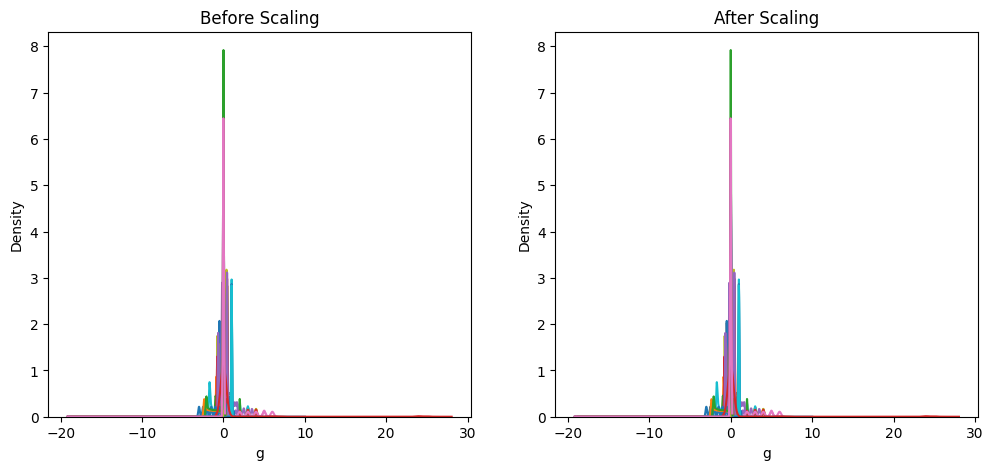

In [1145]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 5))

# Before Scaling
ax1.set_title('Before Scaling')
for i in X_train_batting.columns:
    sns.kdeplot(X_train_batting_scaled[i], ax=ax1, label = i)

# After Scaling
ax2.set_title('After Scaling')
for i in X_train_batting.columns:
    sns.kdeplot(X_train_batting_scaled[i], ax=ax2, label = i)

In [1146]:
# def print_summary_statistics(original_data, scaled_data, variable_name):
#     original_summary = original_data[variable_name].describe()
#     scaled_summary = pd.Series(scaled_data[:, original_data.columns.get_loc(variable_name)]).describe()

#     print(f"Summary Statistics for '{variable_name}':")
#     print("\nOriginal Data:")
#     print(original_summary)
#     print("\nScaled Data:")
#     print(scaled_summary)
#     print("\n" + "="*50 + "\n")

In [1147]:
# def plot_scaling_comparison(original_data, scaled_data, variable_name):
#     plt.figure(figsize=(14, 6))
    
#     # Plot original data distribution
#     plt.subplot(1, 2, 1)
#     sns.boxplot(x=original_data[variable_name], color='blue')
#     plt.title(f'Original {variable_name}')
    
#     # Plot scaled data distribution
#     plt.subplot(1, 2, 2)
#     sns.boxplot(x=scaled_data[:, original_data.columns.get_loc(variable_name)], color='green')
#     plt.title(f'Scaled {variable_name}')
    
#     plt.show()

In [1148]:
# variable_to_check = X_train_batting_enc.columns[0]  # Change this to the specific variable you want to check

# # Check summary statistics
# print_summary_statistics(X_train_batting_enc, X_train_batting_scaled, variable_to_check)

# # Visualize the scaling for the selected variable
# plot_scaling_comparison(X_train_batting_enc, X_train_batting_scaled, variable_to_check)

In [1149]:
column_names = X_train_batting.columns
X_train_batting_scaled_df = pd.DataFrame(X_train_batting_scaled, columns=column_names)
X_test_batting_scaled_df = pd.DataFrame(X_test_batting_scaled, columns=column_names)

In [1150]:
# for variable_name in column_names:
#     print(f'Comparing original and scaled distributions for {variable_name}')
    
#     # Check summary statistics for training data
#     print_summary_statistics(X_train_batting, X_train_batting_scaled_df, variable_name)
    
#     # Visualize the scaling for the selected variable
#     plot_scaling_comparison(X_train_batting, X_train_batting_scaled_df, variable_name)

In [1151]:
print(X_train_batting_enc['round'].head())
print(X_train_batting_enc['award_id'].head())
print(X_train_batting_enc['round'].describe())
print(X_train_batting_enc['award_id'].describe())

46112    -1.0
133240   -1.0
32755    -1.0
118419   -1.0
7488     -1.0
Name: round, dtype: float64
46112    -1.0
133240   -1.0
32755    -1.0
118419   -1.0
7488     -1.0
Name: award_id, dtype: float64
count    100913.000000
mean         -0.999901
std           0.031479
min          -1.000000
25%          -1.000000
50%          -1.000000
75%          -1.000000
max           9.000000
Name: round, dtype: float64
count    100913.000000
mean         -0.399641
std           3.468847
min          -1.000000
25%          -1.000000
50%          -1.000000
75%          -1.000000
max          26.000000
Name: award_id, dtype: float64


In [1152]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

Before scaling:
                   g             ab              r              h  \
count  100913.000000  100913.000000  100913.000000  100913.000000   
mean        2.634018       3.273886       0.919657       1.434456   
std         1.206401       1.863345       0.731829       0.963674   
min         0.000000       0.000000       0.000000       0.000000   
25%         1.548993       2.071849       0.274233       0.804658   
50%         2.596449       3.102076       0.774423       1.231709   
75%         3.731619       4.805600       1.660140       2.344430   
max         4.534484       6.518452       2.198731       3.106288   

              double         triple             hr            rbi  \
count  100913.000000  100913.000000  100913.000000  100913.000000   
mean        0.371391       0.101039       0.146945       0.738761   
std         0.478453       0.171326       0.241471       0.668149   
min         0.000000       0.000000       0.000000       0.000000   
25%         0.000

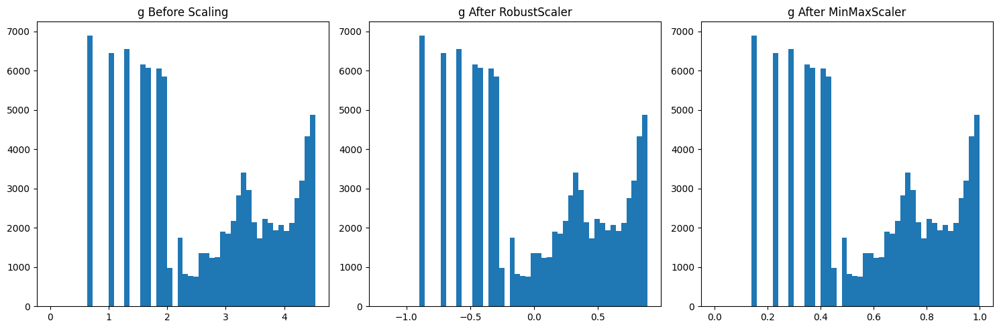

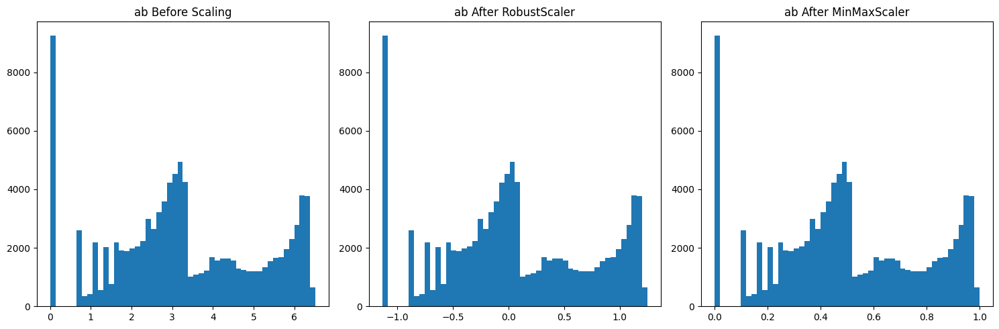

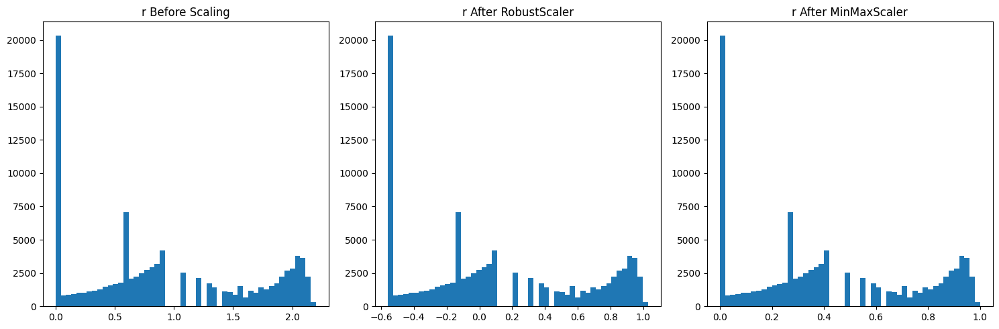

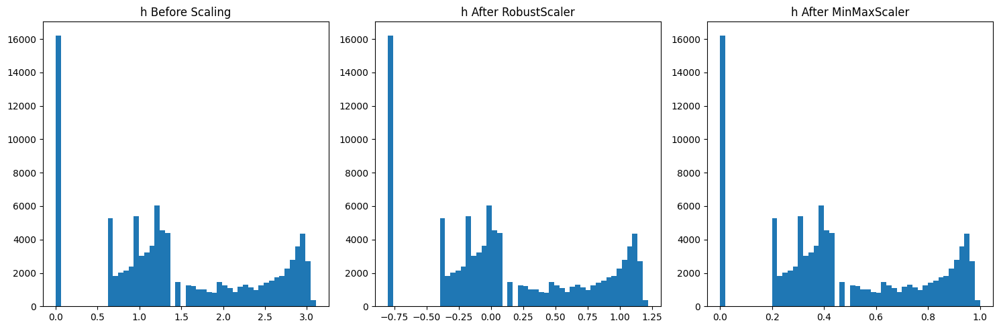

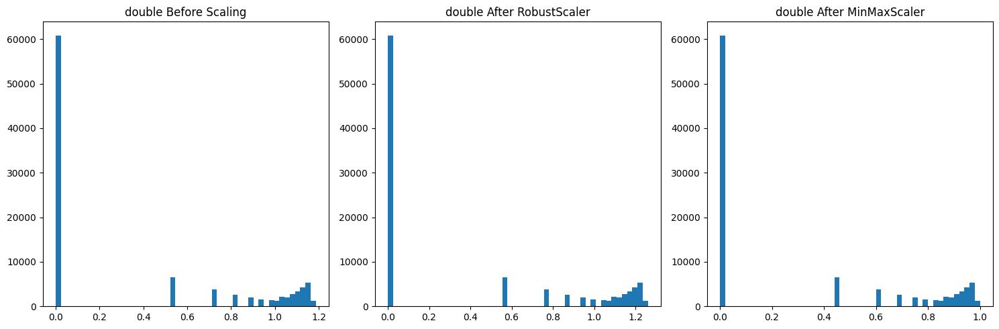

...

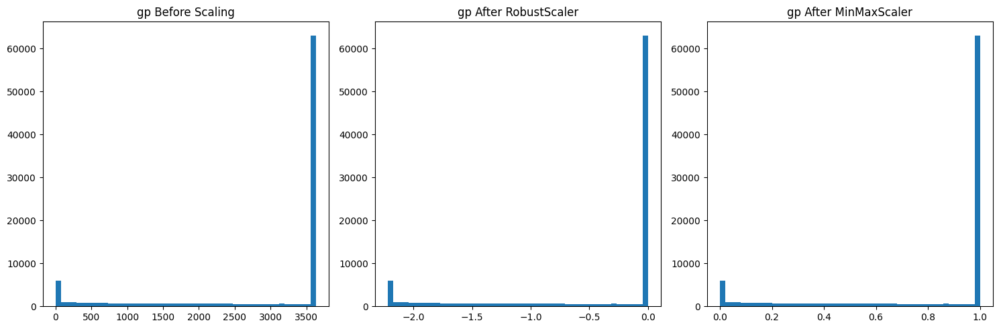

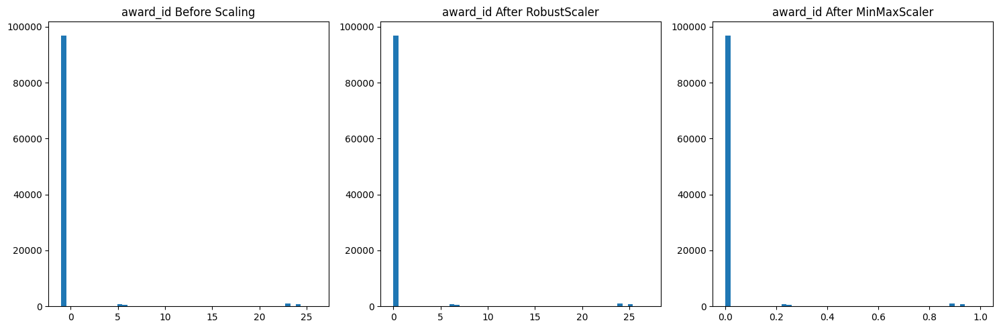

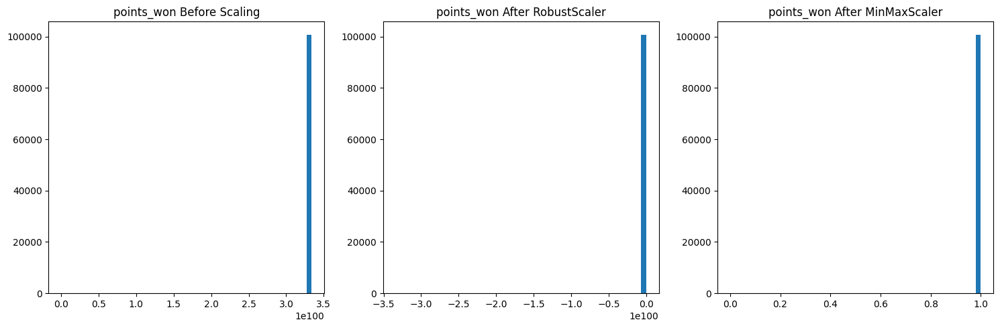

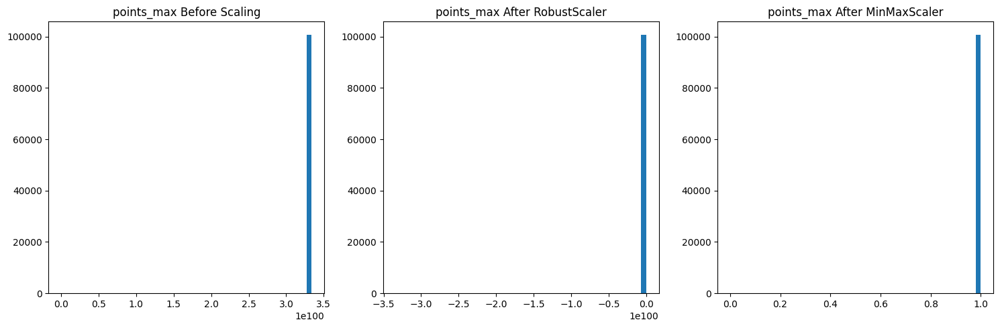

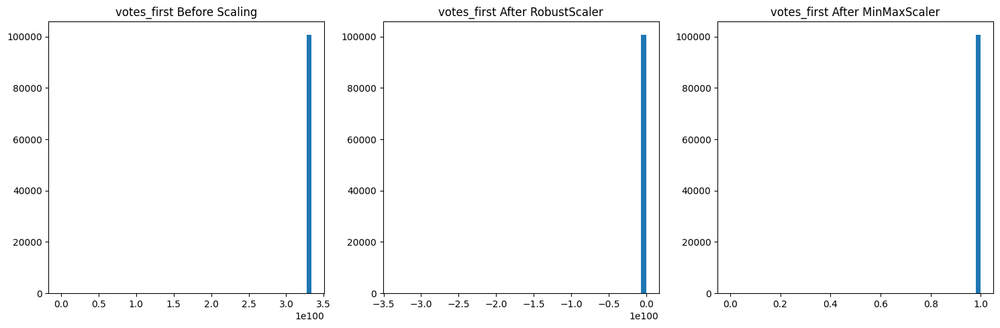

In [1153]:
print("Before scaling:")
print(X_train_batting_enc.describe())

# Apply MinMaxscaler
minmax_scaler = MinMaxScaler()
X_scaled_minmax = minmax_scaler.fit_transform(X_train_batting_enc)

# Apply RobustScaler
robust_scaler = RobustScaler()
X_scaled_robust = robust_scaler.fit_transform(X_train_batting_enc)

# Apply StandardScaler for comparison
standard_scaler = StandardScaler()
X_scaled_standard = standard_scaler.fit_transform(X_train_batting_enc)

print("\nAfter RobustScaler:")
print(pd.DataFrame(X_scaled_robust, columns=X_train_batting_enc.columns).describe())

print("\nAfter StandardScaler:")
print(pd.DataFrame(X_scaled_standard, columns=X_train_batting_enc.columns).describe())

# Visualize a single feature before and after scaling
for i in X_train_batting.columns:
    feature = i
    plt.figure(figsize=(15, 5))
    plt.subplot(131)
    plt.hist(X_train_batting_enc[feature], bins=50)
    plt.title(f"{feature} Before Scaling")
    plt.subplot(132)
    plt.hist(X_scaled_robust[:, X_train_batting_enc.columns.get_loc(feature)], bins=50)
    plt.title(f"{feature} After RobustScaler")
    # plt.subplot(133)
    # plt.hist(X_scaled_standard[:, X_train_batting_enc.columns.get_loc(feature)], bins=50)
    # plt.title(f"{feature} After StandardScaler")
    plt.subplot(133)
    plt.hist(X_scaled_minmax[:, X_train_batting_enc.columns.get_loc(feature)], bins=50)
    plt.title(f"{feature} After MinMaxScaler")
    plt.tight_layout()
    plt.show()

In [1154]:
# scaler2 = RobustScaler()

# scaler2.fit(X_train_pitching_enc)

In [1155]:
# X_train_pitching_scaled = scaler2.transform(X_train_pitching_enc)
# X_test_pitching_scaled = scaler2.transform(X_test_pitching_enc)

In [1156]:
# for i, col in enumerate(num_cols_batting):
#     fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 5))

#     # before scaling
#     ax1.set_title('Before Scaling')
#     sns.kdeplot(X_train_batting[col], ax=ax1, label=col)
#     ax1.legend()

#     # after scaling
#     ax2.set_title('After Scaling')
#     sns.kdeplot(X_train_batting_scaled[:, i], ax=ax2, label=col)  # Use integer index i for scaled data
#     ax2.legend()
#     plt.show()

In [1157]:
# for i, col in enumerate(num_cols_pitching):
#     fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 5))

#     # before scaling
#     ax1.set_title('Before Scaling')
#     sns.kdeplot(X_train_pitching[col], ax=ax1, label=col)
#     ax1.legend()

#     # after scaling
#     ax2.set_title('After Scaling')
#     sns.kdeplot(X_train_pitching_scaled[:, i], ax=ax2, label=col)  # Use integer index i for scaled data
#     ax2.legend()
#     plt.show()

In [1158]:
# column_names = X_train_pitching.columns
# X_train_pitching_scaled_df = pd.DataFrame(X_train_pitching_scaled, columns=column_names)

In [1159]:
column_names = X_train_batting.columns
X_train_batting_scaled_df = pd.DataFrame(X_train_batting_scaled, columns=column_names)

In [1160]:
# for variable in X_train_pitching_scaled_df.columns:
#     diagnostic_plots(X_train_pitching_scaled_df, variable)

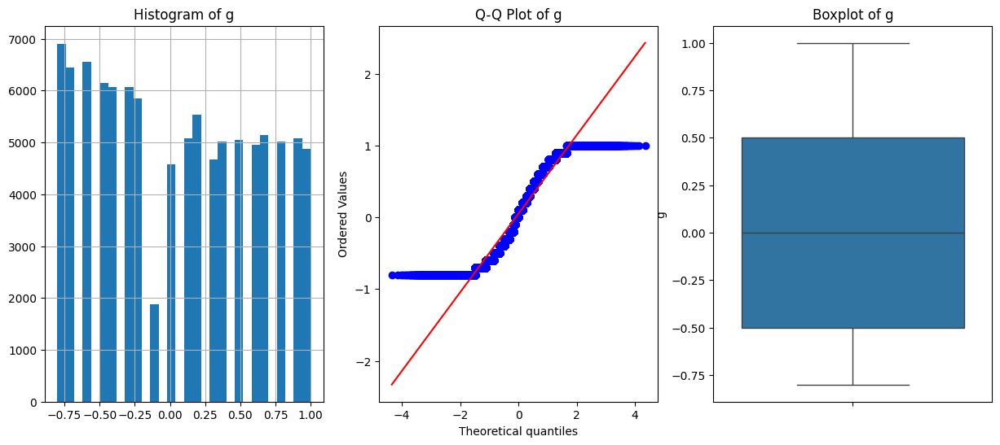

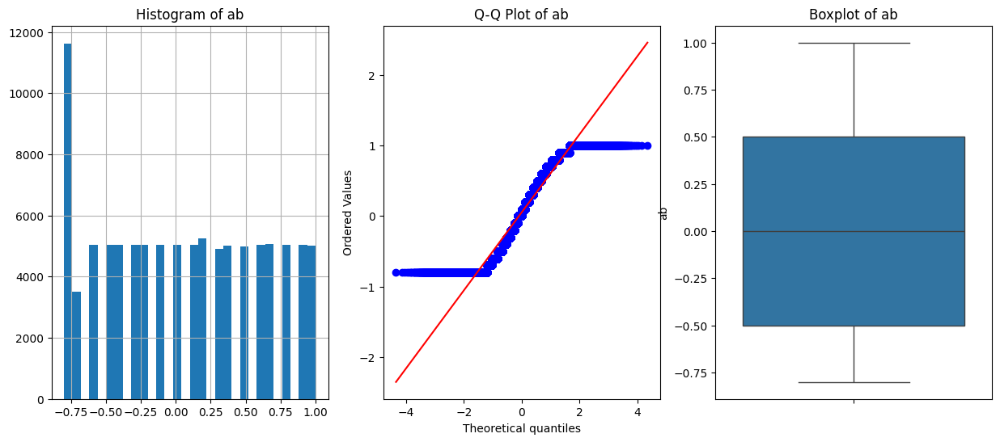

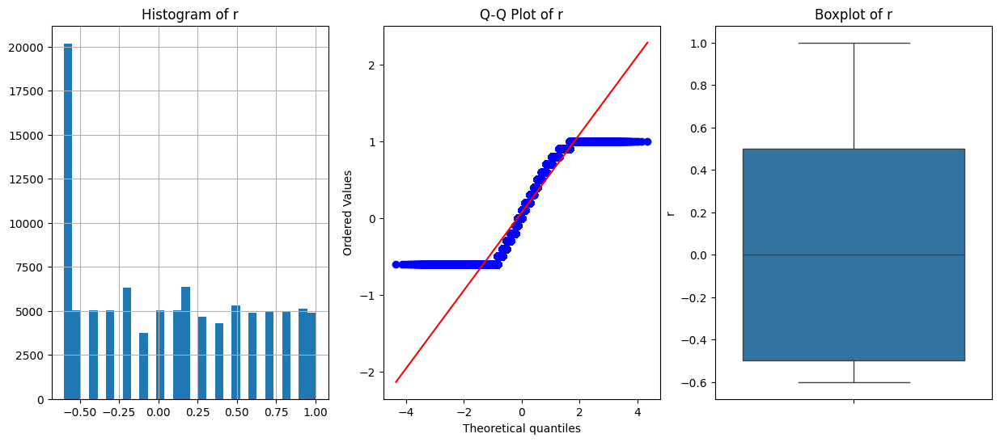

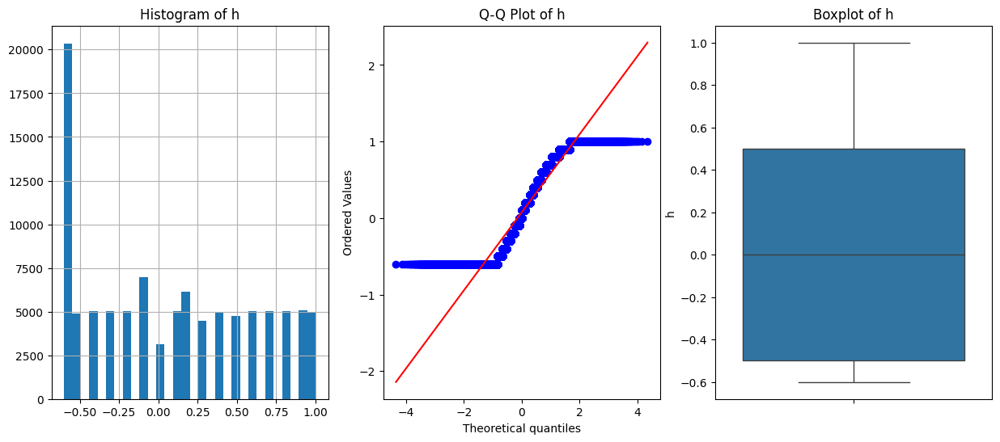

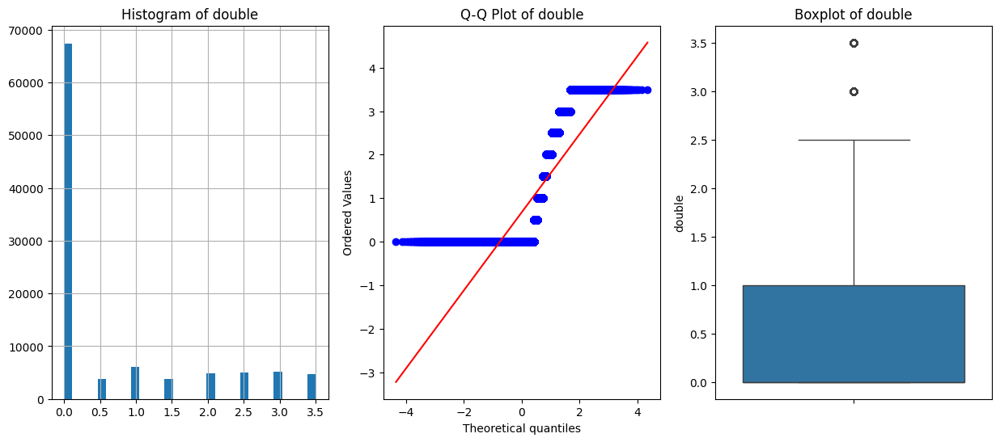

...

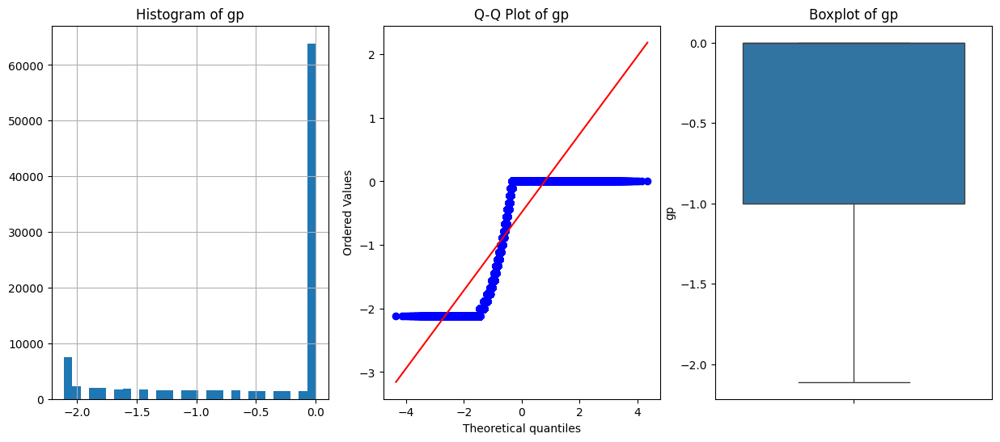

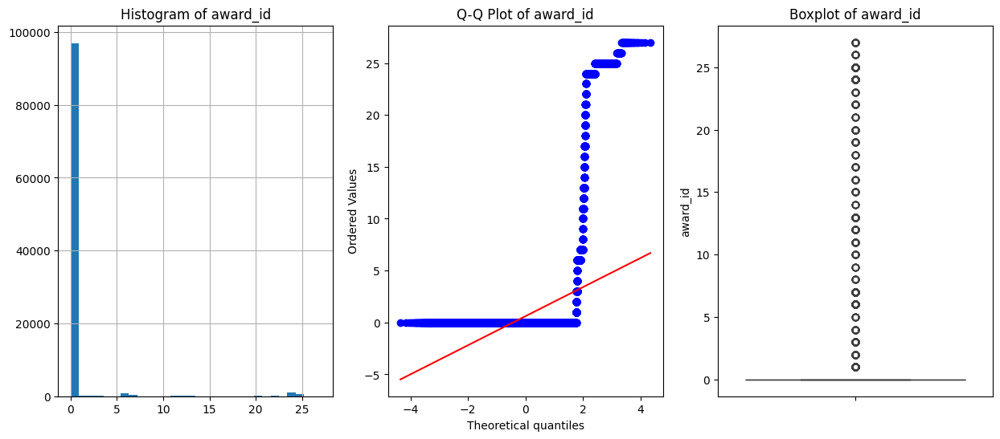

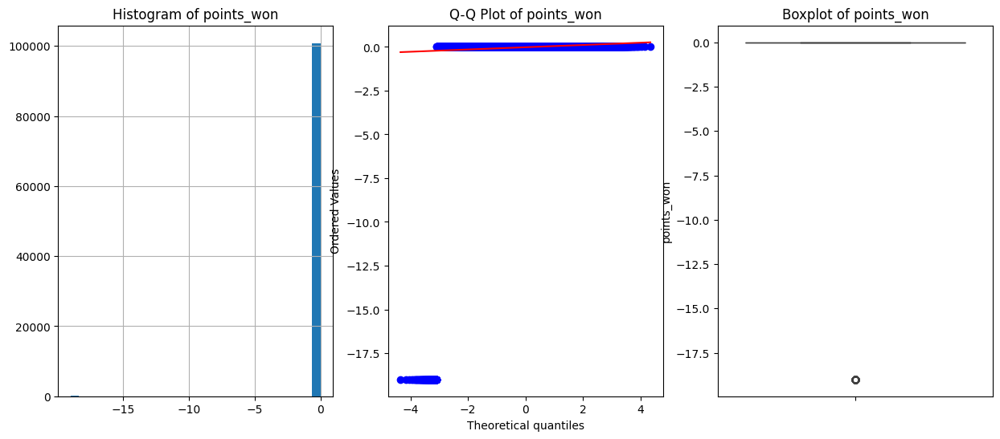

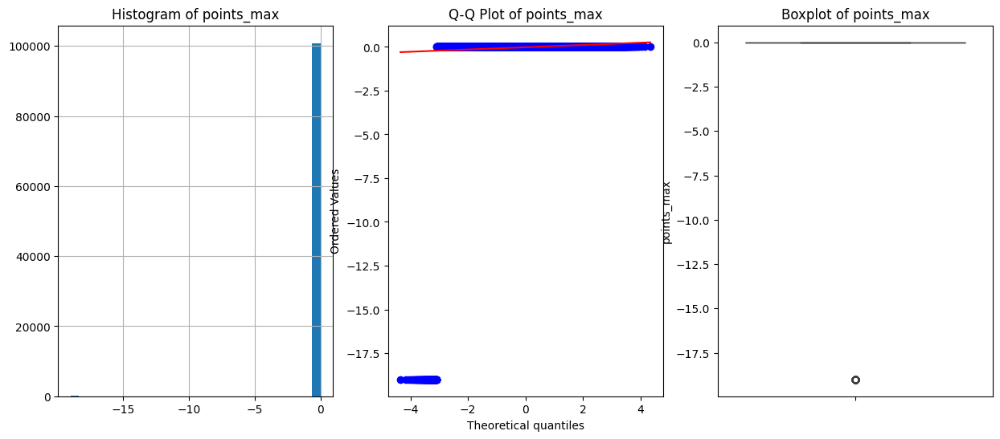

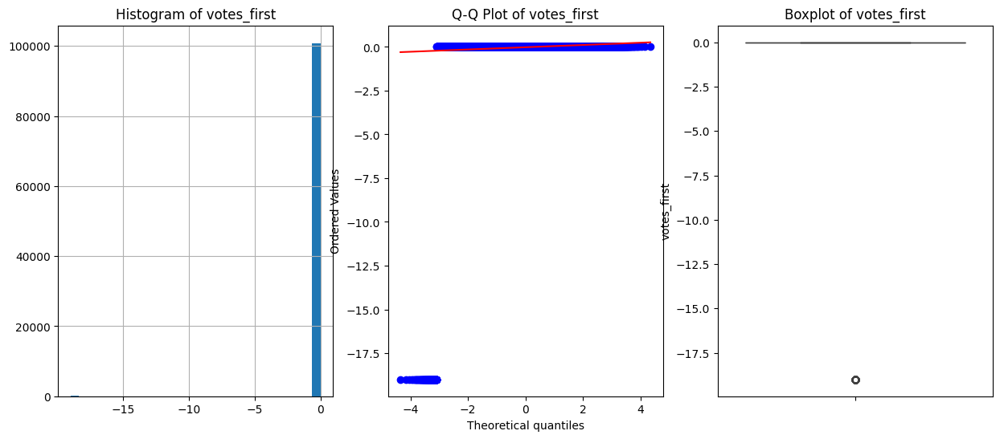

In [1161]:
for variable in X_train_batting_scaled_df.columns:
    diagnostic_plots(X_train_batting_scaled_df, variable)

### Step 4: Machine Learning Modelling

In [1162]:
# Define models
models = {
    'Random Forest': RandomForestClassifier(
        n_estimators=100,
        max_depth=10,
        min_samples_split=5,
        min_samples_leaf=2,
        random_state=42
    ),
    'Logistic Regression': LogisticRegression(max_iter=1000, C=0.1, solver='liblinear'),
    'Gradient Booster': XGBClassifier(random_state=42)
}

In [1163]:
# for name, model in models.items():
#     if name == 'Balanced Random Forest':
#         pipeline = ImbPipeline([
#             ('pca', PCA(n_components=0.95, random_state=42)),
#             ('model', model)
#         ])
#     else:
#         pipeline = ImbPipeline([
#             ('pca', PCA(n_components=0.95, random_state=42)),
#             ('smote', SMOTE(random_state=42)),
#             ('model', model)
#         ])
    
#     pipeline.fit(X_train_scaled, y_class_train)
    
#     # Predict on train and test data
#     y_train_pred = pipeline.predict(X_train_scaled)
#     y_test_pred = pipeline.predict(X_test_scaled)
    
#     print(f"\n{name} Results:")
#     # Train scores
#     print("Train Scores:")
#     print(f"Accuracy: {accuracy_score(y_class_train, y_train_pred):.4f}")
#     print(f"Precision: {precision_score(y_class_train, y_train_pred):.4f}")
#     print(f"Recall: {recall_score(y_class_train, y_train_pred):.4f}")
#     print(f"F1: {f1_score(y_class_train, y_train_pred):.4f}")
    
#     # Test scores
#     print("\nTest Scores:")
#     print(f"Accuracy: {accuracy_score(y_class_test, y_test_pred):.4f}")
#     print(f"Precision: {precision_score(y_class_test, y_test_pred):.4f}")
#     print(f"Recall: {recall_score(y_class_test, y_test_pred):.4f}")
#     print(f"F1: {f1_score(y_class_test, y_test_pred):.4f}")
#     print("Classification Report:")
#     print(classification_report(y_class_test, y_test_pred))


In [1164]:
# # Identify numeric and categorical columns
# numeric_features = X_train_batting.select_dtypes(include=['int64', 'float64']).columns
# categorical_features = X_train_batting.select_dtypes(include=['object']).columns

# # Create preprocessor
# preprocessor_pitching = ColumnTransformer(
#     transformers=[
#         ('num', SKPipeline([
#             ('yeo-johnson', YeoJohnsonTransformer()),
#             ('scaler', RobustScaler())
#         ]), numeric_features),
#         ('round', SKPipeline([
#             ('imputer', SimpleImputer(strategy='constant', fill_value='No Round')),
#             ('ordinal', OrdinalEncoder(categories=[round_order], handle_unknown='use_encoded_value', unknown_value=-1))
#         ]), ['round']),
#         ('award', SKPipeline([
#             ('imputer', SimpleImputer(strategy='constant', fill_value='No Award')),
#             ('onehot', OneHotEncoder(handle_unknown='ignore', sparse_output=False))
#         ]), ['award_id'])
#     ])

In [1165]:
print(stats.mode(y_train_batting))

modal_class_label = stats.mode(y_train_batting)[0]

ModeResult(mode=0, count=67220)


In [1166]:
y_train_preds_naive = [int(modal_class_label) for row in X_train_batting.iloc[:,0]]
y_train_preds_naive[0:5]

[0, 0, 0, 0, 0]

In [1167]:
y_test_preds_naive = [int(modal_class_label) for row in X_test_batting.iloc[:,0]]
y_test_preds_naive[0:5]

[0, 0, 0, 0, 0]

In [1168]:
from sklearn.metrics import accuracy_score

# train accuracy score
y_true = y_train_batting
y_pred = y_train_preds_naive
print('Batters:')
train_accuracy_naive = accuracy_score(y_true, y_pred) * 100
print(f"The Naive Baseline Model's accuracy on train data is {train_accuracy_naive:.2f}%.")

# test accuracy score
y_true = y_test_batting
y_pred = y_test_preds_naive

test_accuracy_naive = accuracy_score(y_true, y_pred) * 100
print(f"The Naive Baseline Model's accuracy on test data is {test_accuracy_naive:.2f}%.")

Batters:
The Naive Baseline Model's accuracy on train data is 66.61%.
The Naive Baseline Model's accuracy on test data is 66.79%.


In [1169]:
# print(stats.mode(y_train_pitching))

# modal_class_label = stats.mode(y_train_pitching)[0]

In [1170]:
# y_train_preds_naive = [int(modal_class_label) for row in X_train_pitching.iloc[:,0]]
# y_train_preds_naive[0:5]

In [1171]:
# y_test_preds_naive = [int(modal_class_label) for row in X_test_pitching.iloc[:,0]]
# y_test_preds_naive[0:5]

In [1172]:
# from sklearn.metrics import accuracy_score

# # train accuracy score
# y_true = y_train_pitching
# y_pred = y_train_preds_naive
# print('Pitchers:')
# train_accuracy_naive = accuracy_score(y_true, y_pred) * 100
# print(f"The Naive Baseline Model's accuracy on train data is {train_accuracy_naive:.2f}%.")

# # test accuracy score
# y_true = y_test_pitching
# y_pred = y_test_preds_naive

# test_accuracy_naive = accuracy_score(y_true, y_pred) * 100
# print(f"The Naive Baseline Model's accuracy on test data is {test_accuracy_naive:.2f}%.")

In [1173]:
# for name, model in models.items():
#     pipeline = ImbPipeline([
#         ('pca', PCA(n_components=0.95, random_state=42)),
#         ('model', model)
#     ])
    
# pipeline.fit(X_train_pitching_scaled, y_train_pitching)

# # Predict on train and test data
# y_train_pred = pipeline.predict(X_train_pitching_scaled)
# y_test_pred = pipeline.predict(X_test_pitching_scaled)

# print(f"\n{name} Results:")
# # Train scores
# print("Train Scores:")
# print(f"Accuracy: {accuracy_score(y_train_pitching, y_train_pred):.4f}")
# print(f"Precision: {precision_score(y_train_pitching, y_train_pred):.4f}")
# print(f"Recall: {recall_score(y_train_pitching, y_train_pred):.4f}")
# print(f"F1: {f1_score(y_train_pitching, y_train_pred):.4f}")

# # Test scores
# print("\nTest Scores:")
# print(f"Accuracy: {accuracy_score(y_test_pitching, y_test_pred):.4f}")
# print(f"Precision: {precision_score(y_test_pitching, y_test_pred):.4f}")
# print(f"Recall: {recall_score(y_test_pitching, y_test_pred):.4f}")
# print(f"F1: {f1_score(y_test_pitching, y_test_pred):.4f}")
# print("Classification Report:")
# print(classification_report(y_test_pitching, y_test_pred))

In [1174]:
pca = PCA()
pca.fit(X_train_batting_scaled)

PCA()

In [1175]:
X_train_batting_pca = pca.transform(X_train_batting_scaled)
X_test_batting_pca = pca.transform(X_test_batting_scaled)

In [1176]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression(max_iter=1000)
model.fit(X_train_batting_pca, y_train_batting)

LogisticRegression(max_iter=1000)

In [1177]:
y_train_pred = model.predict(X_train_batting_pca)
y_test_pred = model.predict(X_test_batting_pca)

In [1178]:
# Train scores
print("Train Scores:")
print(f"Accuracy: {accuracy_score(y_train_batting, y_train_pred):.4f}")
print(f"Precision: {precision_score(y_train_batting, y_train_pred):.4f}")
print(f"Recall: {recall_score(y_train_batting, y_train_pred):.4f}")
print(f"F1: {f1_score(y_train_batting, y_train_pred):.4f}")

# Test scores
print("\nTest Scores:")
print(f"Accuracy: {accuracy_score(y_test_batting, y_test_pred):.4f}")
print(f"Precision: {precision_score(y_test_batting, y_test_pred):.4f}")
print(f"Recall: {recall_score(y_test_batting, y_test_pred):.4f}")
print(f"F1: {f1_score(y_test_batting, y_test_pred):.4f}")
print("Classification Report:")
print(classification_report(y_test_batting, y_test_pred))

Train Scores:
Accuracy: 0.9999
Precision: 0.9998
Recall: 1.0000
F1: 0.9999

Test Scores:
Accuracy: 0.9998
Precision: 0.9994
Recall: 1.0000
F1: 0.9997
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     28888
           1       1.00      1.00      1.00     14361

    accuracy                           1.00     43249
   macro avg       1.00      1.00      1.00     43249
weighted avg       1.00      1.00      1.00     43249



In [1179]:
score = cross_val_score(model,X_train_batting_pca,y_train_batting,cv=5)
std_deviation = np.std(score)
mean_score = np.mean(score)

print("Cross-validation scores:", score)
print("Mean accuracy:", mean_score)
print("Standard deviation of accuracy:", std_deviation)

Cross-validation scores: [0.99995045 0.99990091 0.99995045 0.9999009  0.9999009 ]
Mean accuracy: 0.9999207233989356
Standard deviation of accuracy: 2.4274404956234583e-05


In [1180]:
for name, m in models.items():
    pipeline = ImbPipeline([
        ('pca', PCA(n_components=0.95, random_state=42)),
        ('model', model)
    ])
    
    pipeline.fit(X_train_batting_scaled, y_train_batting)

    # Predict on train and test data
    y_train_pred = pipeline.predict(X_train_batting_scaled)
    y_test_pred = pipeline.predict(X_test_batting_scaled)

    print(f"\n{name} Results:")
    # Train scores
    print("Train Scores:")
    print(f"Accuracy: {accuracy_score(y_train_batting, y_train_pred):.4f}")
    print(f"Precision: {precision_score(y_train_batting, y_train_pred):.4f}")
    print(f"Recall: {recall_score(y_train_batting, y_train_pred):.4f}")
    print(f"F1: {f1_score(y_train_batting, y_train_pred):.4f}")

    # Test scores
    print("\nTest Scores:")
    print(f"Accuracy: {accuracy_score(y_test_batting, y_test_pred):.4f}")
    print(f"Precision: {precision_score(y_test_batting, y_test_pred):.4f}")
    print(f"Recall: {recall_score(y_test_batting, y_test_pred):.4f}")
    print(f"F1: {f1_score(y_test_batting, y_test_pred):.4f}")
    print("Classification Report:")
    print(classification_report(y_test_batting, y_test_pred))


Random Forest Results:
Train Scores:
Accuracy: 0.9998
Precision: 0.9995
Recall: 1.0000
F1: 0.9997

Test Scores:
Accuracy: 0.9998
Precision: 0.9995
Recall: 1.0000
F1: 0.9998
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     28888
           1       1.00      1.00      1.00     14361

    accuracy                           1.00     43249
   macro avg       1.00      1.00      1.00     43249
weighted avg       1.00      1.00      1.00     43249


Logistic Regression Results:
Train Scores:
Accuracy: 0.9998
Precision: 0.9995
Recall: 1.0000
F1: 0.9997

Test Scores:
Accuracy: 0.9998
Precision: 0.9995
Recall: 1.0000
F1: 0.9998
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     28888
           1       1.00      1.00      1.00     14361

    accuracy                           1.00     43249
   macro avg       1.00      1.00      1.00     43249
w

In [1181]:
# mixed_type_cols = []

In [1182]:
# for col in X_train.columns:
#     if X_train[col].apply(type).nunique() > 1:
#         mixed_type_cols.append(col)

In [1183]:
# print(f"Columns with mixed data types: {mixed_type_cols}")

In [1184]:
# for col in mixed_type_cols:
#     print(f"Column: {col}")
#     print(X_train[col].apply(type).value_counts())
#     print("\n")

In [1185]:
# print(X_train[mixed_type_cols].head())

In [1186]:
# print("Confusion Matrix:")
# print(confusion_matrix(y_test, y_pred))

# DW Report

# Content page
[Introduction with Value-Based Problem Statement](#intro)

[Problem Formulation](#prob)

[Data Wrangling on Multiple Tables](#dw)

[Data Cleansing and Transformation](#transform)

[Machine Learning Model](#model)

[Summary and Further Improvements](#sum)

[Reflection](#ref)

# Introduction with Value-Based Problem Statement <a class="anchor" id = "intro"></a>

The proposed value-based problem statement is to help the committee of baseball writers enhance their credibility in selecting players to be inducted into the Hall of Fame by showing that the decision was not made due to recency bias of any players and their subjective thoughts but done through analysing the performance of the player candidates for induction across their professional career statistics and the number of accolades and achievements throughout their career. This would provide the committee with a more comprehensive and unbiased view of each candidate's contributions to the sport. This approach not only helps mitigate the effects of recency bias but also allows for a fair comparison of players across different eras. Implementing such a data-driven methodology could significantly enhance the credibility of the Hall of Fame selection process, ensuring that inductees truly represent the pinnacle of baseball achievement. Moreover, it could lead to more informed discussions about player legacies and potentially reveal overlooked candidates worthy of consideration.

# Problem Formulation <a id = "prob"></a>

Before loading the data, delving into the data dictionary was crucial in identifying what the data tables in the CSV file would provide me in completing my problem statement. I had to look through what kind of variables in certain data tables were needed or not due to the relevance of my problem statement which was regarding the indictment into the Hall of Fame for professional baseball. Research was also conducted as well to shortlist the tables for the most relevant ones as there was a various number of tables that could have been used but there would be too many variables in consideration which would cause there to be too much noise for the training model.

To further understand the data, using functions to figure out the data types of the different columns, were there multiple data types in a column? To solve this, the need to cast the data variable as the desired data type would be necessary. I also had to ensure how many null values were contained in the variables and if there was a need to fill values before imputation through mean, median, or any other method. In this scenario, there was also the presence of infinite values which would have been bad as there would have been no use for it and would only disrupt functions that cannot handle such values. There were also some duplicates present in some of the data tables that had to be dropped due to having repeated values which would create noise for the training model and compromise the integrity of the data and its accuracy. I would also need to drop columns that are unnecessary in the context of my problem statement such as ‘league_id’ and ‘team_id’ as both of them do not have any relevance to my problem statement as my problem statement covers all the players that could be inducted into the Hall of Fame and not just players from specific leagues or teams. I would also drop those columns that had a low correlation and no significance to the training model such as ‘stint’, ‘pos’, ’sf’ and ‘g_p’ which would reduce the dimensionality of the data and result in a more optimised dataset for the training model to take in as the data is less complex.

To formulate a prediction problem, we need to clearly define our target variable and the features that will be used to predict it. In this case, our target variable would be whether a player is inducted into the Hall of Fame or not. This can be represented as a binary classification problem, where 1 indicates induction and 0 indicates non-induction. Hence, in this case is represented as ‘Y’ for acceptance into the Hall of Fame and ‘N’ for denial of the possibility of getting inducted into the Hall of Fame for that year.

The features we'll use to predict Hall of Fame induction will include various career statistics and achievements. Some key features might be Career batting average, Total home runs, Runs batted in (RBI), On-base percentage (OBP), Slugging percentage (SLG), All-Star game appearances, Wins Above Replacement (WAR), MVP awards, Gold Glove awards, Silver Slugger awards, and Years played in the major leagues

For pitchers, we would include statistics such as Earned Run Average (ERA), Wins, Strikeouts, Complete games, and Strikeouts which are all important statistics to take note of in the world of baseball.

We'll need to create two datasets that combine these statistics for each player, along with their Hall of Fame status. One for batters and one for pitchers. This will involve merging data from multiple tables, ensuring that we have a comprehensive view of each player's career as a batter and as a pitcher.

Our primary objective is to develop a data-driven approach to assist the Baseball Hall of Fame selection committee in making more objective and credible induction decisions. Specifically, we aim to:
1.	Create a predictive model that assesses a player's likelihood of Hall of Fame induction based on career statistics and achievements.
2.	Identify key performance indicators that strongly influence Hall of Fame selection.
3.	Mitigate the effects of recency bias and subjective judgment in the selection process.

To achieve this, we will:

•	Collect and analyze comprehensive career data for both inducted and non-inducted players.

•	Develop separate models for batters and pitchers to account for position-specific criteria.

•	Utilize machine learning algorithms to predict Hall of Fame induction probability.

•	Evaluate the model's performance and interpret its findings to provide insights into the selection process.

By framing the problem this way, we can provide the selection committee with an objective tool to complement their expertise, potentially uncovering overlooked candidates and enhancing the overall credibility of the Hall of Fame selection process.

By using machine learning algorithms such as logistic regression, random forests, or gradient boosting machines, we can train a model on historical data of Hall of Fame inductees and non-inductees. This model can then be used to predict the likelihood of future candidates being inducted, providing valuable insights to the committee of baseball writers.


# Data Wrangling on Multiple Tables <a id = "dw"></a>

There is also the issue of creating new features that were of use by exploring non-existent data in the data table such as the ‘on_base_percentage’ data feature that would be useful in predicting the target variable as it is one of the more important data as this metric would show how successful the player is advancing in the game and the corresponding chance of him scoring would be higher since he is on base. Therefore, to create meaningful features, I would have to look into how the available variables in our dataset can come together to form an additional feature for there are some more complex statistics that were not provided, and this leaves me unable to calculate some of the more interesting features such as Wins Above Replacement (WAR) which distinguishes excellent player and a lousy player by their WAR score. Hence, since statistics such as league-weighted base-on-average are not available, WAR and other features were not included.

The new features that I have created are ‘on_base_percentage’, ‘slugging_percentage’, ‘batting_average’ and ‘years_since_debut’ for batters as these are all very important. For ‘on_base_percentage’ it is to determine how likely the player is to get on base and in response have a likelihood of scoring a run. The ‘slugging_percentage’ signifies how powerful the player’s swing is as a batter when in the batter box confronted by the pitcher. The ‘batting_average’ is how good the batter is in making contact with the ball, hitting it, and keeping it in the playing grounds. The ‘years_since_debut’ shows us how experienced the player is in the game and this can show different things as a player ages, he will grow slower, but his hitting power also increases till it reaches its peak. It can also show whether he is in his prime or not for age has a lot to do with physical attributes that rise and fall, and mental attributes that accumulate over time.

The new feature that I created besides for batters is ‘induction_chances’ which is for the Hall of Fame data to see what the likelihood of getting into the Hall of Fame by the number of votes they got from the limited pool of ballots that are allowed to vote for that player. However, some players with high chances of getting inducted do not get into the Hall of Fame due to the choice of the Association of Baseball Writers. Hence, I have applied a function where when the chance of induction is 0.5, I change the induction status to is inducted as there is a majority of players that think this particular has made a significant impact on the sport and the league they are playing in thus, the function. I have also done my exploration of the data as the median of the induction chances was 0.4~0.5 but they were still given the indictment while the lowest chance to get inducted was ~0.15. Hence, this was where I set the standard at where the player should have been inducted since at least half of the players with voting rights have deemed the player worthy of getting inducted into the Hall of Fame due to contributions he has made to the game.

I would also have to ensure that my data tables would provide adequate columns and rows for me to do my data wrangling and have enough training data after the train test split for my training model which in this case would be the logistic regression classification model to identify a binary outcome which would be a ‘1’ for positive of getting inducted and a ‘0’ for not being able inducted into the Hall of Fame for that year. There is also the need to look at the correlation each variable has with one another to make sure there is no multi-collinearity which could cause issues by making it challenging for the training model to interpret the results and draw meaningful conclusions from the data model due to independent variables having high correlation.

Before the merging of the tables, I have to drop columns that are of no relevance as it would cause hindrance to the machine learning model. It would also cause me to lose efficiency in the data transformation phase to prepare the training data for machine learning. I would also have to manually impute values according to whether there was a possibility of them being able to use any of the imputation methods available. As some of the features that show scarcity would not be suitable as columns like ‘award_id’ contain the achievements that they have collected over their careers and not every one of the players is given an award while others win it multiple times. I would also have to replace values such as infinite values with null values and fill in those with 0 as the only possibility of it being of infinite value was that the denominator was 0 hence, he would not be able to qualify for this statistic. I have also tried to calculate this feature using the formula provided however, it remained as the same where there are infinite values.

I have also grouped by the tables based on ‘player_id’ and ‘year’ this is to allow players to have data for each year when they are playing since the induction into the Hall of Fame is an annual event. Hence this would show the aggregated data of each table for that specific portion of the game. As for the postseason data, I made use of a function to get the most important round for that player_id and for that year and left it there but removed the rest as it shows that for that year, they made it through all these rounds to participate in that final match up but lost and did not advance. Hence, their match up that was furthest in the international tournament was left to be encoded later on during data transformation and cleansing.

For the merging of tables, I would have to ensure that no additional columns are being created without my knowledge so the need of a suffix is needed to differentiate some data variables that have the same name in different tables so that I would have an easier time in identifying which is which and so that I can make use of it when necessary. In this case, where I am handling two dataframes one for pitchers, and one for batters. I have used merge on left join using common column names to combine the data tables. This is to prevent the issue of not having enough rows of data for the machine learning model to utilise, there is also the issue of having very few rows of data in the Hall of Fame tables that match the player_id in the rows of data in the other tables. Hence the use of left join is better here as we can then take a look at other players that have matching statistics or better statistics than those who were inducted.


# Data Cleansing and Transformation <a id = "transform"></a>

Before data cleansing and transformation, the use of SMOTE was crucial to oversample, the minority class and undersample the majority class due to the difference in classes. In this case, I made use of SMOTENC as this version of SMOTE can handle categorical variables without the use of prior encoding. This thus allows me to not only have a more balanced dataset but also allows for the train test split data afterward a much more balanced dataset as well. Hence, the machine learning model would be much more accurate in predicting the values as they would be able to take notice of the statistics of both classes and make a prediction based on the different statistics of the two classes and classify the data based on which side of the statistic it is leaning towards. To do this I would have to first replace all the null values in the numerical columns to allow for the smote to run and balance the dataset. Afterward, I would have to replace the earlier imputed values with null values for mean median value imputation.

Data cleansing and transformation is a very important step in data wrangling in this phase as it helps to prepare the model data for the machine learning model, ensuring that it is clean, consistent, and suitable for the respective machine learning models to use to predict the outcome. The dataset was examined for missing errors and outliers across both categorical and numerical variables. I did use the median values to impute into the respective split dataset as players throughout their careers might have various incidents such as injuries that break their career, a decline in professional sports performance, or a change in mindset that causes their player statistics to drop at varying degrees. Hence, to not allow for imputed values to be affected by such various changes in the player statistics throughout the different years the optimal choice would be the median value. Of course, there are exceptions, but the case is unlikely to be the case. As for why I did not handle outliers it contains very important information for certain players as these players might be performing exceptionally well and exceed the interquartile range. Therefore, if I were to use winsorization or trimming it would lead to losing valuable information.

For my numerical features, I have decided to impute columns that have the same number of null values with arbitrary imputation as there could be a relationship between these columns directly or indirectly as they are not missing at random. I would also use mean median imputation for the rest of the numerical features as there is no relationship being signified. As for the categorical columns, I have decided to impute the null values with ‘No Award’ or ‘No Round’ as I would assume that these players were of no significance for it is very unlikely that they could be such an excellent outcome and I would prefer that they would not cause the training model to take into account of them if they were to have any awards or they were qualified for any of the better division leagues for the World Series. I have also checked whether I have imputed all the values by looking at the sum of all the null values to prepare categorical columns for future encoding and transformation of numerical features.

After imputing the median values into numerical variables and the selected values for categorical columns, there was a need for data transformation to normalize the data. Therefore, the use of Yeo-Johnson transformer was needed. The reason why I chose the Yeo-Johnson transformer over the rest was because it inflates low variance and deflates high variance data. Other transformation methods such as logarithmic transformation was either too sensitive to small changes in the data, or only being able to handle positive values such as the Box-Cox transformation. This makes it an ideal choice for datasets with varying distributions, as it helps in stabilizing variance and making the data more suitable for modelling.

After my imputation that I have done, there was a need for encoding for the categorical columns as the machine learning model would not be able to accept any object type values. Hence, the use of ordinal encoding came about for both categorical columns as both columns have a distinct ranking for each value. In the case of round, there is the World Series title which is the very top and most important followed by the championship leagues in the various regions. Hence, the use of ordinal encoding is much needed to create an underlying ordinality in the data to create a bias for the training model to use and predict since the higher you go in the international competition, the more likely you would get inducted into the Hall of Fame due to the achievement of advancing so far in the international stage. The same goes for awards. The awards have different prestige, requirements, and significance that comes with it. Hence, more important awards that have stringent requirements that are much more difficult to achieve as an athlete could signify their extraordinary capabilities. Hence, the need to introduce ordinality to values as there are awards that have been given in the thousands and awards that are presented to a few individuals only.

After the encoding of data, there was also the need for discretisation as for the methods, I used both methods which included both equal frequency and equal width discretisation. The use of equal frequency discretisation was for numerical columns that were continuous in nature which divided the data into intervals with approximately the same number of observations in each bin. This method helps in managing skewed distributions by ensuring that each bin has an equal number of data points. While the use of equal width discretisation was for discrete variables, where the range of values was divided into bins of equal size. This approach is particularly useful for variables that have a more uniform distribution, as it simplifies the data while maintaining the overall structure of the original variable.

For the scaling of the numerical features, I chose the use of the robust scaler as the primary method due to its resilience against outliers, which was particularly important because I did not apply any explicit outlier handling techniques during the preprocessing phase. The robust scaler operates by utilizing the median and the interquartile range (IQR) rather than the mean and standard deviation, which are more sensitive to extreme values. This makes the robust scaler an ideal choice for datasets like ours, where the presence of outliers could potentially distort the feature scaling if a more sensitive method, such as the standard scaler, were used.

In this specific context, the dataset contained numerous numeric features representing various player statistics in baseball, which likely included some extreme values due to the nature of sports data—certain players may have exceptional performances that stand out from the rest. By employing the Robust Scaler, the features were scaled in a way that minimized the impact of these extremes, ensuring that the machine learning models would not be unduly influenced by outlier values. This approach helps maintain the integrity of the data while ensuring that the models trained on this data are more robust and generalizable to unseen data.

The use of PCA was useful in this case as it addresses the challenge of high dimensionality inherent in the dataset by reducing the dimensionality of the data while preserving crucial information. It does this by transforming the original variables into a set of new, uncorrelated variables called principal components. These components are ordered such that the first few retain most of the variation present in the original data, while subsequent components capture progressively less variance. Moreover, high dimensionality can introduce noise, redundancy, and collinearity among features, which can degrade model performance. Hence, this reduction in noise ensures that the machine learning models are trained on the most informative aspects of the data, leading to more accurate and reliable predictions. In addition, it not only reduces the computational burden but also helps in mitigating the risks associated with overfitting, especially when dealing with a limited number of samples relative to the number of features.

In the case of our dataset, which includes a wide range of columns representing various aspects of baseball player statistics, PCA was instrumental in condensing the feature space. By retaining only those components that contribute the most significant variance, PCA helped eliminate redundant or less informative features, thereby simplifying the model without sacrificing predictive accuracy. The resulting model was more efficient and could potentially generalize better to new data, as it was trained on a more concise representation of the underlying patterns in the data.


# Machine Learning Model <a id = "model"></a>

The machine learning models that I have chosen to implement were the logistic regression model, random forest classification model, and gradient boosting classification model. These models would help in predicting the binary outcome of the players getting inducted into the Hall of Fame where ‘1‘ would be the predicted value of them getting inducted into the Hall of Fame while ‘0‘ stands for them not getting inducted into the Hall of Fame. There is also the issue of the difference between how each model performs.

Using the Naïve Baseline Model, as the baseline model due to its simplicity which uses data prior data cleansing to predict the accuracy and precision score. It is also used as a reference to my other machine learning models’ accuracy and precision score after transformation to see how the data wrangling process has affected the training data and in turn, affects the model performance. 

Logistic Regression was selected as a model due to its simplicity and interpretability. It provides insights into the importance of individual features through its coefficients. Random Forest Classification was chosen for its ability to handle non-linear relationships and feature interactions. It also provides feature importance scores, which can help identify the most crucial statistics for Hall of Fame induction. Gradient Boosting Classification, specifically XGBoost, was implemented due to its high performance in many machine learning competitions and ability to handle imbalanced datasets. We used various metrics to evaluate and compare the models, including accuracy, precision, recall, F1-score, and ROC AUC. To address the potential class imbalance (as Hall of Fame inductions are relatively rare), we implemented techniques such as class weighting and SMOTE (Synthetic Minority Over-sampling Technique). We also performed cross validation to find the cross validation score, mean score, and standard deviation of each value to ensure that no overfitting was performed and that there was no possible data leakage. In this scenario, it shows no signs of overfitting, and after checking that I have not touched the test data to implement any new features except to transform. This shows that the model is performing as it is desired.


# Summary and Further Improvements <a id = "sum"></a>

Our analysis demonstrates the potential of machine learning models to provide objective insights into Hall of Fame induction decisions. All models performed within an accuracy range of 98~99% and a precision range just below that.

Key findings include:

1.	High overall accuracy across all models, indicating strong predictive power.
2.	Logistic Regression provided interpretable results through feature coefficients.
3.	Random Forest and Gradient Boosting models captured complex relationships in the data.
4.	Feature importance analysis revealed key statistics influencing Hall of Fame induction.
5.	Class imbalance was successfully addressed through SMOTE and class weighting.

To further improve our approach, we could:

1.	Incorporate more advanced statistics and sabermetrics that have gained prominence in recent years, such as Wins Above Replacement (WAR), FIP (Fielding Independent Pitching), and wOBA (Weighted On-Base Average).
2.	Develop separate models for different player positions to account for position-specific criteria. This could include specialized models for pitchers, infielders, outfielders, and catchers.
3.	Implement a time-based split for training and testing to better simulate the actual Hall of Fame voting process and assess the model's predictive power for future candidates. This could involve training on data up to a certain year and testing on subsequent years.
4.	Explore ensemble methods that combine the strengths of multiple models to potentially improve overall prediction accuracy. This could include stacking or blending different models.
5.	Conduct a more in-depth analysis of misclassified players to understand the limitations of our current approach and identify areas for improvement. This could reveal important factors not captured by our current feature set.
6.	Incorporate contextual features such as era-specific statistics, as the standards for excellence have changed over time in baseball.
7.	Consider including off-field factors that might influence Hall of Fame voting, such as leadership roles, community involvement, or historical significance.
8.	Implement a feature selection process to identify the most relevant statistics for prediction, potentially improving model efficiency and interpretability.
9.	Explore deep learning models, such as neural networks, which might capture more complex patterns in the data.
10.	Conduct a thorough analysis of model explainability using techniques like SHAP (SHapley Additive exPlanations) values to provide more detailed insights into model decisions.

By refining our methodology and incorporating these improvements, we can develop a more comprehensive and nuanced tool to assist in the evaluation of Hall of Fame candidates, enhancing the credibility and objectivity of the selection process.

# Reflection <a id = "ref"></a>

I think I could have had a better understanding and application of the later concepts if the assignments contained components that could be utilised but, in this scenario, my problem statement did not have a corresponding relationship with these newer principles. However, I think I have quite a solid understanding of the data wrangling process and its principles after extensive time spent on the two assignments, consulting the lecturer on questions that I have encountered during my practicals, assignments or exercises, and personal research done to better understand the concepts and where best to place them in the data wrangling process. This is also done through applying the theoretical knowledge that I have learned through the course of this module to come up with practical solutions. Through this data wrangling module, I have learned how to preprocess the data and clean it after loading it and prepare for machine learning models to use and predict for both regression and classification models. The use of data pipelines has been great for my assignment as after I have tested, I can place them there and this automates data transformation tasks and allows me to focus instead on finding the way to further transform and prepare my training data for my machine learning model. Data pipelines also helped me process raw data more quickly that loses value over time. It also allows me to know in what order the transformation methods are being applied to and it ensures that all of them are being applied with one time of fitting and transformation of the pipeline to the data required. The Python packages that needed to be imported to extract, transform, and generate features were in the dozens. There were multiple packages that could do the main function but slightly differently with different outputs and outcomes and it was up to me to explore and figure out what was the most appropriate in the application of my data wrangling process. There was also the issue of researching the new functionality of the packages that were imported as most of the time errors would be thrown and through this process, it enriched my understanding of data wrangling features and methods. This assignment especially provided valuable insights into the data wrangling process, including data understanding, data cleaning, feature engineering, data transformation, machine learning pipeline, and model selection and evaluation. The assignment taught me the importance of domain knowledge in making informed decisions about data imputation, encoding, discretization, scaling, and dimensionality reduction. It also taught the construction of efficient data pipelines, automating the transformation process, and ensuring consistency in data preprocessing. The assignment also highlighted the critical role of thorough data preparation in achieving accurate and reliable predictive models. The assignment provided a solid foundation for future projects in data science and machine learning, emphasizing the importance of thorough data preparation in achieving accurate and reliable predictive models. During this time in the module, through the use of enterprise software of Visual Studio code and Jupyter Notebook I was able to familiarise myself with all of its functionality and what needs to be done for me to operate on my Jupyter source file. I could access Jupyter Notebook’s checkpoints folder to pull up the previous version of the current code as sometimes when you make changes to the code it causes some unexpected changes that you might not expect and need to go back to the state where you had not implemented any of these recent changes. In the future, I would most likely apply these skills in my own personal project where I can fine tune it at my own pace unlike this assignment which was extremely rushed and I felt this could be done better. I would most likely do a project using web scraping and time series data extraction as I think it would be useful in many assignments in the future and currently due to how many valuable variables and data use time as a metric as a success indicator. I would also most likely apply to various upcoming modules in the future such as the machine learning module and deep learning module where I would first have to appropriately clean the training data first to an acceptable level for the training model to accept it. 